# For make traj

In [76]:
    
class MyLSTM_RNN_uniPFC(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse=1):
        super(MyLSTM_RNN_uniPFC, self).__init__()

        self.hidden_size_PFC = hidden_size+0
        self.hidden_size_HPC = hidden_size+0
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.Re.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)
        nn.init.sparse_(self.Re.weight_hh.data,sparse)
        # nn.init.normal_(self.PFC.weight_ih.data,0,1/10)
        # nn.init.normal_(self.HPC.weight_ih.data,0,1/10)
        # nn.init.normal_(self.Re.weight_ih.data,0,0.1/10)
        # nn.init.normal_(self.PFC.weight_hh.data,0,1/10)
        # nn.init.normal_(self.HPC.weight_hh.data,0,1/10)
        # nn.init.normal_(self.Re.weight_hh.data,0,1/10)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = hiddens[1][0]
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]
    
    
class MyLSTM_RNN_uniHPC(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse=1):
        super(MyLSTM_RNN_uniHPC, self).__init__()

        self.hidden_size_PFC = hidden_size+0
        self.hidden_size_HPC = hidden_size+0
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.Re.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)
        nn.init.sparse_(self.Re.weight_hh.data,sparse)
        # nn.init.normal_(self.PFC.weight_ih.data,0,1/10)
        # nn.init.normal_(self.HPC.weight_ih.data,0,1/10)
        # nn.init.normal_(self.Re.weight_ih.data,0,0.1/10)
        # nn.init.normal_(self.PFC.weight_hh.data,0,1/10)
        # nn.init.normal_(self.HPC.weight_hh.data,0,1/10)
        # nn.init.normal_(self.Re.weight_hh.data,0,1/10)

    def forward(self, input, hiddens):
        Re_input = hiddens[0][0]
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]



class MyLSTM_RNN_uniPFCHPC(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse=1):
        super(MyLSTM_RNN_uniPFCHPC, self).__init__()

        self.hidden_size_PFC = hidden_size+0
        self.hidden_size_HPC = hidden_size+0
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.Re.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)
        nn.init.sparse_(self.Re.weight_hh.data,sparse)
        # nn.init.normal_(self.PFC.weight_ih.data,0,1/10)
        # nn.init.normal_(self.HPC.weight_ih.data,0,1/10)
        # nn.init.normal_(self.Re.weight_ih.data,0,0.1/10)
        # nn.init.normal_(self.PFC.weight_hh.data,0,1/10)
        # nn.init.normal_(self.HPC.weight_hh.data,0,1/10)
        # nn.init.normal_(self.Re.weight_hh.data,0,1/10)

    def forward(self, input, hiddens):
        Re_input = hiddens[0][0]
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = hiddens[1][0]
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]
    
    
def check_distance(list_a,list_b):
    result = []
    for point in list_b:
        dis_list = []
        for target in list_a:
            dis_list.append(np.linalg.norm(point[:3] - target[:3]))
        result.append(np.min(dis_list))
    return np.array(result)

def overlap_coefficient(list_a,list_b):
    threshold = 0.025
    #Aの各点からBにある任意の点の最小距離を計算
    distance = check_distance(list_a,list_b)
    
    #集合Aの要素数を取得
    num_listA = len(list_a)
    return distance

def plot_distance(data1,data2):
    r = data1
    l = data2
    
    overlap=overlap_coefficient(r,l)

    plt.figure()
#     plt.ylim(0,1)
    plt.plot(overlap)


model_deigo/R20_H/ReModel_L2_interRNNrand_OUT1_121H_s6_100_1_epoch155.pth


<IPython.core.display.Javascript object>


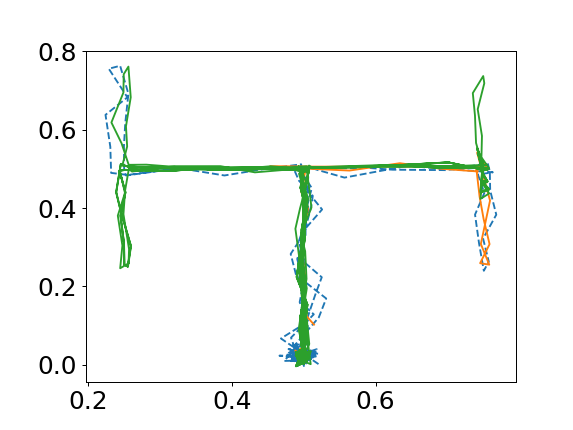

(1080, 20)


<IPython.core.display.Javascript object>


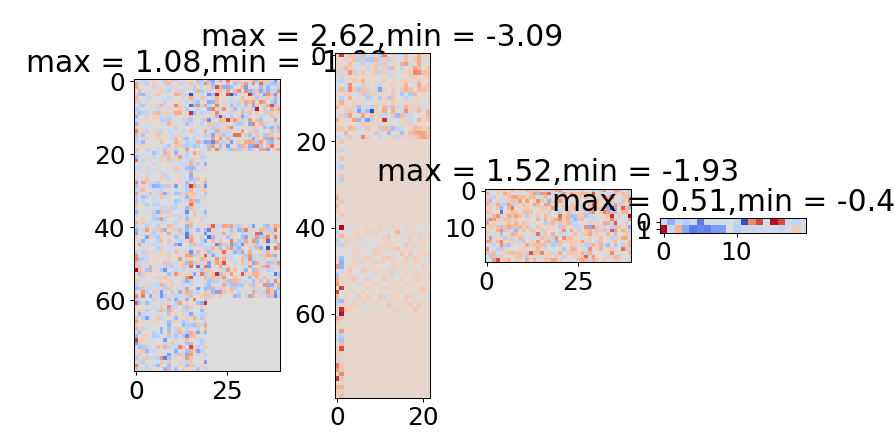

<IPython.core.display.Javascript object>


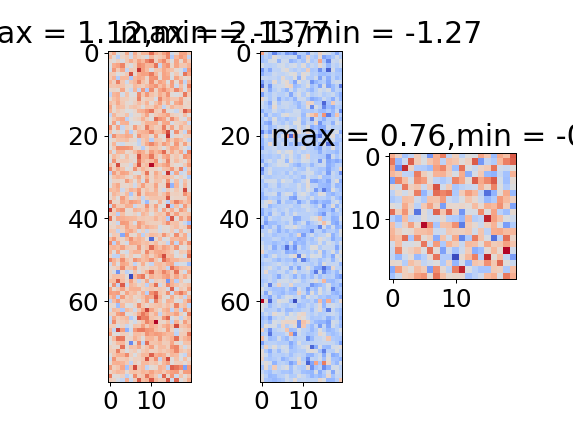

/home/munenori/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


<IPython.core.display.Javascript object>


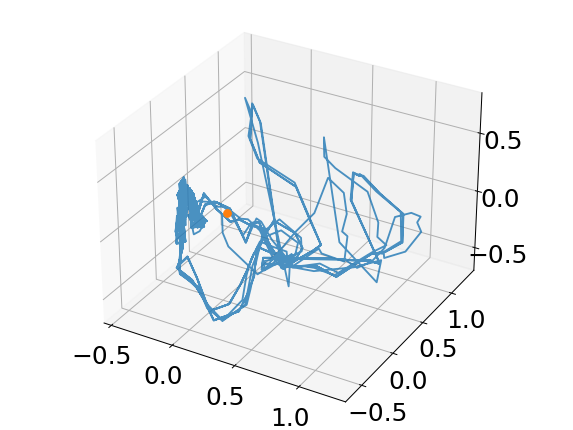

/tmp/ipykernel_2923202/2752285083.py:623: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax3d = Axes3D(fig3d)
/home/munenori/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


<IPython.core.display.Javascript object>


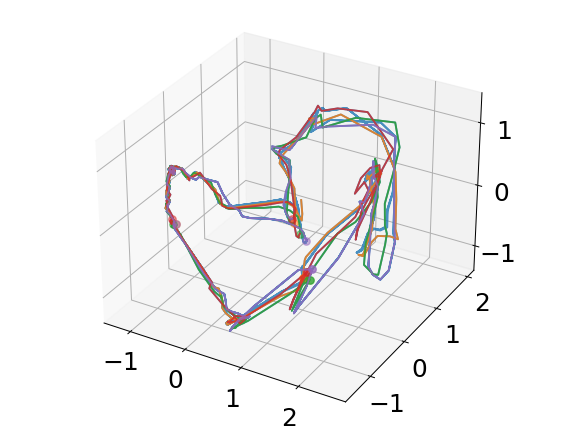

/tmp/ipykernel_2923202/2752285083.py:653: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax3d = Axes3D(fig3d)
/home/munenori/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


<IPython.core.display.Javascript object>


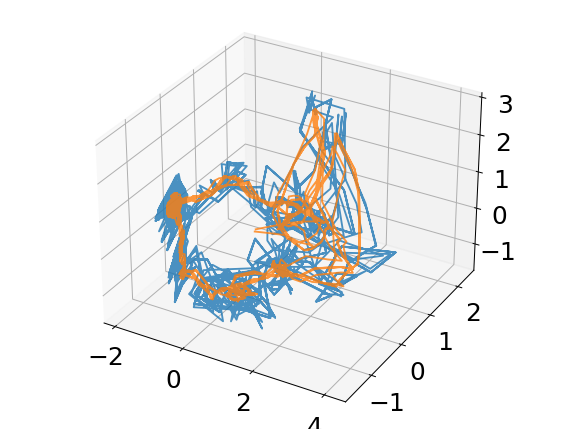

/tmp/ipykernel_2923202/2752285083.py:690: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax3d = Axes3D(fig3d)


In [63]:
#v4 without Re
#v4_1 revised forward function

import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import time
import math
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import sklearn 
import os
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D

%matplotlib notebook

def Culc_gate(input, params, hiddens):
    Re = hiddens[0][0]
    HPC_input = torch.cat([input,Re],dim=1)
    PFC_input = hiddens[1][0][0]
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    return [PFC_gates.tolist(), HPC_gates.tolist()]
    

def MakeAnimation(data_x,data_y,traj_x,traj_y, data_limit):
    fig, ax = plt.subplots()
    ims = []
    for t in range(traj_x.shape[0]):
        if t < data_limit:
            traj = ax.plot(data_x[:t], data_y[:t], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
        else:
            traj = ax.plot(data_x[:data_limit], data_y[:data_limit], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or", data_x[data_limit-1:t], data_y[data_limit-1:t], "--b")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=10)    
    ani.save('anim_v4_2_1_r.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_attracter(data_x,data_y):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob",)
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_attracter2.gif', writer='pillow')
    plt.show()
    
    return 0


    
def MakeAnimation_img(data,module):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data.shape[0]):
        img = ax.imshow(data[t].reshape(1,data.shape[1]))
        title = ax.text(0.5, 1.01, module+' time={}'.format(t),
             ha='center', va='bottom',
             transform=ax.transAxes, fontsize='large')
        ims.append([img,title])
    ani = animation.ArtistAnimation(fig, ims)    
    ani.save('anim_fire_'+module+'_.gif', writer='pillow')
    plt.show()
    
    return 0

def mkOwnDataSet(data_size, data_length=100, freq=60., noise=0.01):
   
    x = np.loadtxt("primal_long131test_r.csv",delimiter=',')
    y = np.loadtxt("primal_long131test_l.csv",delimiter=',')
    train_x = []
    train_y = []
    
    for offset in range(data_size):
        train_x.append([[x[i][0] + np.random.normal(loc=0.0, scale=noise),x[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,x.shape[0],round(x.shape[0]/data_length))])
        train_y.append([[y[i][0] + np.random.normal(loc=0.0, scale=noise),y[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,y.shape[0],round(y.shape[0]/data_length))])
    return train_x, train_y

def make_Ttraj(direction):
    traj_x = np.array([])
    traj_y = np.array([])
    straight_x = np.ones(5)*0.5
    if direction == 1:
        branch1_x = np.linspace(0.5, 0.75, 5)
        branch2_x = np.linspace(0.75, 0.5, 5)
    elif direction == 2:
        branch1_x = np.linspace(0.5, 0.25, 5)
        branch2_x = np.linspace(0.25, 0.5, 5)        
    backstraight_x = np.ones(5)*0.5

    straight_y = np.linspace(0, 0.5, 5)
    branch1_y = np.linspace(0.5, 0.5, 5)
    branch2_y = np.linspace(0.5, 0.5, 5)
    backstraight_y = np.linspace(0.5 , 0, 5)
    
    traj_x = np.append(traj_x, [straight_x,branch1_x,branch2_x,backstraight_x])
    traj_y = np.append(traj_y, [straight_y,branch1_y,branch2_y,backstraight_y])
    traj = np.concatenate([[traj_x],[traj_y]],axis=0).T
    return traj

def make_Htraj(direction1, direction2):
    traj_x = np.array([])
    traj_y = np.array([])
    straight_x = np.ones(10)*0.5
    if direction1 == 1:
        branch1_x = np.linspace(0.5, 0.75, 5)
        branch2_x = np.linspace(0.75, 0.75, 5)
        branch3_x = np.linspace(0.75, 0.75, 5)
        branch4_x = np.linspace(0.75, 0.5, 5)
    elif direction1 == 2:
        branch1_x = np.linspace(0.5, 0.25, 5)
        branch2_x = np.linspace(0.25, 0.25, 5)   
        branch3_x = np.linspace(0.25, 0.25, 5)  
        branch4_x = np.linspace(0.25, 0.5, 5)       
    backstraight_x = np.ones(10)*0.5

    straight_y = np.linspace(0, 0.5, 10)
    branch1_y = np.linspace(0.5, 0.5, 5)
    if direction2 == 1:
        branch2_y = np.linspace(0.5, 0.25, 5)
        branch3_y = np.linspace(0.25, 0.5, 5)
    elif direction2 == 2:
        branch2_y = np.linspace(0.5, 0.75, 5)
        branch3_y = np.linspace(0.75, 0.5, 5)
    branch4_y = np.linspace(0.5, 0.5, 5)
    backstraight_y = np.linspace(0.5 , 0, 10)
    
    traj_x = np.append(traj_x, straight_x)
    traj_x = np.append(traj_x, [branch1_x,branch2_x,branch3_x,branch4_x])
    traj_x = np.append(traj_x, backstraight_x)
    traj_y = np.append(traj_y, straight_y)
    traj_y = np.append(traj_y, [branch1_y,branch2_y,branch3_y,branch4_y])
    traj_y = np.append(traj_y, backstraight_y)
    traj = np.concatenate([[traj_x],[traj_y]],axis=0).T
    return traj


def make_traj(delay_length):
    freq=60
    noise=0.005
    data_length = 40
    
    # x = np.loadtxt("right1.csv",delimiter=',')
    x_1 = make_Htraj(1,1)
    x_2 = make_Htraj(1,2)
    # y = np.loadtxt("left1.csv",delimiter=',')
    y_1 = make_Htraj(2,1)
    y_2 = make_Htraj(2,2)
    z = np.loadtxt("stay1.csv",delimiter=',')
    data_list = []

    ###  ver1  ###
    orders = []
    order  = np.array([1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    orders.append(order) 
    order  = np.array([2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    orders.append(order) 
    order  = np.array([3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    orders.append(order) 
    order  = np.array([4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    orders.append(order) 
    
#     ###  ver2  ###
#     orders = []
#     order  = np.array([1])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [2])
#     orders.append(order) 
#     order  = np.array([2])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [3])
#     orders.append(order) 
#     order  = np.array([3])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [4])
#     orders.append(order) 
#     order  = np.array([4])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [1])
#     orders.append(order) 
    
    # order = [1,0,0,0,2]
    # order = [2,0,0,1,0,0,0,2,0,0,1]
    for order in orders:
        data = np.array([[0,0]])
        for idx in order:
            if idx == 1:
                target = x_1
            elif idx == 2:
                target = x_2
            elif idx == 3:
                target = y_1
            elif idx == 4:
                target = y_2
            elif idx == 0:
                target = np.array([[z[i][0],z[i][1]] for i in np.random.choice(z.shape[0], data_length)])
            if idx != 0:
                target += np.random.normal(loc=0.0, scale=noise, size=target.shape)
    
            data = np.append(data,target,axis=0)
        data_list.append(data[1:])
    return data_list[0],data_list[1],data_list[2],data_list[3]

def mkOwnDataSet_auto(data_size, delay_length, freq=60., noise=0.01):
   
    x1,x2,y1,y2 = make_traj(delay_length)
    train_x1 = []
    train_x2 = []
    train_y1 = []
    train_y2 = []
    
    for offset in range(data_size):
        train_x1.append([[x1[i][0] + np.random.normal(loc=0.0, scale=noise),x1[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(x1.shape[0])])
        train_x2.append([[x2[i][0] + np.random.normal(loc=0.0, scale=noise),x2[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(x2.shape[0])])

        train_y1.append([[y1[i][0] + np.random.normal(loc=0.0, scale=noise),y1[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(y1.shape[0])])
        train_y2.append([[y2[i][0] + np.random.normal(loc=0.0, scale=noise),y2[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(y2.shape[0])])

    return train_x1, train_x2, train_y1, train_y2

def mkOwnRandomBatch(train_x, train_t, batch_size=10):
    """
    train_x, train_tを受け取ってbatch_x, batch_tを返す
    """
    batch_x = []
    for _ in range(batch_size):
        idx = np.random.randint(0, len(train_x) - batch_size)
        batch_x.append(train_x[idx])
    return torch.tensor(batch_x).transpose(0,1)


class MyLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        nn.init.sparse_(self.PFC.weight_ih.data,1)
        nn.init.sparse_(self.HPC.weight_ih.data,1)
        nn.init.sparse_(self.PFC.weight_hh.data,1)
        nn.init.sparse_(self.HPC.weight_hh.data,1)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2][0]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.1
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size)*const, torch.rand(self.batch_size, self.hidden_size)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size)*const, torch.rand(self.batch_size, self.hidden_size)*const]
        Re_hidden = [torch.rand(self.batch_size, self.hidden_size)*const, torch.rand(self.batch_size, self.hidden_size)*const]
        return [PFC_hidden,HPC_hidden,Re_hidden]

class MyLSTM_RNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse=5):
        super(MyLSTM_RNN, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.1
        var = 0.1
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_test(self):
        const = 0
        var = 1
        HPC_hidden = [torch.ones(self.batch_size, self.hidden_size_HPC)*const, torch.ones(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.ones(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0
        v = 0.05
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*v
        hiddens[2].add_(Re_hidden)
        return hiddens
    
class MyLSTM_3lay(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM_3lay, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        sparse = 0.1
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.Re.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)
        nn.init.sparse_(self.Re.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        HPC_input = torch.cat([input,hiddens[2][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input,hiddens[2])
        PFC_input = hiddens[2][0]
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        vHPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        vHPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
class MyLSTM_RNN_uniPFC(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse=1):
        super(MyLSTM_RNN_uniPFC, self).__init__()

        self.hidden_size_PFC = hidden_size+0
        self.hidden_size_HPC = hidden_size+0
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.Re.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)
        nn.init.sparse_(self.Re.weight_hh.data,sparse)
        # nn.init.normal_(self.PFC.weight_ih.data,0,1/10)
        # nn.init.normal_(self.HPC.weight_ih.data,0,1/10)
        # nn.init.normal_(self.Re.weight_ih.data,0,0.1/10)
        # nn.init.normal_(self.PFC.weight_hh.data,0,1/10)
        # nn.init.normal_(self.HPC.weight_hh.data,0,1/10)
        # nn.init.normal_(self.Re.weight_hh.data,0,1/10)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = hiddens[1][0]
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]
    

def moving_average(data):
    y = np.ones(5)/5
    mean_seq = np.convolve(data, y)
    return mean_seq


def main(num):
    training_size = 200
    test_size = 1000
    epochs_num = 10
    hidden_size = 20
    batch_size = 10
    data_length = 100
    inputsize = 2
    outputsize = 2
    delay_length = 2
    sparse = 1
#     model_path = '/ReModeltest_30reset3addlong_estref_L2_interRNNrand_Reinh_AddRe_OUT5_131_s'+str(num)+'_100_4.pth'
#     model_path = '/ReModel_L2_interRNNrand_AddRe_OUT5_1212121_s'+str(num)+'_100_1_2.pth'
#     model_path = '/ReModeltest_30reset3addlong_L2_interRNNrand_Reinh_AddRe_OUT5_131_s10_100_1.pth'
#     model_path = '/ReModeltest_30addlong_interRNNrand_Reinh_AddRe_OUT5_131_s3_100_2.pth'
#     model_path = '/ReModel_interRNNrand_AddRe_OUT5_long_s7_200_2_1_'+str(num)+'.pth'
#     model_path = '/ReModel_interRNNrand_AddRe_OUT5_181_s'+str(num)+'_100_1.pth'
#     model_path = '/ReModel_LSTMrand_noise_long131test_s'+str(num)+'_100_1.pth'
#     model_path = '/ReModel_L2_interRNNrand_Reinh_AddRe_OUT5_11311_s6_100_1.pth'
#     model_path = '/ReModel_L2_interRNNrand_AddRe_OUT5_H121_s'+str(num)+'_100_2.pth'
#     model_path = '/ReModel_L2_interRNNrand_AddRe_OUT5_H121_s3_100_2.pth'
#     model_path = '/ReModel_L2_interRNNrand_AddRe_OUT5_H2v121_s'+str(num)+'_100_1.pth'
#     model_path = '/ReModel_L2_interRNNrand_AddRe_OUT5_H2v121_s9_100_1.pth'
    model_path = '/R20_H/ReModel_L2_interRNNrand_OUT1_121H_s'+str(num)+'_100_1_epoch155.pth'
#     model_path = '/R20_uniPFC_H/ReModel_L2_interRNNrand_OUT1_uniPFC_121H_s'+str(num)+'_100_1_epoch95.pth'
    filename = "primal_long131test"
    
    if os.path.exists(model_path):
        print(model_path)
    else:
        print("Not exist")
        return
    
    train_x1,train_x2,train_y1,train_y2 = mkOwnDataSet_auto(training_size,delay_length)
    test_x = mkOwnDataSet(test_size,data_length)

    rnn = MyLSTM_RNN(inputsize, hidden_size, outputsize, batch_size, sparse)
#     rnn = MyLSTM_RNN_uniPFC(inputsize, hidden_size, outputsize, batch_size, sparse)


    rnn.load_state_dict(torch.load(model_path))
    
    pattern = 1
    if  pattern == 1:
        data = mkOwnRandomBatch(train_x1, train_x1, batch_size).float()
    elif pattern == 2:
        data = mkOwnRandomBatch(train_x2, train_x2, batch_size).float()
    elif pattern == 3:
        data = mkOwnRandomBatch(train_y1, train_y1, batch_size).float()                
    else:
        data = mkOwnRandomBatch(train_y2, train_y2, batch_size).float()
    
    params = []
    for p in rnn.parameters():
        params.append(p.data)
        
    
    traj = []
    PFCstate = []
    HPCstate = []
    Restate = []
    Gate_states = []
    hidden = rnn.initHidden_rand()
    data_limit = 120
    for k in range(data_limit):
#             print(data[k].shape)
#             hidden = rnn.noiseHidden_rand(hidden)
            output,hidden = rnn(data[k],hidden)
#             output,hidden = rnn(torch.rand(10,2),hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            #Gate_states.append(Culc_gate(output,params,hidden))
    for k in range(data.shape[0]*6):
#             output += torch.randn(10,2)*0.01
#             hidden = rnn.noiseHidden_rand(hidden)
            output,hidden = rnn(output,hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            #Gate_states.append(Culc_gate(output,params,hidden))
    traj = torch.tensor(traj)
    pltdata = torch.squeeze(data).numpy()
    traj = torch.squeeze(traj).numpy()
    fig = plt.figure()
    plt.plot(pltdata[:,0,0],pltdata[:,0,1],"--")
    plt.plot(traj[:100,0,0],traj[:100,0,1])
    plt.plot(traj[100:,0,0],traj[100:,0,1])
    plt.show()
    
    
    print(np.array(PFCstate)[:,0].shape)
#     MakeAnimation(pltdata[:,0,0],pltdata[:,0,1], traj[:,0,0], traj[:,0,1], data_limit)
#     MakeAnimation_img(np.array(PFCstate)[:,0],"PFC")
    #MakeAnimation_img(np.array(HPCstate)[:,0],"HPC")

    for n, p in rnn.named_parameters():
            if n == "PFC.weight_ih":
                PFC_w = np.array(p.data)
            if n == "HPC.weight_ih":
                HPC_w = np.array(p.data)
            if n == "Re.weight_ih":
                Re_w = np.array(p.data)
            if n == "linear.weight":
                Output_w = np.array(p.data)

    fig2 = plt.figure(figsize=(10,5))
    ax1 = fig2.add_subplot(141)
    ax2 = fig2.add_subplot(142)
    axre = fig2.add_subplot(143)
    axout = fig2.add_subplot(144)
    
    ax1.imshow(PFC_w,cmap="coolwarm")
    ax2.imshow(HPC_w,cmap="coolwarm")
    axre.imshow(Re_w,cmap="coolwarm")
    axout.imshow(Output_w,cmap="coolwarm")
    ax1.set_title("max = {:.2f},min = {:.2f}".format(np.max(PFC_w),np.min(PFC_w)))
    ax2.set_title("max = {:.2f},min = {:.2f}".format(np.max(HPC_w),np.min(HPC_w)))
    axre.set_title("max = {:.2f},min = {:.2f}".format(np.max(Re_w),np.min(Re_w)))
    axout.set_title("max = {:.2f},min = {:.2f}".format(np.max(Output_w),np.min(Output_w)))

    for n, p in rnn.named_parameters():
            if n == "PFC.weight_hh":
                PFC_w = np.array(p.data)
            if n == "HPC.weight_hh":
                HPC_w = np.array(p.data)
            if n == "Re.weight_hh":
                Re_w = np.array(p.data)
                
    
    fig2 = plt.figure()
    ax1 = fig2.add_subplot(131)
    ax2 = fig2.add_subplot(132)
    axre = fig2.add_subplot(133)
    
    ax1.imshow(PFC_w,cmap="coolwarm")
    ax2.imshow(HPC_w,cmap="coolwarm")
    axre.imshow(Re_w,cmap="coolwarm")
    ax1.set_title("max = {:.2f},min = {:.2f}".format(np.max(PFC_w),np.min(PFC_w)))
    ax2.set_title("max = {:.2f},min = {:.2f}".format(np.max(HPC_w),np.min(HPC_w)))
    axre.set_title("max = {:.2f},min = {:.2f}".format(np.max(Re_w),np.min(Re_w)))                
    
    
    pca = PCA()
    dfs = np.array(HPCstate)[0:,0]
    pca.fit(dfs)
    feature = pca.transform(dfs)
    HPC_feature = np.copy(feature)
    
    pred = KMeans(n_clusters=2).fit_predict(feature)
    
    fig3d = plt.figure()
    ax3d = Axes3D(fig3d)
#     ax3d.plot(feature[:100, 0], feature[:100, 1], feature[:100, 2], alpha=0.8)
#     ax3d.plot(feature[100:, 0], feature[100:, 1], feature[100:, 2], alpha=0.8)
    ax3d.plot(feature[:, 0], feature[:, 1], feature[:, 2], alpha=0.8)
    ax3d.plot(feature[0:1, 0], feature[0:1, 1], feature[0:1, 2],"o", alpha=1)
    plt.show()

    
#     for i in range(20):
#         fig_place = plt.figure()
#         place3d = Axes3D(fig_place)
#         place3d.plot(traj[:,0,0], traj[:,0,1], np.array(HPCstate)[:,0,i])
#         plt.show()

#     moving_feature = np.concatenate(([moving_average(feature[:, 0])], [moving_average(feature[:, 1])], [moving_average(feature[:, 2])]),axis=0).T
#     print(moving_feature.shape)
#     plot_distance(feature,moving_feature)
#     plt.figure()
#     plt.plot(overlap_coefficient(moving_feature,feature))
#     plt.plot(moving_average(overlap_coefficient(moving_feature,feature)))
    
    pca = PCA()
    dfs = np.array(PFCstate)[0:,0]
    pca.fit(dfs)
    feature = pca.transform(dfs)
    PFC_feature = np.copy(feature)
    
    pred = KMeans(n_clusters=2).fit_predict(feature)
    
    fig3d = plt.figure()
    ax3d = Axes3D(fig3d)
#     ax3d.plot(feature[:100, 0], feature[:100, 1], feature[:100, 2], alpha=0.8)
#     ax3d.plot(feature[100:, 0], feature[100:, 1], feature[100:, 2], alpha=0.8)
    ax3d.plot(feature[:, 0], feature[:, 1], feature[:, 2], alpha=0.8)
    colors = ['C1','C2','C3','C4']
    for i in range(4):
        start = i*120
        end = (i+1)*120
        mid = int((start+end)/2)
        ax3d.plot(feature[start:end, 0], feature[start:end, 1], feature[start:end, 2], color=colors[i], alpha=0.8)
        ax3d.plot(feature[start+40:start+41, 0], feature[start+40:start+41, 1], feature[start+40:start+41, 2],  "o", color=colors[i], alpha=0.8)
        ax3d.plot(feature[mid:mid+1, 0], feature[mid:mid+1, 1], feature[mid:mid+1, 2], "o", color=colors[i], alpha=0.5)  
        ax3d.plot(feature[end:end+1, 0], feature[end:end+1, 1], feature[end:end+1, 2], "o", color=colors[i], alpha=0.5)        
#     ax3d.plot(feature[0:1, 0], feature[0:1, 1], feature[0:1, 2],"o", alpha=1)
    plt.show()
#     for i in range(20):
#         fig_place = plt.figure()
#         place3d = Axes3D(fig_place)
#         place3d.plot(traj[:,0,0], traj[:,0,1], np.array(PFCstate)[:,0,i])
#         plt.show()

#     moving_feature = np.concatenate(([moving_average(feature[:, 0])], [moving_average(feature[:, 1])], [moving_average(feature[:, 2])]),axis=0).T
#     print(moving_feature.shape)
#     plot_distance(feature,moving_feature)
#     plt.figure()
#     plt.plot(overlap_coefficient(moving_feature,feature))
#     plt.plot(moving_average(overlap_coefficient(moving_feature,feature)))

    pca = PCA()
    dfs = np.array(Restate)
    pca.fit(dfs)
    feature = pca.transform(dfs)
    Re_feature = np.copy(feature)
    
    pred = KMeans(n_clusters=2).fit_predict(feature)
    
    fig3d = plt.figure()
    ax3d = Axes3D(fig3d)
#     ax3d.plot(feature[:100, 0], feature[:100, 1], feature[:100, 2], alpha=0.8)
#     ax3d.plot(feature[100:, 0], feature[100:, 1], feature[100:, 2], alpha=0.8)
    ax3d.plot(feature[:, 0], feature[:, 1], feature[:, 2], alpha=0.8)
    ax3d.plot(moving_average(feature[:, 0]), moving_average(feature[:, 1]), moving_average(feature[:, 2]), alpha=0.8)
    plt.show()
#     for i in range(20):
#         fig_place = plt.figure()
#         place3d = Axes3D(fig_place)
#         place3d.plot(traj[:,0,0], traj[:,0,1], np.array(Restate)[:,i])
#         plt.show()
    
#     linelist = search_delay(traj[:,0])
#     moving_feature = np.concatenate(([moving_average(feature[:, 0])], [moving_average(feature[:, 1])], [moving_average(feature[:, 2])]),axis=0).T
#     print(moving_feature.shape)
#     plot_distance(feature,moving_feature)
    
#     plt.figure()
#     plt.plot(overlap_coefficient(moving_feature,feature))
#     plt.plot(moving_average(overlap_coefficient(moving_feature,feature)))
#     plt.vlines(linelist,0,1)

#     fig2d = plt.figure()
#     plt.plot(feature[:200, 0], feature[:200, 1], alpha=0.8)
#     plt.plot(feature[0:1, 0], feature[0:1, 1], "o", alpha=1)
#     plt.show()
    
    return PFC_feature
    
    
if __name__ == '__main__':
    features = []
    for i in range(1):
        features.append(main(i+6))

#     fig2d = plt.figure()
#     for feature in features:
#         plt.plot(feature[:200, 0], feature[:200, 1], alpha=0.2)
#         plt.plot(feature[0:1, 0], feature[0:1, 1], "o", alpha=1)
#     plt.show()

# R-L Difference

(101, 2) (101, 2)
(400, 20)


<IPython.core.display.Javascript object>


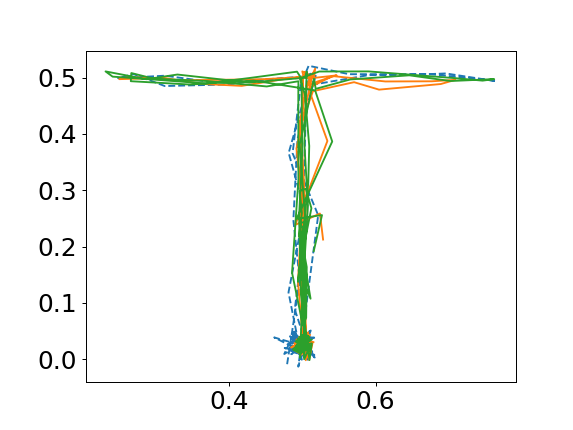

/home/munenori/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


<IPython.core.display.Javascript object>


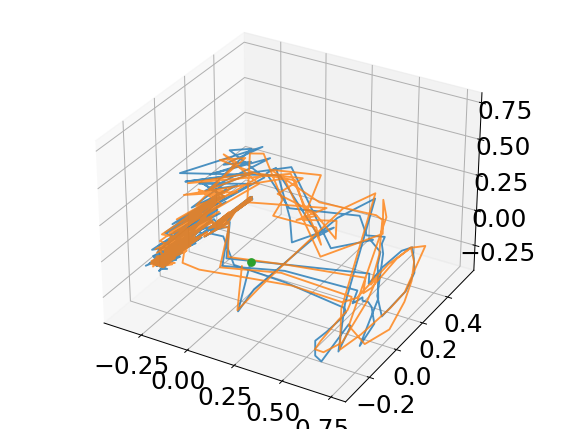

/tmp/ipykernel_2923202/4022322839.py:609: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax3d = Axes3D(fig3d)


<IPython.core.display.Javascript object>


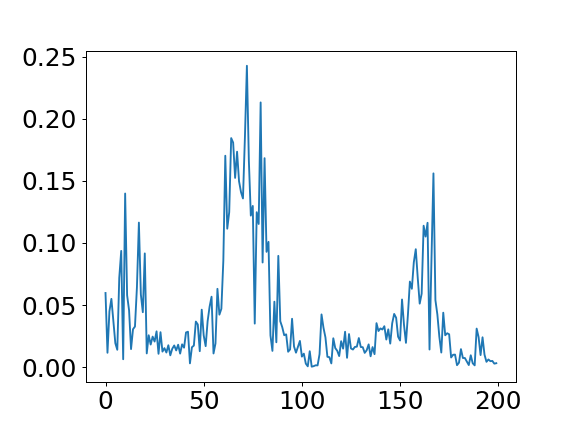

<IPython.core.display.Javascript object>


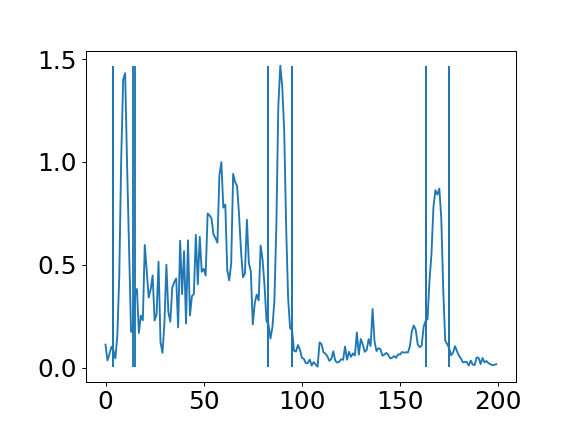

[  4.  14.  83.  95. 163. 175.] [  4.  15.  83.  95. 163. 175.]


/home/munenori/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


<IPython.core.display.Javascript object>


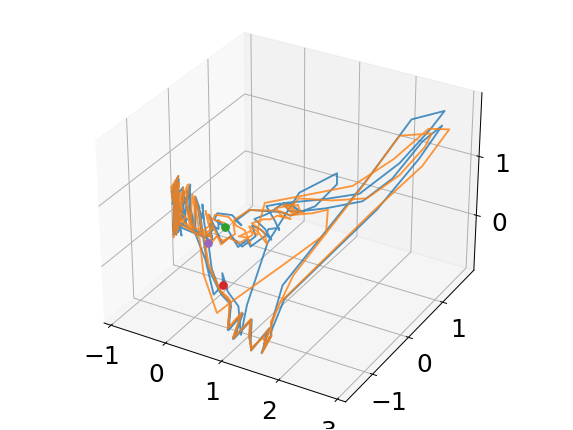

/tmp/ipykernel_2923202/4022322839.py:635: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax3d = Axes3D(fig3d)


<IPython.core.display.Javascript object>


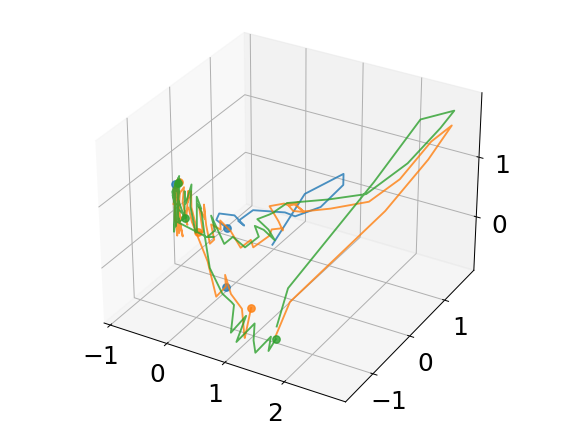

/tmp/ipykernel_2923202/4022322839.py:650: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax3d = Axes3D(fig3d)


<IPython.core.display.Javascript object>


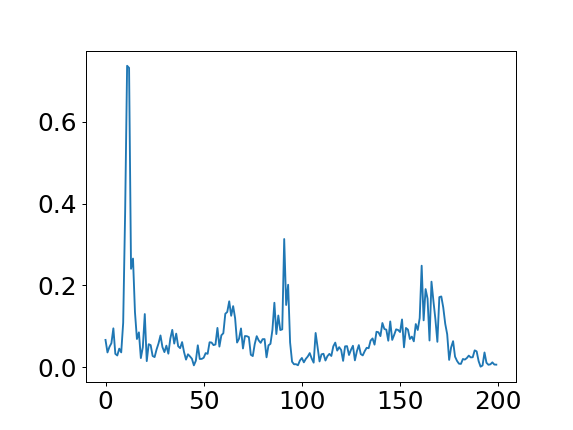

<IPython.core.display.Javascript object>


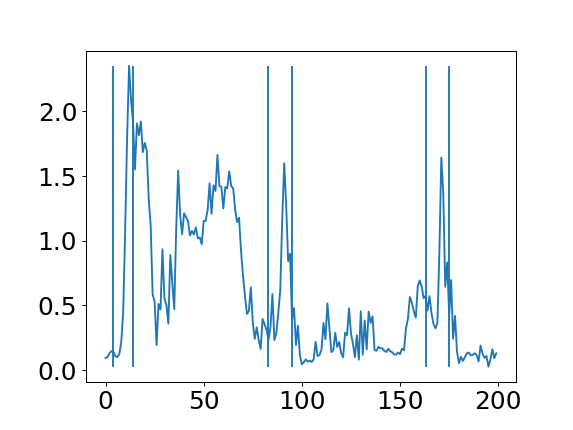

/home/munenori/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


<IPython.core.display.Javascript object>


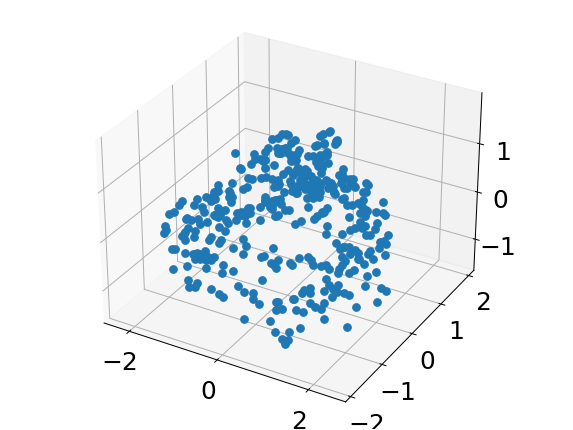

/tmp/ipykernel_2923202/4022322839.py:675: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax3d = Axes3D(fig3d)


<IPython.core.display.Javascript object>


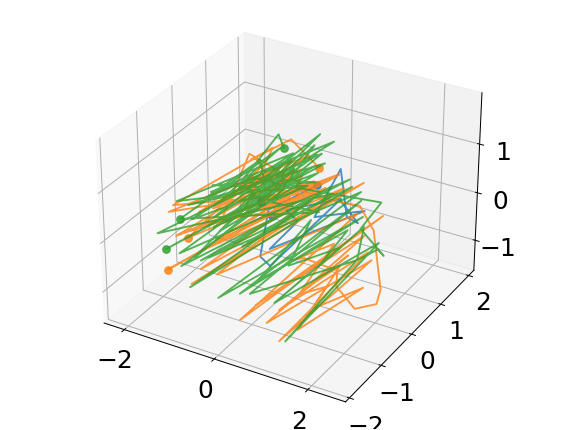

/tmp/ipykernel_2923202/4022322839.py:684: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax3d = Axes3D(fig3d)


<IPython.core.display.Javascript object>


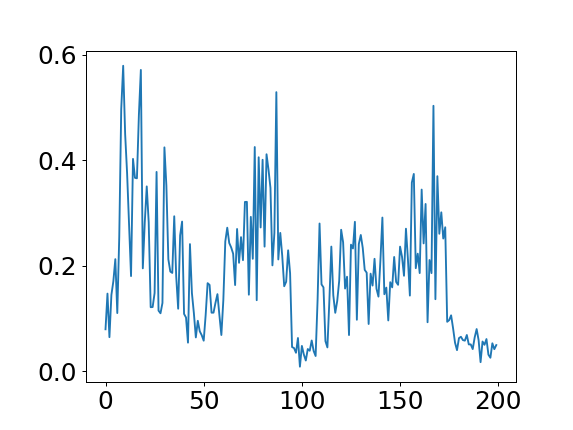

<IPython.core.display.Javascript object>


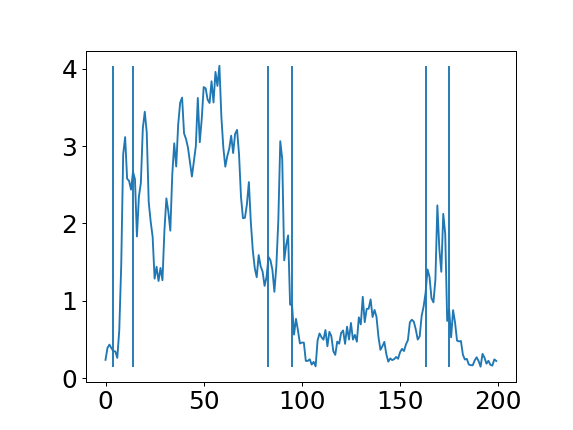

<IPython.core.display.Javascript object>


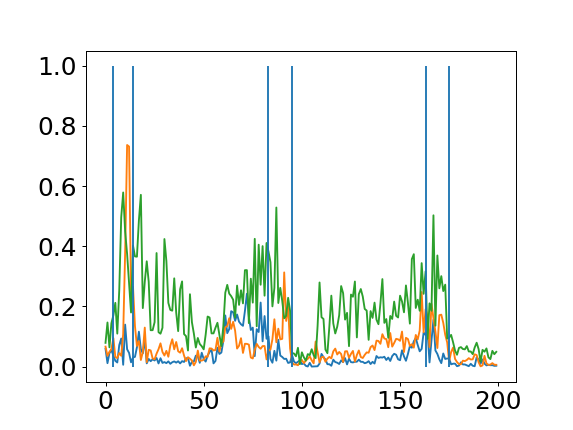

<IPython.core.display.Javascript object>


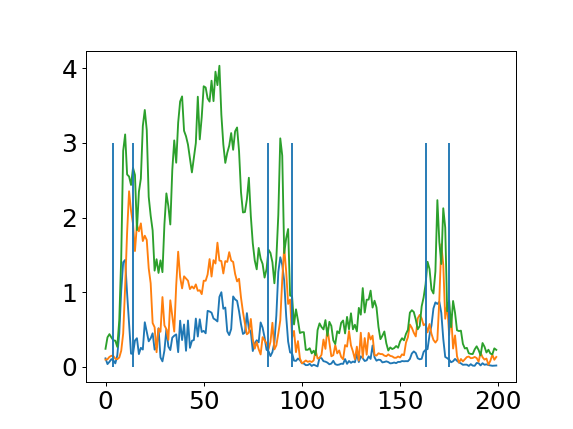

<IPython.core.display.Javascript object>


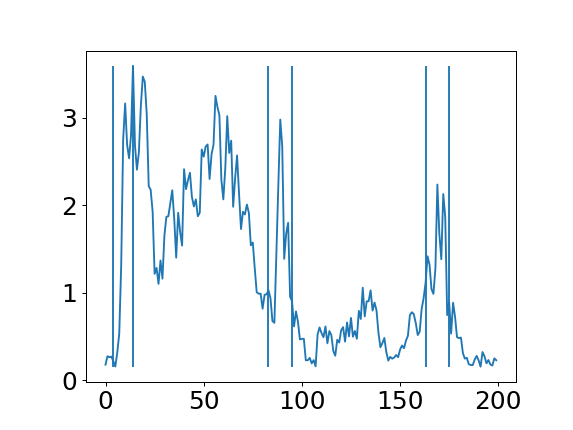

<IPython.core.display.Javascript object>


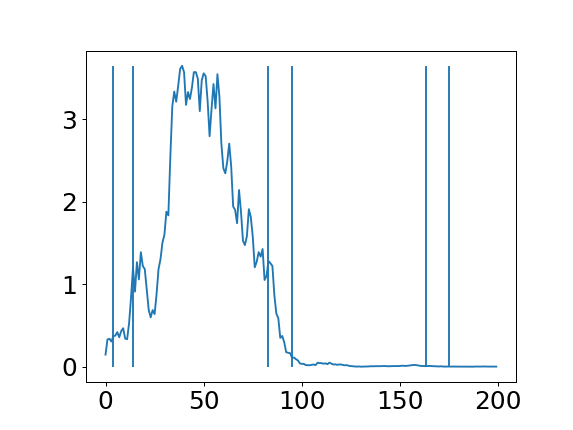

<IPython.core.display.Javascript object>


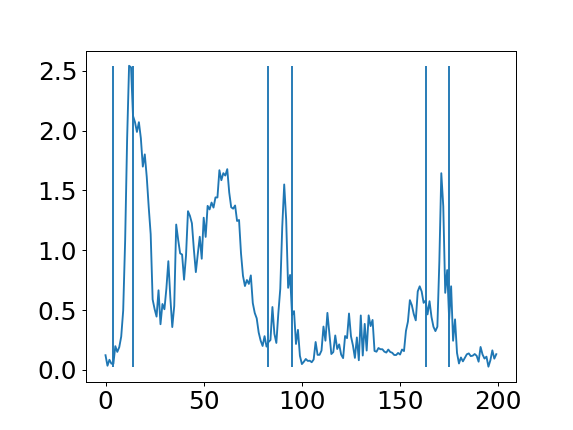

<IPython.core.display.Javascript object>


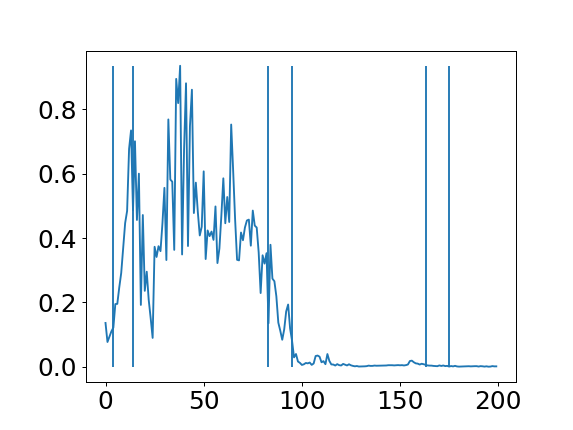

<IPython.core.display.Javascript object>


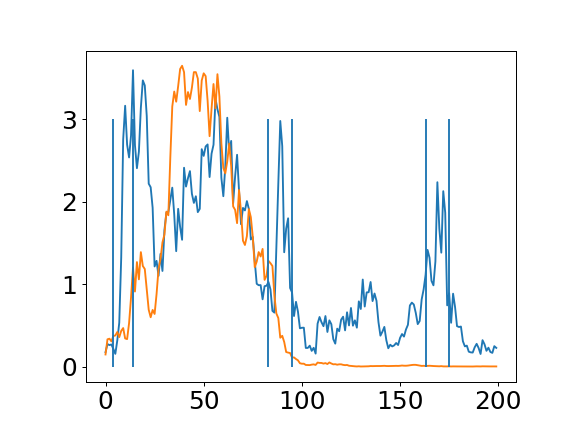

<IPython.core.display.Javascript object>


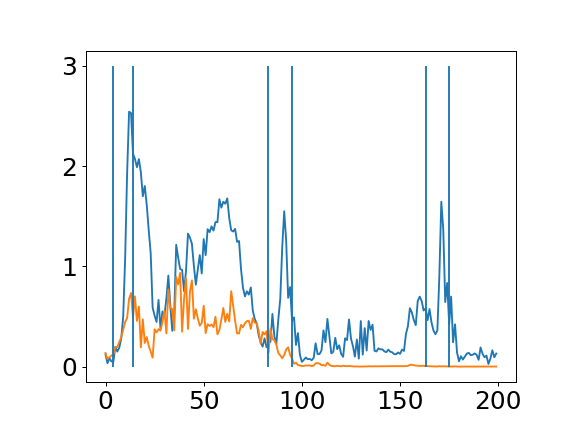

/tmp/ipykernel_2923202/4022322839.py:230: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


<IPython.core.display.Javascript object>


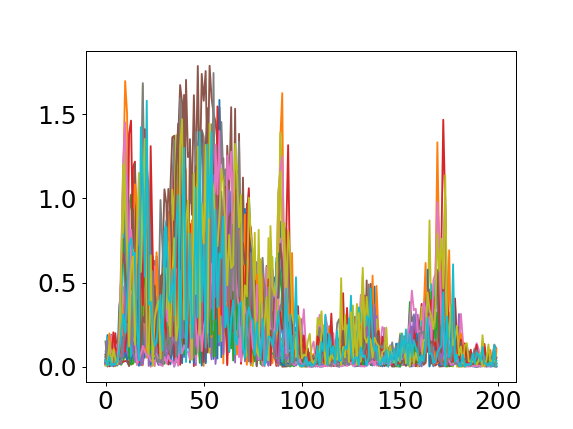

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19


<IPython.core.display.Javascript object>


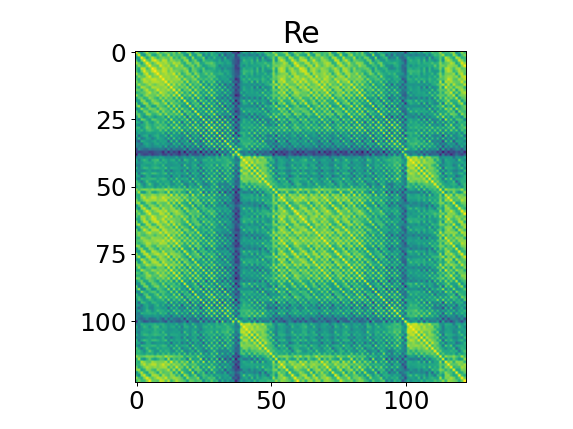

(64, 20)
(6, 20)
(6, 20)
(85, 20)
(39, 2)


<IPython.core.display.Javascript object>


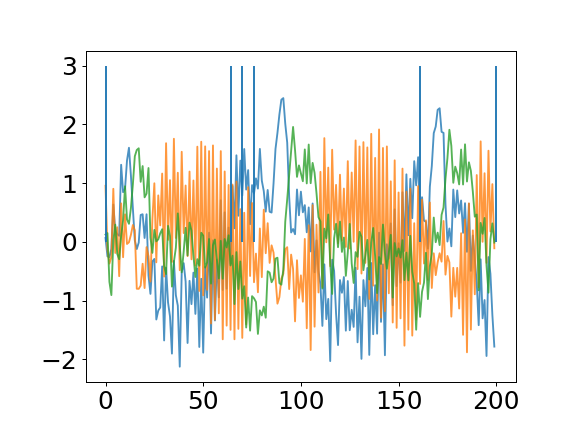

<IPython.core.display.Javascript object>


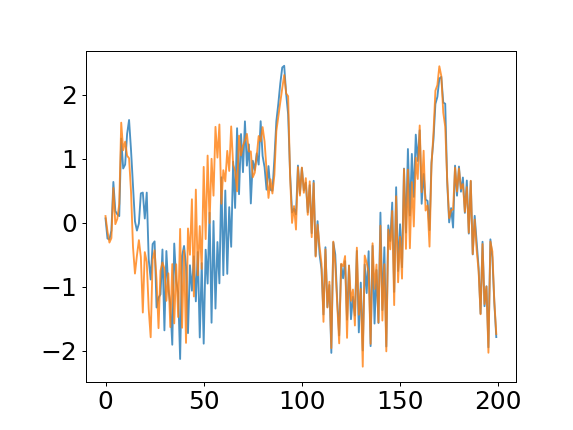

<IPython.core.display.Javascript object>


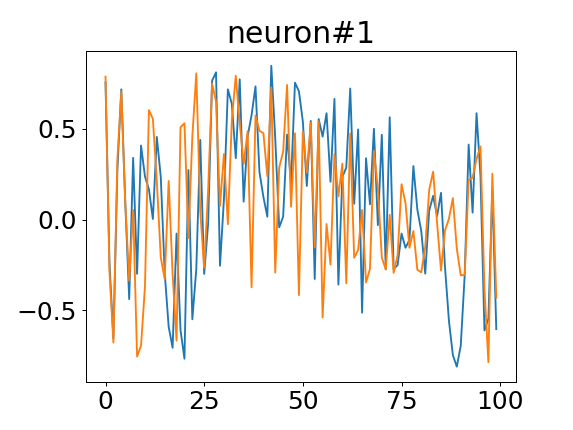

(20, 40)


<IPython.core.display.Javascript object>


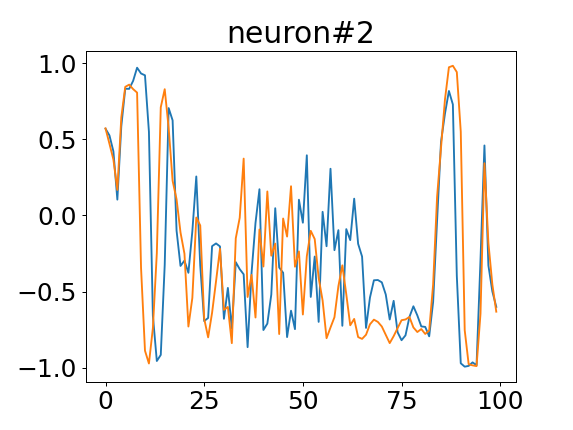

(20, 40)


<IPython.core.display.Javascript object>


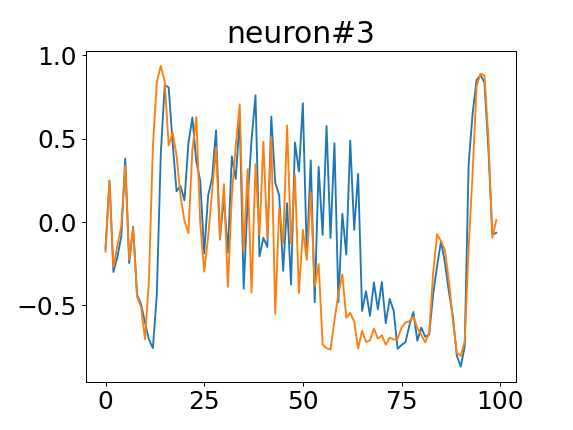

(20, 40)


<IPython.core.display.Javascript object>


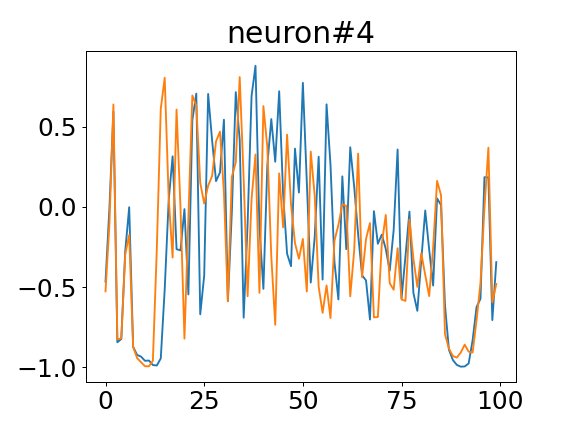

(20, 40)


<IPython.core.display.Javascript object>


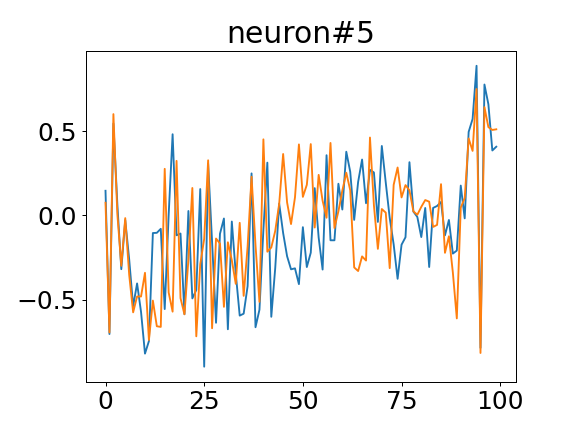

(20, 40)


<IPython.core.display.Javascript object>


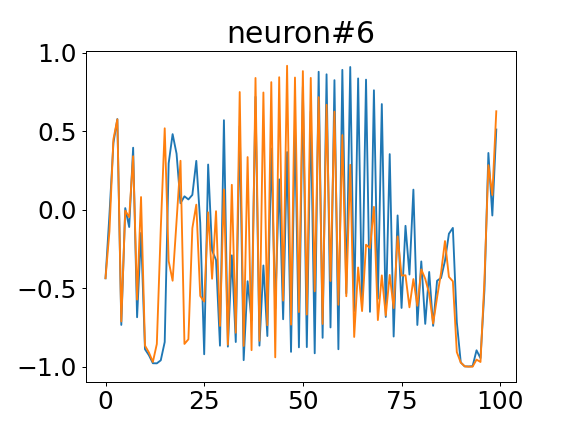

(20, 40)


<IPython.core.display.Javascript object>


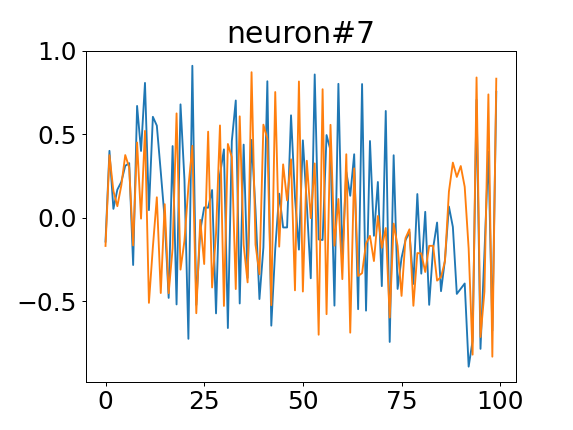

(20, 40)


<IPython.core.display.Javascript object>


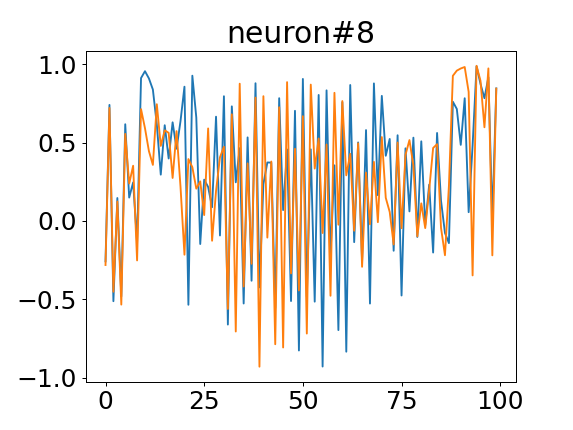

(20, 40)


<IPython.core.display.Javascript object>


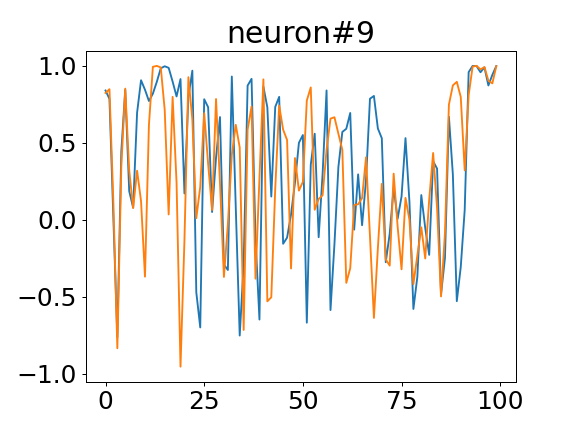

(20, 40)


<IPython.core.display.Javascript object>


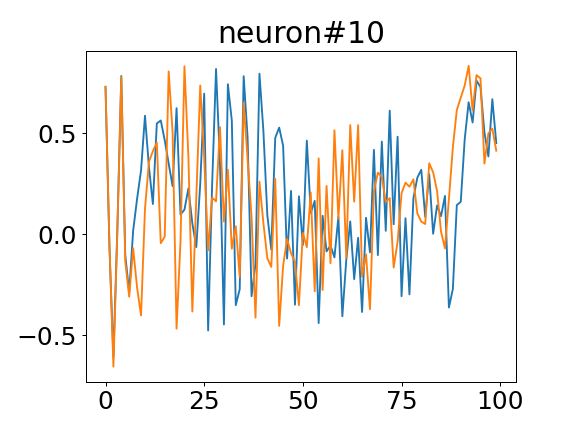

(20, 40)


<IPython.core.display.Javascript object>


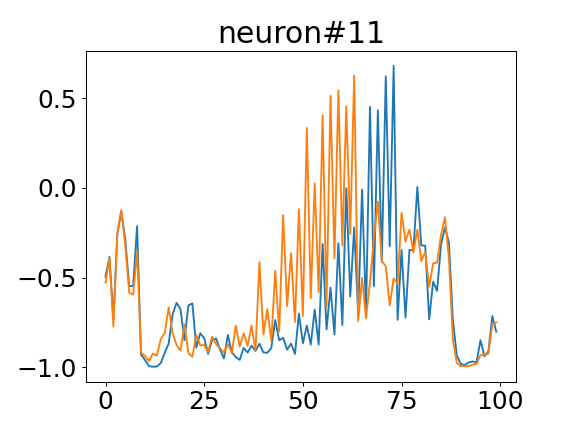

(20, 40)


<IPython.core.display.Javascript object>


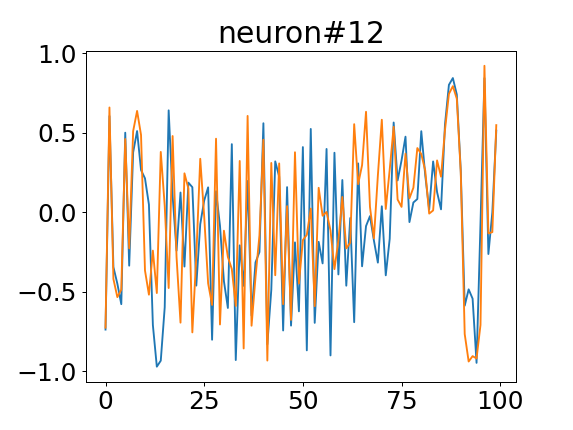

(20, 40)


<IPython.core.display.Javascript object>


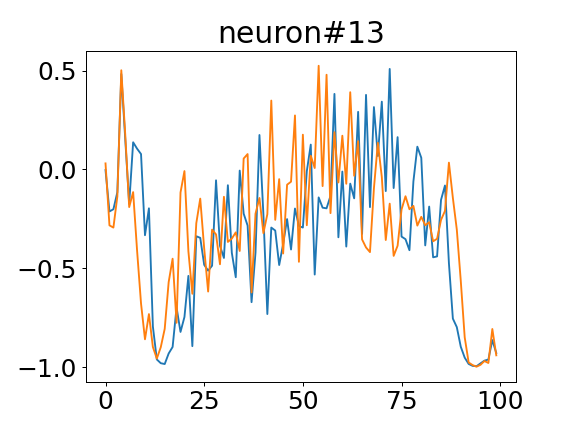

(20, 40)


<IPython.core.display.Javascript object>


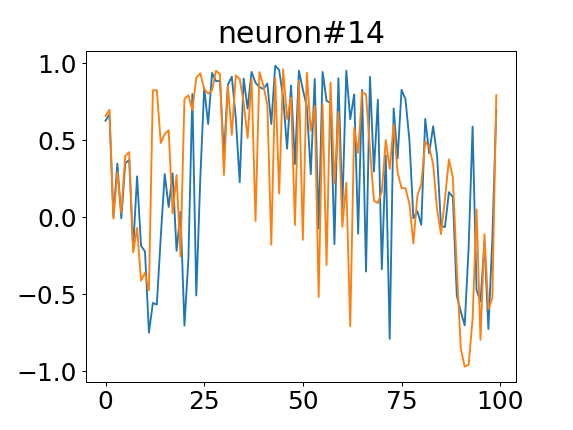

(20, 40)


<IPython.core.display.Javascript object>


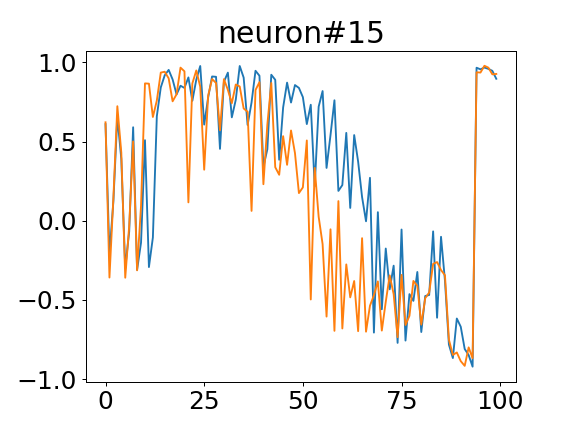

(20, 40)


<IPython.core.display.Javascript object>


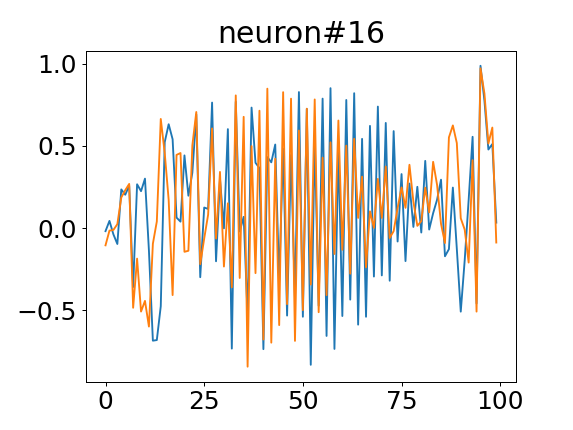

(20, 40)


<IPython.core.display.Javascript object>


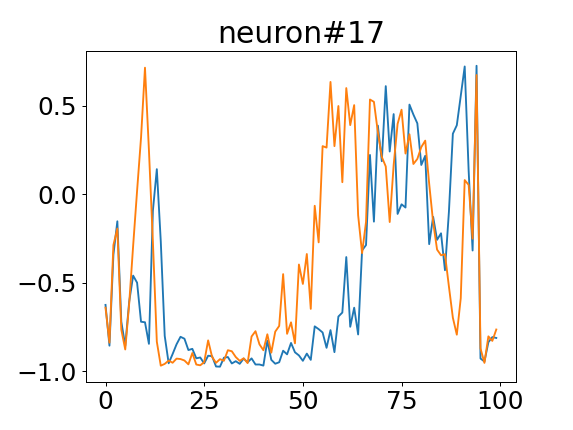

(20, 40)


<IPython.core.display.Javascript object>


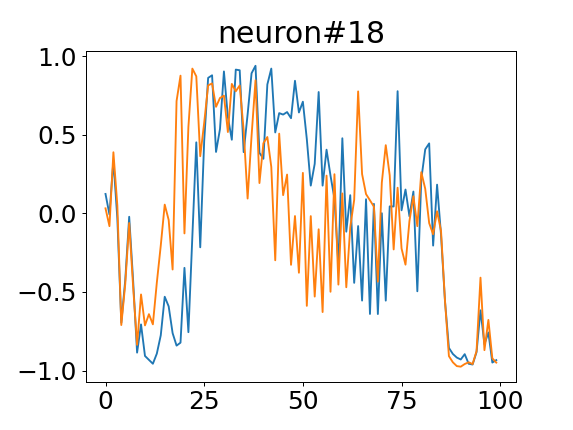

(20, 40)


<IPython.core.display.Javascript object>


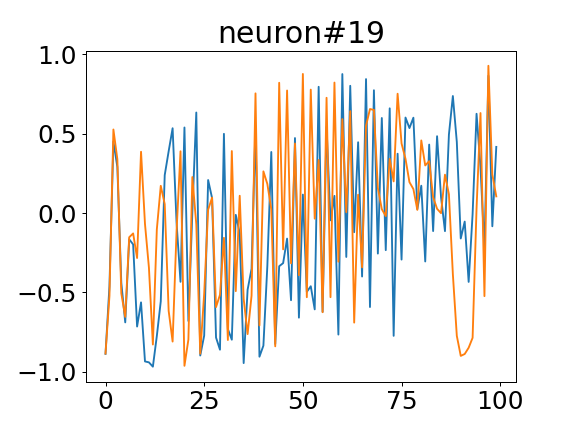

(20, 40)


<IPython.core.display.Javascript object>


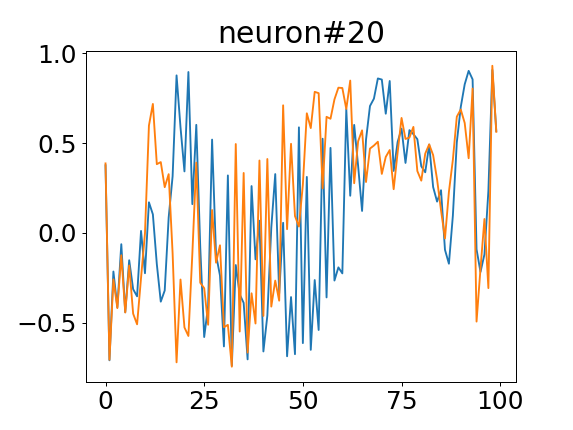

(20, 40)


In [173]:
#v4 without Re
#v4_1 revised forward function

import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import time
import math
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import sklearn 
import nolds
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D
# from tslearn.clustering import TimeSeriesKMeans
# import tslearn

%matplotlib notebook

def Culc_gate(input, params, hiddens):
    Re = hiddens[0][0]
    HPC_input = torch.cat([input,Re],dim=1)
    PFC_input = hiddens[1][0][0]
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    return [PFC_gates.tolist(), HPC_gates.tolist()]
    

def MakeAnimation(data_x,data_y,traj_x,traj_y, data_limit):
    fig, ax = plt.subplots()
    ims = []
    for t in range(traj_x.shape[0]):
        if t < data_limit:
            traj = ax.plot(data_x[:t], data_y[:t], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
#         else:
#             traj = ax.plot(data_x[:data_limit], data_y[:data_limit], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or", data_x[data_limit-1:t], data_y[data_limit-1:t], "--b")
        else:
            traj = ax.plot(traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
#             traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=30)    
    ani.save('anim_v4_2_1_r.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_data(data_x,data_y, data_limit):
    fig, ax = plt.subplots()
    ax.set_xlim(0.2,0.8)
    ax.set_ylim(-0.05,0.8)
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=30)    
    ani.save('anim_Re_0.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_attracter(data_x,data_y):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob",)
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=10)    
    ani.save('anim_attracter2.gif', writer='pillow')
    plt.show()
    
    return 0


    
def MakeAnimation_img(data,module):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data.shape[0]):
        img = ax.imshow(data[t].reshape(1,data.shape[1]))
        title = ax.text(0.5, 1.01, module+' time={}'.format(t),
             ha='center', va='bottom',
             transform=ax.transAxes, fontsize='large')
        ims.append([img,title])
    ani = animation.ArtistAnimation(fig, ims)    
    ani.save('anim_fire_'+module+'_.gif', writer='pillow')
    plt.show()
    
    return 0

def mkOwnDataSet(data_size, filename, data_length=100, freq=60., noise=0.005):
    
    x = np.loadtxt(str(filename+"_r.csv"),delimiter=',')
    y = np.loadtxt(str(filename+"_l.csv"),delimiter=',')
    train_x = []
    train_y = []
    
    for offset in range(data_size):
        train_x.append([[x[i][0] + np.random.normal(loc=0.0, scale=noise),x[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,x.shape[0],round(x.shape[0]/data_length))])
        train_y.append([[y[i][0] + np.random.normal(loc=0.0, scale=noise),y[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,y.shape[0],round(y.shape[0]/data_length))])
    return train_x, train_y


def mkOwnRandomBatch(train_x, train_t, batch_size=10):
    """
    train_x, train_tを受け取ってbatch_x, batch_tを返す
    """
    batch_x = []
    for _ in range(batch_size):
        idx = np.random.randint(0, len(train_x) - batch_size)
        batch_x.append(train_x[idx])
    return torch.tensor(batch_x).transpose(0,1)


def make_Ttraj(direction):
    traj_x = np.array([])
    traj_y = np.array([])
    straight_x = np.ones(5)*0.5
    if direction == 1:
        branch1_x = np.linspace(0.5, 0.75, 5)
        branch2_x = np.linspace(0.75, 0.5, 5)
    elif direction == 2:
        branch1_x = np.linspace(0.5, 0.25, 5)
        branch2_x = np.linspace(0.25, 0.5, 5)        
    backstraight_x = np.ones(5)*0.5

    straight_y = np.linspace(0, 0.5, 5)
    branch1_y = np.linspace(0.5, 0.5, 5)
    branch2_y = np.linspace(0.5, 0.5, 5)
    backstraight_y = np.linspace(0.5 , 0, 5)
    
    traj_x = np.append(traj_x, [straight_x,branch1_x,branch2_x,backstraight_x])
    traj_y = np.append(traj_y, [straight_y,branch1_y,branch2_y,backstraight_y])
    traj = np.concatenate([[traj_x],[traj_y]],axis=0).T
    return traj

def make_traj(delay_length):
    freq=60
    noise=0.005
    data_length = 20
    
    # x = np.loadtxt("right1.csv",delimiter=',')
    x = make_Ttraj(1)
    # y = np.loadtxt("left1.csv",delimiter=',')
    y = make_Ttraj(2)
    z = np.loadtxt("stay1.csv",delimiter=',')
    data_x = np.array([[0,0]])
    data_y = np.array([[0,0]])
#     order  = np.array([1,0,0,1])
    order  = np.array([1])
    order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [2,0,0,2])
    order = np.append(order, [2])
    # order = [1,0,0,0,2]
    # order = [2,0,0,1,0,0,0,2,0,0,1]
    for idx in order:
        if idx == 1:
            target_x = x
            target_y = y
        elif idx == 0:
            target = np.array([[z[i][0],z[i][1]] for i in np.random.choice(z.shape[0], 20)])
            target_x = target
            target_y = target
        else:
            target_x = y
            target_y = x
        if idx != 0:
            target_x += np.random.normal(loc=0.0, scale=noise, size=target_x.shape)
            target_y += np.random.normal(loc=0.0, scale=noise, size=target_y.shape)

        data_x = np.append(data_x,target_x,axis=0)
        data_y = np.append(data_y,target_y,axis=0)
        
    print(data_x.shape,data_y.shape)
    return data_x[1:],data_y[1:]

def mkOwnDataSet_auto(data_size, delay_length, freq=60., noise=0.01):
   
    x,y = make_traj(delay_length)
    train_x = []
    train_y = []
    
    for offset in range(data_size):
        train_x.append([[x[i][0] + np.random.normal(loc=0.0, scale=noise),x[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(x.shape[0])])
        train_y.append([[y[i][0] + np.random.normal(loc=0.0, scale=noise),y[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(y.shape[0])])
    return train_x, train_y

def plot_distance_bet2traj(traj1,traj2,linelist):
    traj1 = np.array(traj1)
    traj2 = np.array(traj2)
    result = []
    for i in range(traj1.shape[0]):
        result.append(np.linalg.norm(traj1[i]-traj2[i]))
    plt.figure()
    plt.plot(result)
    
    plt.vlines(linelist,np.min(result),np.max(result))
    
    return result

def distance_bet2traj(traj1,traj2):
    traj1 = np.array(traj1)
    traj2 = np.array(traj2)
    result = []
    for i in range(traj1.shape[0]):
        result.append(np.linalg.norm(traj1[i]-traj2[i]))
    return result

def plot_activity_bet2traj(traj1,traj2,linelist):
    traj1 = np.array(traj1)
    traj2 = np.array(traj2)
    result = []
    threshold = 0.5
    for i in range(traj1.shape[0]):
        result.append(np.abs(traj1[i]-traj2[i]))
        
    plt.figure()
    for i,data in enumerate(np.array(result).T):
        if np.any(data[20:105]>threshold):
            print(i)
            plt.plot(data)
    
    return result

def search_delay(traj):
    linelist = np.array([])
    flag = False
    for i in range(traj.shape[0]):
        if traj[i,1] > 0.45 and flag == False:
            linelist = np.append(linelist,i)
            flag = True
        if traj[i,1] < 0.45 and flag == True:
            linelist = np.append(linelist,i)
            flag = False
    return linelist

def pick_delay(traj,states):
    pointlist = np.array([])
    flag = False
    threshold = 0.2
    for i in range(traj.shape[0]):
        if i < 5:
            continue
        if traj[i,1] < threshold and flag == False:
            pointlist = np.append(pointlist,i)
            flag = True
        if traj[i,1] > threshold and flag == True:
            pointlist = np.append(pointlist,i)
            flag = False
    states_list = []
    start = 0
    for i,k in enumerate(pointlist):
        end = int(k)
        if i % 2 != 0:
            states_list.append(states[start:end])
        start = int(k)
    states_list.append(traj[start:])
    return states_list

def pick_traj(traj,states):
    pointlist = np.array([])
    flag = False
    threshold = 0.2
    for i in range(traj.shape[0]):
        if i < 5:
            continue
        if traj[i,1] < threshold and flag == False:
            pointlist = np.append(pointlist,i)
            flag = True
        if traj[i,1] > threshold and flag == True:
            pointlist = np.append(pointlist,i)
            flag = False
    states_list = []
    start = 0
    for i,k in enumerate(pointlist):
        end = int(k)
        if i % 2 != 0:
            states_list.append(states[start:end])
            start = int(k)
    states_list.append(traj[start:])
    return states_list

def match_length(states_list):
    min_length = 1000
    result = []
    for state in states_list:
        min_length = np.min((min_length, len(state)))
    for state in states_list:
        result.append(state[-min_length:])
        
    return result

def vec_var(datas):
    datas = np.array(datas)
    average = np.average(datas,axis=0)
    result = 0
    for data in datas:
        result += np.linalg.norm(data-average)
    result /= datas.shape[0]
    return result
    
def lyapunov_exp(data):
    result = np.mean(np.log(np.abs(np.diff(data))))
    return result

class MyLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        nn.init.sparse_(self.PFC.weight_ih.data,1)
        nn.init.sparse_(self.HPC.weight_ih.data,1)
        nn.init.sparse_(self.PFC.weight_hh.data,1)
        nn.init.sparse_(self.HPC.weight_hh.data,1)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2][0]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,Re_hidden]

class MyLSTM_RNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse=5):
        super(MyLSTM_RNN, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        input = input.float()
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.1
        var = 0.1
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_test(self):
        const = 0.2
        var = 0.2
#         HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        HPC_hidden = [torch.ones(self.batch_size, self.hidden_size_HPC)*const, torch.ones(self.batch_size, self.hidden_size_HPC)*const]
#         PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        PFC_hidden = [torch.ones(self.batch_size, self.hidden_size_PFC)*const, torch.ones(self.batch_size, self.hidden_size_PFC)*const]
#         Re_hidden = torch.ones(self.batch_size, self.hidden_size_Re)*const
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*var
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0
        v = 0.1
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*v
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def noiseHidden_select(self, hiddens):
        c = 0
        v = 0.01
        index = np.array([1,2,8,9,17])
        HPC_hidden = torch.zeros(self.batch_size, self.hidden_size_HPC)
        HPC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.zeros(self.batch_size, self.hidden_size_PFC)
        PFC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size_Re)*c
        Re_hidden[:,index] += torch.randn(self.batch_size, index.size)*v
#         Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*v
#         Re_hidden[:,index] = torch.zeros(self.batch_size, index.size)*c
#         Re_hidden = torch.zeros(self.batch_size, self.hidden_size_Re)*c
#         Re_hidden[:,index] += hiddens[2][:,index]*v
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def noiseHidden_dis(self, hiddens, statr, statl):
        c = 0
        v =-0.1
        index = np.array([1,2,8,9,17])
        HPC_hidden = torch.zeros(self.batch_size, self.hidden_size_HPC)
        HPC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.zeros(self.batch_size, self.hidden_size_PFC)
        PFC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*0.0
        Re_hidden += (-statr+statl)*v
#         Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*v
#         Re_hidden[:,index] = torch.zeros(self.batch_size, index.size)*c
#         Re_hidden = torch.zeros(self.batch_size, self.hidden_size_Re)*c
#         Re_hidden[:,index] += hiddens[2][:,index]*v
        hiddens[2].add_(Re_hidden)
        return hiddens


def main():
    training_size = 100
    test_size = 1000
    epochs_num = 10
    hidden_size = 20
    batch_size = 10
    data_length = 100
    inputsize = 2
    outputsize = 2
    delay_length = 3
#     model_path = 'model/ReModel_interRNN_long131test_s7_100_1.pth'
#     model_path = 'model/ReModel_interRNNrand_AddRe_OUT5_161_s5_100_1.pth'
#     model_path = 'model/ReModel_L2_interRNNrand_AddRe_OUT5_1212121_s9_100_1_2_2.pth'
#     model_path = 'model/ReModel_L2_interRNNrand_AddRe_OUT5_1212121_s5_100_4.pth'
#     model_path = 'model/R20/ReModel_L2_interRNNrand_OUT5_151_s5_100_1_epoch125.pth'
    model_path = 'model/R20_traintest_bigbatch/ReModel_L2_interRNNrand_OUT1_131_s2_100_1_epoch185.pth'

    
    filename = "primal_long131test"
    
    colors = ['C0','C1','C2','C3','C4','C9']
    
    train_x,train_y = mkOwnDataSet_auto(training_size,delay_length)

    rnn = MyLSTM_RNN(inputsize, hidden_size, outputsize, batch_size)

    rnn.load_state_dict(torch.load(model_path))
    
    data = mkOwnRandomBatch(train_x, batch_size)
    
    params = []
    for p in rnn.parameters():
        params.append(p.data)
     
    traj = []
    PFCstate = []
    HPCstate = []
    Restate = []
    Gate_states = []
    hidden = rnn.initHidden_test()
    data_limit = 100
    est_length = 1
    init_point = torch.rand(10,2)*1
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
#             output,hidden = rnn(init_point,hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            #Gate_states.append(Culc_gate(output,params,hidden))
    for k in range(data.shape[0]*est_length):
            output,hidden = rnn(output,hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            #Gate_states.append(Culc_gate(output,params,hidden))
            
    hidden = rnn.initHidden_test()
    data = mkOwnRandomBatch(train_y, batch_size)
    init_point = init_point*1
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
#             output,hidden = rnn(init_point,hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            #Gate_states.append(Culc_gate(output,params,hidden))
    for k in range(data.shape[0]*est_length):
#             hidden = rnn.noiseHidden_rand(hidden)
            output,hidden = rnn(output,hidden) 
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            #Gate_states.append(Culc_gate(output,params,hidden))
    traj = torch.tensor(traj)
    pltdata = torch.squeeze(data).numpy()
    traj = torch.squeeze(traj).numpy()
    
    dividenum = int(np.array(PFCstate)[0:,0].shape[0]/2)
    traj_noise = []
    PFCstate_noise = []
    HPCstate_noise = []
    Restate_noise = []
    hidden = rnn.initHidden_test()
    data = mkOwnRandomBatch(train_y, batch_size)
    init_point = init_point*1
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
#             output,hidden = rnn(init_point,hidden)
            traj_noise.append(output.tolist())
            PFCstate_noise.append(hidden[0][0].tolist())
            HPCstate_noise.append(hidden[1][0].tolist())
            Restate_noise.append(hidden[2][0].tolist())
            #Gate_states.append(Culc_gate(output,params,hidden))
    for k in range(data.shape[0]*est_length):
#             hidden = rnn.noiseHidden_rand(hidden)
            output,hidden = rnn(output,hidden) 
#             hidden = rnn.noiseHidden_dis(hidden, np.array(Restate)[k+data_limit], np.array(Restate)[dividenum+k+data_limit])
#             hidden = rnn.noiseHidden_rand(hidden)
            traj_noise.append(output.tolist())
            PFCstate_noise.append(hidden[0][0].tolist())
            HPCstate_noise.append(hidden[1][0].tolist())
            Restate_noise.append(hidden[2][0].tolist())
            #Gate_states.append(Culc_gate(output,params,hidden))
    traj_noise = torch.tensor(traj_noise)
    traj_noise = torch.squeeze(traj_noise).numpy()

    
    print(np.array(PFCstate)[:,0].shape)
#     MakeAnimation(pltdata[:,0,0],pltdata[:,0,1], traj[:,0,0], traj[:,0,1], data_limit)
    #MakeAnimation_img(np.array(PFCstate)[:,0],"PFC")
    #MakeAnimation_img(np.array(HPCstate)[:,0],"HPC")

    for n, p in rnn.named_parameters():
            if n == "PFC.weight_ih":
                PFC_w = np.array(p.data)
            if n == "HPC.weight_ih":
                HPC_w = np.array(p.data)
            if n == "Re.weight_ih":
                Re_w = np.array(p.data)
    
    pca = PCA()
    dfs = np.array(HPCstate)[0:,0]
    pca.fit(dfs)
    feature = pca.transform(dfs)
    
    dividenum = int(np.array(feature).shape[0]/2)
    
#     MakeAnimation(traj[:dividenum,0,0],traj[:dividenum,0,1], traj[dividenum:,0,0], traj[dividenum:,0,1], data_limit)
#     MakeAnimation(traj[:dividenum,0,0],traj[:dividenum,0,1], traj_noise[:,0,0], traj_noise[:,0,1], data_limit)
#     MakeAnimation_img(np.array(PFCstate)[:dividenum,0],"PFCr")
#     MakeAnimation_img(np.array(PFCstate)[dividenum:,0],"PFCl")
#     MakeAnimation_img(np.array(PFCstate_noise)[:,0],"PFCnoise")
    
    fig = plt.figure()
    plt.plot(pltdata[:,0,0],pltdata[:,0,1],"--")
    plt.plot(traj[:dividenum,0,0],traj[:dividenum,0,1])
    plt.plot(traj[dividenum:,0,0],traj[dividenum:,0,1])
    plt.show()
    
    linelist = search_delay(traj[:dividenum,0])
    linelist2 = search_delay(traj[dividenum:,0])
    linelist_all = np.append(linelist,linelist2)
    
    pred = KMeans(n_clusters=2).fit_predict(feature)
    
    fig3d = plt.figure()
    ax3d = Axes3D(fig3d)
    ax3d.plot(feature[:dividenum, 0], feature[:dividenum, 1], feature[:dividenum, 2], alpha=0.8)
    ax3d.plot(feature[dividenum:, 0], feature[dividenum:, 1], feature[dividenum:, 2], alpha=0.8)
    ax3d.plot(feature[0:1, 0], feature[0:1, 1], feature[0:1, 2],"o", alpha=1)
    plt.show()
#     for i in range(20):
#         fig_place = plt.figure()
#         place3d = Axes3D(fig_place)
#         place3d.plot(traj[:,0,0], traj[:,0,1], np.array(HPCstate)[:,0,i])
#         plt.show()
    
    plot_distance(feature[:dividenum],feature[dividenum:])
    HPC_dis = overlap_coefficient(feature[:dividenum],feature[dividenum:])
    
    HPC_samedis = plot_distance_bet2traj(np.array(HPCstate)[:dividenum,0],np.array(HPCstate)[dividenum:,0],linelist_all)
    
    print(linelist,linelist2)
    
    pca = PCA()
    dfs = np.array(PFCstate)[0:,0]
    pca.fit(dfs)
    feature = pca.transform(dfs)
    
    pred = KMeans(n_clusters=2).fit_predict(feature)
    
    fig3d = plt.figure()
    ax3d = Axes3D(fig3d)
    ax3d.plot(feature[:dividenum, 0], feature[:dividenum, 1], feature[:dividenum, 2], alpha=0.8)
    ax3d.plot(feature[dividenum:, 0], feature[dividenum:, 1], feature[dividenum:, 2], alpha=0.8)
    ax3d.plot(feature[0:1, 0], feature[0:1, 1], feature[0:1, 2],"o", alpha=1)
    ax3d.plot(feature[20:21, 0], feature[20:21, 1], feature[20:21, 2],"o", alpha=1)
    ax3d.plot(feature[60:61, 0], feature[60:61, 1], feature[60:61, 2],"o", alpha=1)
    plt.show()
#     for i in range(20):
#         fig_place = plt.figure()
#         place3d = Axes3D(fig_place)
#         place3d.plot(traj[:,0,0], traj[:,0,1], np.array(PFCstate)[:,0,i])
#         plt.show()

#   ### for 3d divided plot ###
    fig3d = plt.figure()
    ax3d = Axes3D(fig3d)
    end = 0
    for i in range(3):
        start = end
        end = int(linelist[i*2+1])
        ax3d.plot(feature[start:start+1, 0], feature[start:start+1, 1], feature[start:start+1, 2], "o", color=colors[i], alpha=0.8)
        ax3d.plot(feature[start+20:start+21, 0], feature[start+20:start+21, 1], feature[start+20:start+21, 2], "o", color=colors[i], alpha=0.8)
        ax3d.plot(feature[start+40:start+41, 0], feature[start+40:start+41, 1], feature[start+40:start+41, 2], "o", color=colors[i], alpha=0.8)
        ax3d.plot(feature[start:end, 0], feature[start:end, 1], feature[start:end, 2], color=colors[i], alpha=0.8)
    plt.show()
    
    
    plot_distance(feature[:dividenum],feature[dividenum:])
    PFC_dis = overlap_coefficient(feature[:dividenum],feature[dividenum:])
    
    PFC_samedis = plot_distance_bet2traj(np.array(PFCstate)[:dividenum,0],np.array(PFCstate)[dividenum:,0],linelist)

    pca = PCA()
    dfs = np.array(Restate)
    pca.fit(dfs)
    feature = pca.transform(dfs)
    
    pred = KMeans(n_clusters=2).fit_predict(feature)
    
    fig3d = plt.figure()
    ax3d = Axes3D(fig3d)
#     ax3d.plot(feature[:dividenum, 0], feature[:dividenum, 1], feature[:dividenum, 2], alpha=0.8)
#     ax3d.plot(feature[dividenum:, 0], feature[dividenum:, 1], feature[dividenum:, 2], alpha=0.8)
#     ax3d.plot(feature[0:1, 0], feature[0:1, 1], feature[0:1, 2],"o", alpha=1)
    ax3d.plot(feature[:, 0], feature[:, 1], feature[:, 2],"o", alpha=1)
    plt.show()
    
#   ### for 3d divided plot ###
    fig3d = plt.figure()
    ax3d = Axes3D(fig3d)
    end = 0
    for i in range(3):
        start = end
        end = int(linelist[i*2+1])
        ax3d.plot(feature[start:start+1, 0], feature[start:start+1, 1], feature[start:start+1, 2], "o", color=colors[i], alpha=0.8)
        ax3d.plot(feature[start+20:start+21, 0], feature[start+20:start+21, 1], feature[start+20:start+21, 2], "o", color=colors[i], alpha=0.8)
        ax3d.plot(feature[start+40:start+41, 0], feature[start+40:start+41, 1], feature[start+40:start+41, 2], "o", color=colors[i], alpha=0.8)
#         ax3d.plot(feature[start+20:start+21, 0], feature[start+20:start+21, 1], feature[start+20:start+21, 2], "o", color=colors[i], alpha=0.8)
        ax3d.plot(feature[start:end, 0], feature[start:end, 1], feature[start:end, 2], color=colors[i], alpha=0.8)
    plt.show()

    plot_distance(feature[:dividenum],feature[dividenum:])
    Re_dis = overlap_coefficient(feature[:dividenum],feature[dividenum:])
    
#     MakeAnimation(feature[:dividenum, 0], feature[:dividenum, 1], feature[dividenum:, 0], feature[dividenum:, 1], data_limit)

    Re_samedis = plot_distance_bet2traj(Restate[:dividenum],Restate[dividenum:],linelist)
    
    
    
    plt.figure()
    plt.plot(HPC_dis)
    plt.plot(PFC_dis)
    plt.plot(Re_dis)
    plt.vlines(linelist,0,1)
    plt.show()
    
    plt.figure()
    plt.plot(HPC_samedis)
    plt.plot(PFC_samedis)
    plt.plot(Re_samedis)
    plt.vlines(linelist,0,3)
    plt.show()
    
    Re_noisedisr = plot_distance_bet2traj(Restate[:dividenum],Restate_noise[:],linelist)
    Re_noisedisl = plot_distance_bet2traj(Restate[dividenum:],Restate_noise[:],linelist)
    PFC_noisedisr = plot_distance_bet2traj(np.array(PFCstate)[:dividenum,0],np.array(PFCstate_noise)[:,0],linelist)
    PFC_noisedisl = plot_distance_bet2traj(np.array(PFCstate)[dividenum:,0],np.array(PFCstate_noise)[:,0],linelist)
    plt.figure()
    plt.plot(Re_noisedisr)
    plt.plot(Re_noisedisl)
    plt.vlines(linelist,0,3)
    plt.show()
    
    plt.figure()
    plt.plot(PFC_noisedisr)
    plt.plot(PFC_noisedisl)
    plt.vlines(linelist,0,3)
    plt.show()
    
    plot_activity_bet2traj(Restate[dividenum:],Restate[:dividenum],linelist)
#     plot_activity_bet2traj(np.array(PFCstate)[:dividenum,0],np.array(PFCstate)[dividenum:,0],linelist)

    points = np.array(np.where(traj_noise[:,0,1]<0.05)[0]).astype("int64")
    Replot = plt.figure()
    axre2 = Replot.add_subplot(111)
    axre2.imshow(np.corrcoef(np.array(np.array(Restate_noise)[points])))
    axre2.set_title("Re")  
    
    pca = PCA()
#     dfs = np.array(np.array(Restate_noise)[points])
    dfs = np.array(np.array(Restate))
#     dfs = np.array(HPCstate)[0:,0]
    pca.fit(dfs)
    feature = pca.transform(dfs)    
    
#     delays = pick_delay(traj_noise[:,0], np.array(PFCstate_noise)[:,0])
#     delays = pick_delay(traj_noise[:,0], np.array(Restate_noise))
#     delays = pick_traj(traj_noise[:,0], np.array(PFCstate_noise)[:,0])
    delays = pick_traj(traj_noise[:,0], np.array(feature))
    linelist_delay = [0]
    for i in delays:
        print(np.array(i).shape)
        linelist_delay.append(linelist_delay[-1]+len(i))
    
    fig = plt.figure()
    plt.plot(feature[:dividenum, 0], alpha=0.8)
    plt.plot(feature[:dividenum, 1], alpha=0.8)
    plt.plot(feature[:dividenum, 2], alpha=0.8)
    plt.vlines(linelist_delay,0,3)
    plt.show()
    
    fig = plt.figure()
    plt.plot(feature[:dividenum, 0], alpha=0.8)
    plt.plot(feature[dividenum:, 0], alpha=0.8)
    plt.show()
    
#     fig = plt.figure()
#     plt.plot(feature[:dividenum, 2], alpha=0.8)
#     plt.show()
    
#     fig = plt.figure()
#     plt.plot(feature[:dividenum, 0]+feature[:dividenum, 1]+feature[:dividenum, 2], alpha=0.8)
# #     plt.vlines(linelist,0,3)
#     plt.show()

#     print(np.array(delays[:-1]).shape)
#     tskm = TimeSeriesKMeans(n_clusters=4,metric='euclidean',max_iter=200)
    
#     data_kmeans = match_length(delays[:-1])
#     tskm_pred = tskm.fit_predict(np.array(data_kmeans))
#     print(tskm_pred)
#     tskm_feature = tskm.transform(np.array(data_kmeans))
#     print(tskm_feature)

#     fig = plt.figure()
# #     plt.plot(distance_bet2traj(delays[0][:40],delays[1][:40]))
# #     plt.plot(distance_bet2traj(delays[0][:40],delays[2][:40]))
# #     plt.plot(distance_bet2traj(delays[0][:40],delays[3][:40]))
    
#     data = match_length(delays[:-1])
#     for k in range(6):
#         fig = plt.figure()
#         target = k
#         for i in range(6):
#             plt.plot(distance_bet2traj(data[target][:],data[i][:]))
#         plt.show()
    
#     plt.show()
    
# #     delays = pick_delay(traj_noise[:,0], np.array(PFCstate_noise)[:,0])
# #     delays = pick_traj(traj_noise[:,0], np.array(HPCstate_noise)[:,0])
# #     delays = pick_delay(traj_noise[:,0], np.array(Restate_noise))
#     delays = pick_traj(traj_noise[:,0], np.array(PFCstate_noise)[:,0])
# #     delays = pick_traj(traj_noise[:,0], np.array(Restate_noise))
#     linelist_delay = [0]

#     print(np.array(delays[:-1]).shape)
#     tskm = TimeSeriesKMeans(n_clusters=4,metric='euclidean',max_iter=200)
    
#     data_kmeans = match_length(delays[:-1])
#     tskm_pred = tskm.fit_predict(np.array(data_kmeans))
#     print(tskm_pred)
#     tskm_feature = tskm.transform(np.array(data_kmeans))
#     print(tskm_feature)

#     fig = plt.figure()
    
#     data = match_length(delays[:-1])
#     for k in range(6):
#         fig = plt.figure()
#         target = k
#         for i in range(6):
#             plt.plot(distance_bet2traj(data[target][:],data[i][:]))
#         plt.show()
    
#     plt.show()
    
#     stacked_data = np.array(data)[:,:,0]
#     cellsize = 20
    
#     for i in range(cellsize-1):
#         num = int(i+1)
#         np.array(data)[:,:,num]
#         stacked_data = np.concatenate([stacked_data,np.array(data)[:,:,num]],axis=0)
                                      
#     pca = PCA()
# #     dfs = np.array(data)[:,:,0]
#     dfs = stacked_data
# #     dfs = np.array(np.array(Restate_noise))
# #     dfs = np.array(HPCstate)[0:,0]
#     pca.fit(dfs)
#     feature = pca.transform(dfs)  
#     print(dfs.shape)
    
#     fig3d = plt.figure()
#     ax3d = Axes3D(fig3d)
# #     ax3d.plot(feature[:dividenum, 0], feature[:dividenum, 1], feature[:dividenum, 2], alpha=0.8)
# #     ax3d.plot(feature[dividenum:, 0], feature[dividenum:, 1], feature[dividenum:, 2], alpha=0.8)
# #     ax3d.plot(feature[0:1, 0], feature[0:1, 1], feature[0:1, 2],"o", alpha=1)
# #     ax3d.plot(feature[:, 0], feature[:, 1], feature[:, 2],"o", alpha=1)
#     for i in range(cellsize):
#         start = i*8
#         end = (i+1)*8
#         if vec_var(dfs[start:end]) > 0.5:
#             print(i)
#             ax3d.plot(feature[start:end, 0], feature[start:end, 1], feature[start:end, 2],"o", alpha=1)
#         else:
#             ax3d.plot(feature[start:end, 0], feature[start:end, 1], feature[start:end, 2],"o", alpha=0.1)
#     start = 0
#     end = 8
# #     ax3d.plot(feature[start:end, 0], feature[start:end, 1], feature[start:end, 2],"o", alpha=1)

# #     for k in range(8):
# #         points = np.arange(k,cellsize*8+k,step=8)
# #         ax3d.plot(feature[points, 0], feature[points, 1], feature[points, 2], "o", alpha=0.1)
# #     points = np.arange(2,cellsize*8+2,step=8)
# #     ax3d.plot(feature[points, 0], feature[points, 1], feature[points, 2], "o", alpha=1)
    
#     plt.show()

    
#     for i in range(cellsize):
#         start = i*8
#         end = (i+1)*8
#         if vec_var(dfs[start:end]) > 0:
#             plt.figure()
#             data = dfs[start:end]
#             for k in range(4):
#                 plt.plot(data[k])
#                 plt.ylim(-1.1,1.1)
# #                 print(lyapunov_exp(data[i]))
# #                 print(nolds.lyap_r(data[k],min_tsep = 15, lag=1))
#             plt.show()
    
#     print("Lyapnov")
#     for i in range(cellsize):
#         print(nolds.lyap_r(np.array(Restate_noise)[:,i],min_tsep = 150, lag=55))
            
    for i in range(20):
        plt.figure()
        plt.plot(np.array(Restate)[:100,i])
        plt.plot(np.array(Restate_noise)[:100,i])
        plt.title("neuron#"+str(i+1))
        print(Re_w.shape)
        
#     for i in range(20):
#         plt.figure()
#         for k in range(5):
#             plt.plot(np.array(PFCstate)[:400,k,i])
#         plt.title("neuron#"+str(i+1))
    
if __name__ == '__main__':
    main()

(332, 20)


<IPython.core.display.Javascript object>


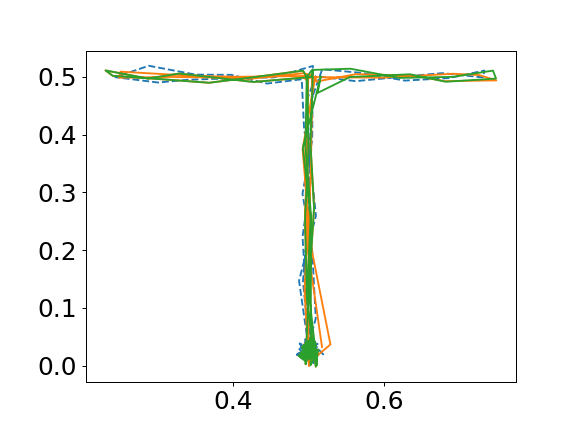

/home/munenori/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


<IPython.core.display.Javascript object>


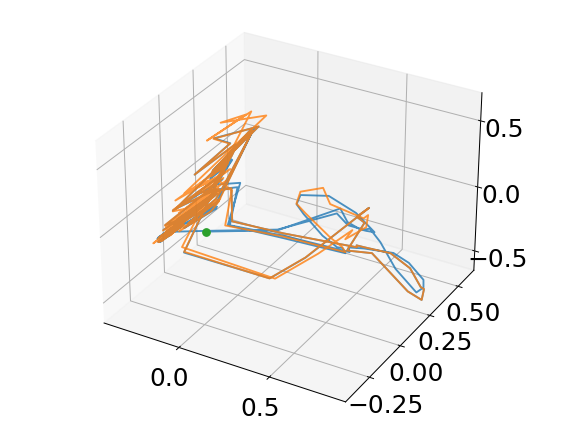

/tmp/ipykernel_2923202/492853890.py:288: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax3d = Axes3D(fig3d)


<IPython.core.display.Javascript object>


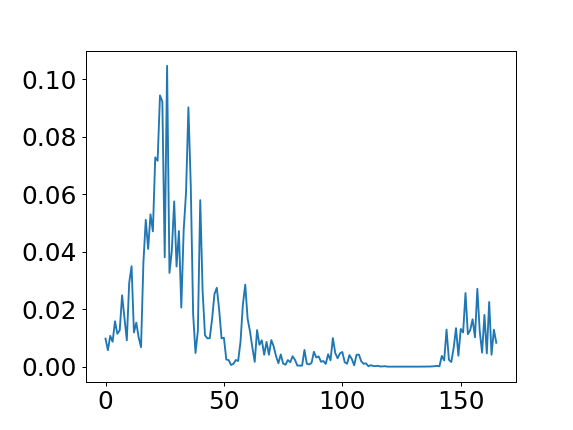

/home/munenori/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


<IPython.core.display.Javascript object>


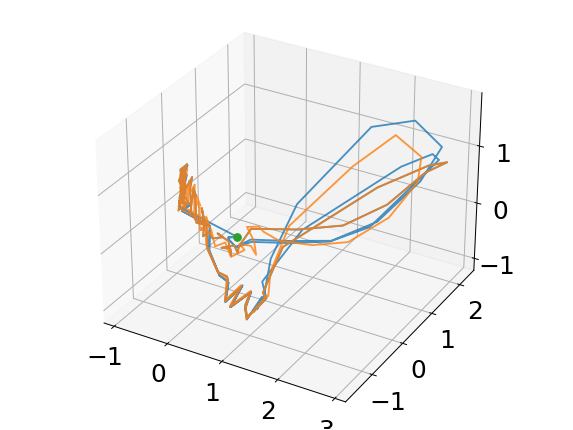

/tmp/ipykernel_2923202/492853890.py:310: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax3d = Axes3D(fig3d)


<IPython.core.display.Javascript object>


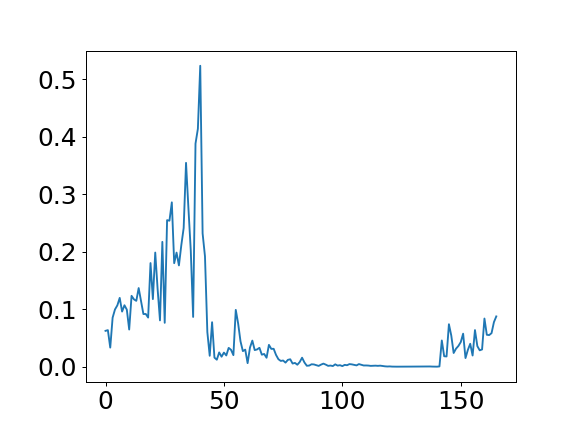

/home/munenori/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


<IPython.core.display.Javascript object>


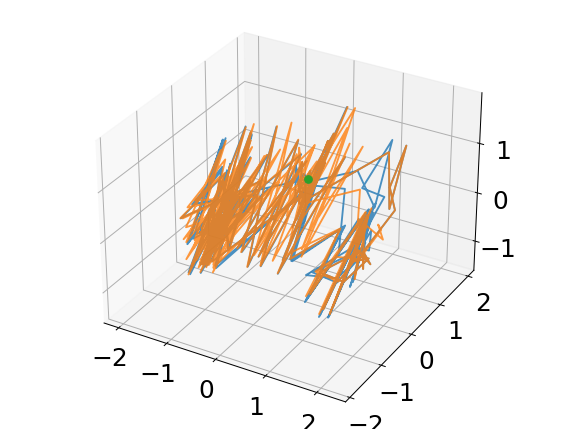

/tmp/ipykernel_2923202/492853890.py:332: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax3d = Axes3D(fig3d)


<IPython.core.display.Javascript object>


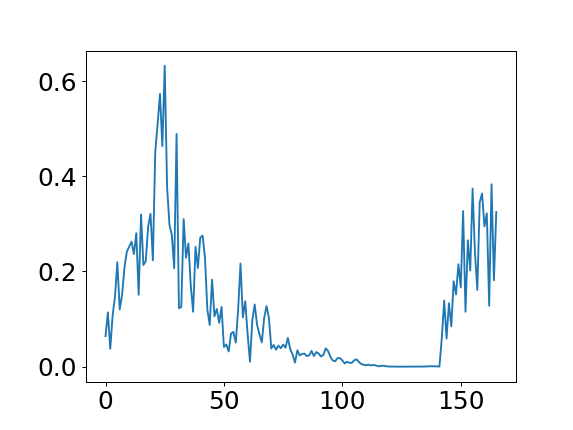

<IPython.core.display.Javascript object>


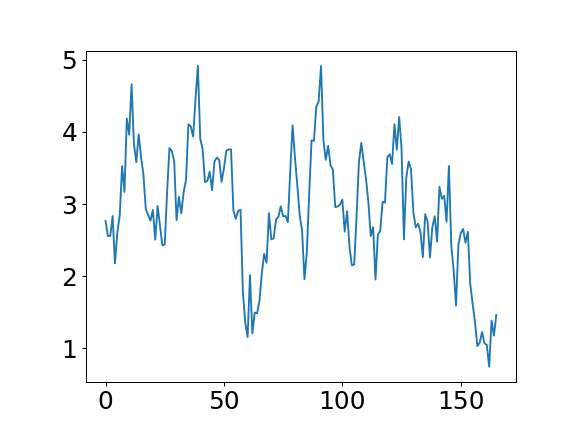

<IPython.core.display.Javascript object>


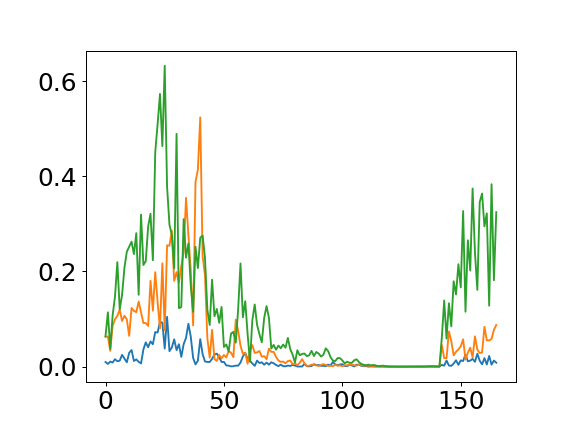

In [87]:
#v4 without Re
#v4_1 revised forward function

import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import time
import math
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import sklearn 
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D

%matplotlib notebook

def Culc_gate(input, params, hiddens):
    Re = hiddens[0][0]
    HPC_input = torch.cat([input,Re],dim=1)
    PFC_input = hiddens[1][0][0]
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    return [PFC_gates.tolist(), HPC_gates.tolist()]
    

def MakeAnimation(data_x,data_y,traj_x,traj_y, data_limit):
    fig, ax = plt.subplots()
    ims = []
    for t in range(traj_x.shape[0]):
        if t < data_limit:
            traj = ax.plot(data_x[:t], data_y[:t], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
        else:
            traj = ax.plot(data_x[:data_limit], data_y[:data_limit], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or", data_x[data_limit-1:t], data_y[data_limit-1:t], "--b")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_v4_2_1_r.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_attracter(data_x,data_y):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob",)
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_attracter2.gif', writer='pillow')
    plt.show()
    
    return 0


    
def MakeAnimation_img(data,module):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data.shape[0]):
        img = ax.imshow(data[t].reshape(1,data.shape[1]))
        title = ax.text(0.5, 1.01, module+' time={}'.format(t),
             ha='center', va='bottom',
             transform=ax.transAxes, fontsize='large')
        ims.append([img,title])
    ani = animation.ArtistAnimation(fig, ims)    
    ani.save('anim_fire_'+module+'_.gif', writer='pillow')
    plt.show()
    
    return 0

def mkOwnDataSet(data_size, filename, data_length=100, freq=60., noise=0.005):
    
    x = np.loadtxt(str(filename+"_r.csv"),delimiter=',')
    y = np.loadtxt(str(filename+"_l.csv"),delimiter=',')
    train_x = []
    train_y = []
    
    for offset in range(data_size):
        train_x.append([[x[i][0] + np.random.normal(loc=0.0, scale=noise),x[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,x.shape[0],round(x.shape[0]/data_length))])
        train_y.append([[y[i][0] + np.random.normal(loc=0.0, scale=noise),y[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,y.shape[0],round(y.shape[0]/data_length))])
    return train_x, train_y


def mkOwnRandomBatch(train_x, train_t, batch_size=10):
    """
    train_x, train_tを受け取ってbatch_x, batch_tを返す
    """
    batch_x = []
    for _ in range(batch_size):
        idx = np.random.randint(0, len(train_x) - batch_size)
        batch_x.append(train_x[idx])
    return torch.tensor(batch_x).transpose(0,1)

def plot_distance_bet2traj(traj1,traj2):
    result = []
    for i in range(traj1.shape[0]):
        result.append(np.linalg.norm(traj1[i]-traj2[i]))
    plt.figure()
    plt.plot(result)
    
    return result


class MyLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        nn.init.sparse_(self.PFC.weight_ih.data,1)
        nn.init.sparse_(self.HPC.weight_ih.data,1)
        nn.init.sparse_(self.PFC.weight_hh.data,1)
        nn.init.sparse_(self.HPC.weight_hh.data,1)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2][0]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,Re_hidden]

class MyLSTM_RNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM_RNN, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.Re = nn.RNNCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        sparse = 0.5
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        input = input.float()
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size)*const, torch.rand(self.batch_size, self.hidden_size)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size)*const, torch.rand(self.batch_size, self.hidden_size)*const]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]


def main():
    training_size = 100
    test_size = 1000
    epochs_num = 10
    hidden_size = 20
    batch_size = 10
    data_length = 100
    inputsize = 2
    outputsize = 2
#     model_path = 'model/ReModel_interRNN_long131test_s6_100_2.pth'
    model_path = 'model/R20_traintest_bigbatch/ReModel_L2_interRNNrand_OUT1_131_s2_100_1_epoch185.pth'
    filename = "primal_long131test"
    
    train_x,train_y = mkOwnDataSet(training_size,filename,data_length)

    rnn = MyLSTM_RNN(inputsize, hidden_size, outputsize, batch_size)

    rnn.load_state_dict(torch.load(model_path))
    
    data = mkOwnRandomBatch(train_x, batch_size)
    
    params = []
    for p in rnn.parameters():
        params.append(p.data)
     
    traj = []
    PFCstate = []
    HPCstate = []
    Restate = []
    Gate_states = []
    hidden = rnn.initHidden_rand()
    data_limit = 10
    init_point = torch.rand(10,2)*1
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
#             output,hidden = rnn(init_point,hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            #Gate_states.append(Culc_gate(output,params,hidden))
    for k in range(data.shape[0]*1):
            output,hidden = rnn(output,hidden) 
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            #Gate_states.append(Culc_gate(output,params,hidden))
            
    hidden = rnn.initHidden_rand()
    data = mkOwnRandomBatch(train_y, batch_size)
    init_point = init_point*0.9
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
#             output,hidden = rnn(init_point,hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            #Gate_states.append(Culc_gate(output,params,hidden))
    for k in range(data.shape[0]*2):
            output,hidden = rnn(output,hidden) 
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            #Gate_states.append(Culc_gate(output,params,hidden))
    traj = torch.tensor(traj)
    pltdata = torch.squeeze(data).numpy()
    traj = torch.squeeze(traj).numpy()

    
    
    print(np.array(PFCstate)[:,0].shape)
    #MakeAnimation(pltdata[:,0,0],pltdata[:,0,1], traj[:,0,0], traj[:,0,1], data_limit)
    #MakeAnimation_img(np.array(PFCstate)[:,0],"PFC")
    #MakeAnimation_img(np.array(HPCstate)[:,0],"HPC")

    for n, p in rnn.named_parameters():
            if n == "PFC.weight_ih":
                PFC_w = np.array(p.data)
            if n == "HPC.weight_ih":
                HPC_w = np.array(p.data)
    
    pca = PCA()
    dfs = np.array(HPCstate)[0:,0]
    pca.fit(dfs)
    feature = pca.transform(dfs)
    
    dividenum = int(np.array(feature).shape[0]/2)
    
    fig = plt.figure()
    plt.plot(pltdata[:,0,0],pltdata[:,0,1],"--")
    plt.plot(traj[:dividenum,0,0],traj[:dividenum,0,1])
    plt.plot(traj[dividenum:,0,0],traj[dividenum:,0,1])
    plt.show()
    
    pred = KMeans(n_clusters=2).fit_predict(feature)
    
    fig3d = plt.figure()
    ax3d = Axes3D(fig3d)
    ax3d.plot(feature[:dividenum, 0], feature[:dividenum, 1], feature[:dividenum, 2], alpha=0.8)
    ax3d.plot(feature[dividenum:, 0], feature[dividenum:, 1], feature[dividenum:, 2], alpha=0.8)
    ax3d.plot(feature[0:1, 0], feature[0:1, 1], feature[0:1, 2],"o", alpha=1)
    plt.show()
#     for i in range(20):
#         fig_place = plt.figure()
#         place3d = Axes3D(fig_place)
#         place3d.plot(traj[:,0,0], traj[:,0,1], np.array(HPCstate)[:,0,i])
#         plt.show()
    
    plot_distance(feature[:dividenum],feature[dividenum:])
    HPC_dis = overlap_coefficient(feature[:dividenum],feature[dividenum:])
    
    pca = PCA()
    dfs = np.array(PFCstate)[0:,0]
    pca.fit(dfs)
    feature = pca.transform(dfs)
    
    pred = KMeans(n_clusters=2).fit_predict(feature)
    
    fig3d = plt.figure()
    ax3d = Axes3D(fig3d)
    ax3d.plot(feature[:dividenum, 0], feature[:dividenum, 1], feature[:dividenum, 2], alpha=0.8)
    ax3d.plot(feature[dividenum:, 0], feature[dividenum:, 1], feature[dividenum:, 2], alpha=0.8)
    ax3d.plot(feature[0:1, 0], feature[0:1, 1], feature[0:1, 2],"o", alpha=1)
    plt.show()
#     for i in range(20):
#         fig_place = plt.figure()
#         place3d = Axes3D(fig_place)
#         place3d.plot(traj[:,0,0], traj[:,0,1], np.array(PFCstate)[:,0,i])
#         plt.show()

    plot_distance(feature[:dividenum],feature[dividenum:])
    PFC_dis = overlap_coefficient(feature[:dividenum],feature[dividenum:])

    pca = PCA()
    dfs = np.array(Restate)
    pca.fit(dfs)
    feature = pca.transform(dfs)
    
    pred = KMeans(n_clusters=2).fit_predict(feature)
    
    fig3d = plt.figure()
    ax3d = Axes3D(fig3d)
    ax3d.plot(feature[:dividenum, 0], feature[:dividenum, 1], feature[:dividenum, 2], alpha=0.8)
    ax3d.plot(feature[dividenum:, 0], feature[dividenum:, 1], feature[dividenum:, 2], alpha=0.8)
    ax3d.plot(feature[0:1, 0], feature[0:1, 1], feature[0:1, 2],"o", alpha=1)
    plt.show()

    plot_distance(feature[:dividenum],feature[dividenum:])
    Re_dis = overlap_coefficient(feature[:dividenum],feature[dividenum:])
    
#     MakeAnimation(feature[:dividenum, 0], feature[:dividenum, 1], feature[dividenum:, 0], feature[dividenum:, 1], data_limit)

    plot_distance_bet2traj(feature[:dividenum],feature[dividenum:])
    
    plt.figure()
    plt.plot(HPC_dis)
    plt.plot(PFC_dis)
    plt.plot(Re_dis)
    
if __name__ == '__main__':
    main()

# PFCcorr and HPCcorr

<IPython.core.display.Javascript object>


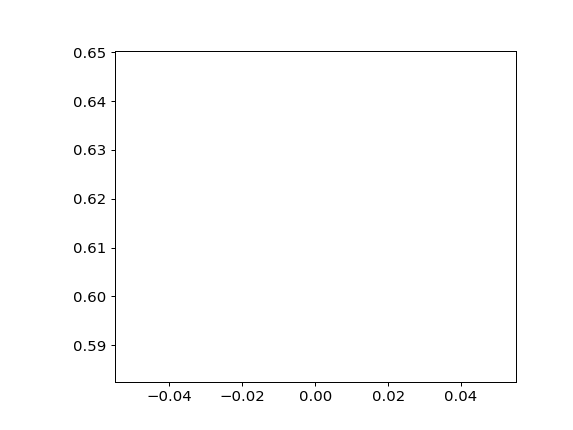

model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch160.pth
(120, 20)


<IPython.core.display.Javascript object>


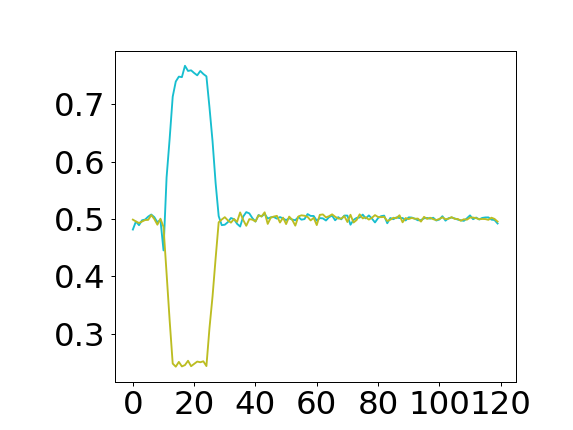

<IPython.core.display.Javascript object>


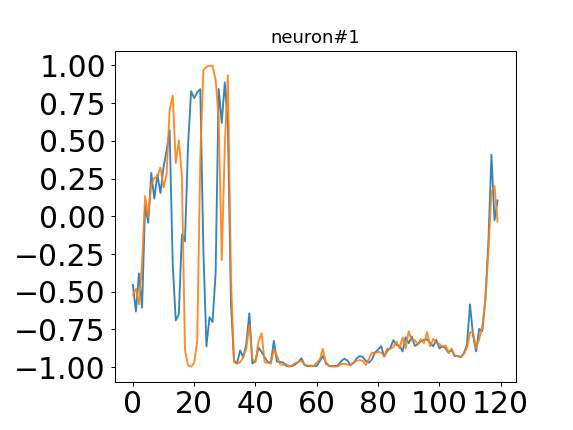

<IPython.core.display.Javascript object>


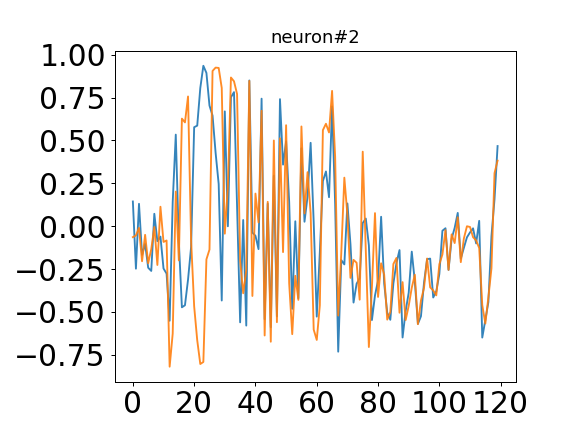

<IPython.core.display.Javascript object>


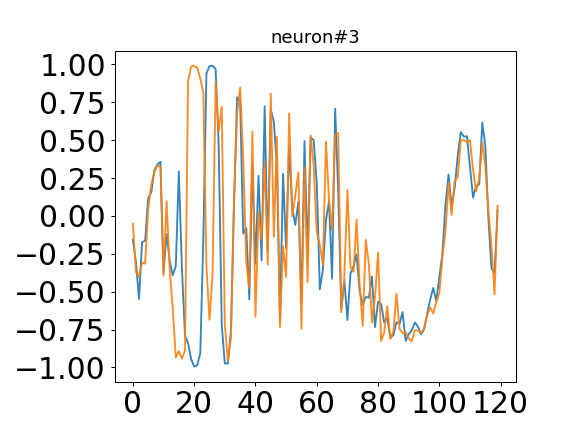

<IPython.core.display.Javascript object>


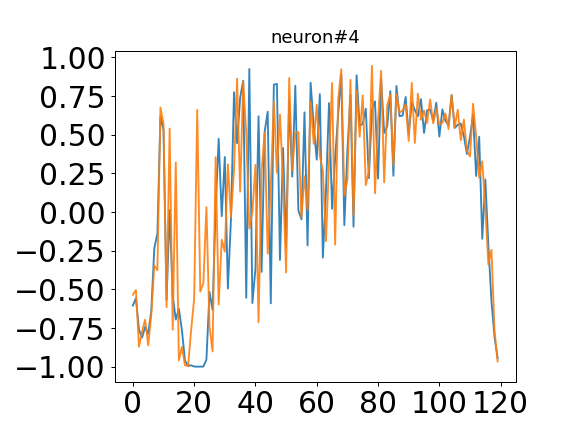

<IPython.core.display.Javascript object>


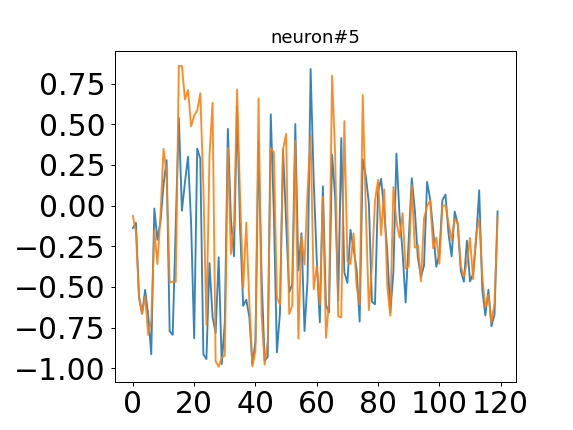

<IPython.core.display.Javascript object>


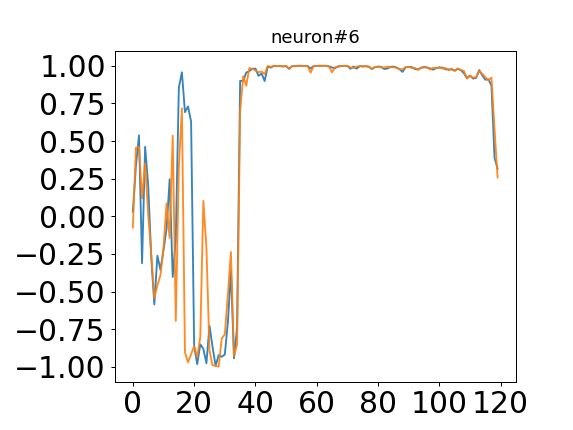

<IPython.core.display.Javascript object>


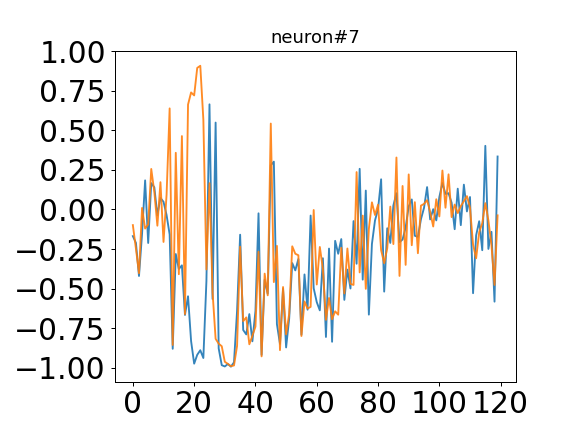

<IPython.core.display.Javascript object>


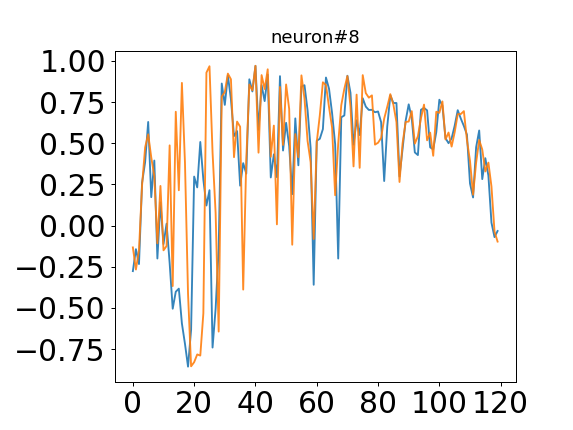

<IPython.core.display.Javascript object>


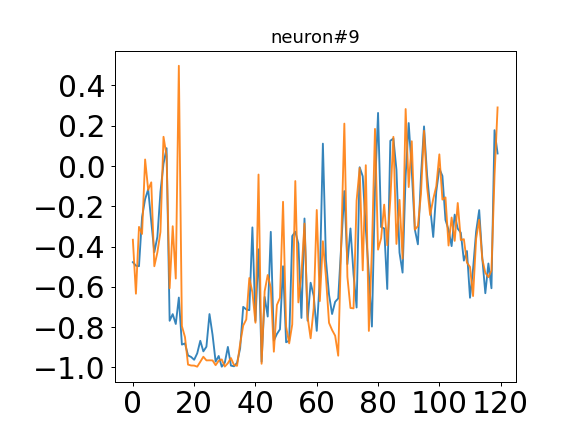

<IPython.core.display.Javascript object>


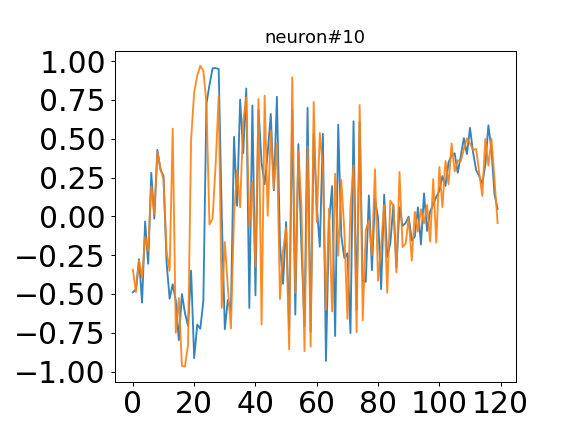

<IPython.core.display.Javascript object>


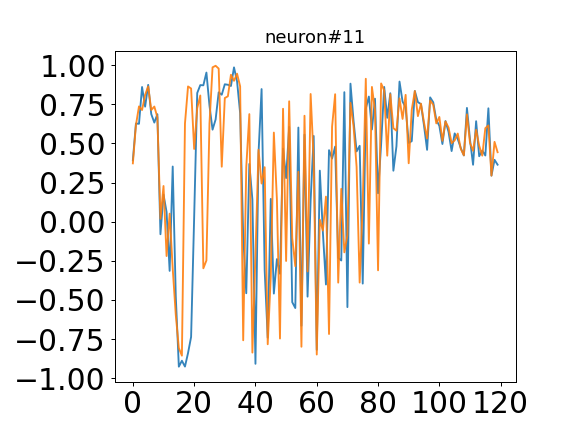

<IPython.core.display.Javascript object>


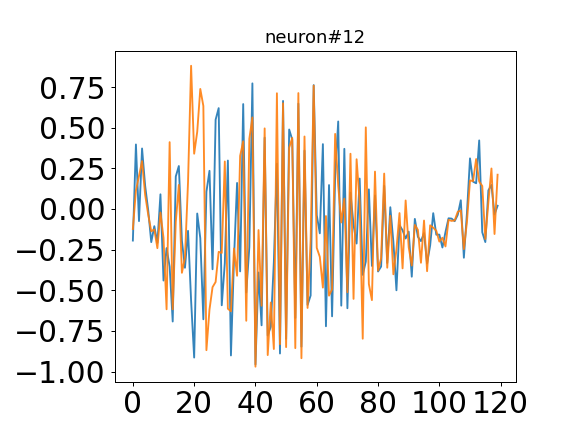

<IPython.core.display.Javascript object>


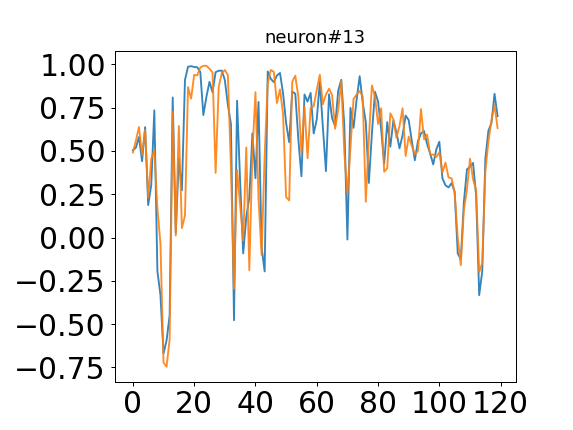

<IPython.core.display.Javascript object>


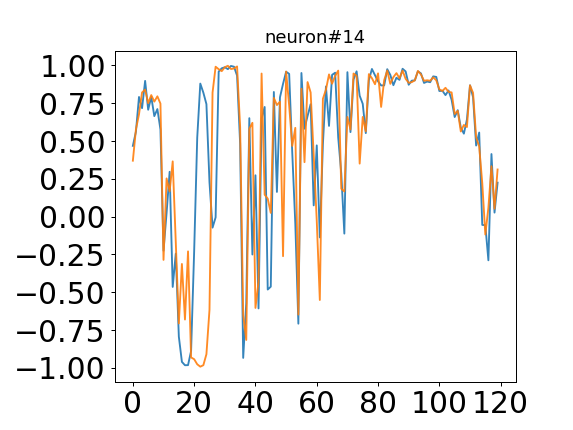

<IPython.core.display.Javascript object>


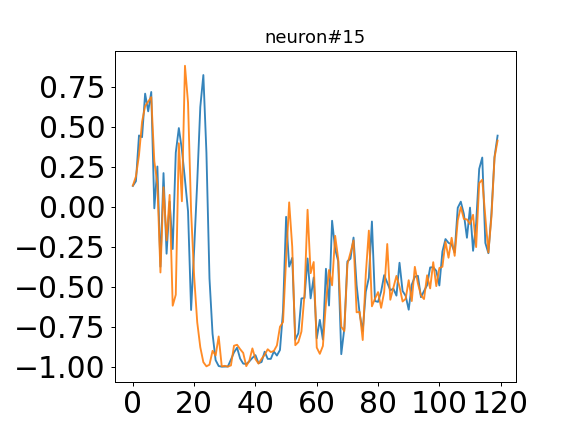

<IPython.core.display.Javascript object>


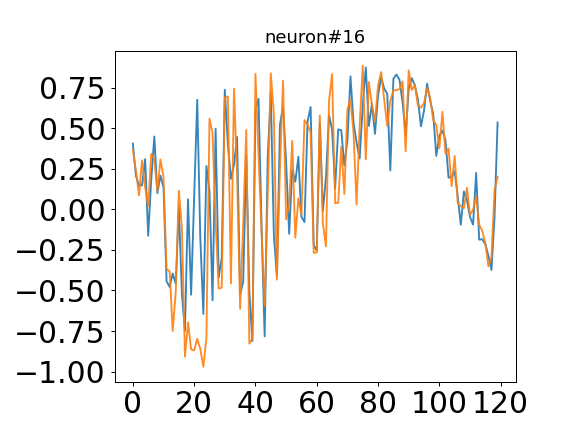

<IPython.core.display.Javascript object>


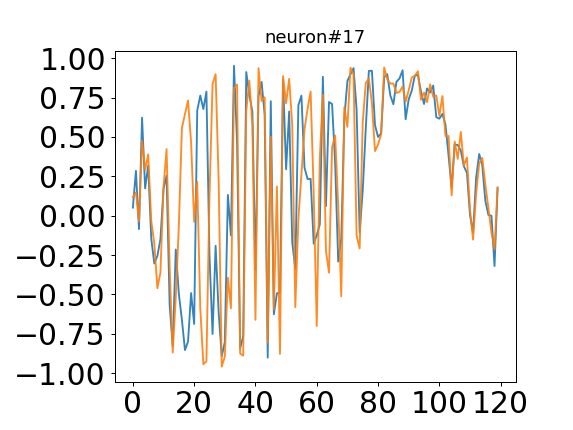

<IPython.core.display.Javascript object>


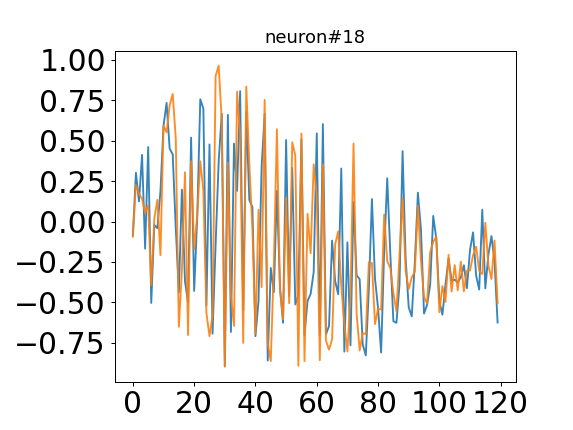

/tmp/ipykernel_2923202/95873446.py:878: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


<IPython.core.display.Javascript object>


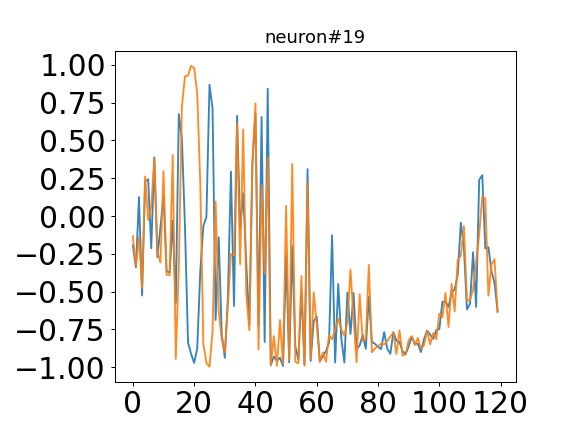

<IPython.core.display.Javascript object>


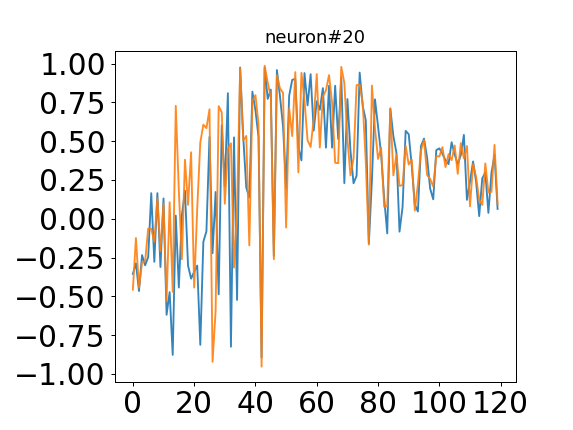

0.608303183562336 0.5522715285347298 0.697775416677019
(240, 20)
PFC correlation


<IPython.core.display.Javascript object>


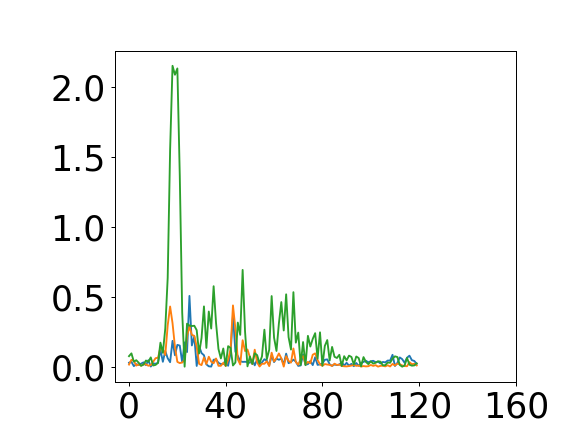

<IPython.core.display.Javascript object>


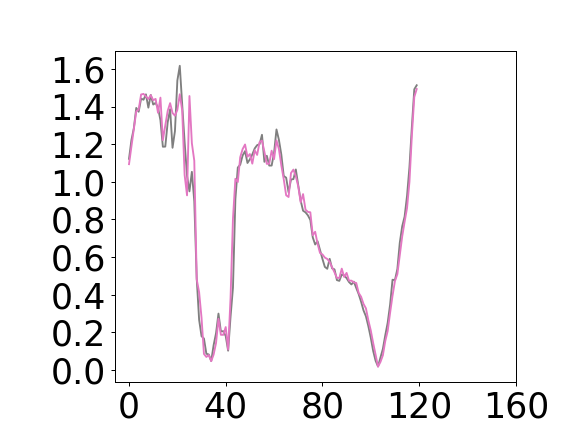

             0
PC1   0.282973
PC2   0.271602
PC3   0.085951
PC4   0.071915
PC5   0.063917
PC6   0.042072
PC7   0.038043
PC8   0.035548
PC9   0.027879
PC10  0.019927
PC11  0.013053
PC12  0.010496
PC13  0.008366
PC14  0.006665
PC15  0.005670
PC16  0.005279
PC17  0.003446
PC18  0.002772
PC19  0.002589
PC20  0.001838
(240, 20)
HPC correlation
0.9790540893853725


<IPython.core.display.Javascript object>


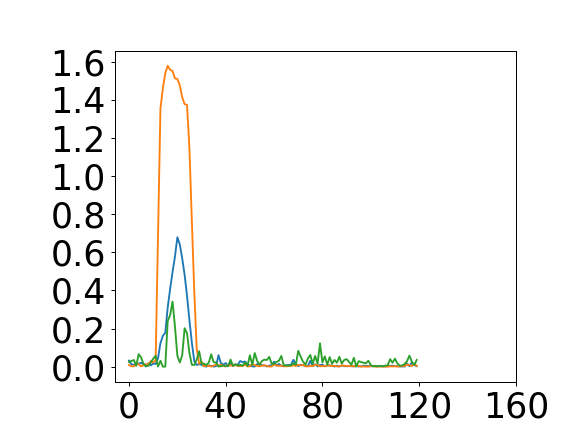

<IPython.core.display.Javascript object>


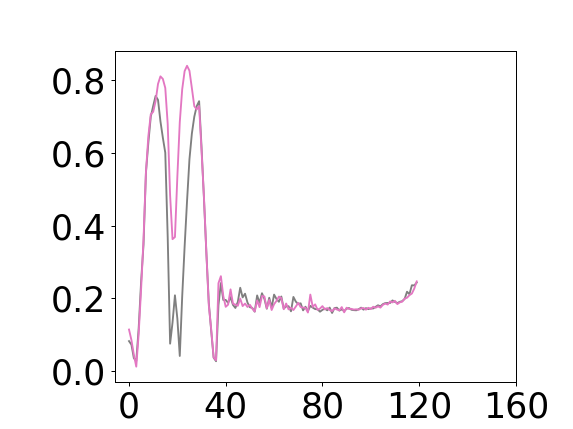

(240, 20)
Re correlation


<IPython.core.display.Javascript object>


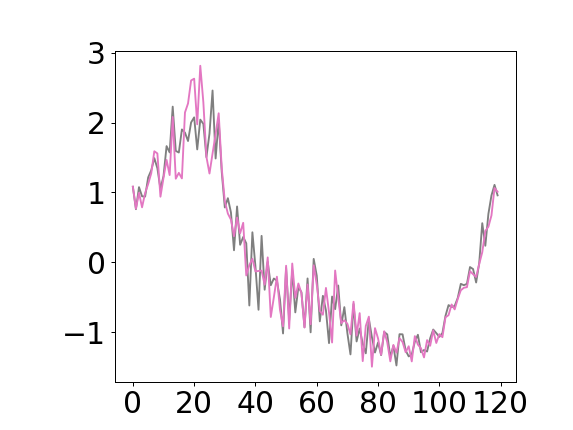

2.932050101578793
(0.19736181605521005, 0.17014989373080985, 0, 1.0000000000000002)


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


<IPython.core.display.Javascript object>


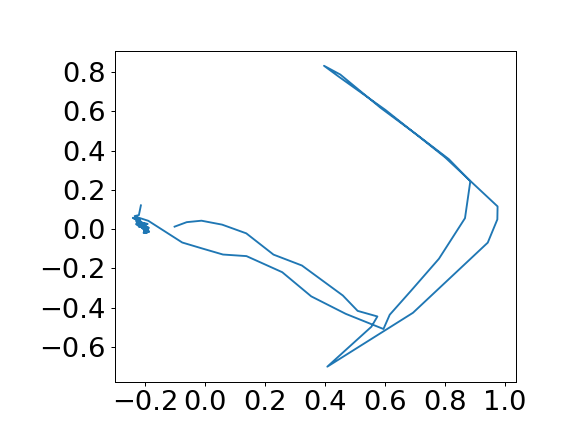

<IPython.core.display.Javascript object>


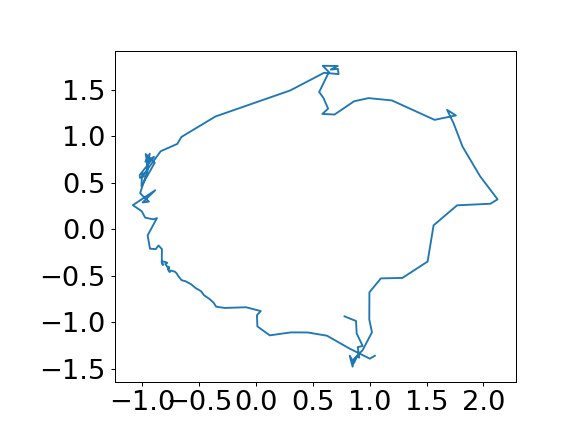

0.616419779884828 0.9932721838626731
dist:2.932050101578793


In [484]:
##########    Test for mixture weight!!!!!!!!!!!!!   #########################
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import time
import math
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import sklearn 
import nolds
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D
from scipy.special import expit
import pandas as pd
import glob
import scipy

%matplotlib notebook

plt.rcParams["font.size"] = 12
plt.rcParams["figure.subplot.left"] = 0.2

def Culc_gate(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = torch.cat([hiddens[1][0][0],hiddens[2][0]])
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]

def Culc_gate_uniPFC(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = hiddens[1][0][0]
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]

def Culc_gate_uniHPC(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = torch.cat([hiddens[1][0][0],hiddens[2][0]])
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]
    
    

def MakeAnimation(data_x,data_y,traj_x,traj_y, data_limit):
    fig, ax = plt.subplots()
    ims = []
    for t in range(traj_x.shape[0]):
        if t < data_limit:
            traj = ax.plot(data_x[:t], data_y[:t], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
#         else:
#             traj = ax.plot(data_x[:data_limit], data_y[:data_limit], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or", data_x[data_limit-1:t], data_y[data_limit-1:t], "--b")
        else:
            traj = ax.plot(traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
#             traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=30)    
    ani.save('anim_v4_2_1_r.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_data(data_x,data_y, data_limit):
    fig, ax = plt.subplots()
    ax.set_xlim(0.2,0.8)
    ax.set_ylim(-0.05,0.8)
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=30)    
    ani.save('anim_Re_0.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_attracter(data_x,data_y):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob",)
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=10)    
    ani.save('anim_attracter2.gif', writer='pillow')
    plt.show()
    
    return 0


    
def MakeAnimation_img(data,module):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data.shape[0]):
        img = ax.imshow(data[t].reshape(1,data.shape[1]))
        title = ax.text(0.5, 1.01, module+' time={}'.format(t),
             ha='center', va='bottom',
             transform=ax.transAxes, fontsize='large')
        ims.append([img,title])
    ani = animation.ArtistAnimation(fig, ims)    
    ani.save('anim_fire_'+module+'_.gif', writer='pillow')
    plt.show()
    
    return 0

def mkOwnDataSet(data_size, filename, data_length=100, freq=60., noise=0.005):
    
    x = np.loadtxt(str(filename+"_r.csv"),delimiter=',')
    y = np.loadtxt(str(filename+"_l.csv"),delimiter=',')
    train_x = []
    train_y = []
    
    for offset in range(data_size):
        train_x.append([[x[i][0] + np.random.normal(loc=0.0, scale=noise),x[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,x.shape[0],round(x.shape[0]/data_length))])
        train_y.append([[y[i][0] + np.random.normal(loc=0.0, scale=noise),y[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,y.shape[0],round(y.shape[0]/data_length))])
    return train_x, train_y


def mkOwnRandomBatch(train_x, train_t, batch_size=10):
    """
    train_x, train_tを受け取ってbatch_x, batch_tを返す
    """
    batch_x = []
    for _ in range(batch_size):
        idx = np.random.randint(0, len(train_x) - batch_size)
        batch_x.append(train_x[idx])
    return torch.tensor(batch_x).transpose(0,1)

def make_Ttraj(direction):
    traj_x = np.array([])
    traj_y = np.array([])
    straight_x = np.ones(5)*0.5
    if direction == 1:
        branch1_x = np.linspace(0.5, 0.75, 5)
        branch2_x = np.linspace(0.75, 0.5, 5)
    elif direction == 2:
        branch1_x = np.linspace(0.5, 0.25, 5)
        branch2_x = np.linspace(0.25, 0.5, 5)        
    backstraight_x = np.ones(5)*0.5

    straight_y = np.linspace(0, 0.5, 5)
    branch1_y = np.linspace(0.5, 0.5, 5)
    branch2_y = np.linspace(0.5, 0.5, 5)
    backstraight_y = np.linspace(0.5 , 0, 5)
    
    traj_x = np.append(traj_x, [straight_x,branch1_x,branch2_x,backstraight_x])
    traj_y = np.append(traj_y, [straight_y,branch1_y,branch2_y,backstraight_y])
    traj = np.concatenate([[traj_x],[traj_y]],axis=0).T
    return traj

def make_Htraj(direction1, direction2):
    traj_x = np.array([])
    traj_y = np.array([])
    straight_x = np.ones(10)*0.5
    if direction1 == 1:
        branch1_x = np.linspace(0.5, 0.75, 5)
        branch2_x = np.linspace(0.75, 0.75, 5)
        branch3_x = np.linspace(0.75, 0.75, 5)
        branch4_x = np.linspace(0.75, 0.5, 5)
    elif direction1 == 2:
        branch1_x = np.linspace(0.5, 0.25, 5)
        branch2_x = np.linspace(0.25, 0.25, 5)   
        branch3_x = np.linspace(0.25, 0.25, 5)  
        branch4_x = np.linspace(0.25, 0.5, 5)       
    backstraight_x = np.ones(10)*0.5

    straight_y = np.linspace(0, 0.5, 10)
    branch1_y = np.linspace(0.5, 0.5, 5)
    if direction2 == 1:
        branch2_y = np.linspace(0.5, 0.25, 5)
        branch3_y = np.linspace(0.25, 0.5, 5)
    elif direction2 == 2:
        branch2_y = np.linspace(0.5, 0.75, 5)
        branch3_y = np.linspace(0.75, 0.5, 5)
    branch4_y = np.linspace(0.5, 0.5, 5)
    backstraight_y = np.linspace(0.5 , 0, 10)
    
    traj_x = np.append(traj_x, straight_x)
    traj_x = np.append(traj_x, [branch1_x,branch2_x,branch3_x,branch4_x])
    traj_x = np.append(traj_x, backstraight_x)
    traj_y = np.append(traj_y, straight_y)
    traj_y = np.append(traj_y, [branch1_y,branch2_y,branch3_y,branch4_y])
    traj_y = np.append(traj_y, backstraight_y)
    traj = np.concatenate([[traj_x],[traj_y]],axis=0).T
    return traj


def make_traj(delay_length):
    freq=60
    noise=0.005
    data_length = 40
    
    # x = np.loadtxt("right1.csv",delimiter=',')
    x_1 = make_Htraj(1,1)
    x_2 = make_Htraj(1,2)
    # y = np.loadtxt("left1.csv",delimiter=',')
    y_1 = make_Htraj(2,1)
    y_2 = make_Htraj(2,2)
    z = np.loadtxt("stay1.csv",delimiter=',')
    data_list = []

    ###  ver1  ###
    orders = []
    order  = np.array([1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    orders.append(order) 
    order  = np.array([2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    orders.append(order) 
    order  = np.array([3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    orders.append(order) 
    order  = np.array([4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    orders.append(order) 
    
#     ###  ver2  ###
#     orders = []
#     order  = np.array([1])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [2])
#     orders.append(order) 
#     order  = np.array([2])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [3])
#     orders.append(order) 
#     order  = np.array([3])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [4])
#     orders.append(order) 
#     order  = np.array([4])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [1])
#     orders.append(order) 

    ###  ver1's test  ###
    orders = []
    order  = np.array([1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    orders.append(order) 
    order  = np.array([2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    orders.append(order) 
    order  = np.array([3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    orders.append(order) 
    order  = np.array([4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    orders.append(order) 
    
    # order = [1,0,0,0,2]
    # order = [2,0,0,1,0,0,0,2,0,0,1]
    for order in orders:
        data = np.array([[0,0]])
        for idx in order:
            if idx == 1:
                target = x_1
            elif idx == 2:
                target = x_2
            elif idx == 3:
                target = y_1
            elif idx == 4:
                target = y_2
            elif idx == 0:
                target = np.array([[z[i][0],z[i][1]] for i in np.random.choice(z.shape[0], data_length)])
#                 target = np.array([[0.5,0] for i in np.random.choice(z.shape[0], data_length)])
            if idx != 0:
                target += np.random.normal(loc=0.0, scale=noise, size=target.shape)
    
            data = np.append(data,target,axis=0)
        data_list.append(data[1:])
    return data_list[0],data_list[1],data_list[2],data_list[3]

def mkOwnDataSet_auto(data_size, delay_length, freq=60., noise=0.01):
   
    x1,x2,y1,y2 = make_traj(delay_length)
    train_x1 = []
    train_x2 = []
    train_y1 = []
    train_y2 = []
    
    for offset in range(data_size):
        train_x1.append([[x1[i][0] + np.random.normal(loc=0.0, scale=noise),x1[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(x1.shape[0])])
        train_x2.append([[x2[i][0] + np.random.normal(loc=0.0, scale=noise),x2[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(x2.shape[0])])

        train_y1.append([[y1[i][0] + np.random.normal(loc=0.0, scale=noise),y1[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(y1.shape[0])])
        train_y2.append([[y2[i][0] + np.random.normal(loc=0.0, scale=noise),y2[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(y2.shape[0])])

    return train_x1, train_x2, train_y1, train_y2

def plot_distance_bet2traj(traj1,traj2,linelist):
    traj1 = np.array(traj1)
    traj2 = np.array(traj2)
    result = []
    for i in range(traj1.shape[0]):
        result.append(np.linalg.norm(traj1[i]-traj2[i]))
    plt.figure()
    plt.plot(result)
    
    plt.vlines(linelist,np.min(result),np.max(result))
    
    return result

def distance_bet2traj(traj1,traj2):
    traj1 = np.array(traj1)
    traj2 = np.array(traj2)
    result = []
    for i in range(traj1.shape[0]):
        result.append(np.linalg.norm(traj1[i]-traj2[i]))
    return result

def plot_activity_bet2traj(traj1,traj2,linelist):
    traj1 = np.array(traj1)
    traj2 = np.array(traj2)
    result = []
    threshold = 0.5
    for i in range(traj1.shape[0]):
        result.append(np.abs(traj1[i]-traj2[i]))
        
    plt.figure()
    for i,data in enumerate(np.array(result).T):
        if np.any(data[20:105]>threshold):
            print(i)
            plt.plot(data)
    
    return result

def search_delay(traj):
    linelist = np.array([])
    flag = False
    for i in range(traj.shape[0]):
        if traj[i,1] > 0.45 and flag == False:
            linelist = np.append(linelist,i)
            flag = True
        if traj[i,1] < 0.45 and flag == True:
            linelist = np.append(linelist,i)
            flag = False
    return linelist

def pick_delay(traj,states):
    pointlist = np.array([])
    flag = False
    threshold = 0.2
    for i in range(traj.shape[0]):
        if i < 5:
            continue
        if traj[i,1] < threshold and flag == False:
            pointlist = np.append(pointlist,i)
            flag = True
        if traj[i,1] > threshold and flag == True:
            pointlist = np.append(pointlist,i)
            flag = False
    states_list = []
    start = 0
    for i,k in enumerate(pointlist):
        end = int(k)
        if i % 2 != 0:
            states_list.append(states[start:end])
        start = int(k)
    states_list.append(traj[start:])
    return states_list

def pick_traj(traj,states):
    pointlist = np.array([])
    flag = False
    threshold = 0.2
    for i in range(traj.shape[0]):
        if i < 5:
            continue
        if traj[i,1] < threshold and flag == False:
            pointlist = np.append(pointlist,i)
            flag = True
        if traj[i,1] > threshold and flag == True:
            pointlist = np.append(pointlist,i)
            flag = False
    states_list = []
    start = 0
    for i,k in enumerate(pointlist):
        end = int(k)
        if i % 2 != 0:
            states_list.append(states[start:end])
            start = int(k)
    states_list.append(traj[start:])
    return states_list

def match_length(states_list):
    min_length = 1000
    result = []
    for state in states_list:
        min_length = np.min((min_length, len(state)))
    for state in states_list:
        result.append(state[-min_length:])
        
    return result

def vec_var(datas):
    datas = np.array(datas)
    average = np.average(datas,axis=0)
    result = 0
    for data in datas:
        result += np.linalg.norm(data-average)
    result /= datas.shape[0]
    return result
    
def lyapunov_exp(data):
    result = np.mean(np.log(np.abs(np.diff(data))))
    return result

class MyLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        nn.init.sparse_(self.PFC.weight_ih.data,1)
        nn.init.sparse_(self.HPC.weight_ih.data,1)
        nn.init.sparse_(self.PFC.weight_hh.data,1)
        nn.init.sparse_(self.HPC.weight_hh.data,1)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2][0]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    
    
class MyLSTM_feedforward(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse=5):
        super(MyLSTM_feedforward, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.Linear(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input)
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]
    

class MyLSTM_feedforward_Thalamus2(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse=5):
        super(MyLSTM_feedforward_Thalamus2, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.hidden_size_THinh = hidden_size
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.Linear(self.hidden_size_PFC+self.hidden_size_HPC+self.hidden_size_THinh, self.hidden_size_Re)
        self.THinh = nn.Linear(self.hidden_size_Re, self.hidden_size_THinh)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        self.ReLU = nn.ReLU()
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0],hiddens[3]],dim=1)
        Re_hidden = self.Re(Re_input)
        THinh_input = hiddens[2]
        THinh_hidden = self.ReLU(self.THinh(THinh_input))
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden,THinh_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        THinh_hidden = self.ReLU(torch.rand(self.batch_size, self.hidden_size_THinh))
        return [PFC_hidden,HPC_hidden,Re_hidden,THinh_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        THinh_hidden = self.ReLU(torch.rand(self.batch_size, self.hidden_size_THinh)*const)
        return [PFC_hidden,HPC_hidden,Re_hidden,THinh_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re,self.hidden_size_THinh]

    
    

class MyLSTM_RNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse=5):
        super(MyLSTM_RNN, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        input = input.float()
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.1
        var = 0.1
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_test(self):
        const = 0.2
        var = 0.2
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
#         HPC_hidden = [torch.ones(self.batch_size, self.hidden_size_HPC)*const, torch.ones(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
#         PFC_hidden = [torch.ones(self.batch_size, self.hidden_size_PFC)*const, torch.ones(self.batch_size, self.hidden_size_PFC)*const]
#         Re_hidden = torch.ones(self.batch_size, self.hidden_size_Re)*const
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*var
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0
        v = 0.1
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*v
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def noiseHidden_select(self, hiddens):
        c = 0
        v = 0.01
        index = np.array([1,2,8,9,17])
        HPC_hidden = torch.zeros(self.batch_size, self.hidden_size_HPC)
        HPC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.zeros(self.batch_size, self.hidden_size_PFC)
        PFC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size_Re)*c
        Re_hidden[:,index] += torch.randn(self.batch_size, index.size)*v
#         Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*v
#         Re_hidden[:,index] = torch.zeros(self.batch_size, index.size)*c
#         Re_hidden = torch.zeros(self.batch_size, self.hidden_size_Re)*c
#         Re_hidden[:,index] += hiddens[2][:,index]*v
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def noiseHidden_dis(self, hiddens, statr, statl):
        c = 0
        v =-0.1
        index = np.array([1,2,8,9,17])
        HPC_hidden = torch.zeros(self.batch_size, self.hidden_size_HPC)
        HPC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.zeros(self.batch_size, self.hidden_size_PFC)
        PFC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*0.0
        Re_hidden += (-statr+statl)*v
#         Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*v
#         Re_hidden[:,index] = torch.zeros(self.batch_size, index.size)*c
#         Re_hidden = torch.zeros(self.batch_size, self.hidden_size_Re)*c
#         Re_hidden[:,index] += hiddens[2][:,index]*v
        hiddens[2].add_(Re_hidden)
        return hiddens


def moving_average(data):
    y = np.ones(5)/5
    mean_seq = np.convolve(data, y)
    return mean_seq    


def main(model):
    training_size = 100
    test_size = 1000
    epochs_num = 10
    hidden_size = 20
    batch_size = 10
    data_length = 100
    inputsize = 2
    outputsize = 2
    delay_length = 2
    
    model_path = model
    
    colors = ['C0','C1','C2','C3','C4','C5','C6','C7','C8','C9']
    
#     delay_length = np.random.randint(1, 3)
    delay_length = 2
    train_x1,train_x2,train_y1,train_y2 = mkOwnDataSet_auto(training_size,delay_length)

#     rnn = MyLSTM_comp(inputsize, hidden_size, outputsize, batch_size)
    rnn = MyLSTM_RNN(inputsize, hidden_size, outputsize, batch_size)
#     rnn = MyLSTM_RNN_uniHPC(inputsize, hidden_size, outputsize, batch_size)
#     rnn = MyMTRNN2(inputsize, hidden_size, outputsize, batch_size)
#     rnn = MyLSTM_feedforward(inputsize, hidden_size, outputsize, batch_size)
#     rnn = MyLSTM_feedforward_Thalamus2(inputsize, hidden_size, outputsize, batch_size)

    rnn.load_state_dict(torch.load(model_path))
    
    
    pattern = 1
    if  pattern == 1:
        data = mkOwnRandomBatch(train_x1, train_x1, batch_size).float()
    elif pattern == 2:
        data = mkOwnRandomBatch(train_x2, train_x2, batch_size).float()
    elif pattern == 3:
        data = mkOwnRandomBatch(train_y1, train_y1, batch_size).float()
    else:
        data = mkOwnRandomBatch(train_y2, train_y2, batch_size).float()
    
    params = []
    for p in rnn.parameters():
        params.append(p.data)
    
        
#     model_path = 'model/R20_131/ReModel_L2_interRNNrand_OUT1_131_s6_100_1_epoch125.pth'
    model_path = model
    rnn.load_state_dict(torch.load(model_path))
        
    for n, p in rnn.named_parameters():
            if n == "PFC.weight_ih":
                PFC_w_pre = torch.clone(p.data)
            if n == "HPC.weight_ih":
                HPC_w_pre = torch.clone(p.data)
            if n == "Re.weight_ih":
                Re_w_pre = torch.clone(p.data)
            if n == "Re.weight_hh":
                Re_inw = torch.clone(p.data)
            if n == "linear.weight":
                OUT_w_pre = torch.clone(p.data)
                   
    traj = []
    PFCstate = []
    HPCstate = []
    Restate = []
    Gate_states = []
    hidden = rnn.initHidden_rand()
    data_limit = 120
    est_length = 0
    init_point = torch.rand(10,2)*1
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
#             output,hidden = rnn(init_point,hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            Gate_states.append(Culc_gate(output,params,hidden))
#             Gate_states.append(Culc_gate_uniPFC(output,params,hidden))
#     for k in range(data.shape[0]*est_length):
#             output,hidden = rnn(output,hidden)
#             traj.append(output.tolist())
#             PFCstate.append(hidden[0][0].tolist())
#             HPCstate.append(hidden[1][0].tolist())
#             Restate.append(hidden[2][0].tolist())
#             Gate_states.append(Culc_gate(output,params,hidden))
    traj = torch.tensor(traj)
    traj = torch.squeeze(traj).numpy()
    
    pattern = 3
    if  pattern == 1:
        data = mkOwnRandomBatch(train_x1, train_x1, batch_size).float()
    elif pattern == 2:
        data = mkOwnRandomBatch(train_x2, train_x2, batch_size).float()
    elif pattern == 3:
        data = mkOwnRandomBatch(train_y1, train_y1, batch_size).float()
    else:
        data = mkOwnRandomBatch(train_y2, train_y2, batch_size).float()
    
    dividenum = int(np.array(PFCstate)[0:,0].shape[0]/2)
    traj_noise = []
    PFCstate_noise = []
    HPCstate_noise = []
    Restate_noise = []
    Gate_states_noise = []
    hidden = rnn.initHidden_rand()
#     data = mkOwnRandomBatch(train_y, batch_size)
#     init_point = torch.rand(10,2)*1
#     data_limit = 125
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
#             output,hidden = rnn(init_point,hidden)
            traj_noise.append(output.tolist())
            PFCstate_noise.append(hidden[0][0].tolist())
            HPCstate_noise.append(hidden[1][0].tolist())
            Restate_noise.append(hidden[2][0].tolist())
#             Gate_states_noise.append(Culc_gate(output,params,hidden))
#     for k in range(data.shape[0]*est_length):
# #             hidden = rnn.noiseHidden_rand(hidden)
#             output,hidden = rnn(output,hidden) 
# #             hidden = rnn.noiseHidden_dis(hidden, np.array(Restate)[k+data_limit], np.array(Restate)[dividenum+k+data_limit])
# #             hidden = rnn.noiseHidden_rand(hidden)
#             traj_noise.append(output.tolist())
#             PFCstate_noise.append(hidden[0][0].tolist())
#             HPCstate_noise.append(hidden[1][0].tolist())
#             Restate_noise.append(hidden[2][0].tolist())
#             Gate_states_noise.append(Culc_gate(output,params,hidden))
    traj_noise = torch.tensor(traj_noise)
    traj_noise = torch.squeeze(traj_noise).numpy()

    
    print(np.array(PFCstate)[:,0].shape)
#     MakeAnimation(pltdata[:,0,0],pltdata[:,0,1], traj[:,0,0], traj[:,0,1], data_limit)
    #MakeAnimation_img(np.array(PFCstate)[:,0],"PFC")
    #MakeAnimation_img(np.array(HPCstate)[:,0],"HPC")


    plt.figure()
    plt.plot(traj[:,0,0],color=colors[-1])
    plt.plot(traj_noise[:,0,0],color=colors[-2])
    plt.yticks(fontsize=26)
    plt.xticks(fontsize=26)

    PFC_corrlist = np.array([])
    HPC_corrlist = np.array([])
    cross_corrlist = np.array([])
    for i in range(20):
        plt.figure()
        plt.yticks(fontsize=24)
        plt.xticks(fontsize=24)
#         plt.ylim(-1,1)
#         plt.plot(traj[:,0,0])
#         plt.plot(traj_noise[:,0,0])
#         plt.plot(np.abs(traj[:,0,0]-traj_noise[:,0,0]))
    #         plt.plot(np.array(PFCstate_noise)[:400,0,17],alpha=0.5)
        for k in range(1):
#                 plt.plot(np.array(PFCstate)[:,k,i],alpha=0.5)
#                 plt.plot(np.array(PFCstate_noise)[:,k,i],alpha=0.5)
#                 plt.plot(np.abs(np.array(PFCstate)[:,k,i]-np.array(PFCstate_noise)[:,k,i]),alpha=0.5)
#                 plt.plot(np.array(HPCstate)[:,k,i],alpha=0.5)
#                 plt.plot(np.array(HPCstate_noise)[:,k,i],alpha=0.5)
#                 plt.plot(np.abs(np.array(HPCstate)[:,k,i]-np.array(HPCstate_noise)[:,k,i]),alpha=0.5)
    #             plt.plot(np.array(PFCstate)[:120,k,i],alpha=0.5)
    #             plt.plot(np.array(PFCstate)[120:240,k,i],alpha=0.5)
    #             plt.plot(np.array(PFCstate)[:120,k,i]-np.array(PFCstate)[120:240,k,i],alpha=0.5)
    #             plt.plot(np.array(PFCstate_noise)[:120,k,i],alpha=0.5)
    #             plt.plot(np.array(PFCstate_noise)[120:240,k,i],alpha=0.5)
#                 plt.plot(np.array(PFCstate_noise)[:120,k,i]-np.array(PFCstate_noise)[120:240,k,i],alpha=0.5)
#                 plt.plot(-1*np.array(Restate)[:120,i],alpha=0.9)
#                 plt.plot(-1*np.array(Restate_noise)[:120,i],alpha=0.9)
#             plt.plot(np.array(Restate)[:,i]-np.array(Restate_noise)[:,i],alpha=0.5)
#                 plt.plot(moving_average(np.array(Restate)[:,i]),alpha=0.5)
#                 plt.plot(moving_average(np.array(Restate_noise)[:,i]),alpha=0.5)
#                 plt.plot(moving_average(np.array(Restate)[:,i])-moving_average(np.array(Restate_noise)[:,i]),alpha=0.5)
#                 plt.plot(np.array(Gate_states)[:,0,0+i],alpha=0.5)
#                 plt.plot(np.array(Gate_states_noise)[:,1,0+i],alpha=0.5)
#                 plt.plot(np.array(Gate_states_noise)[:,1,20+i],alpha=0.5)
#                 plt.plot(np.log(np.array(Gate_states)[:,1,0+i]/np.array(Gate_states)[:,1,20+i]),alpha=0.5)
#                 plt.plot(np.log(np.array(Gate_states_noise)[:,1,0+i]/np.array(Gate_states_noise)[:,1,20+i]),alpha=0.5)
#                 print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(np.array(PFCstate)[:,k,i]-np.array(PFCstate_noise)[:,k,i]))[0,1])
#                 print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(np.array(HPCstate)[:,k,i]-np.array(HPCstate_noise)[:,k,i]))[0,1])
#                 print(np.corrcoef(np.abs(np.array(PFCstate)[:,k,i]-np.array(PFCstate_noise)[:,k,i]),np.abs(np.array(HPCstate)[:,k,i]-np.array(HPCstate_noise)[:,k,i])))
                cross_corrlist = np.append(cross_corrlist,np.corrcoef(np.abs(np.array(PFCstate)[:,k,i]-np.array(PFCstate_noise)[:,k,i]),np.abs(np.array(HPCstate)[:,k,i]-np.array(HPCstate_noise)[:,k,i])))
                PFC_corrlist = np.append(PFC_corrlist,np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(np.array(PFCstate)[:,k,i]-np.array(PFCstate_noise)[:,k,i]))[0,1])
                HPC_corrlist = np.append(HPC_corrlist,np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(np.array(HPCstate)[:,k,i]-np.array(HPCstate_noise)[:,k,i]))[0,1])
        plt.title("neuron#"+str(i+1))
    print(np.mean(PFC_corrlist),np.mean(HPC_corrlist),np.mean(cross_corrlist))
    
    pca = PCA()
#     dfs = np.array(PFCstate)[:,0]
    dfs = np.concatenate((np.array(PFCstate)[:,0],np.array(PFCstate_noise)[:,0]),axis=0)
#     dfs = np.concatenate((np.array(HPCstate)[:,0],np.array(HPCstate_noise)[:,0]),axis=0)
    print(dfs.shape)
    pca.fit(dfs)
    feature = pca.transform(dfs)
    print("PFC correlation")
#     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,0]-feature[100:,0])))
#     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,1]-feature[100:,1])))
#     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,2]-feature[100:,2])))
    PFC_a = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:data_limit,0]-feature[data_limit:,0]))[0,1]
    PFC_b = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:data_limit,1]-feature[data_limit:,1]))[0,1]
    PFC_c = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:data_limit,2]-feature[data_limit:,2]))[0,1]
#     PFC_a = np.corrcoef(np.abs(traj[:,0,1]-traj_noise[:,0,1]),np.abs(feature[:data_limit,0]-feature[data_limit:,0]))[0,1]
#     PFC_b = np.corrcoef(np.abs(traj[:,0,1]-traj_noise[:,0,1]),np.abs(feature[:data_limit,1]-feature[data_limit:,1]))[0,1]
#     PFC_c = np.corrcoef(np.abs(traj[:,0,1]-traj_noise[:,0,1]),np.abs(feature[:data_limit,2]-feature[data_limit:,2]))[0,1]
#     PFC_a = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:data_limit,0]))[0,1]
#     PFC_b = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:data_limit,1]))[0,1]
#     PFC_c = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:data_limit,2]))[0,1]
    PFC_diff = np.sqrt(np.power(feature[:data_limit,0]-feature[data_limit:,0],2) + np.power(feature[:data_limit,1]-feature[data_limit:,1],2) + np.power(feature[:data_limit,2]-feature[data_limit:,2],2))
    PFC_d = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),PFC_diff)[0,1]
    PFC_diff2 = np.sum(np.abs(np.array(PFCstate)[:,0]-np.array(PFCstate_noise)[:,0]),axis=1)
    PFC_e = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),PFC_diff2)[0,1]
    
    plt.figure()
    plt.plot(np.abs(feature[:data_limit,0]-feature[data_limit:,0]))
    plt.plot(np.abs(feature[:data_limit,1]-feature[data_limit:,1]))
    plt.plot(np.abs(feature[:data_limit,2]-feature[data_limit:,2]))
    plt.yticks(fontsize=28)
    plt.xticks([0,40,80,120,160],fontsize=28)
    plt.show()

    plt.figure()
    plt.plot(np.abs(feature[:data_limit,0]),color=colors[-3])
    plt.plot(np.abs(feature[data_limit:,0]),color=colors[-4])
    plt.yticks(fontsize=28)
    plt.xticks([0,40,80,120,160],fontsize=28)
    plt.show()

#     print(pd.DataFrame(feature, columns=["PC{}".format(x + 1) for x in range(dfs.shape[1])]).head())
    print(pd.DataFrame(pca.explained_variance_ratio_, index=["PC{}".format(x + 1) for x in range(dfs.shape[1])]))

    
    pca = PCA()
#     dfs = np.array(PFCstate)[:,0]
#     dfs = np.concatenate((np.array(PFCstate)[:,0],np.array(PFCstate_noise)[:,0]),axis=0)
    dfs = np.concatenate((np.array(HPCstate)[:,0],np.array(HPCstate_noise)[:,0]),axis=0)
    print(dfs.shape)
    pca.fit(dfs)
    feature = pca.transform(dfs)
    print("HPC correlation")
#     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,0]-feature[100:,0])))
#     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,1]-feature[100:,1])))
#     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,2]-feature[100:,2])))
    HPC_a = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:data_limit,0]-feature[data_limit:,0]))[0,1]
    HPC_b = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:data_limit,1]-feature[data_limit:,1]))[0,1]
    HPC_c = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:data_limit,2]-feature[data_limit:,2]))[0,1]
#     HPC_a = np.corrcoef(np.abs(traj[:,0,1]-traj_noise[:,0,1]),np.abs(feature[:data_limit,0]-feature[data_limit:,0]))[0,1]
#     HPC_b = np.corrcoef(np.abs(traj[:,0,1]-traj_noise[:,0,1]),np.abs(feature[:data_limit,1]-feature[data_limit:,1]))[0,1]
#     HPC_c = np.corrcoef(np.abs(traj[:,0,1]-traj_noise[:,0,1]),np.abs(feature[:data_limit,2]-feature[data_limit:,2]))[0,1]
    HPC_diff = np.sqrt(np.power(feature[:data_limit,0]-feature[data_limit:,0],2) + np.power(feature[:data_limit,1]-feature[data_limit:,1],2) + np.power(feature[:data_limit,2]-feature[data_limit:,2],2))
    HPC_d = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),HPC_diff)[0,1]
    HPC_diff2 = np.sum(np.abs(np.array(HPCstate)[:,0]-np.array(HPCstate_noise)[:,0]),axis=1)
    HPC_e = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),HPC_diff2)[0,1]
    print(HPC_e)
    
    plt.figure()
    plt.plot(np.abs(feature[:data_limit,0]-feature[data_limit:,0]))
    plt.plot(np.abs(feature[:data_limit,1]-feature[data_limit:,1]))
    plt.plot(np.abs(feature[:data_limit,2]-feature[data_limit:,2]))
    plt.yticks(fontsize=28)
    plt.xticks([0,40,80,120,160],fontsize=28)
    plt.show()
    
    plt.figure()
    plt.plot(np.abs(feature[:data_limit,0]),color=colors[-3])
    plt.plot(np.abs(feature[data_limit:,0]),color=colors[-4])
    plt.yticks(fontsize=28)
    plt.xticks([0,40,80,120,160],fontsize=28)
    plt.show()


#     print(pd.DataFrame(feature, columns=["PC{}".format(x + 1) for x in range(dfs.shape[1])]).head())
#     print(pd.DataFrame(pca.explained_variance_ratio_, index=["PC{}".format(x + 1) for x in range(dfs.shape[1])]))


    pca = PCA()
#     dfs = np.array(PFCstate)[:,0]
#     dfs = np.concatenate((np.array(PFCstate)[:,0],np.array(PFCstate_noise)[:,0]),axis=0)
    dfs = np.concatenate((np.array(Restate)[:],np.array(Restate_noise)[:]),axis=0)
    print(dfs.shape)
    pca.fit(dfs)
    feature = pca.transform(dfs)
    print("Re correlation")
#     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,0]-feature[100:,0])))
#     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,1]-feature[100:,1])))
#     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,2]-feature[100:,2])))
#     Re_a = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,0]-feature[100:,0]))[0,1]
#     Re_b = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,1]-feature[100:,1]))[0,1]
#     Re_c = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,2]-feature[100:,2]))[0,1]
    
    plt.figure()
#     plt.plot(np.abs(feature[:100,0]-feature[100:,0]))
#     plt.plot(np.abs(feature[:100,1]-feature[100:,1]))
#     plt.plot(np.abs(feature[:100,2]-feature[100:,2]))
#     plt.plot(np.abs(moving_average(feature[:100,0])-moving_average(feature[100:,0])))
#     plt.plot(np.abs(moving_average(feature[:100,1])-moving_average(feature[100:,1])))
#     plt.plot(np.abs(moving_average(feature[:100,2])-moving_average(feature[100:,2])))
    plt.plot(np.array(feature[:data_limit,0]),color=colors[-3])
    plt.plot(np.array(feature[data_limit:,0]),color=colors[-4])
    plt.yticks(fontsize=24)
    plt.xticks(fontsize=24)
    plt.show()


####################### Fluc(frac) and coherence part #############################


    pca = PCA()
#     dfs = np.array(HPCstate)[40:,0]
    dfs = np.array(Restate)
    pca.fit(dfs)
    feature = pca.transform(dfs)
    
    delaysB = pick_delay(traj[:,0], feature[:])

    PCAnum = 0
    data = feature[:,PCAnum]
    movingA = moving_average(data)
    fracA = data - movingA[2:-2]
    print(math.dist(data,movingA[2:-2]))
    frac_amp = math.dist(data,movingA[2:-2])
    
#     frac_amp = 0
#     for i in range(20):
#         data = np.array(HPCstate)[:,0,i]
#         movingA = moving_average(data)
#         fracA = data - movingA[2:-2]
#         frac_amp += math.dist(data,movingA[2:-2])
#     frac_amp = frac_amp/20
    
#     fig = plt.figure()
#     fig1 = fig.add_subplot(111)
#     fig1.hist(np.array(Gate_states)[:,0,0:20].ravel(),bins=30,range=(-0.1,1.1),alpha=0.5,density=True)
#     fig1.hist(np.array(Gate_states)[:,1,0:20].ravel(),bins=30,range=(-0.1,1.1),alpha=0.5,density=True)
#     plt.show()

#     hist = np.histogram(np.array(Gate_states)[:,0,0:20].ravel(),bins=30,range=(-0.1,1.1),density=True)
#     data = np.array([np.clip(hist[1][3:-2],0,1),hist[0][2:-2]]).T
    data = np.array(Gate_states)[:,0,0:20].ravel()
    try:
        beta_PFC = scipy.stats.beta.fit(data, floc=0)
        print(beta_PFC)
        beta_param = np.average([beta_PFC[0],beta_PFC[1]])
    except Exception:
        print("Error: maybe takes negative a or b")
        beta_param = 0.5
        
#     data = np.array(Gate_states)[:,1,0:20].ravel()
#     try:
#         beta_HPC = scipy.stats.beta.fit(data)
#         print(beta_HPC)
#     except Exception:
#         print("Error: maybe takes negative a or b")
        

    pca = PCA()
    dfs = np.array(HPCstate)[:,0]
#     dfs = np.array(Restate)
    pca.fit(dfs)
    HPCfeature = pca.transform(dfs)
    
    pca = PCA()
    dfs = np.array(PFCstate)[:,0]
#     dfs = np.array(Restate)
    pca.fit(dfs)
    PFCfeature = pca.transform(dfs)
    
    plt.figure()
    plt.plot(HPCfeature[:,0],HPCfeature[:,1])
    plt.yticks(fontsize=22)
    plt.xticks(fontsize=22)
    plt.show()

    plt.figure()
    plt.plot(PFCfeature[:,0],PFCfeature[:,1])
    plt.yticks(fontsize=22)
    plt.xticks(fontsize=22)
    plt.show()
    
#     shift = 2
#     seglen = 60
        
#     coherence_diff_list = []
#     for i in range(20):
#         for k in range(1):
#             data = np.array(Refeature)[:,0]-moving_average(np.array(Refeature)[:,0])[2:-2]
#             freqs,times,sx1 = signal.stft(data,fs=1,window="boxcar",nperseg=seglen,noverlap=seglen-shift,detrend=False,boundary=None)
#             data = np.array(PFCstate)[:,k,i]-moving_average(np.array(PFCstate)[2:-2,k,i])[:]
#             freqs,times,sx2 = signal.stft(data*1,fs=1,window="boxcar",nperseg=seglen,noverlap=seglen-shift,detrend=False,boundary=None)
#             data = np.array(HPCstate)[:,k,i]-moving_average(np.array(HPCstate)[2:-2,k,i])[:]
#             freqs,times,sx3 = signal.stft(data,fs=1,window="boxcar",nperseg=seglen,noverlap=seglen-shift,detrend=False,boundary=None)
            
#             xsp = sx1*np.conjugate(sx2)
#             coherence = (np.abs(xsp)**2)/(np.abs(sx1)*np.abs(sx2))
# #             plt.figure()
# #             plt.pcolormesh(times,freqs,coherence)
# #             plt.title("Re-PFC neuron#"+str(i+1))
# #             print(np.max(coherence),np.min(coherence))
            
# #             plt.figure()
# #             plt.plot(times, np.sum(coherence.T,axis=1))
            
# #             xsp = sx1*np.conjugate(sx3)
# #             coherence = (np.abs(xsp)**2)/(np.abs(sx1)*np.abs(sx3))            
# #             plt.figure()
# #             plt.pcolormesh(times,freqs,coherence)
# #             plt.title("Re-HPC neuron#"+str(i+1))
# #             print(np.max(coherence),np.min(coherence))

            
# #             xsp = sx2*np.conjugate(sx3)
# #             coherence = (np.abs(xsp)**2)/(np.abs(sx2)*np.abs(sx3))
# #             plt.figure()
# #             plt.pcolormesh(times,freqs,coherence)
# #             plt.title("PFC-HPC neuron#"+str(i+1))
            
# #             degree = np.degrees(np.angle(xsp))
# #             print(degree.shape)
# #             plt.figure()
# #             plt.plot(degree)

# #             plt.figure()
# #             plt.plot(times, np.sum(coherence.T,axis=1))
#             coherence_diff_list.append(np.max(np.sum(coherence.T,axis=1))-np.min(np.sum(coherence.T,axis=1)))
    
    
    return np.mean([PFC_a,PFC_b,PFC_c]),np.mean([HPC_a,HPC_b,HPC_c]),np.max([PFC_a,PFC_b,PFC_c]),np.max([HPC_a,HPC_b,HPC_c]),frac_amp
#     return np.mean([PFC_a,PFC_b,PFC_c]),np.mean([HPC_a,HPC_b,HPC_c]),np.max([PFC_d]),HPC_d
#     return np.mean([PFC_a,PFC_b,PFC_c]),np.mean([HPC_a,HPC_b,HPC_c]),np.max([PFC_d]), HPC_e, frac_amp
#     return np.mean([PFC_a,PFC_b,PFC_c]),np.mean([HPC_a,HPC_b,HPC_c]),np.max([PFC_d]), HPC_e, np.sum(coherence_diff_list)
#     return np.max([PFC_a,PFC_b,PFC_c]),np.max([HPC_a,HPC_b,HPC_c])
#     return 0,0,0,0,beta_param


if __name__ == '__main__':
    fig = plt.figure()
    correlation_fig = fig.subplots()
#     correlation_fig.set_xlim(-1,1)
#     correlation_fig.set_ylim(0,1)

#     model_list = glob.glob('model/R20_131/*OUT1**s8_100_2_*epoch*.pth')
#     model_list = sorted(model_list)
#     model_list = sorted(model_list,key=len,reverse=False)
#     k=0
#     for model in model_list:
#         print(model,PFC,HPC)
#         PFC,HPC = main(model)
# #         correlation_fig.plot(PFC,HPC,"o")
# #         correlation_fig.text(PFC,HPC,model.split("epoch")[-1].split(".")[0])
#         correlation_fig.plot(k*5,PFC/HPC,"o")
# #         correlation_fig.text(k*5,PFC/HPC,model.split("epoch")[-1].split(".")[0])
#         k+=1

    allratio_list = []
    good_points = [[],[]]
    bad_points = [[],[]]
    for num in range(1):
        for i in range(1):
            path = 'model/R20_H_bigbatch/'
#             path = 'model/R20_H_uniHPC_bigbatch/'
#             path = 'model/R20_H_stopinit_bigbatch/'
#             path = 'model/R20FF_H_bigbatch/'
#             path = 'model/R20_feedReinhReLU_H_bigbatch/'
            model_list = glob.glob(path+'*s'+str(i+1)+'_100_'+str(num+1)+'_*epoch160.pth')
            model_list = sorted(model_list)
            model_list = sorted(model_list,key=len,reverse=False)
            ratio_list = []
            ratio_list_max = []
            with open(path+"good_list.txt", mode="r") as f:
                good_list = f.read().splitlines()
#             good_list = []
            if i+1 == 4 and num+1 == 3:
                continue
            if i+1 == 5 and num+1 == 2:
                continue
            
            first_goodmodel = [0,0]
            good_flag = False
            k=0
            for model in model_list:
                print(model)
                if int(model.split("epoch")[-1].split(".")[0])>194:
                    continue
#                 if int(model.split("epoch")[-1].split(".")[0])<19:
#                     continue
    #             PFC,HPC = main(model)
#                 PFC,HPC,PFC_max,HPC_max = main(model)
                PFC,HPC,PFC_max,HPC_max,frac = main(model)
    #             ratio_list.append(PFC/HPC)
                ratio_list.append(np.abs(PFC-HPC))
    #             ratio_list_max.append(PFC_max/HPC_max)
#                 ratio_list_max.append(np.abs(PFC_max-HPC_max))
#                 ratio_list_max.append(HPC_max)
#                 ratio_list_max.append(frac)
                ratio_list_max.append(PFC_max)
#                 correlation_fig.plot(PFC_max,HPC_max,"o")
#                 if model in good_list:
#                     correlation_fig.plot(PFC_max,HPC_max,"o",color="b")
#                 else:
#                     correlation_fig.plot(PFC_max,HPC_max,"o",color="r")
    #             correlation_fig.text(PFC,HPC,model.split("epoch")[-1].split(".")[0])
    #             correlation_fig.plot(k*5,PFC/HPC,"o")
        #         correlation_fig.text(k*5,PFC/HPC,model.split("epoch")[-1].split(".")[0])
                print(PFC_max,HPC_max)
                print("dist:"+str(frac))
#                 if good_flag != True and model in good_list:
#                     good_flag = True
#                     first_goodmodel[0] = int(model.split("epoch")[-1].split(".")[0])
#     #                 first_goodmodel[1] = ratio_list[-1]
#                     first_goodmodel[1] = ratio_list_max[-1]
                if model in good_list:
                    good_points[0].append(ratio_list_max[-1]) 
                    good_points[1].append(int(model.split("epoch")[-1].split(".")[0]))
                else:
                    bad_points[0].append(ratio_list_max[-1]) 
                    bad_points[1].append(int(model.split("epoch")[-1].split(".")[0]))
                k+=1
    #         correlation_fig.plot(np.arange(0,200,5),np.array(ratio_list)-np.mean(ratio_list),"o")
    #         ratio_list = np.array(ratio_list).clip(-2,2)
    #         ratio_list = moving_average(ratio_list)[2:-2]
    #         correlation_fig.plot(np.arange(0,len(ratio_list)*5,5),np.array(ratio_list))

#             ratio_list_max = np.array(ratio_list_max).clip(-2,2)
#             ratio_list_max = moving_average(ratio_list_max)[4:-2]
#             correlation_fig.plot(np.arange(0,len(ratio_list_max)*5,5),np.array(ratio_list_max),color="C{}".format(i))
#             if good_flag == True:
#                 correlation_fig.plot(first_goodmodel[0],first_goodmodel[1],"o",color="C{}".format(i))
            allratio_list.append(np.array(ratio_list_max))
    correlation_fig.plot(np.arange(0,len(ratio_list_max)*5,5),np.average(np.array(allratio_list), axis=0),color="b")
    correlation_fig.errorbar(np.arange(0,len(ratio_list_max)*5,5),np.average(np.array(allratio_list), axis=0),yerr=np.sqrt(np.var(np.array(allratio_list), axis=0)), color="b", alpha=0.3)
#     correlation_fig.set_ylim(0,1)
#     np.save("ReFFInhReLU_HPCave.npy",np.mean(np.array(allratio_list),axis=0))
#     np.save("ReFFInhReLU_HPCvar.npy",np.var(np.array(allratio_list),axis=0))
#     np.save("uniHPC_PFCmax_good.npy",np.array(good_points))
#     np.save("uniHPC_PFCmax_bad.npy",np.array(bad_points))

        

# For Activity plot and Gatingvalue

model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch180.pth


<IPython.core.display.Javascript object>


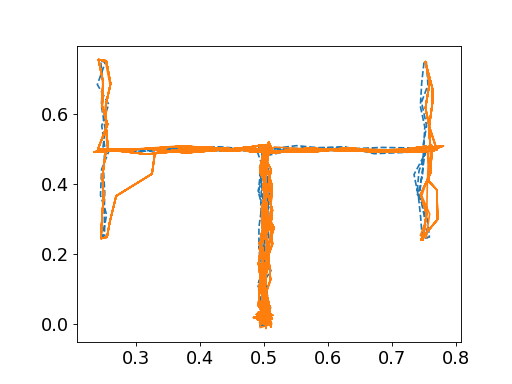

(600, 10, 2)


<IPython.core.display.Javascript object>


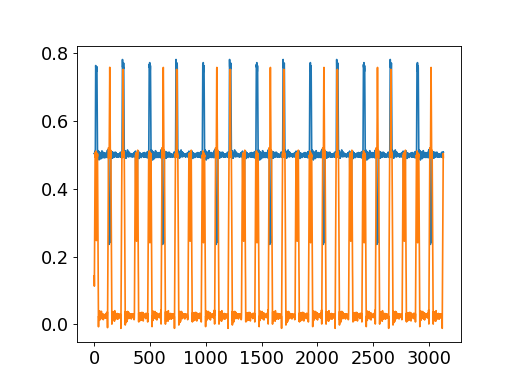

<IPython.core.display.Javascript object>


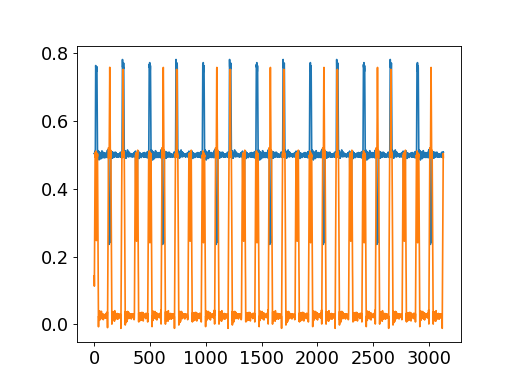

0.07110467555817503 0.24999787114236666
[0.24620146 0.24620149 0.24620143 0.24620147 0.24620147 0.24620147
 0.24620143 0.24620144 0.24620144 0.24620146 0.77051961 0.77051961
 0.77051961 0.77051967 0.77051961 0.77051961 0.77051961 0.77051961
 0.77051961 0.77051961 0.23568058 0.23568061 0.23568057 0.2356806
 0.23568061 0.23568061 0.23568057 0.2356806  0.23568058 0.23568058
 0.77963603 0.77963609 0.77963614 0.77963614 0.77963603 0.77963603
 0.77963603 0.77963597 0.77963603 0.77963609 0.24620041 0.2462004
 0.24620049 0.24620041 0.24620044 0.24620041 0.24620046 0.24620046
 0.24620046 0.24620044 0.7705195  0.7705195  0.7705195  0.7705195
 0.7705195  0.77051955 0.7705195  0.7705195  0.7705195  0.7705195
 0.2356806  0.23568057 0.2356806  0.23568058 0.23568055 0.23568055
 0.23568055 0.23568058 0.23568055 0.2356806  0.77963603 0.77963603
 0.77963603 0.77963614 0.77963603 0.77963603 0.77963603 0.77963614
 0.77963609 0.77963603 0.24620046 0.24620046 0.24620046 0.24620043
 0.24620046 0.24620044 0.2

<IPython.core.display.Javascript object>


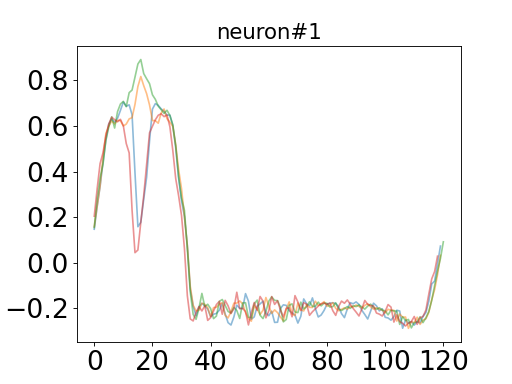

<IPython.core.display.Javascript object>


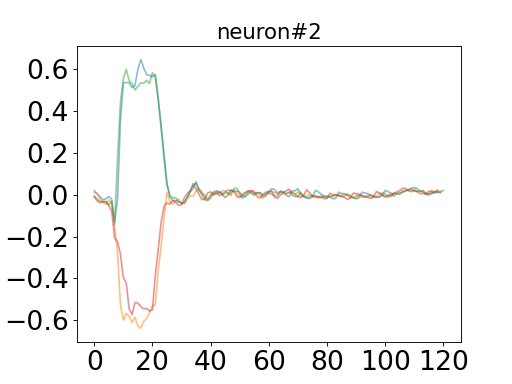

<IPython.core.display.Javascript object>


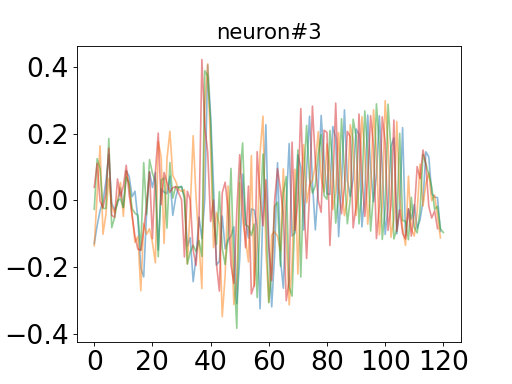

<IPython.core.display.Javascript object>


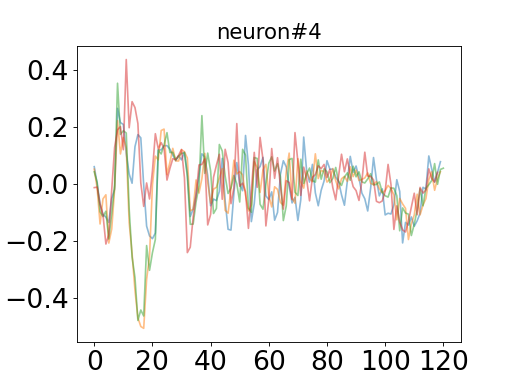

0.004818144158059776
0.035336609540323895
0.01099922068649561


<IPython.core.display.Javascript object>


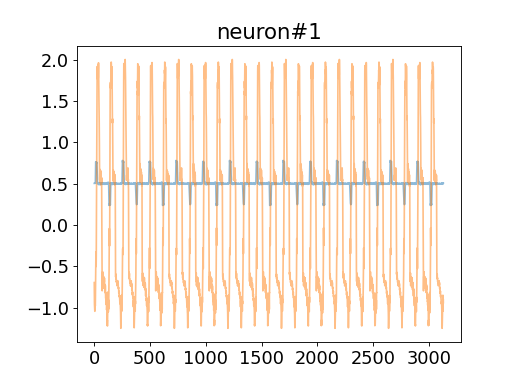

<IPython.core.display.Javascript object>


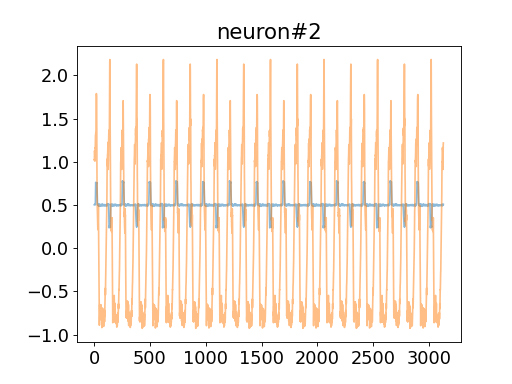

<IPython.core.display.Javascript object>


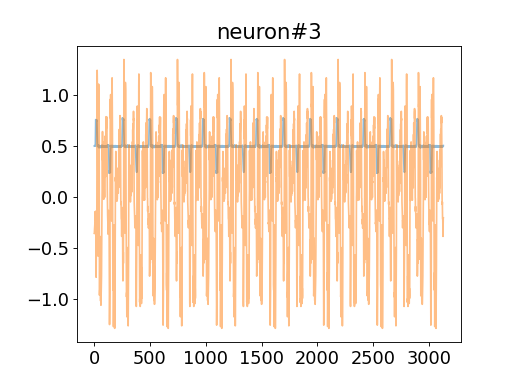

<IPython.core.display.Javascript object>


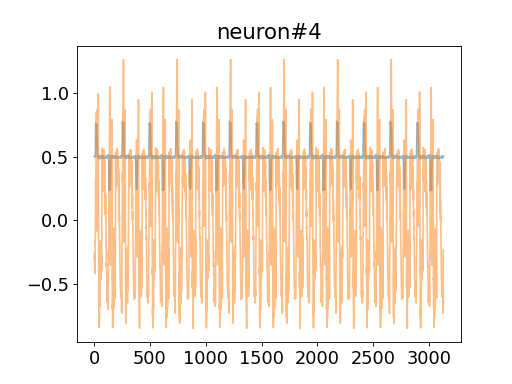

<IPython.core.display.Javascript object>


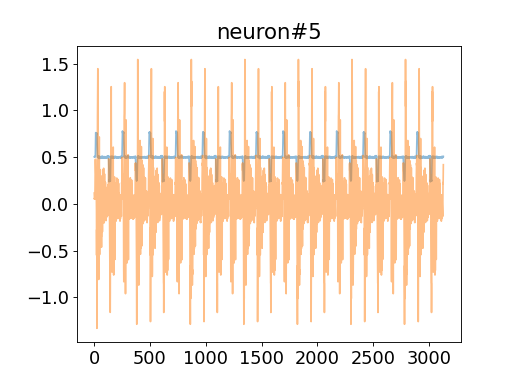

<IPython.core.display.Javascript object>


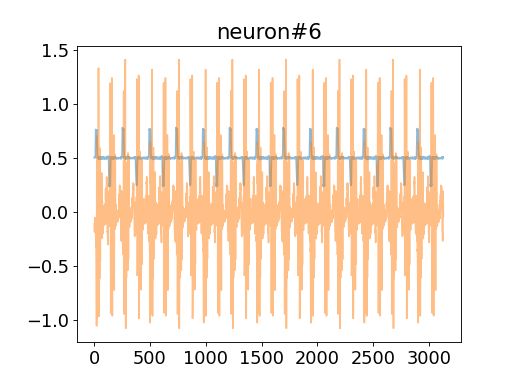

<IPython.core.display.Javascript object>


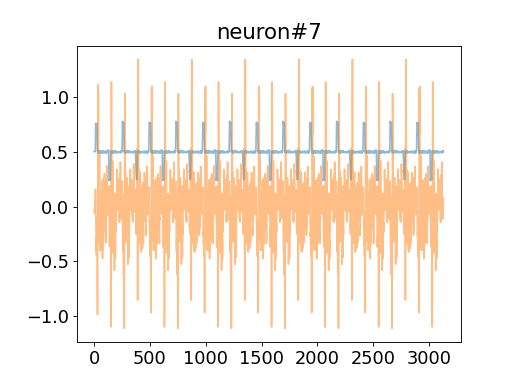

<IPython.core.display.Javascript object>


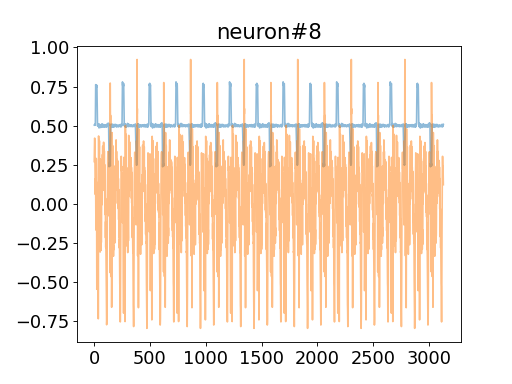

<IPython.core.display.Javascript object>


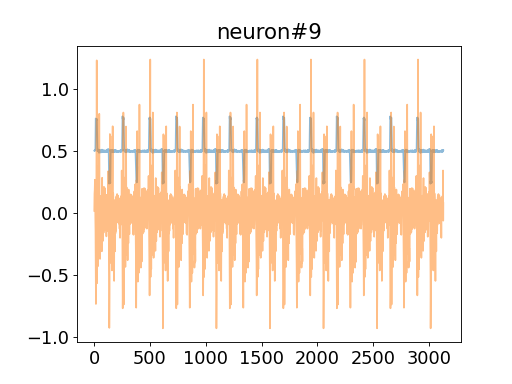

<IPython.core.display.Javascript object>


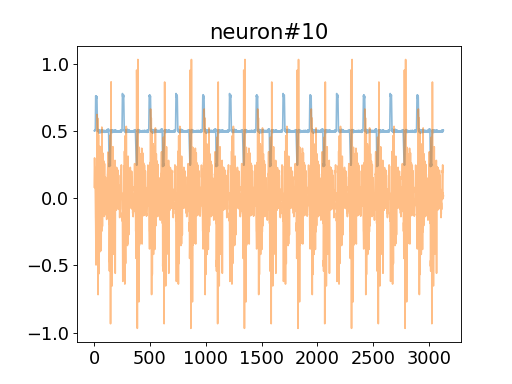

<IPython.core.display.Javascript object>


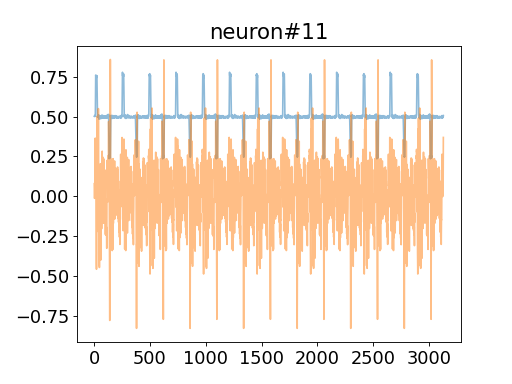

<IPython.core.display.Javascript object>


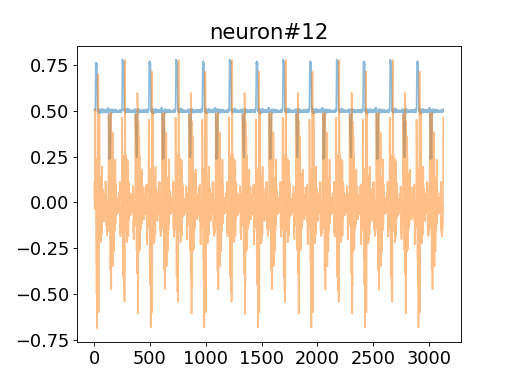

<IPython.core.display.Javascript object>


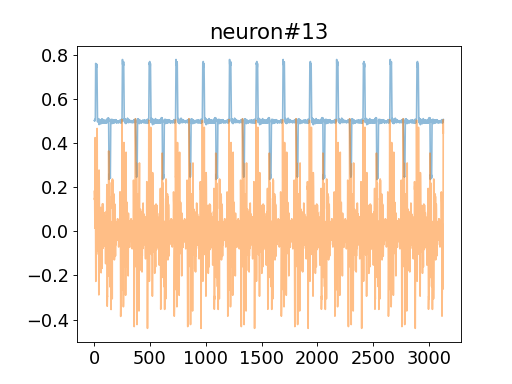

/tmp/ipykernel_2923202/3495475020.py:1205: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


<IPython.core.display.Javascript object>


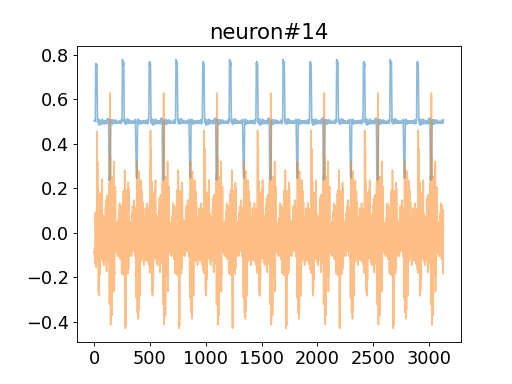

<IPython.core.display.Javascript object>


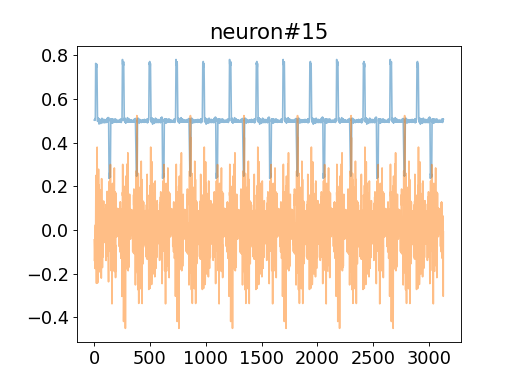

<IPython.core.display.Javascript object>


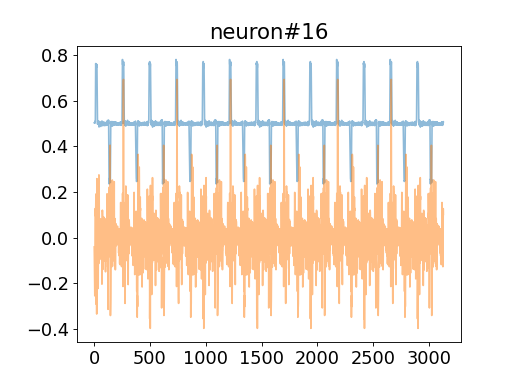

<IPython.core.display.Javascript object>


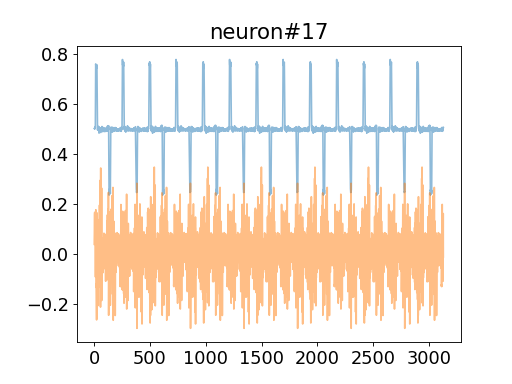

<IPython.core.display.Javascript object>


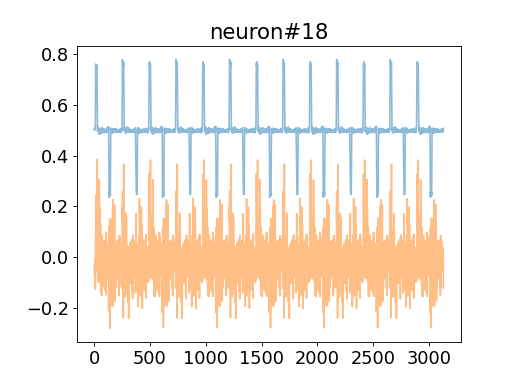

<IPython.core.display.Javascript object>


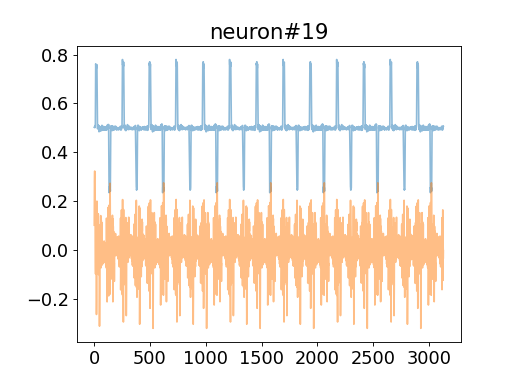

<IPython.core.display.Javascript object>


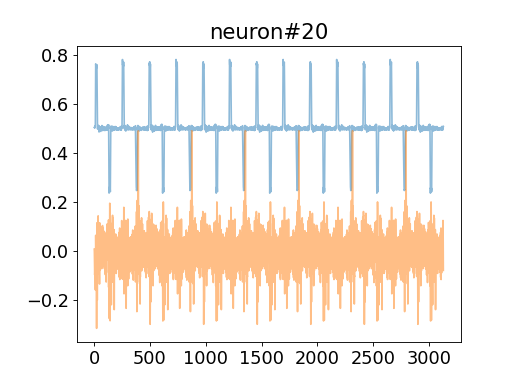

<IPython.core.display.Javascript object>


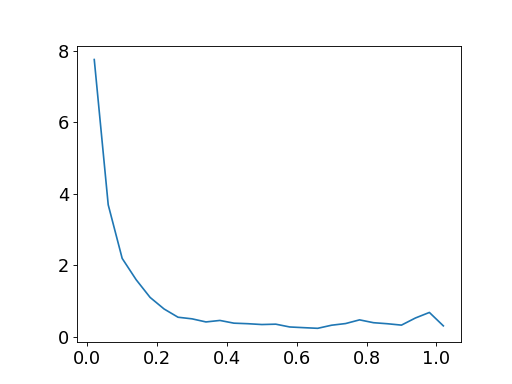

/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(array([0.        , 0.        , 7.75159744, 3.69009585, 2.19129393,
       1.59584665, 1.10063898, 0.77755591, 0.54672524, 0.50199681,
       0.41533546, 0.45686901, 0.38099042, 0.3658147 , 0.34265176,
       0.35263578, 0.27436102, 0.25519169, 0.23682109, 0.32388179,
       0.37020767, 0.47324281, 0.39376997, 0.36461661, 0.32627796,
       0.52555911, 0.68051118, 0.30551118, 0.        , 0.        ]), array([-0.1 , -0.06, -0.02,  0.02,  0.06,  0.1 ,  0.14,  0.18,  0.22,
        0.26,  0.3 ,  0.34,  0.38,  0.42,  0.46,  0.5 ,  0.54,  0.58,
        0.62,  0.66,  0.7 ,  0.74,  0.78,  0.82,  0.86,  0.9 ,  0.94,
        0.98,  1.02,  1.06,  1.1 ]))
(0.9437235847107615, 294.48549335988037, 0.23682108626198123, 96.55281471645827)


<IPython.core.display.Javascript object>


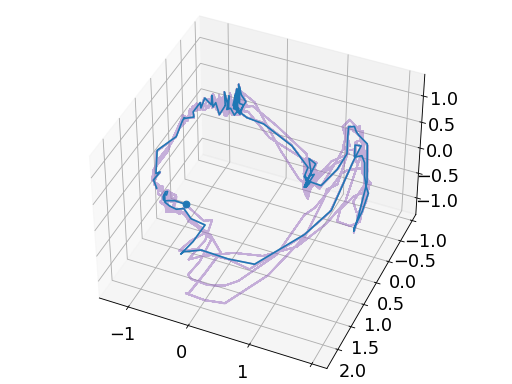

/tmp/ipykernel_2923202/3495475020.py:1270: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax3d = Axes3D(fig3d)


<IPython.core.display.Javascript object>


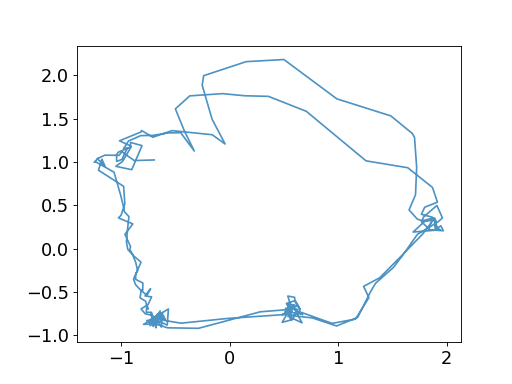

             0
PC1   0.334909
PC2   0.239889
PC3   0.111329
PC4   0.068854
PC5   0.048836
PC6   0.038164
PC7   0.031253
PC8   0.028301
PC9   0.021812
PC10  0.019034
PC11  0.012703
PC12  0.011618
PC13  0.006435
PC14  0.005839
PC15  0.005220
PC16  0.004972
PC17  0.003161
PC18  0.002902
PC19  0.002528
PC20  0.002241


In [654]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Fri Feb 19 10:54:37 2021

@author: munenori
"""

import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import time
import math
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import sklearn 
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd
import scipy

%matplotlib notebook

plt.rcParams["font.size"] = 16
plt.rcParams["figure.subplot.left"] = 0.15

def Culc_gate(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = torch.cat([hiddens[1][0][0],hiddens[2][0]])
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]

def Culc_gate_uniPFC(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = hiddens[1][0][0]
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]
    

def MakeAnimation(data_x,data_y,traj_x,traj_y, data_limit):
    fig, ax = plt.subplots()
    ims = []
    for t in range(traj_x.shape[0]):
        if t < data_limit:
            traj = ax.plot(data_x[:t], data_y[:t], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
        else:
            traj = ax.plot(data_x[:data_limit], data_y[:data_limit], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or", data_x[data_limit-1:t], data_y[data_limit-1:t], "--b")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_Re_0.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation2(data_x,data_y,traj_x,traj_y, data_limit):
    fig, ax = plt.subplots()
    ims = []
    for t in range(traj_x.shape[0]):
        if t < data_limit:
            traj = ax.plot(traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
        else:
            traj = ax.plot(traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_Re_0.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_data(data_x,data_y, data_limit):
    fig, ax = plt.subplots()
    ax.set_xlim(0.2,0.8)
    ax.set_ylim(-0.05,0.8)
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=30)    
    ani.save('anim_Re_0.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_testdata(data_x,data_y):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_test_1.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_attracter(data_x,data_y):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob",)
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_attracter_gate_PFC.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_3D(data_x,data_y):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob",)
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_attracter2.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_img(data,module):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data.shape[0]):
        img = ax.imshow(data[t].reshape(1,data.shape[1]))
        title = ax.text(0.5, 1.01, module+' time={}'.format(t),
             ha='center', va='bottom',
             transform=ax.transAxes, fontsize='large')
        ims.append([img,title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_fire_'+module+'_.gif', writer='pillow')
    plt.show()
    
    return 0


def mkOwnDataSet(data_size, data_length=100, freq=60., noise=0.01):
   
    x = np.loadtxt("primal_long131test_r.csv",delimiter=',')
    y = np.loadtxt("primal_long131test_l.csv",delimiter=',')
    train_x = []
    train_y = []
    
    for offset in range(data_size):
        train_x.append([[x[i][0] + np.random.normal(loc=0.0, scale=noise),x[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,x.shape[0],round(x.shape[0]/data_length))])
        train_y.append([[y[i][0] + np.random.normal(loc=0.0, scale=noise),y[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,y.shape[0],round(y.shape[0]/data_length))])
    return train_x, train_y

def make_Ttraj(direction):
    traj_x = np.array([])
    traj_y = np.array([])
    straight_x = np.ones(5)*0.5
    if direction == 1:
        branch1_x = np.linspace(0.5, 0.75, 5)
        branch2_x = np.linspace(0.75, 0.5, 5)
    elif direction == 2:
        branch1_x = np.linspace(0.5, 0.25, 5)
        branch2_x = np.linspace(0.25, 0.5, 5)        
    backstraight_x = np.ones(5)*0.5

    straight_y = np.linspace(0, 0.5, 5)
    branch1_y = np.linspace(0.5, 0.5, 5)
    branch2_y = np.linspace(0.5, 0.5, 5)
    backstraight_y = np.linspace(0.5 , 0, 5)
    
    traj_x = np.append(traj_x, [straight_x,branch1_x,branch2_x,backstraight_x])
    traj_y = np.append(traj_y, [straight_y,branch1_y,branch2_y,backstraight_y])
    traj = np.concatenate([[traj_x],[traj_y]],axis=0).T
    return traj

def make_Htraj(direction1, direction2):
    traj_x = np.array([])
    traj_y = np.array([])
    straight_x = np.ones(10)*0.5
    if direction1 == 1:
        branch1_x = np.linspace(0.5, 0.75, 5)
        branch2_x = np.linspace(0.75, 0.75, 5)
        branch3_x = np.linspace(0.75, 0.75, 5)
        branch4_x = np.linspace(0.75, 0.5, 5)
    elif direction1 == 2:
        branch1_x = np.linspace(0.5, 0.25, 5)
        branch2_x = np.linspace(0.25, 0.25, 5)   
        branch3_x = np.linspace(0.25, 0.25, 5)  
        branch4_x = np.linspace(0.25, 0.5, 5)       
    backstraight_x = np.ones(10)*0.5

    straight_y = np.linspace(0, 0.5, 10)
    branch1_y = np.linspace(0.5, 0.5, 5)
    if direction2 == 1:
        branch2_y = np.linspace(0.5, 0.25, 5)
        branch3_y = np.linspace(0.25, 0.5, 5)
    elif direction2 == 2:
        branch2_y = np.linspace(0.5, 0.75, 5)
        branch3_y = np.linspace(0.75, 0.5, 5)
    branch4_y = np.linspace(0.5, 0.5, 5)
    backstraight_y = np.linspace(0.5 , 0, 10)
    
    traj_x = np.append(traj_x, straight_x)
    traj_x = np.append(traj_x, [branch1_x,branch2_x,branch3_x,branch4_x])
    traj_x = np.append(traj_x, backstraight_x)
    traj_y = np.append(traj_y, straight_y)
    traj_y = np.append(traj_y, [branch1_y,branch2_y,branch3_y,branch4_y])
    traj_y = np.append(traj_y, backstraight_y)
    traj = np.concatenate([[traj_x],[traj_y]],axis=0).T
    return traj


def make_traj(delay_length):
    freq=60
    noise=0.005
    data_length = 40
    
    # x = np.loadtxt("right1.csv",delimiter=',')
    x_1 = make_Htraj(1,1)
    x_2 = make_Htraj(1,2)
    # y = np.loadtxt("left1.csv",delimiter=',')
    y_1 = make_Htraj(2,1)
    y_2 = make_Htraj(2,2)
    z = np.loadtxt("stay1.csv",delimiter=',')
    data_list = []
    ###  ver1  ###
    orders = []
    order  = np.array([1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    orders.append(order) 
    order  = np.array([2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    orders.append(order) 
    order  = np.array([3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    orders.append(order) 
    order  = np.array([4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    orders.append(order) 
    
    # ###  ver2  ###
    # orders = []
    # order  = np.array([1])
    # order  = np.append(order,np.zeros(delay_length))
    # order = np.append(order, [2])
    # orders.append(order) 
    # order  = np.array([2])
    # order  = np.append(order,np.zeros(delay_length))
    # order = np.append(order, [3])
    # orders.append(order) 
    # order  = np.array([3])
    # order  = np.append(order,np.zeros(delay_length))
    # order = np.append(order, [4])
    # orders.append(order) 
    # order  = np.array([4])
    # order  = np.append(order,np.zeros(delay_length))
    # order = np.append(order, [1])
    # orders.append(order) 
    # order = [1,0,0,0,2]
    # order = [2,0,0,1,0,0,0,2,0,0,1]
    
    ###  ver1's test  ###
    orders = []
    order  = np.array([1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    
    
    for order in orders:
        data = np.array([[0,0]])
        for idx in order:
            if idx == 1:
                target = x_1
            elif idx == 2:
                target = x_2
            elif idx == 3:
                target = y_1
            elif idx == 4:
                target = y_2
            elif idx == 0:
#                 target = np.array([[z[i][0],z[i][1]] for i in np.random.choice(z.shape[0], data_length)])
                target = np.array([[0.5,0] for i in np.random.choice(z.shape[0], data_length)])
            if idx != 0:
                target += np.random.normal(loc=0.0, scale=noise, size=target.shape)
    
            data = np.append(data,target,axis=0)
        data_list.append(data[1:])
    return data_list[0],data_list[1],data_list[2],data_list[3]

def mkOwnDataSet_auto(data_size, delay_length, freq=60., noise=0.0001):
   
    x1,x2,y1,y2 = make_traj(delay_length)
    train_x1 = []
    train_x2 = []
    train_y1 = []
    train_y2 = []
    
    for offset in range(data_size):
        train_x1.append([[x1[i][0] + np.random.normal(loc=0.0, scale=noise),x1[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(x1.shape[0])])
        train_x2.append([[x2[i][0] + np.random.normal(loc=0.0, scale=noise),x2[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(x2.shape[0])])

        train_y1.append([[y1[i][0] + np.random.normal(loc=0.0, scale=noise),y1[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(y1.shape[0])])
        train_y2.append([[y2[i][0] + np.random.normal(loc=0.0, scale=noise),y2[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(y2.shape[0])])

    return train_x1, train_x2, train_y1, train_y2

def mkOwnRandomBatch(train_x, train_t, batch_size=10):
    """
    train_x, train_tを受け取ってbatch_x, batch_tを返す
    """
    batch_x = []
    for _ in range(batch_size):
        idx = np.random.randint(0, len(train_x) - batch_size)
        batch_x.append(train_x[idx])
    return torch.tensor(batch_x).transpose(0,1)

def pick_traj_ex(traj,states):
    pointlist = np.array([])
    flag = True
    threshold = 0.2
            
    for i in range(traj.shape[0]):
        if traj[i,1] < threshold and flag == False:
            flag = True
        if traj[i,1] > threshold and flag == True:
            pointlist = np.append(pointlist,i)
            flag = False
    states_list = []
    start = 0
    for i,k in enumerate(pointlist):
        if i == 0:
            start = int(k)
            continue
        end = int(k)
        states_list.append(states[start:end])
        start = int(k)
    states_list.append(traj[start:])
    return states_list

class MyLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        nn.init.sparse_(self.PFC.weight_ih.data,1)
        nn.init.sparse_(self.HPC.weight_ih.data,1)
        nn.init.sparse_(self.PFC.weight_hh.data,1)
        nn.init.sparse_(self.HPC.weight_hh.data,1)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2][0]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,Re_hidden]

class MyLSTM_RNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse):
        super(MyLSTM_RNN, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.0
        v = 0.01
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]



class MyLSTM_RNN_noise(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse):
        super(MyLSTM_RNN_noise, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+10
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        c = 0.02
        v = 0.02
        HPC_noised = hiddens[1][0] + torch.randn(self.batch_size, self.hidden_size_HPC)*c
        PFC_noised = hiddens[0][0] + torch.randn(self.batch_size, self.hidden_size_PFC)*v
        Re_noised = hiddens[2] + torch.randn(self.batch_size, self.hidden_size_Re)*c
        Re_input = torch.cat([PFC_noised,HPC_noised],dim=1)
        Re_hidden = self.Re(Re_input, Re_noised)
        HPC_input = torch.cat([input,Re_noised],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([HPC_noised,Re_noised],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]


class MyLSTM_vHPC(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM_vHPC, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.vHPC = nn.LSTMCell(hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        sparse = 0.1
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.vHPC.weight_ih.data,sparse)
        nn.init.sparse_(self.Re.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)
        nn.init.sparse_(self.vHPC.weight_hh.data,sparse)
        nn.init.sparse_(self.Re.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[3][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        vHPC_input = hiddens[1][0]
        vHPC_hidden = self.vHPC(vHPC_input,hiddens[2])
        PFC_input = torch.cat([hiddens[2][0],hiddens[3][0]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, vHPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        vHPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,vHPC_hidden,Re_hidden]

class MyLSTM_3lay(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM_3lay, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        sparse = 0.1
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.Re.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)
        nn.init.sparse_(self.Re.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        HPC_input = torch.cat([input,hiddens[2][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input,hiddens[2])
        PFC_input = hiddens[2][0]
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        vHPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
class MyLSTM_feedforward(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse):
        super(MyLSTM_feedforward, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.Linear(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input)
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]
    

class MyLSTM_feedforward_Thalamus2(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse):
        super(MyLSTM_feedforward_Thalamus2, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.hidden_size_THinh = hidden_size
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.Linear(self.hidden_size_PFC+self.hidden_size_HPC+self.hidden_size_THinh, self.hidden_size_Re)
        self.THinh = nn.Linear(self.hidden_size_Re, self.hidden_size_THinh)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        self.ReLU = nn.ReLU()
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0],hiddens[3]],dim=1)
        Re_hidden = self.Re(Re_input)
        THinh_input = hiddens[2]
        THinh_hidden = self.ReLU(self.THinh(THinh_input))
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden,THinh_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        THinh_hidden = self.ReLU(torch.rand(self.batch_size, self.hidden_size_THinh))
        return [PFC_hidden,HPC_hidden,Re_hidden,THinh_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        THinh_hidden = self.ReLU(torch.rand(self.batch_size, self.hidden_size_THinh)*const)
        return [PFC_hidden,HPC_hidden,Re_hidden,THinh_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re,self.hidden_size_THinh]



    
    
class MyLSTM_RNN_uniPFC(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse=1):
        super(MyLSTM_RNN_uniPFC, self).__init__()

        self.hidden_size_PFC = hidden_size+0
        self.hidden_size_HPC = hidden_size+0
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.Re.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)
        nn.init.sparse_(self.Re.weight_hh.data,sparse)
        # nn.init.normal_(self.PFC.weight_ih.data,0,1/10)
        # nn.init.normal_(self.HPC.weight_ih.data,0,1/10)
        # nn.init.normal_(self.Re.weight_ih.data,0,0.1/10)
        # nn.init.normal_(self.PFC.weight_hh.data,0,1/10)
        # nn.init.normal_(self.HPC.weight_hh.data,0,1/10)
        # nn.init.normal_(self.Re.weight_hh.data,0,1/10)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = hiddens[1][0]
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.0
        v = 0.01
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*v
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]

    

def moving_average(data):
    y = np.ones(5)/5
    mean_seq = np.convolve(data, y)
    return mean_seq

def main(num):
    training_size = 100
    test_size = 1000
    epochs_num = 10
    hidden_size = 20
    batch_size = 10
    data_length = 100
    inputsize = 2
    outputsize = 2
    # model_path = 'model/ReModel_L2_interRNNrand_Reinh_AddRe_OUT5_H121_s'+str(num)+'_100_2_2.pth'
    # model_path = 'model/ReModel_L2_interRNNrand_Reinh_AddRe_OUT5_H121_s2_100_1_2.pth'
    model_path = 'model/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch180.pth'
#     model_path = 'model/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch180.pth'
#     model_path = 'model/R20_H_stopinit_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch10.pth'
#     model_path = 'model/R20_H_uniPFC_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch145.pth'
#     model_path = 'model/R20_H_uniHPC_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch190.pth'
#     model_path = 'model/R20_uniPFC_H/ReModel_L2_interRNNrand_OUT1_uniPFC_121H_s5_100_2_epoch85.pth'
#     model_path = 'model/R20_uniHPC_H/ReModel_L2_interRNNrand_OUT1_121H_s2_100_1_epoch100.pth'
#     model_path = 'model/R20_H_transfer2B/ReModel_L2_interRNNrand_OUT1_transfers14_121_s2_100_2_epoch60.pth'
#     model_path = 'model/R20FF_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch190.pth'
#     model_path = 'model/R20FF_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch100.pth'
#     model_path = 'model_test/R20_H_retrainv2_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch215.pth'
#     model_path = 'model/R20_feedReinhReLU_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch150.pth'


    sparse = 1
    delay_length = 2
    
    if os.path.exists(model_path):
        print(model_path)
    else:
        print("Not exist")
        return
    
    
    colors = ['C0','C1','C2','C3','C4','C9']

    # train_x,train_y = mkOwnDataSet(training_size,data_length)
    train_x1,train_x2,train_y1,train_y2 = mkOwnDataSet_auto(training_size,delay_length)
#     test_x = mkOwnDataSet(test_size,data_length)

    rnn = MyLSTM_RNN(inputsize, hidden_size, outputsize, batch_size, sparse)
#     rnn = MyLSTM_RNN_uniPFC(inputsize, hidden_size, outputsize, batch_size, sparse)
#     rnn = MyLSTM_feedforward(inputsize, hidden_size, outputsize, batch_size, sparse)
#     rnn = MyLSTM_feedforward_Thalamus2(inputsize, hidden_size, outputsize, batch_size, sparse)
    
    rnn.load_state_dict(torch.load(model_path))
    
    pattern = 1
    if  pattern == 1:
        data = mkOwnRandomBatch(train_x1, train_x1, batch_size).float()
    elif pattern == 2:
        data = mkOwnRandomBatch(train_x2, train_x2, batch_size).float()
    elif pattern == 3:
        data = mkOwnRandomBatch(train_y1, train_y1, batch_size).float()                
    else:
        data = mkOwnRandomBatch(train_y2, train_y2, batch_size).float()
    
    params = []
    for p in rnn.parameters():
        params.append(p.data)
    
    traj = []
    PFCstate = []
    HPCstate = []
    Restate = []
    Gate_states = []
    hidden = rnn.initHidden_rand()
    data_limit = 120
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            Gate_states.append(Culc_gate(output,params,hidden))
#             Gate_states.append(Culc_gate_uniPFC(output,params,hidden))
    for k in range(data.shape[0]*5+10):
#             if output.tolist()[0][1]<0.05:
#                 hidden = rnn.noiseHidden_rand(hidden)
            output,hidden = rnn(output,hidden) 
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
#             print(output)
            Gate_states.append(Culc_gate(output,params,hidden))
#             Gate_states.append(Culc_gate_uniPFC(output,params,hidden))
    traj = torch.tensor(traj)
    pltdata = torch.squeeze(data).numpy()
    traj = torch.squeeze(traj).numpy()
    fig = plt.figure()
    print(pltdata.shape)
    plt.plot(pltdata[:,0,0],pltdata[:,0,1],"--")
    plt.plot(traj[:,0,0],traj[:,0,1])
    plt.show()
    
    # MakeAnimation2(pltdata[:,0,0],pltdata[:,0,1], traj[:,0,0], traj[:,0,1], data_limit)
    # MakeAnimation_img(np.array(PFCstate)[:,0],"PFC")
    # MakeAnimation_img(np.array(HPCstate)[:,0],"HPC")
    # MakeAnimation_img(np.array(Restate),"Re")
    #MakeAnimation_testdata(pltdata[:,0,0],pltdata[:,0,1])
    # MakeAnimation_data(pltdata[:,0,0],pltdata[:,0,1],data_limit)

    # for n, p in rnn.named_parameters():
    #         if n == "PFC.weight_ih":
    #             PFC_w = np.array(p.data)
    #         if n == "HPC.weight_ih":
    #             HPC_w = np.array(p.data)
    #         if n == "Re.weight_ih":
    #             Re_w = np.array(p.data)
                
    # # for n, p in rnn.named_parameters():
    # #         if n == "PFC.weight_hh":
    # #             PFC_w = np.array(p.data)
    # #         if n == "HPC.weight_hh":
    # #             HPC_w = np.array(p.data)
    # #         if n == "Re.weight_hh":
    # #             Re_w = np.array(p.data)
                
    # fig2 = plt.figure()
    # ax1 = fig2.add_subplot(131)
    # ax2 = fig2.add_subplot(132)
    # axre = fig2.add_subplot(133)
    
    # ax1.imshow(PFC_w,cmap="coolwarm")
    # ax2.imshow(HPC_w,cmap="coolwarm")
    # axre.imshow(Re_w,cmap="coolwarm")
    # ax1.set_title("max = {:.2f},min = {:.2f}".format(np.max(PFC_w),np.min(PFC_w)))
    # ax2.set_title("max = {:.2f},min = {:.2f}".format(np.max(HPC_w),np.min(HPC_w)))
    # axre.set_title("max = {:.2f},min = {:.2f}".format(np.max(Re_w),np.min(Re_w)))

    
    # fig3 = plt.figure()
    # ax3 = fig3.add_subplot(131)
    # ax4 = fig3.add_subplot(132)
    # axre2 = fig3.add_subplot(133)
    # ax3.imshow(np.corrcoef(np.array(PFCstate)[:,0]))
    # ax4.imshow(np.corrcoef(np.array(HPCstate)[:,0]))
    # axre2.imshow(np.corrcoef(np.array(Restate)))
    # ax3.set_title("PFC")   
    # ax4.set_title("HPC")  
    # axre2.set_title("Re")  
    
    # Replot = plt.figure()
    # axre2 = Replot.add_subplot(111)
    # axre2.imshow(np.corrcoef(np.array(Restate)))
    # axre2.set_title("Re")  
    
#     pca = PCA()
#     # dfs = np.concatenate((np.array(PFCstate)[:,0],np.array(HPCstate)[:,0],np.array(Restate)),axis=1)
#     # dfs = np.concatenate((np.array(PFCstate)[:,0],np.array(HPCstate)[:,0]),axis=1)
#     dfs = np.array(HPCstate)[:,0]
# #     dfs = np.array(Restate)
#     pca.fit(dfs)
#     feature = pca.transform(dfs)
    # print(pd.DataFrame(feature, columns=["PC{}".format(x + 1) for x in range(dfs.shape[1])]).head())
    # print(pd.DataFrame(pca.explained_variance_ratio_, index=["PC{}".format(x + 1) for x in range(dfs.shape[1])]))
    
    # print(pd.DataFrame(pca.components_, columns=["Hidden{}".format(x + 1) for x in range(dfs.shape[1])], index=["PC{}".format(x + 1) for x in range(dfs.shape[1])]))
    
    # pred = KMeans(n_clusters=2).fit_predict(feature)
    
    # plt.figure(figsize=(6, 6))
    # plt.scatter(feature[:, 0], feature[:, 1], alpha=0.8)
    # #plt.scatter(feature[100:200, 0], feature[100:200, 1], alpha=0.8)
    # plt.scatter(feature[0, 0], feature[0, 1], c="r", alpha=0.8)
    # plt.grid()
    # plt.xlabel("PC1")
    # plt.ylabel("PC2")
    # for i in range(np.min([200,data_limit+k])):
    #     plt.annotate(i,(feature[i, 0], feature[i, 1]))
    # plt.show()
    
    # # MakeAnimation_attracter(feature[:, 0], feature[:, 1])
    
#     fig3d = plt.figure()
#     ax3d = Axes3D(fig3d)
#     ax3d.plot(feature[:, 0], feature[:, 1], feature[:, 2], alpha=0.3)
    
    # fig_place = plt.figure()
    # place3d = Axes3D(fig_place)
    # place3d.plot(traj[:,0,0], traj[:,0,1], np.array(HPCstate)[:,0,0])
    
    # fig4 = plt.figure(figsize=(10,5))
    # ax5 = fig4.add_subplot(311)
    # ax6 = fig4.add_subplot(312)
    # axRe3 = fig4.add_subplot(313)
    # #ax5.plot(np.array(PFCstate)[:,0,pred==1])
    # ax5.imshow(np.array(PFCstate)[:200,0,:].T)
    # # ax5.plot(np.average(np.array(PFCstate)[:,0,pred==0],axis=1))
    # # ax5.plot(np.average(np.array(PFCstate)[:,0,pred==1],axis=1))
    # # ax5.plot(np.average(np.array(HPCstate)[:,0],axis=1))
    # ax6.imshow(np.array(HPCstate)[:200,0,:].T)
    # axRe3.imshow(np.array(Restate)[:200,:].T)
    # ax5.set_title("PFC")   
    # ax6.set_title("HPC")  
    # axRe3.set_title("Re") 
    # print(pred==0)
    
    # # fig5 = plt.figure(figsize=(5,5))
    # # plt.plot(np.average(np.array(PFCstate)[:,0,pred==0],axis=1),np.average(np.array(PFCstate)[:,0,pred==1],axis=1))
    # # plt.show()
    # #MakeAnimation_attracter(np.average(np.array(PFCstate)[:,0,pred==0],axis=1),np.average(np.array(PFCstate)[:,0,pred==1],axis=1))
    
    
    # fig6 = plt.figure(figsize=(10,20))
    # plt.imshow(np.array(Gate_states)[:200,0,0:].T)
    # print(np.max(np.array(Gate_states)[:200,0,0:].T),np.min(np.array(Gate_states)[:,0,0:].T),np.average(np.array(Gate_states)[:,0,0:].T))
    # plt.show()
    # fig7 = plt.figure(figsize=(10,20))
    # plt.imshow(np.array(Gate_states)[:200,1,0:].T)
    # print(np.max(np.array(Gate_states)[:200,1,0:].T),np.min(np.array(Gate_states)[:,1,0:].T),np.average(np.array(Gate_states)[:,1,0:].T))
    # plt.show()
    
    # plt.figure()
    # plt.plot(np.array(Gate_states)[:,1,14])
    # plt.plot(np.array(Gate_states)[:,1,34])
    # plt.plot(np.array(Gate_states)[:,1,54])
    # plt.plot(np.array(Gate_states)[:,1,74])
    # plt.ylim(0,1)
    # plt.show()
    
    # plt.figure()
    # plt.plot(np.array(Gate_states)[:,1,13])
    # plt.plot(np.array(Gate_states)[:,1,33])
    # plt.plot(np.array(Gate_states)[:,1,53])
    # plt.plot(np.array(Gate_states)[:,1,73])
    # plt.ylim(0,1)
    # plt.show()
    
    
    # plt.figure(figsize=(20,20))
    # plt.plot(np.array(HPCstate)[:200,0,:10])
    # plt.show()
    
    #np.save("right_traj.npy",dfs)
    #np.save("left_traj.npy",dfs)
    
    # fig5 = plt.figure()
    # plt.hist(PFC_w[PFC_w.nonzero()],bins=400,range=(-2,2))
    # fig6 = plt.figure()
    # plt.hist(HPC_w[HPC_w.nonzero()],bins=400,range=(-2,2))    
    # fig7 = plt.figure()
    # plt.hist(Re_w[Re_w.nonzero()],bins=400,range=(-2,2))   
    
    
    # pca = PCA()
    # dfs = Re_w
    # pca.fit(dfs)
    # feature = pca.transform(dfs)
    # pred = KMeans(n_clusters=2).fit_predict(feature)
    
    # plt.figure(figsize=(6, 6))
    # plt.scatter(feature[:, 0], feature[:, 1], alpha=0.8)
    # plt.grid()
    # plt.xlabel("PC1")
    # plt.ylabel("PC2")

    # plt.show()
    
    plt.figure()
    plt.plot(traj[:,0,0])
    plt.plot(traj[:,0,1])
    
    delays = pick_traj(traj[:,0], np.array(traj)[:])[3:-1]
    bifur = np.array([])
    for data in delays:
        check_bifur = np.argmax(np.abs(np.array(data)[:,0,0] - 0.5))
        bifur = np.append(bifur,data[check_bifur,:,0])
    if bifur.shape[0] == 0:
        pass
    plt.figure()
    plt.plot(traj[:,0,0])
    plt.plot(traj[:,0,1])
    print(np.var(bifur),np.abs(np.median(bifur)-np.mean(bifur)))
    print(bifur)
    
    pca = PCA()
    # dfs = np.concatenate((np.array(PFCstate)[:,0],np.array(HPCstate)[:,0],np.array(Restate)),axis=1)
    # dfs = np.concatenate((np.array(PFCstate)[:,0],np.array(HPCstate)[:,0]),axis=1)
    dfs = np.array(HPCstate)[:,0]
#     dfs = np.array(Restate)
    pca.fit(dfs)
    feature = pca.transform(dfs)
    print(pd.DataFrame(pca.explained_variance_ratio_, index=["PC{}".format(x + 1) for x in range(dfs.shape[1])]))
    
    pca = PCA()
    dfs = np.array(PFCstate)[0:,0]
#     dfs = np.array(Restate)[0:]
    pca.fit(dfs)
    PFCfeature = pca.transform(dfs)
    print(pd.DataFrame(pca.explained_variance_ratio_, index=["PC{}".format(x + 1) for x in range(dfs.shape[1])]))

    pca = PCA()
#     dfs = np.array(PFCstate)[0:,0]
    dfs = np.array(Restate)[0:]
    pca.fit(dfs)
    Refeature = pca.transform(dfs)
    print(pd.DataFrame(pca.explained_variance_ratio_, index=["PC{}".format(x + 1) for x in range(dfs.shape[1])]))
    
    datalen = 120
    print(np.corrcoef(np.abs(traj[:datalen*1,0,1]-traj[datalen*2:datalen*3,0,1]),np.abs(feature[:datalen*1,0]-feature[datalen*2:datalen*3,0]))[0,1])
    
#     delays = pick_traj(traj_noise[:,0], np.array(PFCstate_noise)[:,0])
#     delays = pick_traj(traj[:,0], np.array(PFCstate)[:,0])
#     delays = pick_traj(traj_noise[:,0], np.array(HPCstate_noise)[:,0])
#     delays = pick_traj(traj[:,0], np.array(HPCstate)[:,0])
#     delays = pick_traj(traj_noise[:,0], np.array(Restate_noise)[:])
#     delays = pick_traj(traj[:,0], np.array(Restate)[:])
#     delays = pick_delay(traj[:,0], np.array(Restate)[:])
#     delays = pick_traj(traj_noise[:,0], np.array(traj_noise)[:])[3:-1]
#     delays = pick_traj(traj[:,0], np.array(Gate_states)[:,0,0:20]-np.array(Gate_states)[:,0,20:40])
#     delays = pick_traj(traj[:,0], np.array(Gate_states)[:,0,0:20])
#     delays = pick_delay(traj[:,0], np.array(Gate_states)[:,1])
#     delays = pick_traj(traj_noise[:,0], np.array(Gate_states_noise)[:,1])
#     delays = pick_delay(traj_noise[:,0], np.array(Gate_states_noise)[:,0])
#     delays = pick_traj(traj[:,0], feature[:])
#     delays = pick_traj(traj[:,0], PFCfeature[:])
    delays = pick_traj_ex(traj[:,0], feature[:])
#     delays = pick_traj_ex(traj[:,0], PFCfeature[:])
#     delays = pick_delay(traj[:,0], feature[:])

    bifur = np.array([])
    for i in range(4):
        plt.figure()
        for data in delays[0:4]:
#             avedata = moving_average(data[:,0+i])
#             plt.plot(avedata[2:-2],alpha=0.5)
#             plt.plot(data[:,0+i]-avedata[2:-2],alpha=0.5)
            plt.plot(np.array(data)[:,0+i],alpha=0.5)
#             plt.plot(np.array(data)[:,0+i]-np.array(delays[1:-1][0])[:,0+i],alpha=0.5)
#             plt.plot(np.log(data)[:,0+i],alpha=0.5)
#             print(len(data),len(avedata))
        plt.title("neuron#"+str(i+1))
        plt.yticks(fontsize=24)
        plt.xticks(fontsize=24)
#     print(np.var(bifur),np.median(bifur)-np.mean(bifur))

#     for i in range(20):
#         plt.figure()
#         delays = delays[1:-1]
#         plt.plot(np.array(delays)[,:,0+i],alpha=0.5)
#         plt.title("neuron#"+str(i+1))
# #     print(np.var(bifur),np.median(bifur)-np.mean(bifur))

    for i in range(3):
        data_len = 1000
        delays_samelen = []
        result = 0
        for data in delays[1:-1]:
            data_len = np.min([data_len,len(data)])
        for data in delays[1:-1]:
            delays_samelen.append(data[:data_len])
        delays_samelen = np.array(delays_samelen)
        for k in range(data_len):
            result += np.var(delays_samelen[:,k,i])
        result /= data_len
        print(result)
#     print(np.var(bifur),np.median(bifur)-np.mean(bifur))



#     plt.figure()
    for i in range(20):
        plt.figure()
#         plt.ylim(-1,1)
        plt.plot(traj[:,0,0],alpha=0.5)
#         plt.plot(traj_noise[:,0,1],alpha=0.5)
#         plt.plot(np.array(PFCstate_noise)[:400,0,17],alpha=0.5)
        for k in range(1):
#             plt.plot(np.array(HPCstate)[:,k,i],alpha=0.5)
#             plt.plot(np.array(HPCstate_noise)[:,k,i],alpha=0.5)
#             plt.plot(np.array(HPCstate)[:,k,i]-moving_average(np.array(HPCstate)[2:-2,k,i])[:],alpha=0.3)
#             plt.plot(np.array(PFCstate)[:,k,i],alpha=0.5)
#             plt.plot(np.array(PFCstate_noise)[:,k,i],alpha=0.5)
#             plt.plot(np.array(PFCstate)[:120,k,i],alpha=0.5)
#             plt.plot(np.array(PFCstate)[120:240,k,i],alpha=0.5)
#             plt.plot(np.array(PFCstate)[:120,k,i]-np.array(PFCstate)[120:240,k,i],alpha=0.5)
#             plt.plot(np.array(PFCstate)[:,k,i]-moving_average(np.array(PFCstate)[2:-2,k,i])[:],alpha=0.3)
#             plt.plot(np.array(PFCstate_noise)[:120,k,i],alpha=0.5)
#             plt.plot(np.array(PFCstate_noise)[120:240,k,i],alpha=0.5)
#             plt.plot(np.array(PFCstate_noise)[:120,k,i]-np.array(PFCstate_noise)[120:240,k,i],alpha=0.5)
#             plt.plot(np.array(Restate)[:,i],alpha=0.5)
#             plt.plot(np.array(Restate_noise)[:,i],alpha=0.5)
#             plt.plot(np.array(Restate)[:,i]-np.array(Restate_noise)[:,i],alpha=0.5)
#             plt.plot(np.array(Restate)[:,i]-moving_average(np.array(Restate)[2:-2,i])[:],alpha=0.3)
#             plt.plot(moving_average(np.array(Restate_noise)[:,i]),alpha=0.5)
#             plt.plot(moving_average(np.array(Restate)[:,i])-moving_average(np.array(Restate_noise)[:,i]),alpha=0.5)
#             plt.plot(np.array(Restate)[:,i]-moving_average(np.array(Restate)[:,i])[4:-4],alpha=0.5)
#             plt.plot(np.array(Gate_states)[:,0,0+i],"o",alpha=0.5)
#             plt.plot(np.array(Gate_states)[:,1,0+i],"o",alpha=0.5)
#             plt.plot(np.array(Gate_states_noise)[:,1,0+i],alpha=0.5)
#             plt.plot(np.abs(np.array(Gate_states)[:,1,0+i]-np.array(Gate_states_noise)[:,1,0+i]),alpha=0.5)
#             plt.plot(np.log(np.array(Gate_states)[:,1,0+i]/np.array(Gate_states)[:,1,20+i]),alpha=0.5)
#             plt.plot(np.log(np.array(Gate_states_noise)[:,1,0+i]/np.array(Gate_states_noise)[:,1,20+i]),alpha=0.5)
#             plt.plot(np.log(np.array(Gate_states)[:,0,0+i]/np.array(Gate_states)[:,0,20+i]),alpha=0.5)
#             plt.plot(np.log(np.array(Gate_states_noise)[:,0,0+i]/np.array(Gate_states_noise)[:,0,20+i]),alpha=0.5)
            plt.plot(np.array(PFCfeature)[:,i],alpha=0.5)
#             plt.plot(np.array(PFCfeature)[:,0]-moving_average(np.array(PFCfeature)[2:-2,0]),alpha=0.5)
#             plt.plot(np.array(Refeature)[:,1],alpha=0.5)
#             plt.plot(np.array(Refeature)[:,1]-moving_average(np.array(Refeature)[:,1])[2:-2],alpha=0.5)

        plt.title("neuron#"+str(i+1))
    
#     fig = plt.figure()
#     fig1 = fig.add_subplot(111)
#     fig1.hist(np.array(Gate_states)[:,1,0:20].ravel(),bins=30,range=(-0.1,1.1),alpha=0.5,density=True)
#     plt.show()
    
    fig = plt.figure()
    fig1 = fig.add_subplot(111)
    hist = np.histogram(np.array(Gate_states)[:,1,0:20].ravel(),bins=30,range=(-0.1,1.1),density=True)
    print(hist)
    plt.plot(hist[1][3:-2],hist[0][2:-2])
    plt.show()
    
    beta = scipy.stats.beta.fit(hist[0][2:-2])
    print(beta)
    
    
    pca = PCA()
    dfs = np.array(PFCstate)[0:,0]
#     dfs = np.array(Restate)[0:]
    pca.fit(dfs)
    feature = pca.transform(dfs)
    
#     pred = KMeans(n_clusters=2).fit_predict(feature)

    fig3d = plt.figure()
    ax3d = Axes3D(fig3d)
    ax3d.plot(feature[:, 0], feature[:, 1], feature[:, 2], color=colors[4], alpha=0.5)
#     ax3d.plot(feature[40:, 0], feature[100:, 1], feature[100:, 2], alpha=0.7)
    ax3d.plot(feature[0:1, 0], feature[0:1, 1], feature[0:1, 2], "o", color=colors[0], alpha=1)
    ax3d.plot(feature[:120, 0], feature[:120, 1], feature[:120, 2], color=colors[0], alpha=1)
#     ax3d.plot(feature[19:20, 0], feature[19:20, 1], feature[19:20, 2], "o", color=colors[1], alpha=1)
#     ax3d.plot(feature[19:40, 0], feature[19:40, 1], feature[19:40, 2], color=colors[1], alpha=1)
#     ax3d.plot(feature[39:40, 0], feature[39:40, 1], feature[39:40, 2], "o", color=colors[2], alpha=1)
#     ax3d.plot(feature[39:120, 0], feature[39:120, 1], feature[39:120, 2], color=colors[2], alpha=1)
#     ax3d.plot(feature[119:120, 0], feature[119:120, 1], feature[119:120, 2], "o", color=colors[3], alpha=1)
#     ax3d.plot(feature[240:241, 0], feature[240:241, 1], feature[240:241, 2],"o", alpha=1)
    ax3d.invert_zaxis()
    plt.show()
    
    plt.figure()
    plt.plot(feature[:240, 0], feature[:240, 1], alpha=0.8)
    plt.show()
    
    print(pd.DataFrame(pca.explained_variance_ratio_, index=["PC{}".format(x + 1) for x in range(dfs.shape[1])]))

    
    
if __name__ == '__main__':
    features = []
    for i in range(1):
        features.append(main(i+1))

# For Reguression and estimate of HPC/PFC module and traj

<IPython.core.display.Javascript object>


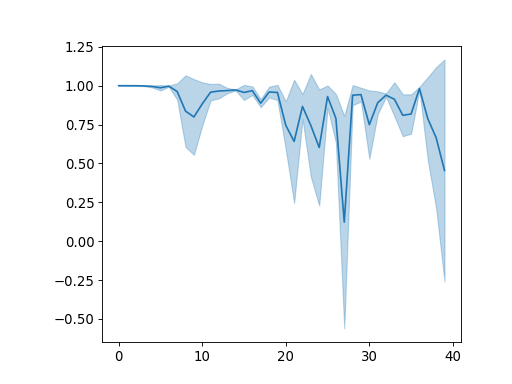

model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch0.pth
(170, 20) (170, 2)
0.9999980656701264
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch5.pth
(170, 20) (170, 2)
0.9999895013070047
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch10.pth
(170, 20) (170, 2)
0.9999887560463531
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch15.pth
(170, 20) (170, 2)
0.9994746963969529
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch20.pth
(170, 20) (170, 2)
0.9999511647848823
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch25.pth
(170, 20) (170, 2)
0.999893187594377
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch30.pth
(170, 20) (170, 2)
0.9918025377566055
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch35.pth
(170, 20) (170, 2)
0.9994447629583328
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_

(170, 20) (170, 2)
0.8818563078582338
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch150.pth
(170, 20) (170, 2)
0.46343042701054143
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch155.pth
(170, 20) (170, 2)
0.8295806104276395
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch160.pth
(170, 20) (170, 2)
0.9511470286450707
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch165.pth
(170, 20) (170, 2)
0.9825110836719964
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch170.pth
(170, 20) (170, 2)
0.6954016593168935
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch175.pth
(170, 20) (170, 2)
0.673403262415218
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch180.pth
(170, 20) (170, 2)
0.969231720945065
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch185.pth
(170, 20) (170, 2)
0.4101666686162917
mod

In [577]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Fri Feb 19 10:54:37 2021

@author: munenori
"""

import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import time
import math
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import sklearn 
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd
import scipy

%matplotlib notebook


def Culc_gate(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = torch.cat([hiddens[1][0][0],hiddens[2][0]])
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]

def Culc_gate_uniPFC(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = hiddens[1][0][0]
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]
    

def MakeAnimation(data_x,data_y,traj_x,traj_y, data_limit):
    fig, ax = plt.subplots()
    ims = []
    for t in range(traj_x.shape[0]):
        if t < data_limit:
            traj = ax.plot(data_x[:t], data_y[:t], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
        else:
            traj = ax.plot(data_x[:data_limit], data_y[:data_limit], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or", data_x[data_limit-1:t], data_y[data_limit-1:t], "--b")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_Re_0.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation2(data_x,data_y,traj_x,traj_y, data_limit):
    fig, ax = plt.subplots()
    ims = []
    for t in range(traj_x.shape[0]):
        if t < data_limit:
            traj = ax.plot(traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
        else:
            traj = ax.plot(traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_Re_0.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_data(data_x,data_y, data_limit):
    fig, ax = plt.subplots()
    ax.set_xlim(0.2,0.8)
    ax.set_ylim(-0.05,0.8)
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=30)    
    ani.save('anim_Re_0.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_testdata(data_x,data_y):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_test_1.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_attracter(data_x,data_y):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob",)
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_attracter_gate_PFC.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_3D(data_x,data_y):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob",)
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_attracter2.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_img(data,module):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data.shape[0]):
        img = ax.imshow(data[t].reshape(1,data.shape[1]))
        title = ax.text(0.5, 1.01, module+' time={}'.format(t),
             ha='center', va='bottom',
             transform=ax.transAxes, fontsize='large')
        ims.append([img,title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_fire_'+module+'_.gif', writer='pillow')
    plt.show()
    
    return 0


def mkOwnDataSet(data_size, data_length=100, freq=60., noise=0.01):
   
    x = np.loadtxt("primal_long131test_r.csv",delimiter=',')
    y = np.loadtxt("primal_long131test_l.csv",delimiter=',')
    train_x = []
    train_y = []
    
    for offset in range(data_size):
        train_x.append([[x[i][0] + np.random.normal(loc=0.0, scale=noise),x[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,x.shape[0],round(x.shape[0]/data_length))])
        train_y.append([[y[i][0] + np.random.normal(loc=0.0, scale=noise),y[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,y.shape[0],round(y.shape[0]/data_length))])
    return train_x, train_y

def make_Ttraj(direction):
    traj_x = np.array([])
    traj_y = np.array([])
    straight_x = np.ones(5)*0.5
    if direction == 1:
        branch1_x = np.linspace(0.5, 0.75, 5)
        branch2_x = np.linspace(0.75, 0.5, 5)
    elif direction == 2:
        branch1_x = np.linspace(0.5, 0.25, 5)
        branch2_x = np.linspace(0.25, 0.5, 5)        
    backstraight_x = np.ones(5)*0.5

    straight_y = np.linspace(0, 0.5, 5)
    branch1_y = np.linspace(0.5, 0.5, 5)
    branch2_y = np.linspace(0.5, 0.5, 5)
    backstraight_y = np.linspace(0.5 , 0, 5)
    
    traj_x = np.append(traj_x, [straight_x,branch1_x,branch2_x,backstraight_x])
    traj_y = np.append(traj_y, [straight_y,branch1_y,branch2_y,backstraight_y])
    traj = np.concatenate([[traj_x],[traj_y]],axis=0).T
    return traj

def make_Htraj(direction1, direction2):
    traj_x = np.array([])
    traj_y = np.array([])
    straight_x = np.ones(10)*0.5
    if direction1 == 1:
        branch1_x = np.linspace(0.5, 0.75, 5)
        branch2_x = np.linspace(0.75, 0.75, 5)
        branch3_x = np.linspace(0.75, 0.75, 5)
        branch4_x = np.linspace(0.75, 0.5, 5)
    elif direction1 == 2:
        branch1_x = np.linspace(0.5, 0.25, 5)
        branch2_x = np.linspace(0.25, 0.25, 5)   
        branch3_x = np.linspace(0.25, 0.25, 5)  
        branch4_x = np.linspace(0.25, 0.5, 5)       
    backstraight_x = np.ones(10)*0.5

    straight_y = np.linspace(0, 0.5, 10)
    branch1_y = np.linspace(0.5, 0.5, 5)
    if direction2 == 1:
        branch2_y = np.linspace(0.5, 0.25, 5)
        branch3_y = np.linspace(0.25, 0.5, 5)
    elif direction2 == 2:
        branch2_y = np.linspace(0.5, 0.75, 5)
        branch3_y = np.linspace(0.75, 0.5, 5)
    branch4_y = np.linspace(0.5, 0.5, 5)
    backstraight_y = np.linspace(0.5 , 0, 10)
    
    traj_x = np.append(traj_x, straight_x)
    traj_x = np.append(traj_x, [branch1_x,branch2_x,branch3_x,branch4_x])
    traj_x = np.append(traj_x, backstraight_x)
    traj_y = np.append(traj_y, straight_y)
    traj_y = np.append(traj_y, [branch1_y,branch2_y,branch3_y,branch4_y])
    traj_y = np.append(traj_y, backstraight_y)
    traj = np.concatenate([[traj_x],[traj_y]],axis=0).T
    return traj


def make_traj(delay_length):
    freq=60
    noise=0.005
    data_length = 40
    
    # x = np.loadtxt("right1.csv",delimiter=',')
    x_1 = make_Htraj(1,1)
    x_2 = make_Htraj(1,2)
    # y = np.loadtxt("left1.csv",delimiter=',')
    y_1 = make_Htraj(2,1)
    y_2 = make_Htraj(2,2)
    z = np.loadtxt("stay1.csv",delimiter=',')
    data_list = []
    ###  ver1  ###
    orders = []
    order  = np.array([1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    orders.append(order) 
    order  = np.array([2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    orders.append(order) 
    order  = np.array([3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    orders.append(order) 
    order  = np.array([4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    orders.append(order) 
    
    # ###  ver2  ###
    # orders = []
    # order  = np.array([1])
    # order  = np.append(order,np.zeros(delay_length))
    # order = np.append(order, [2])
    # orders.append(order) 
    # order  = np.array([2])
    # order  = np.append(order,np.zeros(delay_length))
    # order = np.append(order, [3])
    # orders.append(order) 
    # order  = np.array([3])
    # order  = np.append(order,np.zeros(delay_length))
    # order = np.append(order, [4])
    # orders.append(order) 
    # order  = np.array([4])
    # order  = np.append(order,np.zeros(delay_length))
    # order = np.append(order, [1])
    # orders.append(order) 
    # order = [1,0,0,0,2]
    # order = [2,0,0,1,0,0,0,2,0,0,1]
    
    ###  ver1's test  ###
    orders = []
    order  = np.array([1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    
    
    for order in orders:
        data = np.array([[0,0]])
        for idx in order:
            if idx == 1:
                target = x_1
            elif idx == 2:
                target = x_2
            elif idx == 3:
                target = y_1
            elif idx == 4:
                target = y_2
            elif idx == 0:
#                 target = np.array([[z[i][0],z[i][1]] for i in np.random.choice(z.shape[0], data_length)])
                target = np.array([[0.5,0] for i in np.random.choice(z.shape[0], data_length)])
            if idx != 0:
                target += np.random.normal(loc=0.0, scale=noise, size=target.shape)
    
            data = np.append(data,target,axis=0)
        data_list.append(data[1:])
    return data_list[0],data_list[1],data_list[2],data_list[3]

def mkOwnDataSet_auto(data_size, delay_length, freq=60., noise=0.0001):
   
    x1,x2,y1,y2 = make_traj(delay_length)
    train_x1 = []
    train_x2 = []
    train_y1 = []
    train_y2 = []
    
    for offset in range(data_size):
        train_x1.append([[x1[i][0] + np.random.normal(loc=0.0, scale=noise),x1[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(x1.shape[0])])
        train_x2.append([[x2[i][0] + np.random.normal(loc=0.0, scale=noise),x2[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(x2.shape[0])])

        train_y1.append([[y1[i][0] + np.random.normal(loc=0.0, scale=noise),y1[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(y1.shape[0])])
        train_y2.append([[y2[i][0] + np.random.normal(loc=0.0, scale=noise),y2[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(y2.shape[0])])

    return train_x1, train_x2, train_y1, train_y2

def mkOwnRandomBatch(train_x, train_t, batch_size=10):
    """
    train_x, train_tを受け取ってbatch_x, batch_tを返す
    """
    batch_x = []
    for _ in range(batch_size):
        idx = np.random.randint(0, len(train_x) - batch_size)
        batch_x.append(train_x[idx])
    return torch.tensor(batch_x).transpose(0,1)

class MyLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        nn.init.sparse_(self.PFC.weight_ih.data,1)
        nn.init.sparse_(self.HPC.weight_ih.data,1)
        nn.init.sparse_(self.PFC.weight_hh.data,1)
        nn.init.sparse_(self.HPC.weight_hh.data,1)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2][0]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,Re_hidden]

class MyLSTM_RNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse):
        super(MyLSTM_RNN, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.0
        v = 0.01
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]



class MyLSTM_RNN_noise(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse):
        super(MyLSTM_RNN_noise, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+10
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        c = 0.02
        v = 0.02
        HPC_noised = hiddens[1][0] + torch.randn(self.batch_size, self.hidden_size_HPC)*c
        PFC_noised = hiddens[0][0] + torch.randn(self.batch_size, self.hidden_size_PFC)*v
        Re_noised = hiddens[2] + torch.randn(self.batch_size, self.hidden_size_Re)*c
        Re_input = torch.cat([PFC_noised,HPC_noised],dim=1)
        Re_hidden = self.Re(Re_input, Re_noised)
        HPC_input = torch.cat([input,Re_noised],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([HPC_noised,Re_noised],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]


class MyLSTM_vHPC(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM_vHPC, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.vHPC = nn.LSTMCell(hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        sparse = 0.1
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.vHPC.weight_ih.data,sparse)
        nn.init.sparse_(self.Re.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)
        nn.init.sparse_(self.vHPC.weight_hh.data,sparse)
        nn.init.sparse_(self.Re.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[3][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        vHPC_input = hiddens[1][0]
        vHPC_hidden = self.vHPC(vHPC_input,hiddens[2])
        PFC_input = torch.cat([hiddens[2][0],hiddens[3][0]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, vHPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        vHPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,vHPC_hidden,Re_hidden]

class MyLSTM_3lay(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM_3lay, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        sparse = 0.1
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.Re.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)
        nn.init.sparse_(self.Re.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        HPC_input = torch.cat([input,hiddens[2][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input,hiddens[2])
        PFC_input = hiddens[2][0]
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        vHPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
class MyLSTM_feedforward(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse):
        super(MyLSTM_feedforward, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.Linear(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input)
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]
    

class MyLSTM_feedforward_Thalamus2(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse):
        super(MyLSTM_feedforward_Thalamus2, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.hidden_size_THinh = hidden_size
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.Linear(self.hidden_size_PFC+self.hidden_size_HPC+self.hidden_size_THinh, self.hidden_size_Re)
        self.THinh = nn.Linear(self.hidden_size_Re, self.hidden_size_THinh)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        self.ReLU = nn.ReLU()
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0],hiddens[3]],dim=1)
        Re_hidden = self.Re(Re_input)
        THinh_input = hiddens[2]
        THinh_hidden = self.ReLU(self.THinh(THinh_input))
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden,THinh_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        THinh_hidden = self.ReLU(torch.rand(self.batch_size, self.hidden_size_THinh))
        return [PFC_hidden,HPC_hidden,Re_hidden,THinh_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        THinh_hidden = self.ReLU(torch.rand(self.batch_size, self.hidden_size_THinh)*const)
        return [PFC_hidden,HPC_hidden,Re_hidden,THinh_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re,self.hidden_size_THinh]



    
    
class MyLSTM_RNN_uniPFC(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse=1):
        super(MyLSTM_RNN_uniPFC, self).__init__()

        self.hidden_size_PFC = hidden_size+0
        self.hidden_size_HPC = hidden_size+0
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.Re.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)
        nn.init.sparse_(self.Re.weight_hh.data,sparse)
        # nn.init.normal_(self.PFC.weight_ih.data,0,1/10)
        # nn.init.normal_(self.HPC.weight_ih.data,0,1/10)
        # nn.init.normal_(self.Re.weight_ih.data,0,0.1/10)
        # nn.init.normal_(self.PFC.weight_hh.data,0,1/10)
        # nn.init.normal_(self.HPC.weight_hh.data,0,1/10)
        # nn.init.normal_(self.Re.weight_hh.data,0,1/10)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = hiddens[1][0]
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.0
        v = 0.01
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*v
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]

    

def moving_average(data):
    y = np.ones(5)/5
    mean_seq = np.convolve(data, y)
    return mean_seq

def main(model):
    training_size = 100
    test_size = 1000
    epochs_num = 10
    hidden_size = 20
    batch_size = 10
    data_length = 100
    inputsize = 2
    outputsize = 2
    # model_path = 'model/ReModel_L2_interRNNrand_Reinh_AddRe_OUT5_H121_s'+str(num)+'_100_2_2.pth'
    # model_path = 'model/ReModel_L2_interRNNrand_Reinh_AddRe_OUT5_H121_s2_100_1_2.pth'
#     model_path = 'model/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch180.pth'
    
    model_path = model

    sparse = 1
    delay_length = 2
    
    if os.path.exists(model_path):
        print(model_path)
    else:
        print("Not exist")
        return
    
    
    colors = ['C0','C1','C2','C3','C4','C9']

    # train_x,train_y = mkOwnDataSet(training_size,data_length)
    train_x1,train_x2,train_y1,train_y2 = mkOwnDataSet_auto(training_size,delay_length)
#     test_x = mkOwnDataSet(test_size,data_length)

    rnn = MyLSTM_RNN(inputsize, hidden_size, outputsize, batch_size, sparse)
#     rnn = MyLSTM_RNN_uniPFC(inputsize, hidden_size, outputsize, batch_size, sparse)
#     rnn = MyLSTM_feedforward(inputsize, hidden_size, outputsize, batch_size, sparse)
#     rnn = MyLSTM_feedforward_Thalamus2(inputsize, hidden_size, outputsize, batch_size, sparse)
    
    rnn.load_state_dict(torch.load(model_path))
    
    pattern = 1
    if  pattern == 1:
        data = mkOwnRandomBatch(train_x1, train_x1, batch_size).float()
    elif pattern == 2:
        data = mkOwnRandomBatch(train_x2, train_x2, batch_size).float()
    elif pattern == 3:
        data = mkOwnRandomBatch(train_y1, train_y1, batch_size).float()                
    else:
        data = mkOwnRandomBatch(train_y2, train_y2, batch_size).float()
    
    params = []
    for p in rnn.parameters():
        params.append(p.data)
    
    traj = []
    PFCstate = []
    HPCstate = []
    Restate = []
    Gate_states = []
    hidden = rnn.initHidden_rand()
    data_limit = 160
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            Gate_states.append(Culc_gate(output,params,hidden))
#             Gate_states.append(Culc_gate_uniPFC(output,params,hidden))
    for k in range(data.shape[0]*0+10):
#             if output.tolist()[0][1]<0.05:
#                 hidden = rnn.noiseHidden_rand(hidden)
            output,hidden = rnn(output,hidden) 
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
#             print(output)
            Gate_states.append(Culc_gate(output,params,hidden))
#             Gate_states.append(Culc_gate_uniPFC(output,params,hidden))
    traj = torch.tensor(traj)
    pltdata = torch.squeeze(data).numpy()
    traj = torch.squeeze(traj).numpy()
#     fig = plt.figure()
#     print(pltdata.shape)
#     plt.plot(pltdata[:,0,0],pltdata[:,0,1],"--")
#     plt.plot(traj[:,0,0],traj[:,0,1])
#     plt.show()
    
#     print(np.array(HPCstate)[:,0].shape,np.array(traj)[:,0].shape)
#     reg = sklearn.linear_model.LinearRegression().fit(np.array(PFCstate)[:,0],np.array(traj)[:,0])
#     score = reg.score(np.array(PFCstate)[:,1],np.array(traj)[:,1])
    
    print(np.array(HPCstate)[:,0].shape,np.array(traj)[:,0].shape)
    reg = sklearn.linear_model.LinearRegression().fit(np.array(HPCstate)[10:30,0],np.array(traj)[10:30,0])
    score = reg.score(np.array(HPCstate)[130:150,1],np.array(traj)[130:150,1])
    print(score)

    return score
#     return 0
    
if __name__ == '__main__':
    fig = plt.figure()
    correlation_fig = fig.subplots()
    
    all_list = []
    for num in range(1):
        for i in range(3):
            path = 'model/R20_H_bigbatch/'
#             path = 'model/R20_H_uniHPC_bigbatch/'
            model_list = glob.glob(path+'*s'+str(i+1)+'_100_'+str(num+1)+'_*epoch*.pth')
            model_list = sorted(model_list)
            model_list = sorted(model_list,key=len,reverse=False)
            with open(path+"good_list.txt", mode="r") as f:
                good_list = f.read().splitlines()
#             good_list = []
            if i+1 == 7 and num+1 == 3:
                continue
            if i+1 == 5 and num+1 == 3:
                continue
            
            first_goodmodel = [0,0]
            good_flag = False
            activity_list = []
            k=0
            for model in model_list:
#                 if model in good_list:
#                     pass
#                 else:
#                     continue
#                 print(model)
                if int(model.split("epoch")[-1].split(".")[0])>199:
                    continue
                activity = main(model)
                activity_list.append(activity)

                k+=1
#             correlation_fig.plot(Re_activity,color="C{}".format(i))
            all_list.append(activity_list)
    all_list = np.array(all_list)
    print(all_list)
    correlation_fig.plot(np.mean(all_list,axis=0).T,color="C0")
    correlation_fig.fill_between(np.arange(all_list.shape[1]),np.mean(all_list,axis=0).T-np.sqrt(np.var(all_list,axis=0).T),np.mean(all_list,axis=0).T+np.sqrt(np.var(all_list,axis=0).T), color="C0", alpha=0.3)


<IPython.core.display.Javascript object>


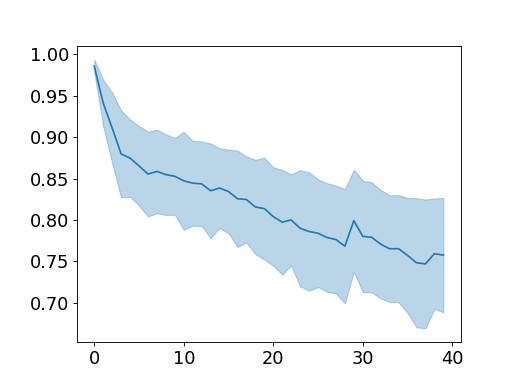

model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch0.pth
(770, 20) (770, 2)
0.9861001145022092
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch5.pth
(770, 20) (770, 2)
0.950048267376727
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch10.pth
(770, 20) (770, 2)
0.9156269928211571
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch15.pth
(770, 20) (770, 2)
0.8293771650040938
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch20.pth
(770, 20) (770, 2)
0.8601881874587679
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch25.pth
(770, 20) (770, 2)
0.8410269851314527
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch30.pth
(770, 20) (770, 2)
0.8015237731431739
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch35.pth
(770, 20) (770, 2)
0.8841226454073818
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_

(770, 20) (770, 2)
0.7585642607913331
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch150.pth
(770, 20) (770, 2)
0.7308704017074397
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch155.pth
(770, 20) (770, 2)
0.7174488290947625
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch160.pth
(770, 20) (770, 2)
0.8004546720710014
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch165.pth
(770, 20) (770, 2)
0.7158354598223928
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch170.pth
(770, 20) (770, 2)
0.7038061679972376
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch175.pth
(770, 20) (770, 2)
0.8046970816348296
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch180.pth
(770, 20) (770, 2)
0.6958759592327884
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch185.pth
(770, 20) (770, 2)
0.7582871181457629
mo

(770, 20) (770, 2)
0.8932863041980258
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch95.pth
(770, 20) (770, 2)
0.9159420893527095
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch100.pth
(770, 20) (770, 2)
0.9169041545813534
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch105.pth
(770, 20) (770, 2)
0.9175324220166388
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch110.pth
(770, 20) (770, 2)
0.8966081111483812
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch115.pth
(770, 20) (770, 2)
0.8932272713248581
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch120.pth
(770, 20) (770, 2)
0.8844648180193527
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch125.pth
(770, 20) (770, 2)
0.8857856327132568
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch130.pth
(770, 20) (770, 2)
0.8915162905899701
mod

(770, 20) (770, 2)
0.8517518757517404
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch40.pth
(770, 20) (770, 2)
0.8673636557660069
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch45.pth
(770, 20) (770, 2)
0.8334453967398525
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch50.pth
(770, 20) (770, 2)
0.7912028203419161
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch55.pth
(770, 20) (770, 2)
0.8315167037912424
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch60.pth
(770, 20) (770, 2)
0.8364514890738368
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch65.pth
(770, 20) (770, 2)
0.8197971791514773
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch70.pth
(770, 20) (770, 2)
0.8467406538356596
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch75.pth
(770, 20) (770, 2)
0.802722089427161
model_deigo

(770, 20) (770, 2)
0.6924219072517206
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch185.pth
(770, 20) (770, 2)
0.7300245737608979
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch190.pth
(770, 20) (770, 2)
0.8760186401210527
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch195.pth
(770, 20) (770, 2)
0.8923977168942404
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch0.pth
(770, 20) (770, 2)
0.9888975680750217
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch5.pth
(770, 20) (770, 2)
0.9809576261441542
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch10.pth
(770, 20) (770, 2)
0.9301797290660874
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch15.pth
(770, 20) (770, 2)
0.90410224285356
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch20.pth
(770, 20) (770, 2)
0.89168235500478
model_deigo/R

(770, 20) (770, 2)
0.776078220912006
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch130.pth
(770, 20) (770, 2)
0.7623528601988065
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch135.pth
(770, 20) (770, 2)
0.7997728995423201
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch140.pth
(770, 20) (770, 2)
0.7534339741645808
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch145.pth
(770, 20) (770, 2)
0.6968831171355206
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch150.pth
(770, 20) (770, 2)
0.7570810197835136
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch155.pth
(770, 20) (770, 2)
0.701731894116433
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch160.pth
(770, 20) (770, 2)
0.6399186162640802
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch165.pth
(770, 20) (770, 2)
0.653564802787163
model

(770, 20) (770, 2)
0.8132059251161368
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch75.pth
(770, 20) (770, 2)
0.7997063197875605
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch80.pth
(770, 20) (770, 2)
0.7813058331213221
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch85.pth
(770, 20) (770, 2)
0.798019709431725
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch90.pth
(770, 20) (770, 2)
0.817633549970906
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch95.pth
(770, 20) (770, 2)
0.673769950359179
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch100.pth
(770, 20) (770, 2)
0.8144701409504269
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch105.pth
(770, 20) (770, 2)
0.8235502647962605
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch110.pth
(770, 20) (770, 2)
0.8195952515340345
model_deig

(770, 20) (770, 2)
0.800247760007705
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch20.pth
(770, 20) (770, 2)
0.826511619191905
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch25.pth
(770, 20) (770, 2)
0.7120839685169844
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch30.pth
(770, 20) (770, 2)
0.8385657703375575
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch35.pth
(770, 20) (770, 2)
0.7911569783858716
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch40.pth
(770, 20) (770, 2)
0.769946504985949
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch45.pth
(770, 20) (770, 2)
0.765978472973959
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch50.pth
(770, 20) (770, 2)
0.6163418818310206
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch55.pth
(770, 20) (770, 2)
0.8212786735938067
model_deigo/R2

(770, 20) (770, 2)
0.7757178143541611
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch165.pth
(770, 20) (770, 2)
0.7733119861399325
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch170.pth
(770, 20) (770, 2)
0.8758422681017913
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch175.pth
(770, 20) (770, 2)
0.7896050249878461
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch180.pth
(770, 20) (770, 2)
0.8310102711722738
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch185.pth
(770, 20) (770, 2)
0.8610472730818586
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch190.pth
(770, 20) (770, 2)
0.8248944776049638
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch195.pth
(770, 20) (770, 2)
0.8609301074728393
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch0.pth
(770, 20) (770, 2)
0.9708612947112327
mode

(770, 20) (770, 2)
0.8003495358167632
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch110.pth
(770, 20) (770, 2)
0.8095621885468893
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch115.pth
(770, 20) (770, 2)
0.7964768552155244
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch120.pth
(770, 20) (770, 2)
0.7909817923586484
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch125.pth
(770, 20) (770, 2)
0.6889873493184213
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch130.pth
(770, 20) (770, 2)
0.7941389206210016
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch135.pth
(770, 20) (770, 2)
0.708854646320468
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch140.pth
(770, 20) (770, 2)
0.7110206619202559
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch145.pth
(770, 20) (770, 2)
0.7217823110342083
mod

(770, 20) (770, 2)
0.8821959238252098
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch55.pth
(770, 20) (770, 2)
0.8727773594290873
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch60.pth
(770, 20) (770, 2)
0.8647317965461471
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch65.pth
(770, 20) (770, 2)
0.8869610855061927
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch70.pth
(770, 20) (770, 2)
0.865000590253471
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch75.pth
(770, 20) (770, 2)
0.8383132191743682
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch80.pth
(770, 20) (770, 2)
0.870484814006645
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch85.pth
(770, 20) (770, 2)
0.8920295113099441
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch90.pth
(770, 20) (770, 2)
0.8864278446623044
model_deigo/

(770, 20) (770, 2)
0.7731995672278169
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch0.pth
(770, 20) (770, 2)
0.9826744755825456
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch5.pth
(770, 20) (770, 2)
0.9574458301112639
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch10.pth
(770, 20) (770, 2)
0.8974957159350816
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch15.pth
(770, 20) (770, 2)
0.8639144853237317
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch20.pth
(770, 20) (770, 2)
0.8970695749729973
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch25.pth
(770, 20) (770, 2)
0.8084293359612189
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch30.pth
(770, 20) (770, 2)
0.7610516885349075
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch35.pth
(770, 20) (770, 2)
0.7667072358151078
mode

(770, 20) (770, 2)
0.8209680243236643
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch145.pth
(770, 20) (770, 2)
0.8031967118560415
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch150.pth
(770, 20) (770, 2)
0.7584354600534722
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch155.pth
(770, 20) (770, 2)
0.7487660213635398
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch160.pth
(770, 20) (770, 2)
0.7913756395229361
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch165.pth
(770, 20) (770, 2)
0.734809374716481
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch170.pth
(770, 20) (770, 2)
0.7703944641020237
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch175.pth
(770, 20) (770, 2)
0.7316431104842207
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch180.pth
(770, 20) (770, 2)
0.7723495029510705
mod

(770, 20) (770, 2)
0.8900595441484688
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch90.pth
(770, 20) (770, 2)
0.8722228864964297
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch95.pth
(770, 20) (770, 2)
0.876406580386913
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch100.pth
(770, 20) (770, 2)
0.8692471329058344
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch105.pth
(770, 20) (770, 2)
0.8472288645733983
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch110.pth
(770, 20) (770, 2)
0.8348069119673598
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch115.pth
(770, 20) (770, 2)
0.8063556615248533
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch120.pth
(770, 20) (770, 2)
0.8691572443111519
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch125.pth
(770, 20) (770, 2)
0.827633852769994
model_

(770, 20) (770, 2)
0.8542437440202939
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch35.pth
(770, 20) (770, 2)
0.8807386554454738
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch40.pth
(770, 20) (770, 2)
0.8504870383472274
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch45.pth
(770, 20) (770, 2)
0.8106512402868358
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch50.pth
(770, 20) (770, 2)
0.8370232858943505
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch55.pth
(770, 20) (770, 2)
0.8348247534109448
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch60.pth
(770, 20) (770, 2)
0.8056791403380201
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch65.pth
(770, 20) (770, 2)
0.829650959669771
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch70.pth
(770, 20) (770, 2)
0.8279506768390728
model_deigo

(770, 20) (770, 2)
0.7351036682992511
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch180.pth
(770, 20) (770, 2)
0.8193280851320708
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch185.pth
(770, 20) (770, 2)
0.7189441803332488
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch190.pth
(770, 20) (770, 2)
0.8089431559451878
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch195.pth
(770, 20) (770, 2)
0.7784415342366275
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch0.pth
(770, 20) (770, 2)
0.9914553852693466
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch5.pth
(770, 20) (770, 2)
0.9680381432107446
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch10.pth
(770, 20) (770, 2)
0.9209164602317887
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch15.pth
(770, 20) (770, 2)
0.907342486665021
model_dei

(770, 20) (770, 2)
0.8360350368690455
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch125.pth
(770, 20) (770, 2)
0.8192045458556052
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch130.pth
(770, 20) (770, 2)
0.8009321537559126
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch135.pth
(770, 20) (770, 2)
0.8589846496109118
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch140.pth
(770, 20) (770, 2)
0.8176373217296455
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch145.pth
(770, 20) (770, 2)
0.7981964253800212
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch150.pth
(770, 20) (770, 2)
0.8110935132195148
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch155.pth
(770, 20) (770, 2)
0.7991359310922177
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch160.pth
(770, 20) (770, 2)
0.87178526012

(770, 20) (770, 2)
0.8559761188965551
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_4_epoch70.pth
(770, 20) (770, 2)
0.8046515893819133
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_4_epoch75.pth
(770, 20) (770, 2)
0.7921362980832226
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_4_epoch80.pth
(770, 20) (770, 2)
0.7905752611665655
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_4_epoch85.pth
(770, 20) (770, 2)
0.760669120475481
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_4_epoch90.pth
(770, 20) (770, 2)
0.8586483825682669
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_4_epoch95.pth
(770, 20) (770, 2)
0.8562563631757207
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_4_epoch100.pth
(770, 20) (770, 2)
0.7961049428376985
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_4_epoch105.pth
(770, 20) (770, 2)
0.779040938363468
model_deig

(770, 20) (770, 2)
0.9440517293686659
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_4_epoch15.pth
(770, 20) (770, 2)
0.8940018908978622
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_4_epoch20.pth
(770, 20) (770, 2)
0.8870525047635105
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_4_epoch25.pth
(770, 20) (770, 2)
0.8174045361917857
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_4_epoch30.pth
(770, 20) (770, 2)
0.8891113355840249
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_4_epoch35.pth
(770, 20) (770, 2)
0.7903857762042272
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_4_epoch40.pth
(770, 20) (770, 2)
0.856031515230885
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_4_epoch45.pth
(770, 20) (770, 2)
0.8208033786010225
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_4_epoch50.pth
(770, 20) (770, 2)
0.8730837955317392
model_deigo

(770, 20) (770, 2)
0.8234238167734471
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_4_epoch160.pth
(770, 20) (770, 2)
0.7955265327853889
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_4_epoch165.pth
(770, 20) (770, 2)
0.827526655661593
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_4_epoch170.pth
(770, 20) (770, 2)
0.806928158205287
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_4_epoch175.pth
(770, 20) (770, 2)
0.8263780419351154
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_4_epoch180.pth
(770, 20) (770, 2)
0.798788008413807
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_4_epoch185.pth
(770, 20) (770, 2)
0.7850666551339536
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_4_epoch190.pth
(770, 20) (770, 2)
0.831276343314471
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_4_epoch195.pth
(770, 20) (770, 2)
0.8184080447244169
model_

(770, 20) (770, 2)
0.7247014375444344
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_4_epoch105.pth
(770, 20) (770, 2)
0.714849608323146
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_4_epoch110.pth
(770, 20) (770, 2)
0.7445694411755037
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_4_epoch115.pth
(770, 20) (770, 2)
0.7054879935278496
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_4_epoch120.pth
(770, 20) (770, 2)
0.7446707666087291
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_4_epoch125.pth
(770, 20) (770, 2)
0.8018385606670266
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_4_epoch130.pth
(770, 20) (770, 2)
0.8099044976501624
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_4_epoch135.pth
(770, 20) (770, 2)
0.7101039907897417
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_4_epoch140.pth
(770, 20) (770, 2)
0.7011807259883147
mod

(770, 20) (770, 2)
0.7864982417096087
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_4_epoch50.pth
(770, 20) (770, 2)
0.728701105828102
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_4_epoch55.pth
(770, 20) (770, 2)
0.8366056055555333
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_4_epoch60.pth
(770, 20) (770, 2)
0.8094634919700292
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_4_epoch65.pth
(770, 20) (770, 2)
0.7096161634752587
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_4_epoch70.pth
(770, 20) (770, 2)
0.813026426927896
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_4_epoch75.pth
(770, 20) (770, 2)
0.8222899017904969
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_4_epoch80.pth
(770, 20) (770, 2)
0.8175878524083209
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_4_epoch85.pth
(770, 20) (770, 2)
0.7440413368595635
model_deigo/

(770, 20) (770, 2)
0.8182060676954588
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_4_epoch195.pth
(770, 20) (770, 2)
0.8257874767317417
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_5_epoch0.pth
(770, 20) (770, 2)
0.9897619732023744
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_5_epoch5.pth
(770, 20) (770, 2)
0.971356864751553
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_5_epoch10.pth
(770, 20) (770, 2)
0.9514730543476182
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_5_epoch15.pth
(770, 20) (770, 2)
0.8291949923027357
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_5_epoch20.pth
(770, 20) (770, 2)
0.8631444594885029
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_5_epoch25.pth
(770, 20) (770, 2)
0.8322552027405242
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_5_epoch30.pth
(770, 20) (770, 2)
0.9091110817108837
model_deigo

(770, 20) (770, 2)
0.7783326356483227
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_5_epoch140.pth
(770, 20) (770, 2)
0.8640097433702913
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_5_epoch145.pth
(770, 20) (770, 2)
0.8656732254891778
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_5_epoch150.pth
(770, 20) (770, 2)
0.7700046644884035
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_5_epoch155.pth
(770, 20) (770, 2)
0.8240664681559972
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_5_epoch160.pth
(770, 20) (770, 2)
0.7624512177805107
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_5_epoch165.pth
(770, 20) (770, 2)
0.7508162771520257
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_5_epoch170.pth
(770, 20) (770, 2)
0.7644927605570493
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_5_epoch175.pth
(770, 20) (770, 2)
0.7654168865915483
mo

(770, 20) (770, 2)
0.8819380875807987
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_5_epoch85.pth
(770, 20) (770, 2)
0.8523408958621481
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_5_epoch90.pth
(770, 20) (770, 2)
0.8686627563044917
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_5_epoch95.pth
(770, 20) (770, 2)
0.8329418243660668
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_5_epoch100.pth
(770, 20) (770, 2)
0.8658857671915607
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_5_epoch105.pth
(770, 20) (770, 2)
0.874376294715032
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_5_epoch110.pth
(770, 20) (770, 2)
0.8283420780634602
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_5_epoch115.pth
(770, 20) (770, 2)
0.8548267345136729
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_5_epoch120.pth
(770, 20) (770, 2)
0.8613959398072664
model_

(770, 20) (770, 2)
0.8371979774754306
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_5_epoch30.pth
(770, 20) (770, 2)
0.8213024414097254
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_5_epoch35.pth
(770, 20) (770, 2)
0.7768160581509287
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_5_epoch40.pth
(770, 20) (770, 2)
0.8717403733774742
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_5_epoch45.pth
(770, 20) (770, 2)
0.8728381456522786
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_5_epoch50.pth
(770, 20) (770, 2)
0.8503849994337724
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_5_epoch55.pth
(770, 20) (770, 2)
0.8511050900707715
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_5_epoch60.pth
(770, 20) (770, 2)
0.8408934778202235
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_5_epoch65.pth
(770, 20) (770, 2)
0.8199938008993828
model_deig

(770, 20) (770, 2)
0.666863278757613
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_5_epoch175.pth
(770, 20) (770, 2)
0.7136317363116176
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_5_epoch180.pth
(770, 20) (770, 2)
0.6988746420744972
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_5_epoch185.pth
(770, 20) (770, 2)
0.6834526865598447
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_5_epoch190.pth
(770, 20) (770, 2)
0.66757142209613
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_5_epoch195.pth
(770, 20) (770, 2)
0.6727137391609734
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_5_epoch0.pth
(770, 20) (770, 2)
0.9879513806937659
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_5_epoch5.pth
(770, 20) (770, 2)
0.9377274207952022
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_5_epoch10.pth
(770, 20) (770, 2)
0.9281375345645371
model_deig

(770, 20) (770, 2)
0.8078321605005121
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_5_epoch120.pth
(770, 20) (770, 2)
0.7331060371431087
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_5_epoch125.pth
(770, 20) (770, 2)
0.7148005113026172
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_5_epoch130.pth
(770, 20) (770, 2)
0.7278962102900117
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_5_epoch135.pth
(770, 20) (770, 2)
0.7215051232390538
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_5_epoch140.pth
(770, 20) (770, 2)
0.6764015035328779
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_5_epoch145.pth
(770, 20) (770, 2)
0.7498926621765968
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_5_epoch150.pth
(770, 20) (770, 2)
0.8147280533225201
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_5_epoch155.pth
(770, 20) (770, 2)
0.7886127691741079
mo

(770, 20) (770, 2)
0.8024138583495857
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_6_epoch65.pth
(770, 20) (770, 2)
0.8030240912221353
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_6_epoch70.pth
(770, 20) (770, 2)
0.8034536325820119
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_6_epoch75.pth
(770, 20) (770, 2)
0.8212554421988254
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_6_epoch80.pth
(770, 20) (770, 2)
0.8226310034381401
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_6_epoch85.pth
(770, 20) (770, 2)
0.8091498080656043
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_6_epoch90.pth
(770, 20) (770, 2)
0.8067495815014032
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_6_epoch95.pth
(770, 20) (770, 2)
0.7889718271980675
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_6_epoch100.pth
(770, 20) (770, 2)
0.8059564052768808
model_dei

(770, 20) (770, 2)
0.8694860116901173
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_6_epoch10.pth
(770, 20) (770, 2)
0.942618836355386
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_6_epoch15.pth
(770, 20) (770, 2)
0.8590846997016903
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_6_epoch20.pth
(770, 20) (770, 2)
0.9108067999052654
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_6_epoch25.pth
(770, 20) (770, 2)
0.8280649479448423
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_6_epoch30.pth
(770, 20) (770, 2)
0.8834136560961398
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_6_epoch35.pth
(770, 20) (770, 2)
0.9074281161513083
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_6_epoch40.pth
(770, 20) (770, 2)
0.8348195648361884
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_6_epoch45.pth
(770, 20) (770, 2)
0.8463408478954498
model_deigo

(770, 20) (770, 2)
0.9109211141009884
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_6_epoch155.pth
(770, 20) (770, 2)
0.8950267958795289
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_6_epoch160.pth
(770, 20) (770, 2)
0.8908550487010586
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_6_epoch165.pth
(770, 20) (770, 2)
0.8884832303380188
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_6_epoch170.pth
(770, 20) (770, 2)
0.873819304296565
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_6_epoch175.pth
(770, 20) (770, 2)
0.8910673592086227
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_6_epoch180.pth
(770, 20) (770, 2)
0.8697398154599585
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_6_epoch185.pth
(770, 20) (770, 2)
0.8797358343555012
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_6_epoch190.pth
(770, 20) (770, 2)
0.8828623109127213
mod

(770, 20) (770, 2)
0.8615983626959032
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_6_epoch100.pth
(770, 20) (770, 2)
0.8004970711440182
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_6_epoch105.pth
(770, 20) (770, 2)
0.8665293229435619
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_6_epoch110.pth
(770, 20) (770, 2)
0.8135522887909623
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_6_epoch115.pth
(770, 20) (770, 2)
0.8588166026145811
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_6_epoch120.pth
(770, 20) (770, 2)
0.7758350971198804
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_6_epoch125.pth
(770, 20) (770, 2)
0.8471607072166246
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_6_epoch130.pth
(770, 20) (770, 2)
0.7703410595301026
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_6_epoch135.pth
(770, 20) (770, 2)
0.7686806004773249
mo

(770, 20) (770, 2)
0.8536137764624159
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_6_epoch45.pth
(770, 20) (770, 2)
0.8544458339698905
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_6_epoch50.pth
(770, 20) (770, 2)
0.8479410413954456
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_6_epoch55.pth
(770, 20) (770, 2)
0.8168771214066275
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_6_epoch60.pth
(770, 20) (770, 2)
0.8036785169259404
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_6_epoch65.pth
(770, 20) (770, 2)
0.7763231649179294
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_6_epoch70.pth
(770, 20) (770, 2)
0.8211510395416401
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_6_epoch75.pth
(770, 20) (770, 2)
0.7481210989810106
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_6_epoch80.pth
(770, 20) (770, 2)
0.7216872918364741
model_deig

(770, 20) (770, 2)
0.6252324394511963
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_6_epoch190.pth
(770, 20) (770, 2)
0.6133845290890498
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_6_epoch195.pth
(770, 20) (770, 2)
0.6239580431526808
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_6_epoch0.pth
(770, 20) (770, 2)
0.96566687923111
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_6_epoch5.pth
(770, 20) (770, 2)
0.9726268346400833
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_6_epoch10.pth
(770, 20) (770, 2)
0.924756716179342
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_6_epoch15.pth
(770, 20) (770, 2)
0.7818883717843088
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_6_epoch20.pth
(770, 20) (770, 2)
0.9103244557152045
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_6_epoch25.pth
(770, 20) (770, 2)
0.7445988049996995
model_d

(770, 20) (770, 2)
0.831973384212497
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_7_epoch135.pth
(770, 20) (770, 2)
0.8290037288003697
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_7_epoch140.pth
(770, 20) (770, 2)
0.8445600682405994
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_7_epoch145.pth
(770, 20) (770, 2)
0.8754963279377881
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_7_epoch150.pth
(770, 20) (770, 2)
0.864442481549029
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_7_epoch155.pth
(770, 20) (770, 2)
0.8380389132260213
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_7_epoch160.pth
(770, 20) (770, 2)
0.8570699559528036
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_7_epoch165.pth
(770, 20) (770, 2)
0.805540766618548
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_7_epoch170.pth
(770, 20) (770, 2)
0.7981876235083224
model

(770, 20) (770, 2)
0.8571180976485325
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_7_epoch80.pth
(770, 20) (770, 2)
0.8292766239833858
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_7_epoch85.pth
(770, 20) (770, 2)
0.7685690818426218
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_7_epoch90.pth
(770, 20) (770, 2)
0.7922146257563731
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_7_epoch95.pth
(770, 20) (770, 2)
0.835906845133704
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_7_epoch100.pth
(770, 20) (770, 2)
0.7892961881313523
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_7_epoch105.pth
(770, 20) (770, 2)
0.8256390130555871
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_7_epoch110.pth
(770, 20) (770, 2)
0.8195519378544185
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_7_epoch115.pth
(770, 20) (770, 2)
0.7845764788095332
model_d

(770, 20) (770, 2)
0.9083307596790797
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_7_epoch25.pth
(770, 20) (770, 2)
0.8573298591340293
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_7_epoch30.pth
(770, 20) (770, 2)
0.8589777772181586
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_7_epoch35.pth
(770, 20) (770, 2)
0.7900399659135652
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_7_epoch40.pth
(770, 20) (770, 2)
0.8541053405518555
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_7_epoch45.pth
(770, 20) (770, 2)
0.762359626265622
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_7_epoch50.pth
(770, 20) (770, 2)
0.8227545654152488
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_7_epoch55.pth
(770, 20) (770, 2)
0.8342540469265218
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_7_epoch60.pth
(770, 20) (770, 2)
0.7864849456691714
model_deigo

(770, 20) (770, 2)
0.6934119048833397
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_7_epoch170.pth
(770, 20) (770, 2)
0.7029592435376375
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_7_epoch175.pth
(770, 20) (770, 2)
0.7495427348092536
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_7_epoch180.pth
(770, 20) (770, 2)
0.6822062081062256
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_7_epoch185.pth
(770, 20) (770, 2)
0.7234499710375962
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_7_epoch190.pth
(770, 20) (770, 2)
0.6782629185842437
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_7_epoch195.pth
(770, 20) (770, 2)
0.6843089649510855
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_7_epoch0.pth
(770, 20) (770, 2)
0.9902367381986101
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_7_epoch5.pth
(770, 20) (770, 2)
0.951554972047344
model_d

(770, 20) (770, 2)
0.8600991804197129
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_7_epoch115.pth
(770, 20) (770, 2)
0.8259026883523776
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_7_epoch120.pth
(770, 20) (770, 2)
0.8177445286240586
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_7_epoch125.pth
(770, 20) (770, 2)
0.8297020848022163
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_7_epoch130.pth
(770, 20) (770, 2)
0.8625692743401334
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_7_epoch135.pth
(770, 20) (770, 2)
0.8214221848207521
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_7_epoch140.pth
(770, 20) (770, 2)
0.8161368234277968
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_7_epoch145.pth
(770, 20) (770, 2)
0.8389933703233512
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_7_epoch150.pth
(770, 20) (770, 2)
0.8403215961517059
mo

(770, 20) (770, 2)
0.8945060215860863
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_7_epoch60.pth
(770, 20) (770, 2)
0.8983753128934737
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_7_epoch65.pth
(770, 20) (770, 2)
0.8944500956734949
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_7_epoch70.pth
(770, 20) (770, 2)
0.8598983954544257
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_7_epoch75.pth
(770, 20) (770, 2)
0.8779054738565188
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_7_epoch80.pth
(770, 20) (770, 2)
0.8600734605603421
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_7_epoch85.pth
(770, 20) (770, 2)
0.8645161093774183
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_7_epoch90.pth
(770, 20) (770, 2)
0.7710986198458147
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_7_epoch95.pth
(770, 20) (770, 2)
0.8622068820784694
mo

(770, 20) (770, 2)
0.9740708349839626
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_8_epoch5.pth
(770, 20) (770, 2)
0.8988755482674584
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_8_epoch10.pth
(770, 20) (770, 2)
0.8876157665670181
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_8_epoch15.pth
(770, 20) (770, 2)
0.933853256520645
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_8_epoch20.pth
(770, 20) (770, 2)
0.8129168794736588
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_8_epoch25.pth
(770, 20) (770, 2)
0.8587794738431759
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_8_epoch30.pth
(770, 20) (770, 2)
0.7829172124974364
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_8_epoch35.pth
(770, 20) (770, 2)
0.8237699704011296
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_8_epoch40.pth
(770, 20) (770, 2)
0.8851665761233727
model_deigo/

(770, 20) (770, 2)
0.8291422576200105
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_8_epoch150.pth
(770, 20) (770, 2)
0.7182141032726049
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_8_epoch155.pth
(770, 20) (770, 2)
0.7848394683238156
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_8_epoch160.pth
(770, 20) (770, 2)
0.7735326002023831
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_8_epoch165.pth
(770, 20) (770, 2)
0.7394540031169383
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_8_epoch170.pth
(770, 20) (770, 2)
0.6710023711100948
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_8_epoch175.pth
(770, 20) (770, 2)
0.7434242466354182
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_8_epoch180.pth
(770, 20) (770, 2)
0.7729137034233537
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_8_epoch185.pth
(770, 20) (770, 2)
0.7357072420903332
mo

(770, 20) (770, 2)
0.7564731159910187
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_8_epoch95.pth
(770, 20) (770, 2)
0.718625099967068
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_8_epoch100.pth
(770, 20) (770, 2)
0.7407522443725512
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_8_epoch105.pth
(770, 20) (770, 2)
0.7262605933969217
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_8_epoch110.pth
(770, 20) (770, 2)
0.7191675369799078
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_8_epoch115.pth
(770, 20) (770, 2)
0.6634809223802827
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_8_epoch120.pth
(770, 20) (770, 2)
0.6787675721267379
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_8_epoch125.pth
(770, 20) (770, 2)
0.6847826938084289
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_8_epoch130.pth
(770, 20) (770, 2)
0.7703568800589838
mode

(770, 20) (770, 2)
0.90820503591248
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_8_epoch40.pth
(770, 20) (770, 2)
0.9169536611913792
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_8_epoch45.pth
(770, 20) (770, 2)
0.8442408537383674
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_8_epoch50.pth
(770, 20) (770, 2)
0.8783352265339076
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_8_epoch55.pth
(770, 20) (770, 2)
0.8971983476948884
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_8_epoch60.pth
(770, 20) (770, 2)
0.8924792384318714
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_8_epoch65.pth
(770, 20) (770, 2)
0.8899015009313829
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_8_epoch70.pth
(770, 20) (770, 2)
0.8926297767793954
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_8_epoch75.pth
(770, 20) (770, 2)
0.8766691124542467
model_deigo/

(770, 20) (770, 2)
0.8329730383164764
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_8_epoch185.pth
(770, 20) (770, 2)
0.7191495399747575
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_8_epoch190.pth
(770, 20) (770, 2)
0.7335065033927315
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_8_epoch195.pth
(770, 20) (770, 2)
0.7726250940462029
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_8_epoch0.pth
(770, 20) (770, 2)
0.9891147692032923
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_8_epoch5.pth
(770, 20) (770, 2)
0.9732405820655081
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_8_epoch10.pth
(770, 20) (770, 2)
0.918137420467197
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_8_epoch15.pth
(770, 20) (770, 2)
0.9207844750776821
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_8_epoch20.pth
(770, 20) (770, 2)
0.9355146959399357
model_deig

(770, 20) (770, 2)
0.5900084757290006
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_8_epoch130.pth
(770, 20) (770, 2)
0.5807031490977298
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_8_epoch135.pth
(770, 20) (770, 2)
0.5826478432367828
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_8_epoch140.pth
(770, 20) (770, 2)
0.5716634890950865
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_8_epoch145.pth
(770, 20) (770, 2)
0.7732850789101311
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_8_epoch150.pth
(770, 20) (770, 2)
0.770663584874905
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_8_epoch155.pth
(770, 20) (770, 2)
0.7542398967724393
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_8_epoch160.pth
(770, 20) (770, 2)
0.7139782011106741
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_8_epoch165.pth
(770, 20) (770, 2)
0.676707372680

(770, 20) (770, 2)
0.7781227534799129
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_9_epoch75.pth
(770, 20) (770, 2)
0.7954128017853398
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_9_epoch80.pth
(770, 20) (770, 2)
0.7761987899231875
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_9_epoch85.pth
(770, 20) (770, 2)
0.778385448231685
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_9_epoch90.pth
(770, 20) (770, 2)
0.7874975157387228
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_9_epoch95.pth
(770, 20) (770, 2)
0.7697767808630649
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_9_epoch100.pth
(770, 20) (770, 2)
0.796827697773641
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_9_epoch105.pth
(770, 20) (770, 2)
0.7804592990693628
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_9_epoch110.pth
(770, 20) (770, 2)
0.7979580032576679
model_dei

(770, 20) (770, 2)
0.8676133910417425
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_9_epoch20.pth
(770, 20) (770, 2)
0.8919557497100989
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_9_epoch25.pth
(770, 20) (770, 2)
0.8305296143410494
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_9_epoch30.pth
(770, 20) (770, 2)
0.8848413006977504
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_9_epoch35.pth
(770, 20) (770, 2)
0.8980241793397148
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_9_epoch40.pth
(770, 20) (770, 2)
0.9229225051786576
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_9_epoch45.pth
(770, 20) (770, 2)
0.9119508402360545
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_9_epoch50.pth
(770, 20) (770, 2)
0.9529519565671956
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_9_epoch55.pth
(770, 20) (770, 2)
0.9374946205512267
model_deig

(770, 20) (770, 2)
0.8081038269938507
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_9_epoch165.pth
(770, 20) (770, 2)
0.7322323164472491
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_9_epoch170.pth
(770, 20) (770, 2)
0.7346722836551742
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_9_epoch175.pth
(770, 20) (770, 2)
0.7408046605509284
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_9_epoch180.pth
(770, 20) (770, 2)
0.7814080479212379
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_9_epoch185.pth
(770, 20) (770, 2)
0.8101914324403023
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_9_epoch190.pth
(770, 20) (770, 2)
0.7677181956376662
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_9_epoch195.pth
(770, 20) (770, 2)
0.7258552184119051
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_9_epoch0.pth
(770, 20) (770, 2)
0.9977256012158442
mode

(770, 20) (770, 2)
0.7884489491546005
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_9_epoch110.pth
(770, 20) (770, 2)
0.7822668784639146
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_9_epoch115.pth
(770, 20) (770, 2)
0.7313583345106024
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_9_epoch120.pth
(770, 20) (770, 2)
0.7701943572510934
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_9_epoch125.pth
(770, 20) (770, 2)
0.7701791950243988
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_9_epoch130.pth
(770, 20) (770, 2)
0.7636086304202219
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_9_epoch135.pth
(770, 20) (770, 2)
0.8333428520667834
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_9_epoch140.pth
(770, 20) (770, 2)
0.7519558398246499
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_9_epoch145.pth
(770, 20) (770, 2)
0.8368750865978777
mo

(770, 20) (770, 2)
0.862837340573546
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_9_epoch55.pth
(770, 20) (770, 2)
0.8589546208834989
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_9_epoch60.pth
(770, 20) (770, 2)
0.8470847217518394
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_9_epoch65.pth
(770, 20) (770, 2)
0.8378859075821777
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_9_epoch70.pth
(770, 20) (770, 2)
0.8374502968571134
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_9_epoch75.pth
(770, 20) (770, 2)
0.824305187571809
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_9_epoch80.pth
(770, 20) (770, 2)
0.8299270215592975
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_9_epoch85.pth
(770, 20) (770, 2)
0.821006318706578
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_9_epoch90.pth
(770, 20) (770, 2)
0.8139914171674926
model_deigo/R

(770, 20) (770, 2)
0.7887405966445447
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_10_epoch0.pth
(770, 20) (770, 2)
0.9738935351988286
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_10_epoch5.pth
(770, 20) (770, 2)
0.8953218632452382
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_10_epoch10.pth
(770, 20) (770, 2)
0.9427637105793266
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_10_epoch15.pth
(770, 20) (770, 2)
0.8855719849932089
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_10_epoch20.pth
(770, 20) (770, 2)
0.8251774175244524
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_10_epoch25.pth
(770, 20) (770, 2)
0.852152568663973
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_10_epoch30.pth
(770, 20) (770, 2)
0.8191663072455774
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_10_epoch35.pth
(770, 20) (770, 2)
0.853366360395279
model_

(770, 20) (770, 2)
0.7127464225075855
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_10_epoch145.pth
(770, 20) (770, 2)
0.7350325927370637
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_10_epoch150.pth
(770, 20) (770, 2)
0.7073080760696305
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_10_epoch155.pth
(770, 20) (770, 2)
0.7326172026386933
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_10_epoch160.pth
(770, 20) (770, 2)
0.6916505887542859
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_10_epoch165.pth
(770, 20) (770, 2)
0.7561230073159553
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_10_epoch170.pth
(770, 20) (770, 2)
0.7360299406458716
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_10_epoch175.pth
(770, 20) (770, 2)
0.6905923992715375
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_10_epoch180.pth
(770, 20) (770, 2)
0.70004475654

(770, 20) (770, 2)
0.7998678574252576
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_10_epoch90.pth
(770, 20) (770, 2)
0.8461475393401117
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_10_epoch95.pth
(770, 20) (770, 2)
0.8080645393581048
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_10_epoch100.pth
(770, 20) (770, 2)
0.8152966234826327
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_10_epoch105.pth
(770, 20) (770, 2)
0.8264980550069743
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_10_epoch110.pth
(770, 20) (770, 2)
0.7795912638757396
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_10_epoch115.pth
(770, 20) (770, 2)
0.7726456352493951
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_10_epoch120.pth
(770, 20) (770, 2)
0.8228166952000439
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_10_epoch125.pth
(770, 20) (770, 2)
0.8127250322386

(770, 20) (770, 2)
0.8860572997941515
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_10_epoch35.pth
(770, 20) (770, 2)
0.8221665584674802
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_10_epoch40.pth
(770, 20) (770, 2)
0.8884172406603235
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_10_epoch45.pth
(770, 20) (770, 2)
0.879047528075756
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_10_epoch50.pth
(770, 20) (770, 2)
0.8725027039186755
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_10_epoch55.pth
(770, 20) (770, 2)
0.8839931695959415
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_10_epoch60.pth
(770, 20) (770, 2)
0.8852679403519681
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_10_epoch65.pth
(770, 20) (770, 2)
0.8902604004546311
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_10_epoch70.pth
(770, 20) (770, 2)
0.8849224866292051
mod

(770, 20) (770, 2)
0.8117641564489944
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_10_epoch180.pth
(770, 20) (770, 2)
0.8153497266106988
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_10_epoch185.pth
(770, 20) (770, 2)
0.7936513142159864
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_10_epoch190.pth
(770, 20) (770, 2)
0.8403212629806621
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_10_epoch195.pth
(770, 20) (770, 2)
0.866168189926787
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_10_epoch0.pth
(770, 20) (770, 2)
0.9855168648725245
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_10_epoch5.pth
(770, 20) (770, 2)
0.9632303042216472
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_10_epoch10.pth
(770, 20) (770, 2)
0.929689455028145
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_10_epoch15.pth
(770, 20) (770, 2)
0.8650913785382475
mo

(770, 20) (770, 2)
0.8474330215477219
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_10_epoch125.pth
(770, 20) (770, 2)
0.8473372041872401
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_10_epoch130.pth
(770, 20) (770, 2)
0.8219853775510111
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_10_epoch135.pth
(770, 20) (770, 2)
0.8543588513654177
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_10_epoch140.pth
(770, 20) (770, 2)
0.8723914738118141
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_10_epoch145.pth
(770, 20) (770, 2)
0.9281100951896716
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_10_epoch150.pth
(770, 20) (770, 2)
0.8071801821524822
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_10_epoch155.pth
(770, 20) (770, 2)
0.911702344124607
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_10_epoch160.pth
(770, 20) (770, 2)
0.784058457150

In [628]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Fri Feb 19 10:54:37 2021

@author: munenori
"""

import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import time
import math
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import sklearn 
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd
import scipy

%matplotlib notebook


def Culc_gate(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = torch.cat([hiddens[1][0][0],hiddens[2][0]])
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]

def Culc_gate_uniPFC(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = hiddens[1][0][0]
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]
    

def MakeAnimation(data_x,data_y,traj_x,traj_y, data_limit):
    fig, ax = plt.subplots()
    ims = []
    for t in range(traj_x.shape[0]):
        if t < data_limit:
            traj = ax.plot(data_x[:t], data_y[:t], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
        else:
            traj = ax.plot(data_x[:data_limit], data_y[:data_limit], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or", data_x[data_limit-1:t], data_y[data_limit-1:t], "--b")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_Re_0.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation2(data_x,data_y,traj_x,traj_y, data_limit):
    fig, ax = plt.subplots()
    ims = []
    for t in range(traj_x.shape[0]):
        if t < data_limit:
            traj = ax.plot(traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
        else:
            traj = ax.plot(traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_Re_0.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_data(data_x,data_y, data_limit):
    fig, ax = plt.subplots()
    ax.set_xlim(0.2,0.8)
    ax.set_ylim(-0.05,0.8)
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=30)    
    ani.save('anim_Re_0.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_testdata(data_x,data_y):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_test_1.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_attracter(data_x,data_y):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob",)
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_attracter_gate_PFC.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_3D(data_x,data_y):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob",)
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_attracter2.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_img(data,module):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data.shape[0]):
        img = ax.imshow(data[t].reshape(1,data.shape[1]))
        title = ax.text(0.5, 1.01, module+' time={}'.format(t),
             ha='center', va='bottom',
             transform=ax.transAxes, fontsize='large')
        ims.append([img,title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_fire_'+module+'_.gif', writer='pillow')
    plt.show()
    
    return 0


def mkOwnDataSet(data_size, data_length=100, freq=60., noise=0.01):
   
    x = np.loadtxt("primal_long131test_r.csv",delimiter=',')
    y = np.loadtxt("primal_long131test_l.csv",delimiter=',')
    train_x = []
    train_y = []
    
    for offset in range(data_size):
        train_x.append([[x[i][0] + np.random.normal(loc=0.0, scale=noise),x[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,x.shape[0],round(x.shape[0]/data_length))])
        train_y.append([[y[i][0] + np.random.normal(loc=0.0, scale=noise),y[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,y.shape[0],round(y.shape[0]/data_length))])
    return train_x, train_y

def make_Ttraj(direction):
    traj_x = np.array([])
    traj_y = np.array([])
    straight_x = np.ones(5)*0.5
    if direction == 1:
        branch1_x = np.linspace(0.5, 0.75, 5)
        branch2_x = np.linspace(0.75, 0.5, 5)
    elif direction == 2:
        branch1_x = np.linspace(0.5, 0.25, 5)
        branch2_x = np.linspace(0.25, 0.5, 5)        
    backstraight_x = np.ones(5)*0.5

    straight_y = np.linspace(0, 0.5, 5)
    branch1_y = np.linspace(0.5, 0.5, 5)
    branch2_y = np.linspace(0.5, 0.5, 5)
    backstraight_y = np.linspace(0.5 , 0, 5)
    
    traj_x = np.append(traj_x, [straight_x,branch1_x,branch2_x,backstraight_x])
    traj_y = np.append(traj_y, [straight_y,branch1_y,branch2_y,backstraight_y])
    traj = np.concatenate([[traj_x],[traj_y]],axis=0).T
    return traj

def make_Htraj(direction1, direction2):
    traj_x = np.array([])
    traj_y = np.array([])
    straight_x = np.ones(10)*0.5
    if direction1 == 1:
        branch1_x = np.linspace(0.5, 0.75, 5)
        branch2_x = np.linspace(0.75, 0.75, 5)
        branch3_x = np.linspace(0.75, 0.75, 5)
        branch4_x = np.linspace(0.75, 0.5, 5)
    elif direction1 == 2:
        branch1_x = np.linspace(0.5, 0.25, 5)
        branch2_x = np.linspace(0.25, 0.25, 5)   
        branch3_x = np.linspace(0.25, 0.25, 5)  
        branch4_x = np.linspace(0.25, 0.5, 5)       
    backstraight_x = np.ones(10)*0.5

    straight_y = np.linspace(0, 0.5, 10)
    branch1_y = np.linspace(0.5, 0.5, 5)
    if direction2 == 1:
        branch2_y = np.linspace(0.5, 0.25, 5)
        branch3_y = np.linspace(0.25, 0.5, 5)
    elif direction2 == 2:
        branch2_y = np.linspace(0.5, 0.75, 5)
        branch3_y = np.linspace(0.75, 0.5, 5)
    branch4_y = np.linspace(0.5, 0.5, 5)
    backstraight_y = np.linspace(0.5 , 0, 10)
    
    traj_x = np.append(traj_x, straight_x)
    traj_x = np.append(traj_x, [branch1_x,branch2_x,branch3_x,branch4_x])
    traj_x = np.append(traj_x, backstraight_x)
    traj_y = np.append(traj_y, straight_y)
    traj_y = np.append(traj_y, [branch1_y,branch2_y,branch3_y,branch4_y])
    traj_y = np.append(traj_y, backstraight_y)
    traj = np.concatenate([[traj_x],[traj_y]],axis=0).T
    return traj


def make_traj(delay_length):
    freq=60
    noise=0.005
    data_length = 40
    
    # x = np.loadtxt("right1.csv",delimiter=',')
    x_1 = make_Htraj(1,1)
    x_2 = make_Htraj(1,2)
    # y = np.loadtxt("left1.csv",delimiter=',')
    y_1 = make_Htraj(2,1)
    y_2 = make_Htraj(2,2)
    z = np.loadtxt("stay1.csv",delimiter=',')
    data_list = []
    ###  ver1  ###
    orders = []
    order  = np.array([1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    orders.append(order) 
    order  = np.array([2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    orders.append(order) 
    order  = np.array([3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    orders.append(order) 
    order  = np.array([4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    orders.append(order) 
    
    # ###  ver2  ###
    # orders = []
    # order  = np.array([1])
    # order  = np.append(order,np.zeros(delay_length))
    # order = np.append(order, [2])
    # orders.append(order) 
    # order  = np.array([2])
    # order  = np.append(order,np.zeros(delay_length))
    # order = np.append(order, [3])
    # orders.append(order) 
    # order  = np.array([3])
    # order  = np.append(order,np.zeros(delay_length))
    # order = np.append(order, [4])
    # orders.append(order) 
    # order  = np.array([4])
    # order  = np.append(order,np.zeros(delay_length))
    # order = np.append(order, [1])
    # orders.append(order) 
    # order = [1,0,0,0,2]
    # order = [2,0,0,1,0,0,0,2,0,0,1]
    
    ###  ver1's test  ###
    orders = []
    order  = np.array([1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    
    
    for order in orders:
        data = np.array([[0,0]])
        for idx in order:
            if idx == 1:
                target = x_1
            elif idx == 2:
                target = x_2
            elif idx == 3:
                target = y_1
            elif idx == 4:
                target = y_2
            elif idx == 0:
#                 target = np.array([[z[i][0],z[i][1]] for i in np.random.choice(z.shape[0], data_length)])
                target = np.array([[0.5,0] for i in np.random.choice(z.shape[0], data_length)])
            if idx != 0:
                target += np.random.normal(loc=0.0, scale=noise, size=target.shape)
    
            data = np.append(data,target,axis=0)
        data_list.append(data[1:])
    return data_list[0],data_list[1],data_list[2],data_list[3]

def mkOwnDataSet_auto(data_size, delay_length, freq=60., noise=0.0001):
   
    x1,x2,y1,y2 = make_traj(delay_length)
    train_x1 = []
    train_x2 = []
    train_y1 = []
    train_y2 = []
    
    for offset in range(data_size):
        train_x1.append([[x1[i][0] + np.random.normal(loc=0.0, scale=noise),x1[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(x1.shape[0])])
        train_x2.append([[x2[i][0] + np.random.normal(loc=0.0, scale=noise),x2[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(x2.shape[0])])

        train_y1.append([[y1[i][0] + np.random.normal(loc=0.0, scale=noise),y1[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(y1.shape[0])])
        train_y2.append([[y2[i][0] + np.random.normal(loc=0.0, scale=noise),y2[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(y2.shape[0])])

    return train_x1, train_x2, train_y1, train_y2

def mkOwnRandomBatch(train_x, train_t, batch_size=10):
    """
    train_x, train_tを受け取ってbatch_x, batch_tを返す
    """
    batch_x = []
    for _ in range(batch_size):
        idx = np.random.randint(0, len(train_x) - batch_size)
        batch_x.append(train_x[idx])
    return torch.tensor(batch_x).transpose(0,1)

class MyLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        nn.init.sparse_(self.PFC.weight_ih.data,1)
        nn.init.sparse_(self.HPC.weight_ih.data,1)
        nn.init.sparse_(self.PFC.weight_hh.data,1)
        nn.init.sparse_(self.HPC.weight_hh.data,1)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2][0]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,Re_hidden]

class MyLSTM_RNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse):
        super(MyLSTM_RNN, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.0
        v = 0.01
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]



class MyLSTM_RNN_noise(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse):
        super(MyLSTM_RNN_noise, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+10
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        c = 0.02
        v = 0.02
        HPC_noised = hiddens[1][0] + torch.randn(self.batch_size, self.hidden_size_HPC)*c
        PFC_noised = hiddens[0][0] + torch.randn(self.batch_size, self.hidden_size_PFC)*v
        Re_noised = hiddens[2] + torch.randn(self.batch_size, self.hidden_size_Re)*c
        Re_input = torch.cat([PFC_noised,HPC_noised],dim=1)
        Re_hidden = self.Re(Re_input, Re_noised)
        HPC_input = torch.cat([input,Re_noised],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([HPC_noised,Re_noised],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]


class MyLSTM_vHPC(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM_vHPC, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.vHPC = nn.LSTMCell(hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        sparse = 0.1
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.vHPC.weight_ih.data,sparse)
        nn.init.sparse_(self.Re.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)
        nn.init.sparse_(self.vHPC.weight_hh.data,sparse)
        nn.init.sparse_(self.Re.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[3][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        vHPC_input = hiddens[1][0]
        vHPC_hidden = self.vHPC(vHPC_input,hiddens[2])
        PFC_input = torch.cat([hiddens[2][0],hiddens[3][0]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, vHPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        vHPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,vHPC_hidden,Re_hidden]

class MyLSTM_3lay(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM_3lay, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        sparse = 0.1
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.Re.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)
        nn.init.sparse_(self.Re.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        HPC_input = torch.cat([input,hiddens[2][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input,hiddens[2])
        PFC_input = hiddens[2][0]
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        vHPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
class MyLSTM_feedforward(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse):
        super(MyLSTM_feedforward, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.Linear(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input)
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]
    

class MyLSTM_feedforward_Thalamus2(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse):
        super(MyLSTM_feedforward_Thalamus2, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.hidden_size_THinh = hidden_size
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.Linear(self.hidden_size_PFC+self.hidden_size_HPC+self.hidden_size_THinh, self.hidden_size_Re)
        self.THinh = nn.Linear(self.hidden_size_Re, self.hidden_size_THinh)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        self.ReLU = nn.ReLU()
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0],hiddens[3]],dim=1)
        Re_hidden = self.Re(Re_input)
        THinh_input = hiddens[2]
        THinh_hidden = self.ReLU(self.THinh(THinh_input))
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden,THinh_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        THinh_hidden = self.ReLU(torch.rand(self.batch_size, self.hidden_size_THinh))
        return [PFC_hidden,HPC_hidden,Re_hidden,THinh_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        THinh_hidden = self.ReLU(torch.rand(self.batch_size, self.hidden_size_THinh)*const)
        return [PFC_hidden,HPC_hidden,Re_hidden,THinh_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re,self.hidden_size_THinh]



    
    
class MyLSTM_RNN_uniPFC(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse=1):
        super(MyLSTM_RNN_uniPFC, self).__init__()

        self.hidden_size_PFC = hidden_size+0
        self.hidden_size_HPC = hidden_size+0
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.Re.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)
        nn.init.sparse_(self.Re.weight_hh.data,sparse)
        # nn.init.normal_(self.PFC.weight_ih.data,0,1/10)
        # nn.init.normal_(self.HPC.weight_ih.data,0,1/10)
        # nn.init.normal_(self.Re.weight_ih.data,0,0.1/10)
        # nn.init.normal_(self.PFC.weight_hh.data,0,1/10)
        # nn.init.normal_(self.HPC.weight_hh.data,0,1/10)
        # nn.init.normal_(self.Re.weight_hh.data,0,1/10)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = hiddens[1][0]
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.0
        v = 0.01
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*v
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]

    

def moving_average(data):
    y = np.ones(5)/5
    mean_seq = np.convolve(data, y)
    return mean_seq

def main(model):
    training_size = 100
    test_size = 1000
    epochs_num = 10
    hidden_size = 20
    batch_size = 10
    data_length = 100
    inputsize = 2
    outputsize = 2
    # model_path = 'model/ReModel_L2_interRNNrand_Reinh_AddRe_OUT5_H121_s'+str(num)+'_100_2_2.pth'
    # model_path = 'model/ReModel_L2_interRNNrand_Reinh_AddRe_OUT5_H121_s2_100_1_2.pth'
#     model_path = 'model/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch180.pth'
    
    model_path = model

    sparse = 1
    delay_length = 2
    
    if os.path.exists(model_path):
        print(model_path)
    else:
        print("Not exist")
        return
    
    
    colors = ['C0','C1','C2','C3','C4','C9']

    # train_x,train_y = mkOwnDataSet(training_size,data_length)
    train_x1,train_x2,train_y1,train_y2 = mkOwnDataSet_auto(training_size,delay_length)
#     test_x = mkOwnDataSet(test_size,data_length)

    rnn = MyLSTM_RNN(inputsize, hidden_size, outputsize, batch_size, sparse)
#     rnn = MyLSTM_RNN_uniPFC(inputsize, hidden_size, outputsize, batch_size, sparse)
#     rnn = MyLSTM_feedforward(inputsize, hidden_size, outputsize, batch_size, sparse)
#     rnn = MyLSTM_feedforward_Thalamus2(inputsize, hidden_size, outputsize, batch_size, sparse)
    
    rnn.load_state_dict(torch.load(model_path))
    
    pattern = 1
    if  pattern == 1:
        data = mkOwnRandomBatch(train_x1, train_x1, batch_size).float()
    elif pattern == 2:
        data = mkOwnRandomBatch(train_x2, train_x2, batch_size).float()
    elif pattern == 3:
        data = mkOwnRandomBatch(train_y1, train_y1, batch_size).float()                
    else:
        data = mkOwnRandomBatch(train_y2, train_y2, batch_size).float()
    
    params = []
    for p in rnn.parameters():
        params.append(p.data)
    
    traj = []
    PFCstate = []
    HPCstate = []
    Restate = []
    Gate_states = []
    hidden = rnn.initHidden_rand()
    data_limit = 160
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            Gate_states.append(Culc_gate(output,params,hidden))
#             Gate_states.append(Culc_gate_uniPFC(output,params,hidden))
    for k in range(data.shape[0]*1+10):
#             if output.tolist()[0][1]<0.05:
#                 hidden = rnn.noiseHidden_rand(hidden)
            output,hidden = rnn(output,hidden) 
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
#             print(output)
            Gate_states.append(Culc_gate(output,params,hidden))
#             Gate_states.append(Culc_gate_uniPFC(output,params,hidden))
    traj = torch.tensor(traj)
    pltdata = torch.squeeze(data).numpy()
    traj = torch.squeeze(traj).numpy()
#     fig = plt.figure()
#     print(pltdata.shape)
#     plt.plot(pltdata[:,0,0],pltdata[:,0,1],"--")
#     plt.plot(traj[:,0,0],traj[:,0,1])
#     plt.show()
    
    print(np.array(PFCstate)[:,0].shape,np.array(traj)[:,0].shape)
    reg = sklearn.linear_model.LinearRegression().fit(np.array(PFCstate)[:,0],np.array(traj)[:,0])
    score = reg.score(np.array(PFCstate)[:,1],np.array(traj)[:,1])
    
#     print(np.array(HPCstate)[:,0].shape,np.array(traj)[:,0].shape)
#     reg = sklearn.linear_model.LinearRegression().fit(np.array(HPCstate)[10:30,0],np.array(traj)[10:30,0])
#     score = reg.score(np.array(HPCstate)[130:150,1],np.array(traj)[130:150,1])
    print(score)

    return score
#     return 0
    
if __name__ == '__main__':
    fig = plt.figure()
    correlation_fig = fig.subplots()
    
    all_list = []
    for num in range(10):
        for i in range(10):
            path = 'model/R20_H_bigbatch/'
#             path = 'model/R20_H_uniHPC_bigbatch/'
            model_list = glob.glob(path+'*s'+str(i+1)+'_100_'+str(num+1)+'_*epoch*.pth')
            model_list = sorted(model_list)
            model_list = sorted(model_list,key=len,reverse=False)
            with open(path+"good_list.txt", mode="r") as f:
                good_list = f.read().splitlines()
#             good_list = []
            if i+1 == 7 and num+1 == 3:
                continue
            if i+1 == 5 and num+1 == 3:
                continue
            
            first_goodmodel = [0,0]
            good_flag = False
            activity_list = []
            k=0
            for model in model_list:
#                 if model in good_list:
#                     pass
#                 else:
#                     continue
#                 print(model)
                if int(model.split("epoch")[-1].split(".")[0])>199:
                    continue
                activity = main(model)
                activity_list.append(activity)

                k+=1
#             correlation_fig.plot(Re_activity,color="C{}".format(i))
            all_list.append(activity_list)
    all_list = np.array(all_list)
    print(all_list)
    correlation_fig.plot(np.mean(all_list,axis=0).T,color="C0")
    correlation_fig.fill_between(np.arange(all_list.shape[1]),np.mean(all_list,axis=0).T-np.sqrt(np.var(all_list,axis=0).T),np.mean(all_list,axis=0).T+np.sqrt(np.var(all_list,axis=0).T), color="C0", alpha=0.3)


# Activity difference and Grad

<IPython.core.display.Javascript object>


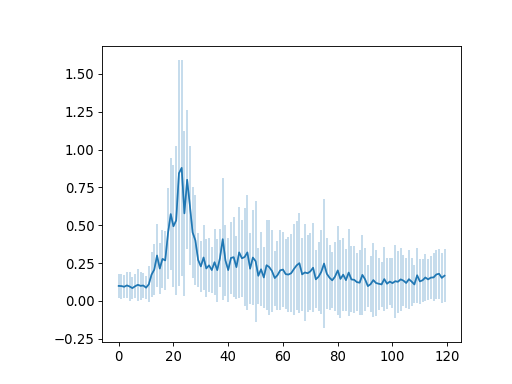

model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch0.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch5.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch10.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch15.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch20.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch25.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correl

(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch250.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch255.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch260.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch265.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch270.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1

(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch205.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch210.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch215.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch220.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch225.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2

(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch160.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch165.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch170.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch175.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch180.pth
(120, 20)
(240, 20)
PFC correlation
(240, 20)
HPC correlation
(240, 20)
Re correlation
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3

In [522]:
##########    Checker of Activity difference and grad   #########################
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import time
import math
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import sklearn 
import nolds
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D
from scipy.special import expit
import pandas as pd
import glob
import scipy

%matplotlib notebook

def Culc_gate(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = torch.cat([hiddens[1][0][0],hiddens[2][0]])
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]

def Culc_gate_uniPFC(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = hiddens[1][0][0]
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]

def Culc_gate_uniHPC(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = torch.cat([hiddens[1][0][0],hiddens[2][0]])
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]
    
    

def MakeAnimation(data_x,data_y,traj_x,traj_y, data_limit):
    fig, ax = plt.subplots()
    ims = []
    for t in range(traj_x.shape[0]):
        if t < data_limit:
            traj = ax.plot(data_x[:t], data_y[:t], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
#         else:
#             traj = ax.plot(data_x[:data_limit], data_y[:data_limit], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or", data_x[data_limit-1:t], data_y[data_limit-1:t], "--b")
        else:
            traj = ax.plot(traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
#             traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=30)    
    ani.save('anim_v4_2_1_r.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_data(data_x,data_y, data_limit):
    fig, ax = plt.subplots()
    ax.set_xlim(0.2,0.8)
    ax.set_ylim(-0.05,0.8)
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=30)    
    ani.save('anim_Re_0.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_attracter(data_x,data_y):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob",)
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=10)    
    ani.save('anim_attracter2.gif', writer='pillow')
    plt.show()
    
    return 0


    
def MakeAnimation_img(data,module):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data.shape[0]):
        img = ax.imshow(data[t].reshape(1,data.shape[1]))
        title = ax.text(0.5, 1.01, module+' time={}'.format(t),
             ha='center', va='bottom',
             transform=ax.transAxes, fontsize='large')
        ims.append([img,title])
    ani = animation.ArtistAnimation(fig, ims)    
    ani.save('anim_fire_'+module+'_.gif', writer='pillow')
    plt.show()
    
    return 0

def mkOwnDataSet(data_size, filename, data_length=100, freq=60., noise=0.005):
    
    x = np.loadtxt(str(filename+"_r.csv"),delimiter=',')
    y = np.loadtxt(str(filename+"_l.csv"),delimiter=',')
    train_x = []
    train_y = []
    
    for offset in range(data_size):
        train_x.append([[x[i][0] + np.random.normal(loc=0.0, scale=noise),x[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,x.shape[0],round(x.shape[0]/data_length))])
        train_y.append([[y[i][0] + np.random.normal(loc=0.0, scale=noise),y[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,y.shape[0],round(y.shape[0]/data_length))])
    return train_x, train_y


def mkOwnRandomBatch(train_x, train_t, batch_size=10):
    """
    train_x, train_tを受け取ってbatch_x, batch_tを返す
    """
    batch_x = []
    for _ in range(batch_size):
        idx = np.random.randint(0, len(train_x) - batch_size)
        batch_x.append(train_x[idx])
    return torch.tensor(batch_x).transpose(0,1)

def make_Ttraj(direction):
    traj_x = np.array([])
    traj_y = np.array([])
    straight_x = np.ones(5)*0.5
    if direction == 1:
        branch1_x = np.linspace(0.5, 0.75, 5)
        branch2_x = np.linspace(0.75, 0.5, 5)
    elif direction == 2:
        branch1_x = np.linspace(0.5, 0.25, 5)
        branch2_x = np.linspace(0.25, 0.5, 5)        
    backstraight_x = np.ones(5)*0.5

    straight_y = np.linspace(0, 0.5, 5)
    branch1_y = np.linspace(0.5, 0.5, 5)
    branch2_y = np.linspace(0.5, 0.5, 5)
    backstraight_y = np.linspace(0.5 , 0, 5)
    
    traj_x = np.append(traj_x, [straight_x,branch1_x,branch2_x,backstraight_x])
    traj_y = np.append(traj_y, [straight_y,branch1_y,branch2_y,backstraight_y])
    traj = np.concatenate([[traj_x],[traj_y]],axis=0).T
    return traj

def make_Htraj(direction1, direction2):
    traj_x = np.array([])
    traj_y = np.array([])
    straight_x = np.ones(10)*0.5
    if direction1 == 1:
        branch1_x = np.linspace(0.5, 0.75, 5)
        branch2_x = np.linspace(0.75, 0.75, 5)
        branch3_x = np.linspace(0.75, 0.75, 5)
        branch4_x = np.linspace(0.75, 0.5, 5)
    elif direction1 == 2:
        branch1_x = np.linspace(0.5, 0.25, 5)
        branch2_x = np.linspace(0.25, 0.25, 5)   
        branch3_x = np.linspace(0.25, 0.25, 5)  
        branch4_x = np.linspace(0.25, 0.5, 5)       
    backstraight_x = np.ones(10)*0.5

    straight_y = np.linspace(0, 0.5, 10)
    branch1_y = np.linspace(0.5, 0.5, 5)
    if direction2 == 1:
        branch2_y = np.linspace(0.5, 0.25, 5)
        branch3_y = np.linspace(0.25, 0.5, 5)
    elif direction2 == 2:
        branch2_y = np.linspace(0.5, 0.75, 5)
        branch3_y = np.linspace(0.75, 0.5, 5)
    branch4_y = np.linspace(0.5, 0.5, 5)
    backstraight_y = np.linspace(0.5 , 0, 10)
    
    traj_x = np.append(traj_x, straight_x)
    traj_x = np.append(traj_x, [branch1_x,branch2_x,branch3_x,branch4_x])
    traj_x = np.append(traj_x, backstraight_x)
    traj_y = np.append(traj_y, straight_y)
    traj_y = np.append(traj_y, [branch1_y,branch2_y,branch3_y,branch4_y])
    traj_y = np.append(traj_y, backstraight_y)
    traj = np.concatenate([[traj_x],[traj_y]],axis=0).T
    return traj


def make_traj(delay_length):
    freq=60
    noise=0.005
    data_length = 40
    
    # x = np.loadtxt("right1.csv",delimiter=',')
    x_1 = make_Htraj(1,1)
    x_2 = make_Htraj(1,2)
    # y = np.loadtxt("left1.csv",delimiter=',')
    y_1 = make_Htraj(2,1)
    y_2 = make_Htraj(2,2)
    z = np.loadtxt("stay1.csv",delimiter=',')
    data_list = []

    ###  ver1  ###
    orders = []
    order  = np.array([1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    orders.append(order) 
    order  = np.array([2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    orders.append(order) 
    order  = np.array([3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    orders.append(order) 
    order  = np.array([4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    orders.append(order) 
    
#     ###  ver2  ###
#     orders = []
#     order  = np.array([1])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [2])
#     orders.append(order) 
#     order  = np.array([2])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [3])
#     orders.append(order) 
#     order  = np.array([3])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [4])
#     orders.append(order) 
#     order  = np.array([4])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [1])
#     orders.append(order) 

    ###  ver1's test  ###
    orders = []
    order  = np.array([1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    
    # order = [1,0,0,0,2]
    # order = [2,0,0,1,0,0,0,2,0,0,1]
    for order in orders:
        data = np.array([[0,0]])
        for idx in order:
            if idx == 1:
                target = x_1
            elif idx == 2:
                target = x_2
            elif idx == 3:
                target = y_1
            elif idx == 4:
                target = y_2
            elif idx == 0:
                target = np.array([[z[i][0],z[i][1]] for i in np.random.choice(z.shape[0], data_length)])
#                 target = np.array([[0.5,0] for i in np.random.choice(z.shape[0], data_length)])
            if idx != 0:
                target += np.random.normal(loc=0.0, scale=noise, size=target.shape)
    
            data = np.append(data,target,axis=0)
        data_list.append(data[1:])
    return data_list[0],data_list[1],data_list[2],data_list[3]

def mkOwnDataSet_auto(data_size, delay_length, freq=60., noise=0.0001):
   
    x1,x2,y1,y2 = make_traj(delay_length)
    train_x1 = []
    train_x2 = []
    train_y1 = []
    train_y2 = []
    
    for offset in range(data_size):
        train_x1.append([[x1[i][0] + np.random.normal(loc=0.0, scale=noise),x1[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(x1.shape[0])])
        train_x2.append([[x2[i][0] + np.random.normal(loc=0.0, scale=noise),x2[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(x2.shape[0])])

        train_y1.append([[y1[i][0] + np.random.normal(loc=0.0, scale=noise),y1[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(y1.shape[0])])
        train_y2.append([[y2[i][0] + np.random.normal(loc=0.0, scale=noise),y2[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(y2.shape[0])])

    return train_x1, train_x2, train_y1, train_y2

def plot_distance_bet2traj(traj1,traj2,linelist):
    traj1 = np.array(traj1)
    traj2 = np.array(traj2)
    result = []
    for i in range(traj1.shape[0]):
        result.append(np.linalg.norm(traj1[i]-traj2[i]))
    plt.figure()
    plt.plot(result)
    
    plt.vlines(linelist,np.min(result),np.max(result))
    
    return result

def distance_bet2traj(traj1,traj2):
    traj1 = np.array(traj1)
    traj2 = np.array(traj2)
    result = []
    for i in range(traj1.shape[0]):
        result.append(np.linalg.norm(traj1[i]-traj2[i]))
    return result

def plot_activity_bet2traj(traj1,traj2,linelist):
    traj1 = np.array(traj1)
    traj2 = np.array(traj2)
    result = []
    threshold = 0.5
    for i in range(traj1.shape[0]):
        result.append(np.abs(traj1[i]-traj2[i]))
        
    plt.figure()
    for i,data in enumerate(np.array(result).T):
        if np.any(data[20:105]>threshold):
            print(i)
            plt.plot(data)
    
    return result

def search_delay(traj):
    linelist = np.array([])
    flag = False
    for i in range(traj.shape[0]):
        if traj[i,1] > 0.45 and flag == False:
            linelist = np.append(linelist,i)
            flag = True
        if traj[i,1] < 0.45 and flag == True:
            linelist = np.append(linelist,i)
            flag = False
    return linelist

def pick_delay(traj,states):
    pointlist = np.array([])
    flag = False
    threshold = 0.2
    for i in range(traj.shape[0]):
        if i < 5:
            continue
        if traj[i,1] < threshold and flag == False:
            pointlist = np.append(pointlist,i)
            flag = True
        if traj[i,1] > threshold and flag == True:
            pointlist = np.append(pointlist,i)
            flag = False
    states_list = []
    start = 0
    for i,k in enumerate(pointlist):
        end = int(k)
        if i % 2 != 0:
            states_list.append(states[start:end])
        start = int(k)
    states_list.append(traj[start:])
    return states_list

def pick_traj(traj,states):
    pointlist = np.array([])
    flag = False
    threshold = 0.2
    for i in range(traj.shape[0]):
        if i < 5:
            continue
        if traj[i,1] < threshold and flag == False:
            pointlist = np.append(pointlist,i)
            flag = True
        if traj[i,1] > threshold and flag == True:
            pointlist = np.append(pointlist,i)
            flag = False
    states_list = []
    start = 0
    for i,k in enumerate(pointlist):
        end = int(k)
        if i % 2 != 0:
            states_list.append(states[start:end])
            start = int(k)
    states_list.append(traj[start:])
    return states_list

def match_length(states_list):
    min_length = 1000
    result = []
    for state in states_list:
        min_length = np.min((min_length, len(state)))
    for state in states_list:
        result.append(state[-min_length:])
        
    return result

def vec_var(datas):
    datas = np.array(datas)
    average = np.average(datas,axis=0)
    result = 0
    for data in datas:
        result += np.linalg.norm(data-average)
    result /= datas.shape[0]
    return result
    
def lyapunov_exp(data):
    result = np.mean(np.log(np.abs(np.diff(data))))
    return result

def culc_grad(data):
    datalen = len(data)
    grad_list = np.array([])
    pre_value = data[0]
    for i in range(datalen):
        grad = np.abs(data[i] - pre_value)
        grad_list = np.append(grad_list,grad)
        pre_value = data[i]
        
    return grad_list

class MyLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        nn.init.sparse_(self.PFC.weight_ih.data,1)
        nn.init.sparse_(self.HPC.weight_ih.data,1)
        nn.init.sparse_(self.PFC.weight_hh.data,1)
        nn.init.sparse_(self.HPC.weight_hh.data,1)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2][0]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,Re_hidden]

class MyLSTM_RNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse=5):
        super(MyLSTM_RNN, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        input = input.float()
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.1
        var = 0.1
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_test(self):
        const = 0.2
        var = 0.2
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
#         HPC_hidden = [torch.ones(self.batch_size, self.hidden_size_HPC)*const, torch.ones(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
#         PFC_hidden = [torch.ones(self.batch_size, self.hidden_size_PFC)*const, torch.ones(self.batch_size, self.hidden_size_PFC)*const]
#         Re_hidden = torch.ones(self.batch_size, self.hidden_size_Re)*const
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*var
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0
        v = 0.1
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*v
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def noiseHidden_select(self, hiddens):
        c = 0
        v = 0.01
        index = np.array([1,2,8,9,17])
        HPC_hidden = torch.zeros(self.batch_size, self.hidden_size_HPC)
        HPC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.zeros(self.batch_size, self.hidden_size_PFC)
        PFC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size_Re)*c
        Re_hidden[:,index] += torch.randn(self.batch_size, index.size)*v
#         Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*v
#         Re_hidden[:,index] = torch.zeros(self.batch_size, index.size)*c
#         Re_hidden = torch.zeros(self.batch_size, self.hidden_size_Re)*c
#         Re_hidden[:,index] += hiddens[2][:,index]*v
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def noiseHidden_dis(self, hiddens, statr, statl):
        c = 0
        v =-0.1
        index = np.array([1,2,8,9,17])
        HPC_hidden = torch.zeros(self.batch_size, self.hidden_size_HPC)
        HPC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.zeros(self.batch_size, self.hidden_size_PFC)
        PFC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*0.0
        Re_hidden += (-statr+statl)*v
#         Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*v
#         Re_hidden[:,index] = torch.zeros(self.batch_size, index.size)*c
#         Re_hidden = torch.zeros(self.batch_size, self.hidden_size_Re)*c
#         Re_hidden[:,index] += hiddens[2][:,index]*v
        hiddens[2].add_(Re_hidden)
        return hiddens


def moving_average(data):
    y = np.ones(5)/5
    mean_seq = np.convolve(data, y)
    return mean_seq    


def main(model):
    training_size = 100
    test_size = 1000
    epochs_num = 10
    hidden_size = 20
    batch_size = 10
    data_length = 100
    inputsize = 2
    outputsize = 2
    delay_length = 3
    
    model_path = model
    
    colors = ['C0','C1','C2','C3','C4','C5','C6','C7','C8','C9']
    
#     delay_length = np.random.randint(1, 3)
    delay_length = 2
    train_x1,train_x2,train_y1,train_y2 = mkOwnDataSet_auto(training_size,delay_length)

#     rnn = MyLSTM_comp(inputsize, hidden_size, outputsize, batch_size)
    rnn = MyLSTM_RNN(inputsize, hidden_size, outputsize, batch_size)
#     rnn = MyLSTM_RNN_uniHPC(inputsize, hidden_size, outputsize, batch_size)
#     rnn = MyMTRNN2(inputsize, hidden_size, outputsize, batch_size)

    rnn.load_state_dict(torch.load(model_path))
    
    
    pattern = 1
    if  pattern == 1:
        data = mkOwnRandomBatch(train_x1, train_x1, batch_size).float()
    elif pattern == 2:
        data = mkOwnRandomBatch(train_x2, train_x2, batch_size).float()
    elif pattern == 3:
        data = mkOwnRandomBatch(train_y1, train_y1, batch_size).float()
    else:
        data = mkOwnRandomBatch(train_y2, train_y2, batch_size).float()
    
    params = []
    for p in rnn.parameters():
        params.append(p.data)
    
        
#     model_path = 'model/R20_131/ReModel_L2_interRNNrand_OUT1_131_s6_100_1_epoch125.pth'
    model_path = model
    rnn.load_state_dict(torch.load(model_path))
        
    for n, p in rnn.named_parameters():
            if n == "PFC.weight_ih":
                PFC_w_pre = torch.clone(p.data)
            if n == "HPC.weight_ih":
                HPC_w_pre = torch.clone(p.data)
            if n == "Re.weight_ih":
                Re_w_pre = torch.clone(p.data)
            if n == "Re.weight_hh":
                Re_inw = torch.clone(p.data)
            if n == "linear.weight":
                OUT_w_pre = torch.clone(p.data)
                   
    traj = []
    PFCstate = []
    HPCstate = []
    Restate = []
    Gate_states = []
    hidden = rnn.initHidden_rand()
    data_limit = 120
    est_length = 0
    init_point = torch.rand(10,2)*1
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
#             output,hidden = rnn(init_point,hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            Gate_states.append(Culc_gate(output,params,hidden))
#             Gate_states.append(Culc_gate_uniPFC(output,params,hidden))
#     for k in range(data.shape[0]*est_length):
#             output,hidden = rnn(output,hidden)
#             traj.append(output.tolist())
#             PFCstate.append(hidden[0][0].tolist())
#             HPCstate.append(hidden[1][0].tolist())
#             Restate.append(hidden[2][0].tolist())
#             Gate_states.append(Culc_gate(output,params,hidden))
    traj = torch.tensor(traj)
    traj = torch.squeeze(traj).numpy()
    
    pattern = 3
    if  pattern == 1:
        data = mkOwnRandomBatch(train_x1, train_x1, batch_size).float()
    elif pattern == 2:
        data = mkOwnRandomBatch(train_x2, train_x2, batch_size).float()
    elif pattern == 3:
        data = mkOwnRandomBatch(train_y1, train_y1, batch_size).float()
    else:
        data = mkOwnRandomBatch(train_y2, train_y2, batch_size).float()
    
    dividenum = int(np.array(PFCstate)[0:,0].shape[0]/2)
    traj_noise = []
    PFCstate_noise = []
    HPCstate_noise = []
    Restate_noise = []
    Gate_states_noise = []
    hidden = rnn.initHidden_rand()
#     data = mkOwnRandomBatch(train_y, batch_size)
#     init_point = torch.rand(10,2)*1
#     data_limit = 125
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
#             output,hidden = rnn(init_point,hidden)
            traj_noise.append(output.tolist())
            PFCstate_noise.append(hidden[0][0].tolist())
            HPCstate_noise.append(hidden[1][0].tolist())
            Restate_noise.append(hidden[2][0].tolist())
#             Gate_states_noise.append(Culc_gate(output,params,hidden))
#     for k in range(data.shape[0]*est_length):
# #             hidden = rnn.noiseHidden_rand(hidden)
#             output,hidden = rnn(output,hidden) 
# #             hidden = rnn.noiseHidden_dis(hidden, np.array(Restate)[k+data_limit], np.array(Restate)[dividenum+k+data_limit])
# #             hidden = rnn.noiseHidden_rand(hidden)
#             traj_noise.append(output.tolist())
#             PFCstate_noise.append(hidden[0][0].tolist())
#             HPCstate_noise.append(hidden[1][0].tolist())
#             Restate_noise.append(hidden[2][0].tolist())
#             Gate_states_noise.append(Culc_gate(output,params,hidden))
    traj_noise = torch.tensor(traj_noise)
    traj_noise = torch.squeeze(traj_noise).numpy()

    
    print(np.array(PFCstate)[:,0].shape)
#     MakeAnimation(pltdata[:,0,0],pltdata[:,0,1], traj[:,0,0], traj[:,0,1], data_limit)
    #MakeAnimation_img(np.array(PFCstate)[:,0],"PFC")
    #MakeAnimation_img(np.array(HPCstate)[:,0],"HPC")
    
    
    pca = PCA()
#     dfs = np.array(PFCstate)[:,0]
    dfs = np.concatenate((np.array(PFCstate)[:,0],np.array(PFCstate_noise)[:,0]),axis=0)
#     dfs = np.concatenate((np.array(HPCstate)[:,0],np.array(HPCstate_noise)[:,0]),axis=0)
    print(dfs.shape)
    pca.fit(dfs)
    feature = pca.transform(dfs)
    print("PFC correlation")
    PFC_activity = np.abs(feature[:data_limit,1]-feature[data_limit:,1])
#     PFC_activity = np.abs(moving_average(feature[:data_limit,0])-moving_average(feature[data_limit:,0]))
#     PFC_activity = np.abs((feature[:data_limit,0]-moving_average(feature[:data_limit,0])[2:-2])-(feature[data_limit:,0]-moving_average(feature[data_limit:,0])[2:-2]))
#     PFC_activity = culc_grad(moving_average(feature[:data_limit,0]))
    
#     plt.figure()
#     plt.plot(feature[:data_limit,0],color="b")
#     plt.plot(feature[data_limit:,0],color="r")
#     plt.plot(moving_average(feature[:data_limit,0]),":",color="b")
#     plt.plot(moving_average(feature[data_limit:,0]),":",color="r")
#     plt.show()
    
    pca = PCA()
#     dfs = np.array(PFCstate)[:,0]
#     dfs = np.concatenate((np.array(PFCstate)[:,0],np.array(PFCstate_noise)[:,0]),axis=0)
    dfs = np.concatenate((np.array(HPCstate)[:,0],np.array(HPCstate_noise)[:,0]),axis=0)
    print(dfs.shape)
    pca.fit(dfs)
    feature = pca.transform(dfs)
    print("HPC correlation")
#     HPC_activity = np.abs(feature[:data_limit,0]-feature[data_limit:,0])
    HPC_activity = culc_grad(moving_average(feature[:data_limit,0]))


    pca = PCA()
#     dfs = np.array(PFCstate)[:,0]
#     dfs = np.concatenate((np.array(PFCstate)[:,0],np.array(PFCstate_noise)[:,0]),axis=0)
    dfs = np.concatenate((np.array(Restate)[:],np.array(Restate_noise)[:]),axis=0)
    print(dfs.shape)
    pca.fit(dfs)
    feature = pca.transform(dfs)
    print("Re correlation")
#     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,0]-feature[100:,0])))
#     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,1]-feature[100:,1])))
#     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,2]-feature[100:,2])))
    Re_activity = np.abs(feature[:data_limit,0]-feature[data_limit:,0])
#     Re_activity = np.abs(moving_average(feature[:data_limit,0])-moving_average(feature[data_limit:,0]))
#     Re_activity = np.abs((feature[:data_limit,0]-moving_average(feature[:data_limit,0])[2:-2])-(feature[data_limit:,0]-moving_average(feature[data_limit:,0])[2:-2]))
#     Re_activity = culc_grad(moving_average(feature[:data_limit,0]))
    
#     plt.figure()
#     plt.plot(feature[:data_limit,0],color="b")
#     plt.plot(feature[data_limit:,0],color="r")
#     plt.plot(moving_average(feature[:data_limit,0]),":",color="b")
#     plt.plot(moving_average(feature[data_limit:,0]),":",color="r")
#     plt.show()


    
    return PFC_activity, HPC_activity, Re_activity
#     return np.mean([PFC_a,PFC_b,PFC_c]),np.mean([HPC_a,HPC_b,HPC_c]),np.max([PFC_d]),HPC_d
#     return np.mean([PFC_a,PFC_b,PFC_c]),np.mean([HPC_a,HPC_b,HPC_c]),np.max([PFC_d]), HPC_e, frac_amp
#     return np.mean([PFC_a,PFC_b,PFC_c]),np.mean([HPC_a,HPC_b,HPC_c]),np.max([PFC_d]), HPC_e, np.sum(coherence_diff_list)
#     return np.max([PFC_a,PFC_b,PFC_c]),np.max([HPC_a,HPC_b,HPC_c])


if __name__ == '__main__':
    fig = plt.figure()
    correlation_fig = fig.subplots()
#     correlation_fig.set_xlim(-1,1)
#     correlation_fig.set_ylim(0,1)

#     model_list = glob.glob('model/R20_131/*OUT1**s8_100_2_*epoch*.pth')
#     model_list = sorted(model_list)
#     model_list = sorted(model_list,key=len,reverse=False)
#     k=0
#     for model in model_list:
#         print(model,PFC,HPC)
#         PFC,HPC = main(model)
# #         correlation_fig.plot(PFC,HPC,"o")
# #         correlation_fig.text(PFC,HPC,model.split("epoch")[-1].split(".")[0])
#         correlation_fig.plot(k*5,PFC/HPC,"o")
# #         correlation_fig.text(k*5,PFC/HPC,model.split("epoch")[-1].split(".")[0])
#         k+=1

    allRe_list = []
    allHPC_list = []
    allPFC_list = []
    for num in range(3):
        for i in range(1):
            path = 'model/R20_H_bigbatch/'
#             path = 'model/R20_H_uniHPC_bigbatch/'
            model_list = glob.glob(path+'*s'+str(i+1)+'_100_'+str(num+1)+'_*epoch*.pth')
            model_list = sorted(model_list)
            model_list = sorted(model_list,key=len,reverse=False)
            Re_list = []
            ratio_list_max = []
            with open(path+"good_list.txt", mode="r") as f:
                good_list = f.read().splitlines()
#             good_list = []
#             if i+1 == 4 and num+1 == 3:
#                 continue
#             if i+1 == 5 and num+1 == 2:
#                 continue
            
            first_goodmodel = [0,0]
            good_flag = False
            k=0
            for model in model_list:
#                 if model in good_list:
#                     pass
#                 else:
#                     continue
                print(model)
                if int(model.split("epoch")[-1].split(".")[0])>299:
                    continue
                PFC_activity, HPC_activity, Re_activity = main(model)
                allRe_list.append(Re_activity)
                allHPC_list.append(HPC_activity)
                allPFC_list.append(PFC_activity)

                k+=1
#             correlation_fig.plot(Re_activity,color="C{}".format(i))
    allRe_list = np.array(allRe_list)
    allHPC_list = np.array(allHPC_list)
    allPFC_list = np.array(allPFC_list)
    print(allRe_list.shape)
    correlation_fig.plot(np.mean(allRe_list,axis=0).T,color="C0")
    correlation_fig.errorbar(np.arange(allRe_list.shape[1]),np.mean(allRe_list,axis=0).T,yerr=np.sqrt(np.var(allRe_list,axis=0).T), color="C0", alpha=0.3)
#     correlation_fig.plot(np.mean(allHPC_list,axis=0).T,color="C1")
#     correlation_fig.errorbar(np.arange(allHPC_list.shape[1]),np.mean(allHPC_list,axis=0).T,yerr=np.sqrt(np.var(allHPC_list,axis=0).T), color="C1", alpha=0.3)
#     correlation_fig.plot(np.mean(allPFC_list,axis=0).T,color="C2")
#     correlation_fig.errorbar(np.arange(allPFC_list.shape[1]),np.mean(allPFC_list,axis=0).T,yerr=np.sqrt(np.var(allPFC_list,axis=0).T), color="C2", alpha=0.3)

#             allratio_list.append(np.array(ratio_list_max))

        

# For Coherence

<IPython.core.display.Javascript object>


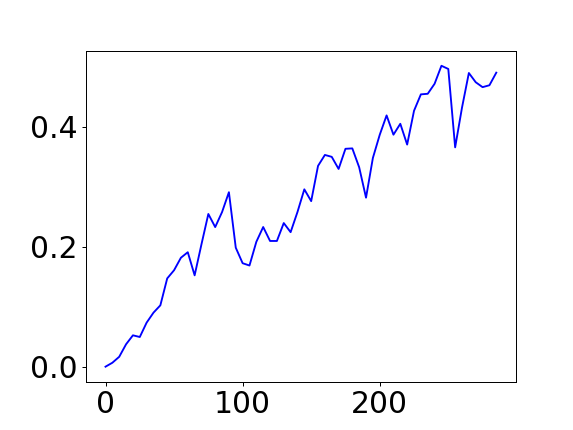

model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch0.pth
0 0
dist:0.0003246048426896337
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch5.pth
0 0
dist:0.006869406681956344
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch10.pth
0 0
dist:0.016800534088834227
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch15.pth
0 0
dist:0.03767025441336972
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch20.pth
0 0
dist:0.05255810264201735
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch25.pth
0 0
dist:0.04974641553026178
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch30.pth
0 0
dist:0.07372946844930597
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch35.pth
0 0
dist:0.09033358163419006
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch40.pth
0 0
dist:0.10250599541071029
model_de

In [223]:
##########    Test for mixture weight!!!!!!!!!!!!!   #########################
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import time
import math
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import sklearn 
import nolds
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D
from scipy.special import expit
import pandas as pd
import glob
import scipy
from scipy.fft import fft 
from scipy import signal

%matplotlib notebook

plt.rcParams["font.size"] = 20
plt.rcParams["figure.subplot.left"] = 0.15

def Culc_gate(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = torch.cat([hiddens[1][0][0],hiddens[2][0]])
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]

def Culc_gate_uniPFC(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = hiddens[1][0][0]
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]

def Culc_gate_uniHPC(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = torch.cat([hiddens[1][0][0],hiddens[2][0]])
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]
    
    

def MakeAnimation(data_x,data_y,traj_x,traj_y, data_limit):
    fig, ax = plt.subplots()
    ims = []
    for t in range(traj_x.shape[0]):
        if t < data_limit:
            traj = ax.plot(data_x[:t], data_y[:t], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
#         else:
#             traj = ax.plot(data_x[:data_limit], data_y[:data_limit], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or", data_x[data_limit-1:t], data_y[data_limit-1:t], "--b")
        else:
            traj = ax.plot(traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
#             traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=30)    
    ani.save('anim_v4_2_1_r.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_data(data_x,data_y, data_limit):
    fig, ax = plt.subplots()
    ax.set_xlim(0.2,0.8)
    ax.set_ylim(-0.05,0.8)
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=30)    
    ani.save('anim_Re_0.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_attracter(data_x,data_y):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob",)
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=10)    
    ani.save('anim_attracter2.gif', writer='pillow')
    plt.show()
    
    return 0


    
def MakeAnimation_img(data,module):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data.shape[0]):
        img = ax.imshow(data[t].reshape(1,data.shape[1]))
        title = ax.text(0.5, 1.01, module+' time={}'.format(t),
             ha='center', va='bottom',
             transform=ax.transAxes, fontsize='large')
        ims.append([img,title])
    ani = animation.ArtistAnimation(fig, ims)    
    ani.save('anim_fire_'+module+'_.gif', writer='pillow')
    plt.show()
    
    return 0

def mkOwnDataSet(data_size, filename, data_length=100, freq=60., noise=0.005):
    
    x = np.loadtxt(str(filename+"_r.csv"),delimiter=',')
    y = np.loadtxt(str(filename+"_l.csv"),delimiter=',')
    train_x = []
    train_y = []
    
    for offset in range(data_size):
        train_x.append([[x[i][0] + np.random.normal(loc=0.0, scale=noise),x[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,x.shape[0],round(x.shape[0]/data_length))])
        train_y.append([[y[i][0] + np.random.normal(loc=0.0, scale=noise),y[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,y.shape[0],round(y.shape[0]/data_length))])
    return train_x, train_y


def mkOwnRandomBatch(train_x, train_t, batch_size=10):
    """
    train_x, train_tを受け取ってbatch_x, batch_tを返す
    """
    batch_x = []
    for _ in range(batch_size):
        idx = np.random.randint(0, len(train_x) - batch_size)
        batch_x.append(train_x[idx])
    return torch.tensor(batch_x).transpose(0,1)

def make_Ttraj(direction):
    traj_x = np.array([])
    traj_y = np.array([])
    straight_x = np.ones(5)*0.5
    if direction == 1:
        branch1_x = np.linspace(0.5, 0.75, 5)
        branch2_x = np.linspace(0.75, 0.5, 5)
    elif direction == 2:
        branch1_x = np.linspace(0.5, 0.25, 5)
        branch2_x = np.linspace(0.25, 0.5, 5)        
    backstraight_x = np.ones(5)*0.5

    straight_y = np.linspace(0, 0.5, 5)
    branch1_y = np.linspace(0.5, 0.5, 5)
    branch2_y = np.linspace(0.5, 0.5, 5)
    backstraight_y = np.linspace(0.5 , 0, 5)
    
    traj_x = np.append(traj_x, [straight_x,branch1_x,branch2_x,backstraight_x])
    traj_y = np.append(traj_y, [straight_y,branch1_y,branch2_y,backstraight_y])
    traj = np.concatenate([[traj_x],[traj_y]],axis=0).T
    return traj

def make_Htraj(direction1, direction2):
    traj_x = np.array([])
    traj_y = np.array([])
    straight_x = np.ones(10)*0.5
    if direction1 == 1:
        branch1_x = np.linspace(0.5, 0.75, 5)
        branch2_x = np.linspace(0.75, 0.75, 5)
        branch3_x = np.linspace(0.75, 0.75, 5)
        branch4_x = np.linspace(0.75, 0.5, 5)
    elif direction1 == 2:
        branch1_x = np.linspace(0.5, 0.25, 5)
        branch2_x = np.linspace(0.25, 0.25, 5)   
        branch3_x = np.linspace(0.25, 0.25, 5)  
        branch4_x = np.linspace(0.25, 0.5, 5)       
    backstraight_x = np.ones(10)*0.5

    straight_y = np.linspace(0, 0.5, 10)
    branch1_y = np.linspace(0.5, 0.5, 5)
    if direction2 == 1:
        branch2_y = np.linspace(0.5, 0.25, 5)
        branch3_y = np.linspace(0.25, 0.5, 5)
    elif direction2 == 2:
        branch2_y = np.linspace(0.5, 0.75, 5)
        branch3_y = np.linspace(0.75, 0.5, 5)
    branch4_y = np.linspace(0.5, 0.5, 5)
    backstraight_y = np.linspace(0.5 , 0, 10)
    
    traj_x = np.append(traj_x, straight_x)
    traj_x = np.append(traj_x, [branch1_x,branch2_x,branch3_x,branch4_x])
    traj_x = np.append(traj_x, backstraight_x)
    traj_y = np.append(traj_y, straight_y)
    traj_y = np.append(traj_y, [branch1_y,branch2_y,branch3_y,branch4_y])
    traj_y = np.append(traj_y, backstraight_y)
    traj = np.concatenate([[traj_x],[traj_y]],axis=0).T
    return traj


def make_traj(delay_length):
    freq=60
    noise=0.005
    data_length = 40
    
    # x = np.loadtxt("right1.csv",delimiter=',')
    x_1 = make_Htraj(1,1)
    x_2 = make_Htraj(1,2)
    # y = np.loadtxt("left1.csv",delimiter=',')
    y_1 = make_Htraj(2,1)
    y_2 = make_Htraj(2,2)
    z = np.loadtxt("stay1.csv",delimiter=',')
    data_list = []

    ###  ver1  ###
    orders = []
    order  = np.array([1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    orders.append(order) 
    order  = np.array([2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    orders.append(order) 
    order  = np.array([3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    orders.append(order) 
    order  = np.array([4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    orders.append(order) 
    
#     ###  ver2  ###
#     orders = []
#     order  = np.array([1])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [2])
#     orders.append(order) 
#     order  = np.array([2])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [3])
#     orders.append(order) 
#     order  = np.array([3])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [4])
#     orders.append(order) 
#     order  = np.array([4])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [1])
#     orders.append(order) 

    ###  ver1's test  ###
    orders = []
    order  = np.array([1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    
    # order = [1,0,0,0,2]
    # order = [2,0,0,1,0,0,0,2,0,0,1]
    for order in orders:
        data = np.array([[0,0]])
        for idx in order:
            if idx == 1:
                target = x_1
            elif idx == 2:
                target = x_2
            elif idx == 3:
                target = y_1
            elif idx == 4:
                target = y_2
            elif idx == 0:
                target = np.array([[z[i][0],z[i][1]] for i in np.random.choice(z.shape[0], data_length)])
#                 target = np.array([[0.5,0] for i in np.random.choice(z.shape[0], data_length)])
            if idx != 0:
                target += np.random.normal(loc=0.0, scale=noise, size=target.shape)
    
            data = np.append(data,target,axis=0)
        data_list.append(data[1:])
    return data_list[0],data_list[1],data_list[2],data_list[3]

def mkOwnDataSet_auto(data_size, delay_length, freq=60., noise=0.01):
   
    x1,x2,y1,y2 = make_traj(delay_length)
    train_x1 = []
    train_x2 = []
    train_y1 = []
    train_y2 = []
    
    for offset in range(data_size):
        train_x1.append([[x1[i][0] + np.random.normal(loc=0.0, scale=noise),x1[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(x1.shape[0])])
        train_x2.append([[x2[i][0] + np.random.normal(loc=0.0, scale=noise),x2[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(x2.shape[0])])

        train_y1.append([[y1[i][0] + np.random.normal(loc=0.0, scale=noise),y1[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(y1.shape[0])])
        train_y2.append([[y2[i][0] + np.random.normal(loc=0.0, scale=noise),y2[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(y2.shape[0])])

    return train_x1, train_x2, train_y1, train_y2

def plot_distance_bet2traj(traj1,traj2,linelist):
    traj1 = np.array(traj1)
    traj2 = np.array(traj2)
    result = []
    for i in range(traj1.shape[0]):
        result.append(np.linalg.norm(traj1[i]-traj2[i]))
    plt.figure()
    plt.plot(result)
    
    plt.vlines(linelist,np.min(result),np.max(result))
    
    return result

def distance_bet2traj(traj1,traj2):
    traj1 = np.array(traj1)
    traj2 = np.array(traj2)
    result = []
    for i in range(traj1.shape[0]):
        result.append(np.linalg.norm(traj1[i]-traj2[i]))
    return result

def plot_activity_bet2traj(traj1,traj2,linelist):
    traj1 = np.array(traj1)
    traj2 = np.array(traj2)
    result = []
    threshold = 0.5
    for i in range(traj1.shape[0]):
        result.append(np.abs(traj1[i]-traj2[i]))
        
    plt.figure()
    for i,data in enumerate(np.array(result).T):
        if np.any(data[20:105]>threshold):
            print(i)
            plt.plot(data)
    
    return result

def search_delay(traj):
    linelist = np.array([])
    flag = False
    for i in range(traj.shape[0]):
        if traj[i,1] > 0.45 and flag == False:
            linelist = np.append(linelist,i)
            flag = True
        if traj[i,1] < 0.45 and flag == True:
            linelist = np.append(linelist,i)
            flag = False
    return linelist

def pick_delay(traj,states):
    pointlist = np.array([])
    flag = False
    threshold = 0.2
    for i in range(traj.shape[0]):
        if i < 5:
            continue
        if traj[i,1] < threshold and flag == False:
            pointlist = np.append(pointlist,i)
            flag = True
        if traj[i,1] > threshold and flag == True:
            pointlist = np.append(pointlist,i)
            flag = False
    states_list = []
    start = 0
    for i,k in enumerate(pointlist):
        end = int(k)
        if i % 2 != 0:
            states_list.append(states[start:end])
        start = int(k)
    states_list.append(traj[start:])
    return states_list

def pick_traj(traj,states):
    pointlist = np.array([])
    flag = False
    threshold = 0.2
    for i in range(traj.shape[0]):
        if i < 5:
            continue
        if traj[i,1] < threshold and flag == False:
            pointlist = np.append(pointlist,i)
            flag = True
        if traj[i,1] > threshold and flag == True:
            pointlist = np.append(pointlist,i)
            flag = False
    states_list = []
    start = 0
    for i,k in enumerate(pointlist):
        end = int(k)
        if i % 2 != 0:
            states_list.append(states[start:end])
            start = int(k)
    states_list.append(traj[start:])
    return states_list

def match_length(states_list):
    min_length = 1000
    result = []
    for state in states_list:
        min_length = np.min((min_length, len(state)))
    for state in states_list:
        result.append(state[-min_length:])
        
    return result

def vec_var(datas):
    datas = np.array(datas)
    average = np.average(datas,axis=0)
    result = 0
    for data in datas:
        result += np.linalg.norm(data-average)
    result /= datas.shape[0]
    return result
    
def lyapunov_exp(data):
    result = np.mean(np.log(np.abs(np.diff(data))))
    return result

class MyLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        nn.init.sparse_(self.PFC.weight_ih.data,1)
        nn.init.sparse_(self.HPC.weight_ih.data,1)
        nn.init.sparse_(self.PFC.weight_hh.data,1)
        nn.init.sparse_(self.HPC.weight_hh.data,1)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2][0]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,Re_hidden]

class MyLSTM_RNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse=5):
        super(MyLSTM_RNN, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        input = input.float()
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.1
        var = 0.1
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_test(self):
        const = 0.2
        var = 0.2
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
#         HPC_hidden = [torch.ones(self.batch_size, self.hidden_size_HPC)*const, torch.ones(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
#         PFC_hidden = [torch.ones(self.batch_size, self.hidden_size_PFC)*const, torch.ones(self.batch_size, self.hidden_size_PFC)*const]
#         Re_hidden = torch.ones(self.batch_size, self.hidden_size_Re)*const
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*var
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0
        v = 0.1
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*v
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def noiseHidden_select(self, hiddens):
        c = 0
        v = 0.01
        index = np.array([1,2,8,9,17])
        HPC_hidden = torch.zeros(self.batch_size, self.hidden_size_HPC)
        HPC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.zeros(self.batch_size, self.hidden_size_PFC)
        PFC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size_Re)*c
        Re_hidden[:,index] += torch.randn(self.batch_size, index.size)*v
#         Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*v
#         Re_hidden[:,index] = torch.zeros(self.batch_size, index.size)*c
#         Re_hidden = torch.zeros(self.batch_size, self.hidden_size_Re)*c
#         Re_hidden[:,index] += hiddens[2][:,index]*v
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def noiseHidden_dis(self, hiddens, statr, statl):
        c = 0
        v =-0.1
        index = np.array([1,2,8,9,17])
        HPC_hidden = torch.zeros(self.batch_size, self.hidden_size_HPC)
        HPC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.zeros(self.batch_size, self.hidden_size_PFC)
        PFC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*0.0
        Re_hidden += (-statr+statl)*v
#         Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*v
#         Re_hidden[:,index] = torch.zeros(self.batch_size, index.size)*c
#         Re_hidden = torch.zeros(self.batch_size, self.hidden_size_Re)*c
#         Re_hidden[:,index] += hiddens[2][:,index]*v
        hiddens[2].add_(Re_hidden)
        return hiddens


def moving_average(data):
    y = np.ones(5)/5
    mean_seq = np.convolve(data, y)
    return mean_seq    


def main(model):
    training_size = 100
    test_size = 1000
    epochs_num = 10
    hidden_size = 20
    batch_size = 10
    data_length = 100
    inputsize = 2
    outputsize = 2
    
    model_path = model
    
    colors = ['C0','C1','C2','C3','C4','C5','C6','C7','C8','C9']
    
#     delay_length = np.random.randint(1, 3)
    delay_length = 2
    train_x1,train_x2,train_y1,train_y2 = mkOwnDataSet_auto(training_size,delay_length)

#     rnn = MyLSTM_comp(inputsize, hidden_size, outputsize, batch_size)
    rnn = MyLSTM_RNN(inputsize, hidden_size, outputsize, batch_size)
#     rnn = MyLSTM_RNN_uniHPC(inputsize, hidden_size, outputsize, batch_size)
#     rnn = MyMTRNN2(inputsize, hidden_size, outputsize, batch_size)

    rnn.load_state_dict(torch.load(model_path))
    
    
    pattern = 1
    if  pattern == 1:
        data = mkOwnRandomBatch(train_x1, train_x1, batch_size).float()
    elif pattern == 2:
        data = mkOwnRandomBatch(train_x2, train_x2, batch_size).float()
    elif pattern == 3:
        data = mkOwnRandomBatch(train_y1, train_y1, batch_size).float()
    else:
        data = mkOwnRandomBatch(train_y2, train_y2, batch_size).float()
    
    params = []
    for p in rnn.parameters():
        params.append(p.data)
    
        
#     model_path = 'model/R20_131/ReModel_L2_interRNNrand_OUT1_131_s6_100_1_epoch125.pth'
    model_path = model
    rnn.load_state_dict(torch.load(model_path))
        
    for n, p in rnn.named_parameters():
            if n == "PFC.weight_ih":
                PFC_w_pre = torch.clone(p.data)
            if n == "HPC.weight_ih":
                HPC_w_pre = torch.clone(p.data)
            if n == "Re.weight_ih":
                Re_w_pre = torch.clone(p.data)
            if n == "Re.weight_hh":
                Re_inw = torch.clone(p.data)
            if n == "linear.weight":
                OUT_w_pre = torch.clone(p.data)
                   
    traj = []
    PFCstate = []
    HPCstate = []
    Restate = []
    Gate_states = []
    hidden = rnn.initHidden_rand()
    data_limit = 160
    est_length = 1
    init_point = torch.rand(10,2)*1
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
#             output,hidden = rnn(init_point,hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            Gate_states.append(Culc_gate(output,params,hidden))
#             Gate_states.append(Culc_gate_uniPFC(output,params,hidden))
    for k in range(data.shape[0]*est_length):
            output,hidden = rnn(output,hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            Gate_states.append(Culc_gate(output,params,hidden))
    traj = torch.tensor(traj)
    traj = torch.squeeze(traj).numpy()
    
    pca = PCA()
#     dfs = np.array(HPCstate)[:,0]
    dfs = np.array(Restate)
    pca.fit(dfs)
    Refeature = pca.transform(dfs)

    shift = 2
    seglen = 60
    
#     plt.figure()
#     plt.plot(np.array(PFCstate)[:,0,2]-moving_average(np.array(PFCstate)[2:-2,0,2])[:])
#     plt.plot([40,120,160,240,280,360,400,480],np.zeros(8),"o",color="k",alpha=0.3)
    
#     plt.figure()
#     plt.plot(np.array(Refeature)[:,0]-moving_average(np.array(Refeature)[:,0])[2:-2])
#     plt.plot([40,120,160,240,280,360,400,480],np.zeros(8),"o",color="k",alpha=0.3)

#     plt.yticks(fontsize=28)
#     plt.xticks(fontsize=28)
        
    coherence_diff_list = []
    for i in range(20):
        for k in range(1):
            data = np.array(Refeature)[:,0]-moving_average(np.array(Refeature)[:,0])[2:-2]
            freqs,times,sx1 = signal.stft(data,fs=1,window="tukey",nperseg=seglen,noverlap=seglen-shift,detrend=False,boundary=None)
            data = np.array(PFCstate)[:,k,i]-moving_average(np.array(PFCstate)[2:-2,k,i])[:]
            freqs,times,sx2 = signal.stft(data*1,fs=1,window="tukey",nperseg=seglen,noverlap=seglen-shift,detrend=False,boundary=None)
            data = np.array(HPCstate)[:,k,i]-moving_average(np.array(HPCstate)[2:-2,k,i])[:]
            freqs,times,sx3 = signal.stft(data,fs=1,window="tukey",nperseg=seglen,noverlap=seglen-shift,detrend=False,boundary=None)
            
            xsp = sx1*np.conjugate(sx2)
            coherence = (np.abs(xsp)**2)/(np.abs(sx1)*np.abs(sx2))
#             plt.figure()
#             plt.pcolormesh(times,freqs,coherence)
#             plt.title("Re-PFC neuron#"+str(i+1))
#             plt.yticks(fontsize=28)
#             plt.xticks(fontsize=28)
#             print(np.max(coherence),np.min(coherence))
            
#             plt.figure()
#             plt.plot(times, np.sum(coherence.T,axis=1))
            
#             xsp = sx1*np.conjugate(sx3)
#             coherence = (np.abs(xsp)**2)/(np.abs(sx1)*np.abs(sx3))            
#             plt.figure()
#             plt.pcolormesh(times,freqs,coherence)
#             plt.title("Re-HPC neuron#"+str(i+1))
#             print(np.max(coherence),np.min(coherence))

            
#             xsp = sx2*np.conjugate(sx3)
#             coherence = (np.abs(xsp)**2)/(np.abs(sx2)*np.abs(sx3))
#             plt.figure()
#             plt.pcolormesh(times,freqs,coherence)
#             plt.title("PFC-HPC neuron#"+str(i+1))
            
#             degree = np.degrees(np.angle(xsp))
#             print(degree.shape)
#             plt.figure()
#             plt.plot(degree)

#             plt.figure()
#             plt.plot(times, np.sum(coherence.T,axis=1))
#             plt.plot([40,120,160,240,280,360,400,480],np.zeros(8),"o",color="k",alpha=0.3)
            coherence_diff_list.append(np.max(np.sum(coherence.T,axis=1))-np.min(np.sum(coherence.T,axis=1)))
    
    
#     return np.mean([PFC_a,PFC_b,PFC_c]),np.mean([HPC_a,HPC_b,HPC_c]),np.max([PFC_a,PFC_b,PFC_c]),np.max([HPC_a,HPC_b,HPC_c]),frac_amp
#     return np.mean([PFC_a,PFC_b,PFC_c]),np.mean([HPC_a,HPC_b,HPC_c]),np.max([PFC_d]),HPC_d
#     return np.mean([PFC_a,PFC_b,PFC_c]),np.mean([HPC_a,HPC_b,HPC_c]),np.max([PFC_d]), HPC_e, frac_amp
    return 0,0,0,0, np.sum(coherence_diff_list)
#     return np.max([PFC_a,PFC_b,PFC_c]),np.max([HPC_a,HPC_b,HPC_c])


if __name__ == '__main__':
    fig = plt.figure()
    correlation_fig = fig.subplots()
#     correlation_fig.set_xlim(-1,1)
#     correlation_fig.set_ylim(0,1)

#     model_list = glob.glob('model/R20_131/*OUT1**s8_100_2_*epoch*.pth')
#     model_list = sorted(model_list)
#     model_list = sorted(model_list,key=len,reverse=False)
#     k=0
#     for model in model_list:
#         print(model,PFC,HPC)
#         PFC,HPC = main(model)
# #         correlation_fig.plot(PFC,HPC,"o")
# #         correlation_fig.text(PFC,HPC,model.split("epoch")[-1].split(".")[0])
#         correlation_fig.plot(k*5,PFC/HPC,"o")
# #         correlation_fig.text(k*5,PFC/HPC,model.split("epoch")[-1].split(".")[0])
#         k+=1

    allratio_list = []
    for num in range(1):
        for i in range(1):
#             path = 'model/R20_H_bigbatch/'
            path = 'model/R20_H_bigbatch/'
            model_list = glob.glob(path+'*s'+str(i+4)+'_100_'+str(num+1)+'_*epoch*.pth')
            model_list = sorted(model_list)
            model_list = sorted(model_list,key=len,reverse=False)
            ratio_list = []
            ratio_list_max = []
            with open(path+"good_list.txt", mode="r") as f:
                good_list = f.read().splitlines()
#             good_list = []
#             if i+1 == 4 and num+1 == 3:
#                 continue
#             if i+1 == 5 and num+1 == 2:
#                 continue
            
            first_goodmodel = [0,0]
            good_flag = False
            k=0
            for model in model_list:
                print(model)
                if int(model.split("epoch")[-1].split(".")[0])>299:
                    continue
    #             PFC,HPC = main(model)
#                 PFC,HPC,PFC_max,HPC_max = main(model)
                PFC,HPC,PFC_max,HPC_max,frac = main(model)
    #             ratio_list.append(PFC/HPC)
                ratio_list.append(np.abs(PFC-HPC))
    #             ratio_list_max.append(PFC_max/HPC_max)
#                 ratio_list_max.append(np.abs(PFC_max-HPC_max))
#                 ratio_list_max.append(HPC_max)
                ratio_list_max.append(frac)
#                 ratio_list_max.append(PFC_max)
#                 correlation_fig.plot(PFC_max,HPC_max,"o")
#                 if model in good_list:
#                     correlation_fig.plot(PFC_max,HPC_max,"o",color="b")
#                 else:
#                     correlation_fig.plot(PFC_max,HPC_max,"o",color="r")
    #             correlation_fig.text(PFC,HPC,model.split("epoch")[-1].split(".")[0])
    #             correlation_fig.plot(k*5,PFC/HPC,"o")
        #         correlation_fig.text(k*5,PFC/HPC,model.split("epoch")[-1].split(".")[0])
                print(PFC_max,HPC_max)
                print("dist:"+str(frac))
                if good_flag != True and model in good_list:
                    good_flag = True
                    first_goodmodel[0] = int(model.split("epoch")[-1].split(".")[0])
    #                 first_goodmodel[1] = ratio_list[-1]
                    first_goodmodel[1] = ratio_list_max[-1]
                k+=1
    #         correlation_fig.plot(np.arange(0,200,5),np.array(ratio_list)-np.mean(ratio_list),"o")
    #         ratio_list = np.array(ratio_list).clip(-2,2)
    #         ratio_list = moving_average(ratio_list)[2:-2]
    #         correlation_fig.plot(np.arange(0,len(ratio_list)*5,5),np.array(ratio_list))

#             ratio_list_max = np.array(ratio_list_max).clip(-2,2)
#             ratio_list_max = moving_average(ratio_list_max)[4:-2]
#             correlation_fig.plot(np.arange(0,len(ratio_list_max)*5,5),np.array(ratio_list_max),color="C{}".format(i))
#             if good_flag == True:
#                 correlation_fig.plot(first_goodmodel[0],first_goodmodel[1],"o",color="C{}".format(i))
            allratio_list.append(np.array(ratio_list_max))
    print(allratio_list)
    correlation_fig.plot(np.arange(0,len(ratio_list_max)*5,5),np.average(np.array(allratio_list), axis=0),color="b")
    correlation_fig.tick_params(axis="both",labelsize=24)
#     np.save("Re_frac.npy",np.mean(np.array(allratio_list),axis=0))
#     np.save("UniHPC_HPCmaxvar.npy",np.var(np.array(allratio_list),axis=0))

        

# coherence and beta for ANOVA

<IPython.core.display.Javascript object>


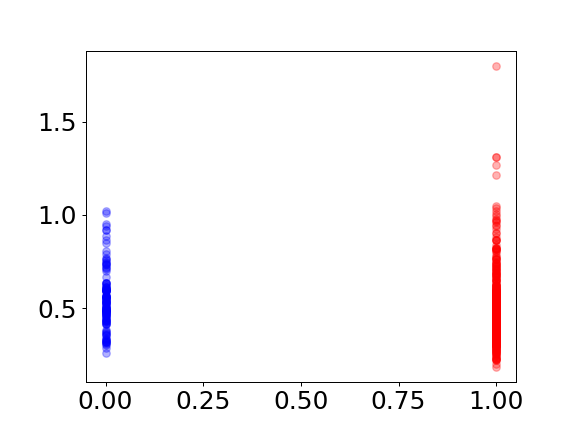

model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.16259019292720175, 0.09009923013882944, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1694844113830435, 0.27090500764753245, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.14906480583305426, 0.30625682638994267, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.04722381995690157, 0.39240481053098236, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.23643996616387553, 0.11063108497340196, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.16490409198141565, 0.32476569849272996, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1399880607232053, 0.18202581675007, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch135.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.12884552324399703, 0.09516311735443765, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.14229047303218778, 0.10913974074643198, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.14560627702508472, 0.236636523058196, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch150.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.2206308183810606, 0.20543054661681623, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.2620139726314511, 0.3936805478816557, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.25504826275877057, 0.4500684852954425, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.3732189211812594, 0.2328840171179849, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.31918427755427203, 0.1861354234129955, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.2692975537884309, 0.39977373270695915, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.25989561744718437, 0.4115418203087301, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch185.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.23074935174326638, 0.14857030228692264, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.06595017744201992, 0.10426373720373118, 0, 1.0000000000000002)
[11, 12]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch100.pth
(0.11702362435689942, 0.2197584803153485, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch105.pth
(0.11635977881970569, 0.21181928723042243, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1419616826600773, 0.385750694066736, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.10483924681527096, 0.13254166368516254, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1044320849625229, 0.23197678906423103, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1268739842473755, 0.17210815975735652, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.2191183859139471, 0.20887291466963426, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch135.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.24809064981984646, 0.3425357593658227, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.13642619687088475, 0.7126413996372061, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.12715550383793134, 0.21225896037579656, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch150.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1295029028204951, 0.36819521255949206, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1412929815196972, 0.19222773376681115, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.11840439806535977, 0.25667005346442995, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.13986606629515716, 0.13955071712554812, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.13965004200658038, 0.44514566242511894, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1827847548722505, 0.1417343228149142, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.11710850083586048, 0.2098297470039851, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch185.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.2246732050179805, 0.34111566049550224, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1395043080905286, 0.2925033773875484, 0, 1.0000000000000002)
[11, 13, 14, 16]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10120176294030422, 0.1169716878599791, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09853081344683139, 0.11367487902458667, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch110.pth
(0.10803485990996532, 0.11657963250823494, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch120.pth
(0.12530369982368472, 0.12821124352538246, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1281721933797047, 0.12568668525087784, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1269959573473942, 0.12361878527802611, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch135.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11678774991538926, 0.11095646376380595, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch140.pth
(0.11138700370485453, 0.1035960331318816, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch145.pth
(0.11625885691137267, 0.11306251273023948, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch150.pth
(0.11874809328448283, 0.10665256054772912, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1190892095838832, 0.10397796709775792, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11808036623391191, 0.10320370653229394, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09550384172992929, 0.08812996832173906, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch170.pth
(0.10053011825875258, 0.09110863224565616, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10718966496938061, 0.09408064814945774, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10309073993109216, 0.10079173315450479, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch185.pth
(0.10544318575246697, 0.09847043690144817, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10347651011060618, 0.10445592363798131, 0, 1.0000000000000002)
[8, 10, 11, 12, 15]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.17685941719548087, 0.18172705835258052, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch105.pth
(0.18569284045587478, 0.1693250915478886, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch110.pth
(0.19182804904345452, 0.17477269728439404, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1942649229055326, 0.18767251193189532, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch120.pth
(0.19548329735183317, 0.18347705230081263, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.31948170472319637, 0.1966857933187514, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1591157507461268, 0.14140839568447955, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch135.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.16706102291428068, 0.16907693945386057, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.16227428507599823, 0.1677499705125332, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.16630732438133772, 0.16772226093612713, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch150.pth
(0.1554673142614315, 0.15479132769124898, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.17966949024937884, 0.17561326768307733, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.17091705804489563, 0.16352117253250315, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1733830277028408, 0.16024989962806213, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.16864135153931348, 0.1666751744128464, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.16776218473822327, 0.16110733476456196, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.17075449195189607, 0.1596537517572557, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch185.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.14946359460724867, 0.14646739141254875, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
[8, 9, 11, 12, 13, 15, 16, 18]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_1_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1989339162486194, 0.22172627175985116, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_1_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.19386534122455967, 0.25027252775108466, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_1_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1737500448293634, 0.23173940826107525, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_1_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.17400799093900932, 0.17567890387040175, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_1_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.15075788565487042, 0.16652784727586606, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_1_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.17164720765298552, 0.10027948090364319, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_1_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.18651087727366344, 0.2188595259926718, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_1_epoch135.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.13137315144430495, 0.5517717295454105, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_1_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.11687045834291401, 0.5701605822738036, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_1_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.08693234904516076, 0.2924822097034303, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_1_epoch150.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1625410583105634, 0.6303266712615153, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_1_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.12016238452256336, 0.13489480701693551, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_1_epoch160.pth
(0.21121032713223686, 0.10211655617316977, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_1_epoch165.pth
(0.19706359750682495, 0.1129241275773443, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_1_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.15712105434340867, 0.08993008004483197, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_1_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13754736458434358, 0.07862341551138692, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_1_epoch180.pth
(0.15896833273427208, 0.0944360910780648, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_1_epoch185.pth
(0.1726366978293627, 0.10730611071602644, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_1_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.18302960620782854, 0.11471034545852563, 0, 1.0000000000000002)
[10]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch100.pth
(0.15210818436407308, 0.16218309436137096, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.15512875166519935, 0.16048772403122957, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.16281186991224328, 0.16616731557488318, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1841834215289379, 0.18332230219866696, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.18171142439072901, 0.1752476885057658, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch125.pth
(0.1729076731155449, 0.17410391262508884, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.17381606113965858, 0.17640379853426005, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch135.pth
(0.1707234199324048, 0.17598392730959644, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.16957359894551305, 0.16749893714490233, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.17044091145174256, 0.1682541455715833, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch150.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.17364658968188618, 0.17331726105329193, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch155.pth
(0.1720468212528511, 0.1786805102196623, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.17196576125837615, 0.1740854522668146, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.7424908641013346, 0.2983754973256889, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1381477075232635, 0.12035211414248258, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch185.pth
(0.13975509783478932, 0.1160670278488963, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_1_epoch190.pth
(0.12338730681995445, 0.11327866671070475, 0, 1.0000000000000002)
[3, 5, 6, 7, 8, 9, 10, 11, 12]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.3561152762393127, 0.10874295327025016, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch105.pth
(0.2939221668151667, 0.10675784928575718, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.270562103771808, 0.09338816855169532, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.26527413803352906, 0.08297194033814509, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.2574477394179425, 0.08094090045137146, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.2773106749400748, 0.09024938598692211, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.19418564500454122, 0.0639481430029914, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch135.pth
(0.17118367661481773, 0.05945436519624385, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13028713232303873, 0.08254806952932037, 0, 1.0000000000000004)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.15263791028184154, 0.05561279005514114, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch150.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13042456300244304, 0.04867073800321098, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch155.pth
(0.1581536590483923, 0.06250113145408626, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.14957521483026437, 0.060588901206930994, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch165.pth
(0.17899023354504473, 0.07747773168338506, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch170.pth
(0.1648982213316202, 0.07293677486789221, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1701551431511567, 0.07959918435932992, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch180.pth
(0.17190401355442247, 0.08247118407155324, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch185.pth
(0.1803124475942832, 0.08629729518373969, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_1_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.21786767315966038, 0.07377197136679381, 0, 1.0000000000000002)
[7, 11, 13, 14, 15, 16, 18]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.16891397684870807, 0.1896482590163711, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.16204348877505326, 0.17891373265664434, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.18358233889546782, 0.20564180279721417, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch115.pth
(0.15267232891576105, 0.17691452661792262, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch120.pth
(0.18234639189093876, 0.21941702772127264, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.16257097519133085, 0.18678419552260525, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch130.pth
(0.1672193151828255, 0.19207200939437985, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch135.pth
(0.17013637739933335, 0.1789018150465552, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.17536969197914815, 0.19449833319829957, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch145.pth
(0.15684088837151786, 0.1667654426072922, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch150.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1539963843507214, 0.15014390231486585, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch160.pth
(0.14991226803890761, 0.14658377074618706, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch170.pth
(0.14298887398634114, 0.13701594228915046, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch175.pth
(0.14833138646796207, 0.13997899019993681, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.14862773981729163, 0.14559821429459635, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch185.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.15056432241202616, 0.14422117257612743, 0, 1.0000000000000002)
[5, 7, 10, 11, 13, 14, 18]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.12064345688939629, 0.11328687539333, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1284242051998703, 0.14002315067350346, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.09184039091755328, 0.16587302466874382, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.07355077221495582, 0.176688012646106, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.15400185968914426, 0.4229827927558866, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.10401449589249319, 0.16558199776795673, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.09655525335387316, 0.20467690245650755, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch135.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.08455467853750984, 0.3332701641822079, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.09167737587107733, 0.29173495871022526, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1144611054785071, 0.14912615528895373, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch150.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1146108621560959, 0.4689913030217041, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.08613836696990884, 0.2364060152640739, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1859228349924838, 0.48310898713192224, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.06752083107227966, 0.1106102234642265, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10390289204542158, 0.1521720123930698, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.12169559535662114, 0.34813101035652316, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10012199478081049, 0.14725356832486824, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch185.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10074379828099857, 0.1468296481692105, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_1_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.12520122292127456, 0.19325544394351368, 0, 1.0000000000000002)
[13]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_1_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09830825358322454, 0.10778615634825041, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_1_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10403607254702646, 0.11775207817186645, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_1_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10692997023087333, 0.12141135427422922, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_1_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1025912927770383, 0.11643477555878176, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_1_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10637738209640152, 0.1217719963608847, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_1_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10123796295013326, 0.11462916786790685, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_1_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1017546203408776, 0.11606245327189454, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_1_epoch135.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1008350670025722, 0.11825654021486212, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_1_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09723238338558944, 0.11267033536372528, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_1_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09734784603151728, 0.11486308908655592, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_1_epoch150.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.0920849892952385, 0.10802135173080787, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_1_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09099621805639979, 0.11030537327846063, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_1_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09113277247901327, 0.11180310737999974, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_1_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.08825437152083088, 0.11113345530013863, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_1_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.08692446666319206, 0.10936445031638937, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_1_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.08796113952609566, 0.10761543300129281, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_1_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.08729182184673631, 0.10948976660100473, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_1_epoch185.pth
(0.08865508121622312, 0.10417284737340804, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_1_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.08875665397040772, 0.10932813118357226, 0, 1.0000000000000002)
[]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.14182340899933965, 0.14695107823396047, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch110.pth
(0.14722131679488415, 0.1554187886891707, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.14626751702801866, 0.14881643710943604, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13373674606932356, 0.13164897857422325, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13465206534693797, 0.12855430813643004, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.14003147536623423, 0.13634730864042177, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch135.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13434235728508045, 0.13254281732640222, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.14557179854791968, 0.14825700426969085, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13363213305378246, 0.11655415615552019, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch150.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.14169839759826072, 0.11874629496608034, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch160.pth
(0.14231552359274424, 0.12272466450629202, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch165.pth
(0.14980760924545367, 0.13049171911965246, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.14918361666420227, 0.12407355872793907, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.15662265316881568, 0.12872598204480173, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch180.pth
(0.1552655391192635, 0.1272447774145234, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch185.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13848561587099245, 0.11402952532621713, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_2_epoch190.pth
(0.14758902194145246, 0.11793159832893912, 0, 1.0000000000000002)
[10, 12, 13]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_2_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.18809802190235975, 0.11166637855510375, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_2_epoch105.pth
(0.19853051282875916, 0.1267758779599839, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_2_epoch110.pth
(0.20792140995862268, 0.12496104287106594, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_2_epoch115.pth
(0.20044567141460345, 0.1065247085872045, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_2_epoch120.pth
(0.2074721726113979, 0.10968453222557431, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_2_epoch125.pth
(0.19616547655522976, 0.09953774396438819, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_2_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.18573722203178422, 0.09337572366323374, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_2_epoch135.pth
(0.1772118445268634, 0.0875793666747108, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_2_epoch140.pth
(0.1853765932627633, 0.08944891682912606, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_2_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.17267715858772542, 0.07911443403744575, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_2_epoch150.pth
(0.18977283349017893, 0.08365899567623009, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_2_epoch155.pth
(0.16740002372271098, 0.08117647458112726, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_2_epoch160.pth
(0.16490340782590562, 0.07791576666510487, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_2_epoch165.pth
(0.17293723799224028, 0.08549754868525117, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_2_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.18246681293568587, 0.08843802363484461, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_2_epoch175.pth
(0.17137656877208918, 0.08338033656424346, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_2_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.15968822867939816, 0.07306803656057015, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_2_epoch185.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.14894154563495918, 0.07418721982229759, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_2_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.16532842528273395, 0.0759253423397741, 0, 1.0000000000000002)
[16]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.11566165749499605, 0.20461593371004871, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1826163126991494, 0.15386984375082846, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.18234776771043393, 0.16646957846463128, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1653080854371004, 0.15538656733072365, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.17373776983842304, 0.17311084535681293, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.17637746113952008, 0.17861858089005714, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1535031711702791, 0.15548844433400047, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch135.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.15168028735214367, 0.15436647972642614, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.15027182362201752, 0.1474832240060131, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1484094616630819, 0.15317209453713274, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch150.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.14328127644399324, 0.14117643832366716, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1392999248102415, 0.1391559548581459, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13991467363513618, 0.13633014019595568, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13204466311686786, 0.12732018144466467, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13868635530980894, 0.13592878434226532, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1416038426487509, 0.13741748634677348, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch185.pth
(0.1327937659671812, 0.1228531653982352, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_2_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.14272078638727623, 0.13906222269509655, 0, 1.0000000000000002)
[]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1207018247988132, 0.11637927023390138, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch105.pth
(0.11294263038966287, 0.12315275945148325, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11748012939027039, 0.13155320295403308, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch115.pth
(0.11199444171701019, 0.1217458864548123, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1101861961622338, 0.12261478888526488, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11654688654358125, 0.12494923374559345, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch130.pth
(0.1020605151056439, 0.11289359401917841, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch135.pth
(0.10151029651783378, 0.11217920618701721, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10053908513290144, 0.10750188890194085, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10211263460968006, 0.10879097759014196, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch150.pth
(0.10012837788389176, 0.10743820002235699, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10442089133102508, 0.10825568131096187, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10303833207911314, 0.10334249902984494, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.104655312572031, 0.10599800666868406, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09186966574009804, 0.10994411716138638, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.08553723322342685, 0.11322383836024655, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.085465657675847, 0.10586497875857352, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch185.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10307120260288438, 0.12734956830655975, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_2_epoch190.pth
(0.09455156064119336, 0.12046118383822724, 0, 1.0000000000000002)
[8]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.23101436212184517, 0.5834685464483602, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.12164897230213566, 0.1751836783305698, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.07163517958928847, 0.28604481402561255, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.23171591513355982, 0.13779096120894357, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.12086028130814684, 0.37550128270346206, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.2218735555706859, 0.23159673698060007, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.2746301993407808, 0.6211589880634139, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch135.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.14632643253413183, 0.1221836792756403, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch140.pth
(0.1435726520728059, 0.11927310424174181, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.15086370630310925, 0.16861589315609482, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch150.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.2591270737045933, 0.2737040258309843, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.2480479157530599, 0.7401328337571771, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.2920153526480377, 0.1382802638210574, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.2752236982106777, 0.6303317854609938, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.45413734230210523, 0.4981944052849553, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.3775965597257275, 0.41645212983669644, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.3577878821637058, 0.12965938200052518, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch185.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.27039355337726856, 0.16307237316506323, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_2_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.5418239438140906, 0.24145574348035104, 0, 1.0000000000000002)
[6, 11, 12, 14, 16, 17, 18]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11188143895506508, 0.10547392401917811, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11039248602465804, 0.09980810759864392, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11997440484645691, 0.10967206712486173, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.12937077252432094, 0.11259235288505592, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.12038431974998993, 0.1099052484443856, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch130.pth
(0.11283416891764236, 0.10297808426070161, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch135.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10899303919067047, 0.09817706227147074, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10349687870346044, 0.09918529118598807, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch145.pth
(0.1080886994430526, 0.10046347719464262, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch150.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11719268456838038, 0.10383102904839524, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)


(0.0004601538649370542, 0.00037804247550141313, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13284675154530245, 0.11781392338878108, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1263100199279532, 0.1085381776086117, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch185.pth
(0.12047884692930225, 0.11227760040620086, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_2_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11020205476562146, 0.11202008501112488, 0, 1.0000000000000002)
[10, 13, 14, 15, 17]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_2_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.26389544739458104, 0.2854684711670359, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_2_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.16706026424644077, 0.5067483839704727, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_2_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10432622248238267, 0.1483060185885842, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_2_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10056318138651554, 0.14112304089651895, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_2_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10242171399704111, 0.1390162764389546, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_2_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09766496152600457, 0.13105910376936458, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_2_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10119927464415439, 0.13617571750620566, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_2_epoch135.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10491719251591519, 0.13864957854735127, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_2_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_2_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1053938703588046, 0.1358883365888019, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_2_epoch150.pth
(0.10689713229315898, 0.13586390278340932, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_2_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_2_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10095371275303999, 0.13612472693177413, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_2_epoch165.pth
(0.10443790156260435, 0.1323481015957808, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_2_epoch170.pth
(0.09915977244944296, 0.12485935720422572, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_2_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10240566900657141, 0.13094454978626208, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_2_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_2_epoch185.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10714711569575153, 0.14445795174937465, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_2_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
[10, 13]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.11788477809760234, 0.20890836586658001, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.16803682379110968, 0.21003882329651882, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.2138135628975566, 0.41711869888088293, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.19305982812411882, 0.7098142590696565, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.13020449896115002, 0.17193355560295792, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.137010143207751, 0.17793248040888726, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.15616037917339698, 0.6529146096615861, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch135.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10167244034822569, 0.14258110901036755, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09719309853603807, 0.13318771213417763, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10986067186174914, 0.15391946182192562, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch150.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10716677648832051, 0.15180422360535653, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1036479665887199, 0.1463105989922291, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10966579130533312, 0.1568631128910179, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch165.pth
(0.1072240068929452, 0.15311346710624194, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1086495652748585, 0.1536607037826529, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.15352229502820985, 0.17002246312924205, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10495922717606279, 0.13916710178324365, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch185.pth
(0.10063779612337201, 0.1279617832212731, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_2_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10931891050437832, 0.15372767521011443, 0, 1.0000000000000002)
[10, 17]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch100.pth
(0.1355862603583824, 0.14552340629026023, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1253865794311232, 0.13759947574782574, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13256439149336618, 0.1482862474640652, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1309739962154212, 0.14641346902831442, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1353495902342579, 0.1530312832846949, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch125.pth
(0.14357819338570194, 0.15854835011544097, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1397215825758247, 0.14850669670654643, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch135.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13827260432726207, 0.14863720904942768, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13575874451412306, 0.13666633677049347, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1365650745147311, 0.14284966329044835, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch150.pth
(0.1287625336566614, 0.14196267109656657, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch155.pth
(0.12995812938912416, 0.14113568597448392, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch160.pth
(0.12562670009134247, 0.13554700601647413, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.12318226449815232, 0.13315816149582932, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch170.pth
(0.11513929613811824, 0.12009831873464506, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch175.pth
(0.11187717089604567, 0.1169935780513153, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10417592528121189, 0.11434129153373938, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch185.pth
(0.10716584968720123, 0.11300732691873894, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch190.pth
(0.10816114977389034, 0.116926439720908, 0, 1.0000000000000002)
[4, 7, 8, 10, 11, 12, 15, 17, 18]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1352359300496241, 0.11289688737367864, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13201997382651195, 0.11839161064438923, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.14131538138342542, 0.12536333447234882, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1410124630186076, 0.12239037890723012, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch130.pth
(0.1364657080153181, 0.11655995164802141, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch135.pth
(0.12714592360677063, 0.11897181053418249, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch140.pth
(0.12924273208862663, 0.12327914675842491, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch150.pth
(0.1329866779412937, 0.11624738144297644, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch155.pth
(0.13559058700714988, 0.11947951182741703, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1350746328262754, 0.11777480434305143, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch165.pth
(0.13784540327879485, 0.11697544880238288, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1382780267196711, 0.11598290995183902, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.14450242977282768, 0.11919534706565882, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.14271892231441946, 0.1035358502178266, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch185.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.13399071821870556, 0.2431598254954685, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_2_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.15312400302578355, 0.12683799570154547, 0, 1.0000000000000002)
[6, 9, 11, 12, 13, 14, 15, 16, 17, 18]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.11808025282447593, 0.3284343010402143, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.14841274704949126, 0.2011794661585567, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.2067945391349415, 0.4128606727911852, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch115.pth
(0.13388601083319024, 0.1813063385496493, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.24808574280973977, 0.20895908094320786, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1904724288027677, 0.3181282755847925, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.13458685433168258, 0.47337131757449413, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch135.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1813751453849002, 0.3749286170519895, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.15459084215531466, 0.16901141070821524, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.16586434016709722, 0.5597449727542996, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch150.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1708208547627884, 0.334204087793324, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.22643022923839778, 0.5200445842256322, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13158047843904475, 0.17784237253050486, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1756185578019042, 0.22511369917514257, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch170.pth
(0.16217696607303395, 0.21045140955618674, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.17402186829755786, 0.20030725653630732, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.16953068810286617, 0.22051054839722456, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch185.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch190.pth
(0.1795546495915502, 0.233923249169833, 0, 1.0000000000000002)
[10, 11, 13, 15]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.12196816824993795, 0.10843021028596822, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.12029242095399148, 0.10293697533801718, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11615883904211087, 0.09702568727609437, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.12785486053401707, 0.10969127788028483, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13970908769849624, 0.11728853821239024, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13812512603541924, 0.11677881905629567, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.20843634149810106, 0.13670001146986532, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch135.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1239644183036345, 0.0997430907428607, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.12133198646864021, 0.09683704722269285, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.19003405864096873, 0.08728715578808867, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch150.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.0411298554844958, 0.16318471752083252, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11662048790578197, 0.08984442724080496, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.2232573045391233, 0.24834159218019455, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.09637037601059237, 0.06983859417009039, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.234914814375338, 0.15893322527307974, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.24104758004758553, 0.17184010320498916, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1934716915691464, 0.11151926437219734, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch185.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.2390950029434351, 0.6962466946413726, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11485889768078708, 0.09147485857794918, 0, 1.0000000000000002)
[10, 12, 16]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.12097596987622031, 0.14127746997087348, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09913906281260013, 0.11975550928065158, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09241337052942111, 0.11241766076244586, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch115.pth
(0.10567110130176946, 0.147940044747141, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.14915380888276844, 0.1876502137311317, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.12653269720630916, 0.14781665144151362, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11956570078210209, 0.14594219087846752, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch135.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10623950293282637, 0.12088274988765112, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11428394161568525, 0.1330179317326431, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1035160578295419, 0.11730564069499251, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch150.pth
(0.11505984649938653, 0.13080802729129132, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1155725434440242, 0.13758643484049848, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1126324965224419, 0.13830980809791057, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11482190614659102, 0.13866459657846092, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11394475556169634, 0.1383052919599883, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch175.pth
(0.11133471066802078, 0.13233320846580962, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch180.pth
(0.1093254769851511, 0.12985901651126797, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch185.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_3_epoch190.pth
(0.11013737455773909, 0.13786136644291197, 0, 1.0000000000000002)
[15, 17]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch100.pth
(0.10865542557553634, 0.14796998823270413, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch110.pth
(0.10962939488662768, 0.13800790276293284, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11650868071282003, 0.15701674193020512, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch120.pth
(0.10496549628115939, 0.1494806264871894, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09236591744051736, 0.12642281008916412, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10179373878664384, 0.1379575068263177, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch135.pth
(0.10128906102473498, 0.1362222333569818, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch140.pth
(0.10609115073320073, 0.14492615217149424, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11341488367786376, 0.15355958181406376, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch150.pth
(0.11433895544983744, 0.15357836115438783, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch155.pth
(0.11460507226491823, 0.15294256610665807, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.1517414030372491, 0.3865647319136779, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11281930339705795, 0.1574487444404819, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.12080065906691173, 0.16501256647537335, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.12366208313359542, 0.1626577036766081, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11835351720492035, 0.1439760014185435, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch185.pth
(0.1280022873521906, 0.1556728167953496, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11502237466410195, 0.14012176138094232, 0, 1.0000000000000002)
[7, 14, 15, 16, 18]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.08917905384751812, 0.11530896934081974, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch105.pth
(0.09791288687133845, 0.11927538515886858, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09024379192216295, 0.10894993991314728, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch115.pth
(0.09236663706034055, 0.10740273576652551, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.097066914265686, 0.11040794808647084, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10833005386564001, 0.12808991195673222, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10540682326745292, 0.12130018322844839, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch135.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10280531255962186, 0.11827063188128982, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1088648283813593, 0.12093899568863238, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch150.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11343650928314442, 0.12154209187566323, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11132623713598033, 0.13081047173436738, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch160.pth
(0.10389502511530299, 0.1224327284115443, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.0979595920708478, 0.13028366575190514, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10025908615075485, 0.1275045390829606, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09684708368459971, 0.1293559841676954, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch185.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch190.pth
(0.10207323513430994, 0.13883144902727912, 0, 1.0000000000000002)
[3, 4, 6, 7, 8, 10, 15, 16, 17, 18]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch110.pth
(0.08050702968107368, 0.10426701353831705, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch115.pth
(0.0824455730481825, 0.10749465322997621, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.08136893074326855, 0.1164460559438251, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch125.pth
(0.09228667552760911, 0.117711746344874, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch130.pth
(0.09723036161493046, 0.11981438936508784, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch135.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09092739866924338, 0.10927106922614835, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09230268219865537, 0.11076717242985726, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch150.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09537987933630851, 0.11325940319756378, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch155.pth
(0.10463758891224725, 0.11235450770778531, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09287448768530432, 0.09954817271074462, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09632002253841954, 0.10918279473515302, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11346315508617277, 0.1341690217993352, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch175.pth
(0.12178617813113057, 0.1383264401146233, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch180.pth
(0.12075846571127347, 0.13695671401688536, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch185.pth
(0.12192734252415513, 0.13815157450407764, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s6_100_3_epoch190.pth
(0.12144647492906271, 0.13758630880932465, 0, 1.0000000000000002)
[6, 7, 8, 9, 10, 11, 13, 14]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_3_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.06976810220145727, 0.22163275187768922, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_3_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.06832994829697947, 0.20541150073397746, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_3_epoch110.pth
(0.06973723815921011, 0.20798238754745152, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_3_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.06844242505995632, 0.1998790225007, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_3_epoch120.pth
(0.07502959624049282, 0.2194974999184815, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_3_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.07526961563012385, 0.2265990640601871, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_3_epoch130.pth
(0.07159680960345521, 0.2140634771747269, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_3_epoch135.pth
(0.07355355189030713, 0.21543554904002055, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_3_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.07601072607356285, 0.2219488650956697, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_3_epoch145.pth
(0.07532754717299978, 0.21978242506874124, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_3_epoch150.pth
(0.08591874701378996, 0.236731305481429, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_3_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.08152541578616768, 0.22344636487897618, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_3_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.07559456842343332, 0.2130262550608476, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_3_epoch165.pth
(0.08332379565766238, 0.22021045321498844, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_3_epoch170.pth
(0.08786377512938039, 0.22838691901799832, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_3_epoch175.pth
(0.13919492507793924, 0.320593528587866, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_3_epoch180.pth
(0.10439088322285192, 0.2277955012682856, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_3_epoch185.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.08903153427256208, 0.222335244218079, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s7_100_3_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09073213010858602, 0.22239053607846415, 0, 1.0000000000000002)
[7, 9, 10, 13, 14, 17, 18]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10245185734214446, 0.11301223411079034, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch115.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09933019358328361, 0.10847876608876106, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09483220544817961, 0.1047666891438171, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09728725208998196, 0.10898364572606978, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10185768499933853, 0.11724764176885231, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch135.pth
(0.10692695675702252, 0.12672971452986587, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10571350641084659, 0.1270341458296787, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09527764348635218, 0.11369688039342005, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch150.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10026899830391578, 0.11726882890348363, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09756287883191601, 0.11872182350584679, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.0932059709870258, 0.11274216715220155, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09834774450839179, 0.11243407365433931, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch170.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.0925359258381813, 0.1113522499959304, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09426981527358497, 0.11462650149037268, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09183943925419885, 0.11103736235224197, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch185.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_3_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.09656273063028695, 0.11602211289688398, 0, 1.0000000000000002)
[]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch100.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.12813016020338708, 0.14633528074658259, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch110.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1305944584833854, 0.14262055137350493, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch115.pth
(0.12962609876494163, 0.14316499849185438, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch120.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.1221269937330611, 0.1342455372727696, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch125.pth
(0.1277659114449791, 0.1345453074823924, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch130.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.12714341639116494, 0.13055114628911918, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch135.pth
(0.11892378638669054, 0.12820155293336066, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch145.pth
(0.11551116994948529, 0.12129360143387138, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch150.pth
(0.11580130731436226, 0.11675547976965699, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11212994496931647, 0.11614508388379068, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch160.pth
(0.12981829195738315, 0.1231831375451882, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch165.pth
(0.11128687957285699, 0.10365108133313802, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch170.pth
(0.10504664746174619, 0.09832783363239442, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch175.pth
(0.10721046401643612, 0.09873620697019458, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10586254679321812, 0.0997904048519023, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch185.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11019646102764707, 0.1029505641046989, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_3_epoch190.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
[]
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch100.pth
(0.1376862558547494, 0.16426645130015027, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch105.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch110.pth
(0.13040232310121014, 0.16088275281508674, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch115.pth
(0.1285919638962999, 0.15554891130866216, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch120.pth
(0.12619669046986492, 0.15277774027941846, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch125.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.13394979990398076, 0.1508458190270428, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch130.pth
(0.12951204470293112, 0.1388518043029125, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch135.pth
(0.11623660774449718, 0.12020879440768265, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch140.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.12669418345194877, 0.12150264923006213, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch145.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch150.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch155.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11016038945131461, 0.10278761543595316, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch160.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.10944519640611675, 0.10445646118875823, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch165.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11703662338317784, 0.1280694088961306, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch170.pth
(0.11007133189864715, 0.12241296614666505, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch175.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.11539708596296783, 0.13647046451982214, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch180.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_optimize.py:917: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


Error: maybe takes negative a or b
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch185.pth


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


(0.12176685592498687, 0.13665451924555366, 0, 1.0000000000000002)
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s10_100_3_epoch190.pth
(0.12388544609230884, 0.1402940522269457, 0, 1.0000000000000002)
[16, 18]
F_onewayResult(statistic=3.9224410563940277, pvalue=0.04812767481602865)
TtestResult(statistic=2.20858975754327, pvalue=0.028256068530545495, df=215.66929434940877)
F_onewayResult(statistic=4.207513362627669, pvalue=0.04070831388773144)


<IPython.core.display.Javascript object>


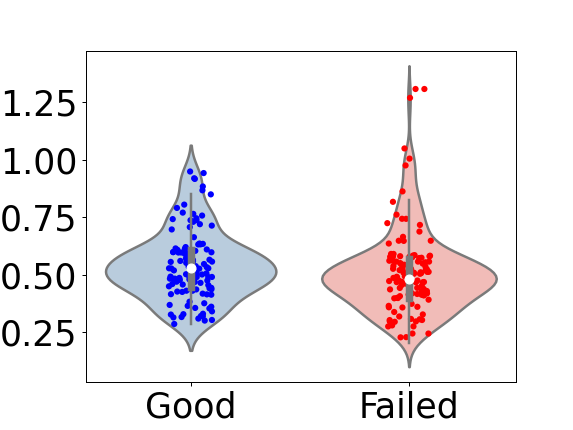

TtestResult(statistic=8.64556596748947, pvalue=2.5866261063740118e-15, df=183.92897312063687)
F_onewayResult(statistic=80.38290309485164, pvalue=4.557903169688298e-18)


<IPython.core.display.Javascript object>


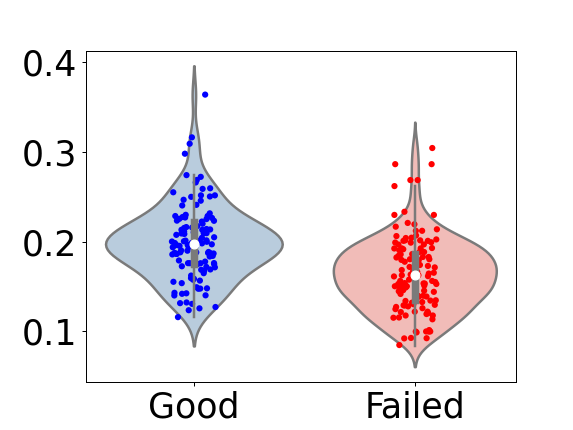

TtestResult(statistic=2.20858975754327, pvalue=0.028256068530545495, df=215.66929434940877)


<IPython.core.display.Javascript object>


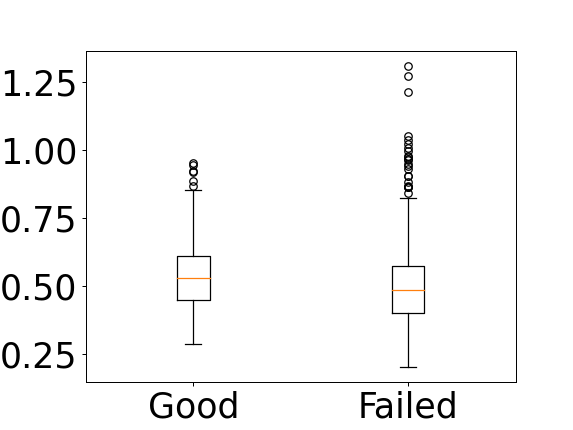

TtestResult(statistic=8.64556596748947, pvalue=2.5866261063740118e-15, df=183.92897312063687)


<IPython.core.display.Javascript object>


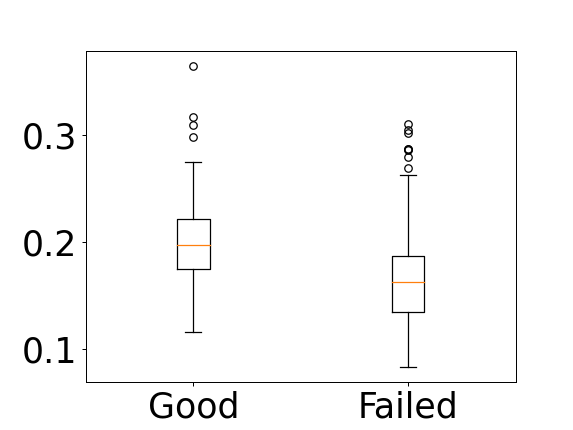

In [60]:
##########  Coherence and Beta Anova  #########################
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import time
import math
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import sklearn 
import nolds
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D
from scipy.special import expit
import pandas as pd
import glob
import scipy
import scipy.stats as st
import seaborn as sns


%matplotlib notebook

plt.rcParams["font.size"] = 20
plt.rcParams["figure.subplot.left"] = 0.15


def convert_astarisk(pvalue):
    if pvalue <= 0.0001:
        return "****"
    elif pvalue <= 0.001:
        return "***"
    elif pvalue <= 0.01:
        return "**"
    elif pvalue <= 0.05:
        return "*"
    return "ns"

def main(model):
    training_size = 100
    test_size = 1000
    epochs_num = 10
    hidden_size = 20
    batch_size = 10
    data_length = 100
    inputsize = 2
    outputsize = 2
    
    model_path = model
    
    colors = ['C0','C1','C2','C3','C4','C5','C6','C7','C8','C9']
    
#     delay_length = np.random.randint(1, 3)
    delay_length = 2
    train_x1,train_x2,train_y1,train_y2 = mkOwnDataSet_auto(training_size,delay_length)

#     rnn = MyLSTM_comp(inputsize, hidden_size, outputsize, batch_size)
    rnn = MyLSTM_RNN(inputsize, hidden_size, outputsize, batch_size)
#     rnn = MyLSTM_RNN_uniHPC(inputsize, hidden_size, outputsize, batch_size)
#     rnn = MyMTRNN2(inputsize, hidden_size, outputsize, batch_size)

    rnn.load_state_dict(torch.load(model_path))
    
    
    pattern = 1
    if  pattern == 1:
        data = mkOwnRandomBatch(train_x1, train_x1, batch_size).float()
    elif pattern == 2:
        data = mkOwnRandomBatch(train_x2, train_x2, batch_size).float()
    elif pattern == 3:
        data = mkOwnRandomBatch(train_y1, train_y1, batch_size).float()
    else:
        data = mkOwnRandomBatch(train_y2, train_y2, batch_size).float()
    
    params = []
    for p in rnn.parameters():
        params.append(p.data)
    
        
#     model_path = 'model/R20_131/ReModel_L2_interRNNrand_OUT1_131_s6_100_1_epoch125.pth'
    model_path = model
    rnn.load_state_dict(torch.load(model_path))
        
    for n, p in rnn.named_parameters():
            if n == "PFC.weight_ih":
                PFC_w_pre = torch.clone(p.data)
            if n == "HPC.weight_ih":
                HPC_w_pre = torch.clone(p.data)
            if n == "Re.weight_ih":
                Re_w_pre = torch.clone(p.data)
            if n == "Re.weight_hh":
                Re_inw = torch.clone(p.data)
            if n == "linear.weight":
                OUT_w_pre = torch.clone(p.data)
                   
    traj = []
    PFCstate = []
    HPCstate = []
    Restate = []
    Gate_states = []
    hidden = rnn.initHidden_rand()
    data_limit = 480
    est_length = 0
    init_point = torch.rand(10,2)*1
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
#             output,hidden = rnn(init_point,hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            Gate_states.append(Culc_gate(output,params,hidden))
#             Gate_states.append(Culc_gate_uniPFC(output,params,hidden))
#     for k in range(data.shape[0]*est_length):
#             output,hidden = rnn(output,hidden)
#             traj.append(output.tolist())
#             PFCstate.append(hidden[0][0].tolist())
#             HPCstate.append(hidden[1][0].tolist())
#             Restate.append(hidden[2][0].tolist())
#             Gate_states.append(Culc_gate(output,params,hidden))
    traj = torch.tensor(traj)
    traj = torch.squeeze(traj).numpy()
    
    pca = PCA()
#     dfs = np.array(HPCstate)[:,0]
    dfs = np.array(Restate)
    pca.fit(dfs)
    Refeature = pca.transform(dfs)

    shift = 2
    seglen = 60
        
    coherence_diff_list_HPC = []
    coherence_diff_list_PFC = []
    for i in range(20):
        for k in range(1):
            data = np.array(Refeature)[:,0]-moving_average(np.array(Refeature)[:,0])[2:-2]
            freqs,times,sx1 = signal.stft(data,fs=1,window="tukey",nperseg=seglen,noverlap=seglen-shift,detrend=False,boundary=None)
            data = np.array(PFCstate)[:,k,i]-moving_average(np.array(PFCstate)[2:-2,k,i])[:]
            freqs,times,sx2 = signal.stft(data*1,fs=1,window="tukey",nperseg=seglen,noverlap=seglen-shift,detrend=False,boundary=None)
            data = np.array(HPCstate)[:,k,i]-moving_average(np.array(HPCstate)[2:-2,k,i])[:]
            freqs,times,sx3 = signal.stft(data,fs=1,window="tukey",nperseg=seglen,noverlap=seglen-shift,detrend=False,boundary=None)
            
            xsp = sx1*np.conjugate(sx2)
            coherence = (np.abs(xsp)**2)/(np.abs(sx1)*np.abs(sx2))
            
            coherence_diff_list_PFC.append(np.max(np.sum(coherence.T,axis=1))-np.min(np.sum(coherence.T,axis=1)))
            
            xsp = sx1*np.conjugate(sx3)
            coherence = (np.abs(xsp)**2)/(np.abs(sx1)*np.abs(sx3))            
            
            coherence_diff_list_HPC.append(np.max(np.sum(coherence.T,axis=1))-np.min(np.sum(coherence.T,axis=1)))
            
#             xsp = sx2*np.conjugate(sx3)
#             coherence = (np.abs(xsp)**2)/(np.abs(sx2)*np.abs(sx3))
#             plt.figure()
#             plt.pcolormesh(times,freqs,coherence)
#             plt.title("PFC-HPC neuron#"+str(i+1))
    
    
    ######### beta params #############
    data = np.array(Gate_states)[:,0,0:20].ravel()
    try:
        beta_PFC = scipy.stats.beta.fit(data, floc=0)
        print(beta_PFC)
        beta_param = np.mean([beta_PFC[0],beta_PFC[1]])
    except Exception:
        print("Error: maybe takes negative a or b")
        beta_param = 0.5
    
    
#     return np.mean([PFC_a,PFC_b,PFC_c]),np.mean([HPC_a,HPC_b,HPC_c]),np.max([PFC_a,PFC_b,PFC_c]),np.max([HPC_a,HPC_b,HPC_c]),frac_amp
#     return np.mean([PFC_a,PFC_b,PFC_c]),np.mean([HPC_a,HPC_b,HPC_c]),np.max([PFC_d]),HPC_d
#     return np.mean([PFC_a,PFC_b,PFC_c]),np.mean([HPC_a,HPC_b,HPC_c]),np.max([PFC_d]), HPC_e, frac_amp
    return np.sum(coherence_diff_list_PFC), np.sum(coherence_diff_list_HPC), beta_param


if __name__ == '__main__':
    fig = plt.figure()
    correlation_fig = fig.subplots()
#     correlation_fig.set_xlim(-1,1)
#     correlation_fig.set_ylim(0,1)

#     model_list = glob.glob('model/R20_131/*OUT1**s8_100_2_*epoch*.pth')
#     model_list = sorted(model_list)
#     model_list = sorted(model_list,key=len,reverse=False)
#     k=0
#     for model in model_list:
#         print(model,PFC,HPC)
#         PFC,HPC = main(model)
# #         correlation_fig.plot(PFC,HPC,"o")
# #         correlation_fig.text(PFC,HPC,model.split("epoch")[-1].split(".")[0])
#         correlation_fig.plot(k*5,PFC/HPC,"o")
# #         correlation_fig.text(k*5,PFC/HPC,model.split("epoch")[-1].split(".")[0])
#         k+=1

    allratio_list = []
    allratio_list_HPC = []
    good_points = []
    bad_points = []
    good_points_PFC = []
    bad_points_PFC = []
    good_points_HPC = []
    bad_points_HPC = []
    good_points_beta = []
    bad_points_beta = []
    for num in range(3):
        for i in range(10):
            path = 'model/R20_H_bigbatch/'
#             path = 'model/R20_H_uniHPC_bigbatch/'
            model_list = glob.glob(path+'*s'+str(i+1)+'_100_'+str(num+1)+'_*epoch1??.pth')
            model_list = sorted(model_list)
            model_list = sorted(model_list,key=len,reverse=False)
            ratio_list = []
            ratio_list_max = []
            ratio_list_max_HPC = []
            with open(path+"good_list.txt", mode="r") as f:
                good_list = f.read().splitlines()
#             good_list = []
#             if i+1 == 4 and num+1 == 3:
#                 continue
#             if i+1 == 5 and num+1 == 2:
#                 continue
            
            first_goodmodel = [0,0]
            good_flag = False
            goodmodel_list = []
            k=0
            for model in model_list:
                print(model)
                if int(model.split("epoch")[-1].split(".")[0])>190:
                    continue
                cohPFC,cohHPC,beta_param = main(model)
                ratio_list.append(np.abs(PFC-HPC))
                ratio_list_max.append(cohPFC)
                ratio_list_max_HPC.append(cohHPC)
                if model in good_list:
                    goodmodel_list.append(k)
                    good_points_PFC.append(cohPFC)
                    good_points_HPC.append(cohHPC)
#                     good_points.append(frac)
                else:
#                     bad_points.append(frac)
                    bad_points_PFC.append(cohPFC)
                    bad_points_HPC.append(cohHPC)
                    pass
                k+=1
            
            length = len(ratio_list_max)
            print(goodmodel_list)
            ratio_list_max = np.array(ratio_list_max)
#             ratio_list_max = ratio_list_max/np.median(ratio_list_max)
#             correlation_fig.plot(np.arange(0,len(ratio_list_max)*5,5),np.array(ratio_list_max),color="C{}".format(i))
            for l in range(length):
                if np.any(np.array(goodmodel_list)==l):
                    correlation_fig.plot(0,ratio_list_max[l],"o",color="b", alpha=0.3)
                    good_points.append(ratio_list_max[l])
                else:
                    correlation_fig.plot(1,ratio_list_max[l],"o",color="r", alpha=0.3)
                    bad_points.append(ratio_list_max[l])
                
#             if good_flag == True:
#                 correlation_fig.plot(first_goodmodel[0],first_goodmodel[1],"o",color="C{}".format(i))
            allratio_list.append(np.array(ratio_list_max))
            allratio_list_HPC.append(np.array(ratio_list_max_HPC))
#     correlation_fig.plot(np.arange(0,len(ratio_list_max)*5,5),np.average(np.array(allratio_list), axis=0),color="b")
#     np.save("Re_PFCReCoh.npy",np.array(allratio_list))
#     np.save("Re_HPCReCoh.npy",np.array(allratio_list_HPC))
#     np.save("UniHPC_HPCmaxvar.npy",np.var(np.array(allratio_list),axis=0))
    print(scipy.stats.f_oneway(good_points, bad_points))
    
    good_points_PFC = np.sort(good_points_PFC)[1:-2]
    bad_points_PFC = np.sort(bad_points_PFC)[1:-2]
    good_points_HPC = np.sort(good_points_HPC)[1:-2]
    bad_points_HPC = np.sort(bad_points_HPC)[1:-2]
    
    print(st.ttest_ind(good_points_PFC, bad_points_PFC,equal_var=False))
    print(scipy.stats.f_oneway(good_points_PFC, bad_points_PFC))
    plt.figure()
#     plt.boxplot([good_points_PFC, bad_points_PFC],labels=["Good","Failed"])
#     violinplot = plt.violinplot([good_points_PFC, bad_points_PFC],showmedians=True,showextrema=False)
#     plt.xticks([1,2],labels=["Good","Failed"])
#     violinplot["bodies"][1].set_facecolor("red")
#     violinplot["cmedians"].set_color("black")
    
    quartile1_good, medians_good, quartile3_good = np.percentile(good_points_PFC, [25, 50, 75])
#     lower_good,upper_good = adjacent_values(good_points, quartile1_good, quartile3_good)
    quartile1_bad, medians_bad, quartile3_bad = np.percentile(bad_points_PFC, [25, 50, 75])

#     plt.vlines(1, quartile1_good, quartile3_good, color='k', linestyle='-', lw=5)
#     plt.vlines(1, upper_good,lower_good, color='k', linestyle='-', lw=1)
#     plt.scatter([1], [medians_good], marker='o', color='white', s=30, zorder=3)
#     plt.vlines(2, quartile1_bad, quartile3_bad, color='k', linestyle='-', lw=5)
#     violinplot["bodies"][1].set_facecolor("red")
    palette = sns.color_palette("Pastel1")
    my_pal = {0:palette[1],1:palette[0]}
    my_pal_strip = {0:"b",1:"r"}
    sns.stripplot(data=[good_points_PFC,np.random.choice(bad_points_PFC, np.size(good_points_PFC))],palette=my_pal_strip,zorder=2)
    sns.violinplot(data=[good_points_PFC,bad_points_PFC], palette=my_pal,linewidth=2)
    plt.scatter([0,1], [medians_good,medians_bad], marker='o', color='white', s=50, zorder=3)
    plt.xticks([0,1],labels=["Good","Failed"])
    plt.yticks(fontsize=28)
    plt.xticks(fontsize=28)
    plt.plot()
    sns.set_palette("tab10")

    print(st.ttest_ind(good_points_HPC, bad_points_HPC,equal_var=False))
    print(scipy.stats.f_oneway(good_points_HPC, bad_points_HPC))
    plt.figure()
#     plt.boxplot([good_points_HPC, bad_points_HPC],labels=["Good","Failed"])
#     violinplot = plt.violinplot([good_points_HPC, bad_points_HPC],showmedians=True,showextrema=False)
#     plt.xticks([1,2],labels=["Good","Failed"])
#     violinplot["bodies"][1].set_facecolor("red")
#     violinplot["cmedians"].set_color("black")
    
    quartile1_good, medians_good, quartile3_good = np.percentile(good_points_HPC, [25, 50, 75])
#     lower_good,upper_good = adjacent_values(good_points, quartile1_good, quartile3_good)
    quartile1_bad, medians_bad, quartile3_bad = np.percentile(bad_points_HPC, [25, 50, 75])

#     plt.vlines(1, quartile1_good, quartile3_good, color='k', linestyle='-', lw=5)
#     plt.vlines(1, upper_good,lower_good, color='k', linestyle='-', lw=1)
#     plt.scatter([1], [medians_good], marker='o', color='white', s=30, zorder=3)
#     plt.vlines(2, quartile1_bad, quartile3_bad, color='k', linestyle='-', lw=5)
#     violinplot["bodies"][1].set_facecolor("red")
    palette = sns.color_palette("Pastel1")
    my_pal = {0:palette[1],1:palette[0]}
    my_pal_strip = {0:"b",1:"r"}
    sns.stripplot(data=[good_points_HPC,np.random.choice(bad_points_HPC, np.size(good_points_HPC))],palette=my_pal_strip,zorder=2)
    sns.violinplot(data=[good_points_HPC,bad_points_HPC], palette=my_pal,linewidth=2)
    plt.scatter([0,1], [medians_good,medians_bad], marker='o', color='white', s=50, zorder=3)
    plt.xticks([0,1],labels=["Good","Failed"])
    plt.yticks(fontsize=28)
    plt.xticks(fontsize=28)
    plt.plot()
    sns.set_palette("tab10")
    
    print(st.ttest_ind(good_points_PFC, bad_points_PFC,equal_var=False))
    plt.figure()
    plt.boxplot([good_points_PFC, bad_points_PFC],labels=["Good","Failed"])
    plt.yticks(fontsize=28)
    plt.xticks(fontsize=28)
    
    print(st.ttest_ind(good_points_HPC, bad_points_HPC,equal_var=False))
    plt.figure()
    plt.boxplot([good_points_HPC, bad_points_HPC],labels=["Good","Failed"])
    plt.yticks(fontsize=28)
    plt.xticks(fontsize=28)

        

# Coherence and Eigenvalue

<IPython.core.display.Javascript object>


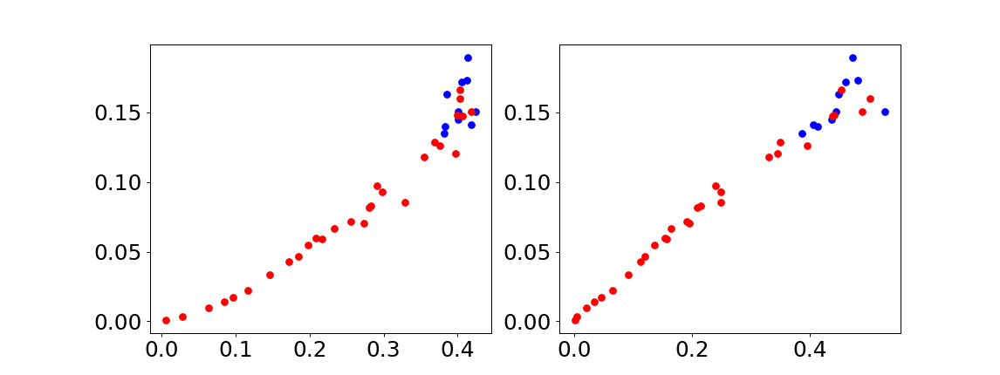

<IPython.core.display.Javascript object>


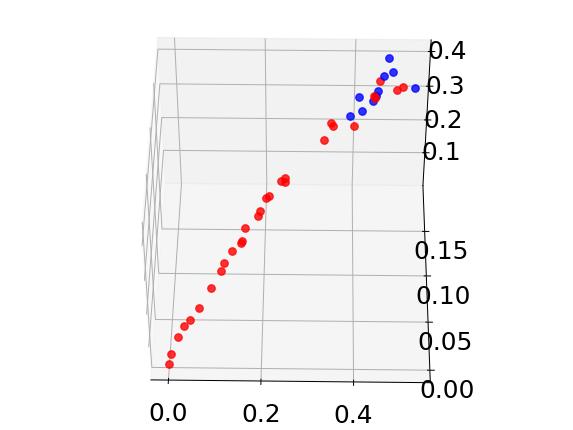

/tmp/ipykernel_2923202/1681236556.py:197: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax3d = Axes3D(fig3d)


model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch0.pth
0.00536903
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch5.pth
0.028491411
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch10.pth
0.06323356
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch15.pth
0.084189735
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch20.pth
0.09677508
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch25.pth
0.11671438
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch30.pth
0.1464991
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch35.pth
0.17179973
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch40.pth
0.18531297
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch45.pth
0.1978759
model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s5_100_3_epoch50.pth
0

/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4133: DegenerateDataWarning: at least one input has length 0
  warnings.warn(stats.DegenerateDataWarning('at least one input '


In [377]:
##########  Coherence and Beta Anova  #########################
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import time
import math
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import sklearn 
import nolds
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D
from scipy.special import expit
import pandas as pd
import glob
import scipy
import scipy.stats as st
import seaborn as sns
import numpy.linalg as LA


%matplotlib notebook

plt.rcParams["font.size"] = 20
plt.rcParams["figure.subplot.left"] = 0.15


def convert_astarisk(pvalue):
    if pvalue <= 0.0001:
        return "****"
    elif pvalue <= 0.001:
        return "***"
    elif pvalue <= 0.01:
        return "**"
    elif pvalue <= 0.05:
        return "*"
    return "ns"

def main(model):
    training_size = 100
    test_size = 1000
    epochs_num = 10
    hidden_size = 20
    batch_size = 10
    data_length = 100
    inputsize = 2
    outputsize = 2
    
    model_path = model
    
    colors = ['C0','C1','C2','C3','C4','C5','C6','C7','C8','C9']
    
#     delay_length = np.random.randint(1, 3)
    delay_length = 2
    train_x1,train_x2,train_y1,train_y2 = mkOwnDataSet_auto(training_size,delay_length)

#     rnn = MyLSTM_comp(inputsize, hidden_size, outputsize, batch_size)
    rnn = MyLSTM_RNN(inputsize, hidden_size, outputsize, batch_size)
#     rnn = MyLSTM_RNN_uniHPC(inputsize, hidden_size, outputsize, batch_size)
#     rnn = MyMTRNN2(inputsize, hidden_size, outputsize, batch_size)

    rnn.load_state_dict(torch.load(model_path))
    
    
    pattern = 1
    if  pattern == 1:
        data = mkOwnRandomBatch(train_x1, train_x1, batch_size).float()
    elif pattern == 2:
        data = mkOwnRandomBatch(train_x2, train_x2, batch_size).float()
    elif pattern == 3:
        data = mkOwnRandomBatch(train_y1, train_y1, batch_size).float()
    else:
        data = mkOwnRandomBatch(train_y2, train_y2, batch_size).float()
    
    params = []
    for p in rnn.parameters():
        params.append(p.data)
    
        
#     model_path = 'model/R20_131/ReModel_L2_interRNNrand_OUT1_131_s6_100_1_epoch125.pth'
    model_path = model
    rnn.load_state_dict(torch.load(model_path))
        
    for n, p in rnn.named_parameters():
            if n == "PFC.weight_ih":
                PFC_w_pre = torch.clone(p.data)
            if n == "HPC.weight_ih":
                HPC_w_pre = torch.clone(p.data)
            if n == "Re.weight_ih":
                Re_w_pre = torch.clone(p.data)
            if n == "Re.weight_hh":
                Re_inw = torch.clone(p.data)
            if n == "linear.weight":
                OUT_w_pre = torch.clone(p.data)
                   
    traj = []
    PFCstate = []
    HPCstate = []
    Restate = []
    Gate_states = []
    hidden = rnn.initHidden_rand()
    data_limit = 480
    est_length = 0
    init_point = torch.rand(10,2)*1
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
#             output,hidden = rnn(init_point,hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            Gate_states.append(Culc_gate(output,params,hidden))
#             Gate_states.append(Culc_gate_uniPFC(output,params,hidden))
#     for k in range(data.shape[0]*est_length):
#             output,hidden = rnn(output,hidden)
#             traj.append(output.tolist())
#             PFCstate.append(hidden[0][0].tolist())
#             HPCstate.append(hidden[1][0].tolist())
#             Restate.append(hidden[2][0].tolist())
#             Gate_states.append(Culc_gate(output,params,hidden))
    traj = torch.tensor(traj)
    traj = torch.squeeze(traj).numpy()
    
    pca = PCA()
#     dfs = np.array(HPCstate)[:,0]
    dfs = np.array(Restate)
    pca.fit(dfs)
    Refeature = pca.transform(dfs)

    shift = 2
    seglen = 60
        
    coherence_diff_list_HPC = []
    coherence_diff_list_PFC = []
    for i in range(20):
        for k in range(1):
            data = np.array(Refeature)[:,0]-moving_average(np.array(Refeature)[:,0])[2:-2]
            freqs,times,sx1 = signal.stft(data,fs=1,window="tukey",nperseg=seglen,noverlap=seglen-shift,detrend=False,boundary=None)
            data = np.array(PFCstate)[:,k,i]-moving_average(np.array(PFCstate)[2:-2,k,i])[:]
            freqs,times,sx2 = signal.stft(data*1,fs=1,window="tukey",nperseg=seglen,noverlap=seglen-shift,detrend=False,boundary=None)
            data = np.array(HPCstate)[:,k,i]-moving_average(np.array(HPCstate)[2:-2,k,i])[:]
            freqs,times,sx3 = signal.stft(data,fs=1,window="tukey",nperseg=seglen,noverlap=seglen-shift,detrend=False,boundary=None)
            
            xsp = sx1*np.conjugate(sx2)
            coherence = (np.abs(xsp)**2)/(np.abs(sx1)*np.abs(sx2))
            
            coherence_diff_list_PFC.append(np.max(np.sum(coherence.T,axis=1))-np.min(np.sum(coherence.T,axis=1)))
            
            xsp = sx1*np.conjugate(sx3)
            coherence = (np.abs(xsp)**2)/(np.abs(sx1)*np.abs(sx3))            
            
            coherence_diff_list_HPC.append(np.max(np.sum(coherence.T,axis=1))-np.min(np.sum(coherence.T,axis=1)))
            
#             xsp = sx2*np.conjugate(sx3)
#             coherence = (np.abs(xsp)**2)/(np.abs(sx2)*np.abs(sx3))
#             plt.figure()
#             plt.pcolormesh(times,freqs,coherence)
#             plt.title("PFC-HPC neuron#"+str(i+1))
    
    
    for n, p in rnn.named_parameters():
            if n == "PFC.weight_ih":
                PFC_w = np.array(p.data)
            if n == "PFC.weight_hh":
                PFC_inw = np.array(p.data)
            if n == "HPC.weight_ih":
                HPC_w = np.array(p.data)
            if n == "HPC.weight_hh":
                HPC_inw = np.array(p.data)
            if n == "Re.weight_ih":
                Re_w = np.array(p.data)
            if n == "Re.weight_hh":
                Re_inw = np.array(p.data)
            if n == "linear.weight":
                Out_w = np.array(p.data)
    
    all_uw,all_uv = LA.eig(HPC_inw[0:20]*HPC_inw[40:60])
#     all_uw,all_uv = LA.eig(PFC_inw[0:20]*PFC_inw[40:60])
    eigen = np.mean(abs(all_uw))
    print(eigen)

    return np.sum(coherence_diff_list_PFC), np.sum(coherence_diff_list_HPC), eigen


if __name__ == '__main__':
    fig = plt.figure(figsize=(12.8,4.8))
    correlation_fig = fig.add_subplot(121)
    correlation_fig2 = fig.add_subplot(122)
#     correlation_fig.set_xlim(-1,1)
#     correlation_fig.set_ylim(0,1)

    fig3d = plt.figure()
    ax3d = Axes3D(fig3d)


#     model_list = glob.glob('model/R20_131/*OUT1**s8_100_2_*epoch*.pth')
#     model_list = sorted(model_list)
#     model_list = sorted(model_list,key=len,reverse=False)
#     k=0
#     for model in model_list:
#         print(model,PFC,HPC)
#         PFC,HPC = main(model)
# #         correlation_fig.plot(PFC,HPC,"o")
# #         correlation_fig.text(PFC,HPC,model.split("epoch")[-1].split(".")[0])
#         correlation_fig.plot(k*5,PFC/HPC,"o")
# #         correlation_fig.text(k*5,PFC/HPC,model.split("epoch")[-1].split(".")[0])
#         k+=1

    allratio_list = []
    allratio_list_HPC = []
    good_points = []
    bad_points = []
    good_points_PFC = []
    bad_points_PFC = []
    good_points_HPC = []
    bad_points_HPC = []
    good_points_beta = []
    bad_points_beta = []
    for num in range(1):
        for i in range(1):
            path = 'model/R20_H_bigbatch/'
#             path = 'model/R20_H_uniHPC_bigbatch/'
            model_list = glob.glob(path+'*s'+str(i+5)+'_100_'+str(num+3)+'_*epoch*.pth')
            model_list = sorted(model_list)
            model_list = sorted(model_list,key=len,reverse=False)
            ratio_list = []
            ratio_list_max = []
            ratio_list_max_HPC = []
            with open(path+"good_list.txt", mode="r") as f:
                good_list = f.read().splitlines()
#             good_list = []
#             if i+1 == 4 and num+1 == 3:
#                 continue
#             if i+1 == 5 and num+1 == 2:
#                 continue
            
            first_goodmodel = [0,0]
            good_flag = False
            goodmodel_list = []
            k=0
            for model in model_list:
                print(model)
#                 if int(model.split("epoch")[-1].split(".")[0])>190:
#                     continue
#                 if model in good_list:
#                     pass
#                 else:
#                     continue
                cohPFC,cohHPC,eigen_ave = main(model)
                ratio_list.append(np.abs(PFC-HPC))
                ratio_list_max.append(cohPFC)
                ratio_list_max_HPC.append(cohHPC)
                if model in good_list:
                    goodmodel_list.append(k)
                    good_points_PFC.append(cohPFC)
                    good_points_HPC.append(cohHPC)
                    correlation_fig.plot(eigen_ave,cohHPC,"o",color="b")
                    correlation_fig2.plot(cohPFC,cohHPC,"o",color="b")
                    ax3d.plot(cohPFC,cohHPC,eigen_ave,"o",color="b",alpha=0.8)
#                     good_points.append(frac)
                else:
                    bad_points.append(frac)
                    bad_points_PFC.append(cohPFC)
                    bad_points_HPC.append(cohHPC)
                    correlation_fig.plot(eigen_ave,cohHPC,"o",color="r")
                    correlation_fig2.plot(cohPFC,cohHPC,"o",color="r")
                    ax3d.plot(cohPFC,cohHPC,eigen_ave,"o",color="r",alpha=0.8)
#                     pass
#                 correlation_fig.plot(eigen_ave,cohPFC,"o")
                k+=1
            
            length = len(ratio_list_max)
            print(goodmodel_list)
            ratio_list_max = np.array(ratio_list_max)
#             ratio_list_max = ratio_list_max/np.median(ratio_list_max)
#             correlation_fig.plot(np.arange(eigen_ave,cohPFC),"o")
                
#             if good_flag == True:
#                 correlation_fig.plot(first_goodmodel[0],first_goodmodel[1],"o",color="C{}".format(i))
            allratio_list.append(np.array(ratio_list_max))
            allratio_list_HPC.append(np.array(ratio_list_max_HPC))
#     correlation_fig.plot(np.arange(0,len(ratio_list_max)*5,5),np.average(np.array(allratio_list), axis=0),color="b")
#     np.save("Re_PFCReCoh.npy",np.array(allratio_list))
#     np.save("Re_HPCReCoh.npy",np.array(allratio_list_HPC))
#     np.save("UniHPC_HPCmaxvar.npy",np.var(np.array(allratio_list),axis=0))
    print(scipy.stats.f_oneway(good_points, bad_points))
    
                    

        

# Beta errorbar

<IPython.core.display.Javascript object>


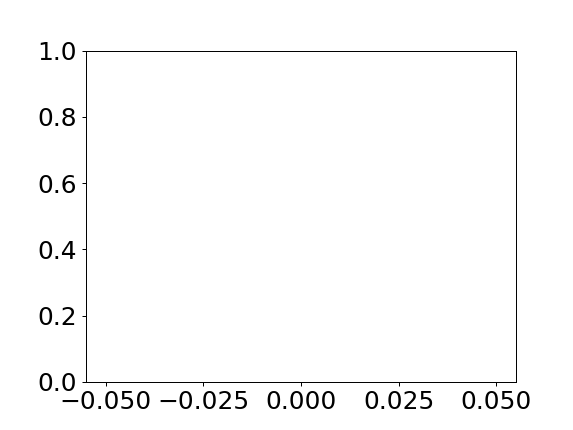

model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_1_epoch200.pth
(120, 20)


<IPython.core.display.Javascript object>


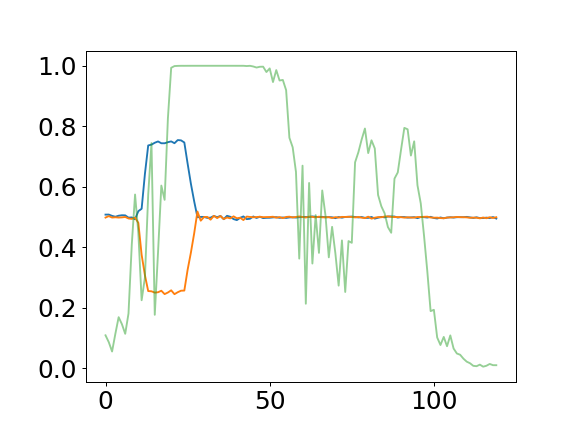

<IPython.core.display.Javascript object>


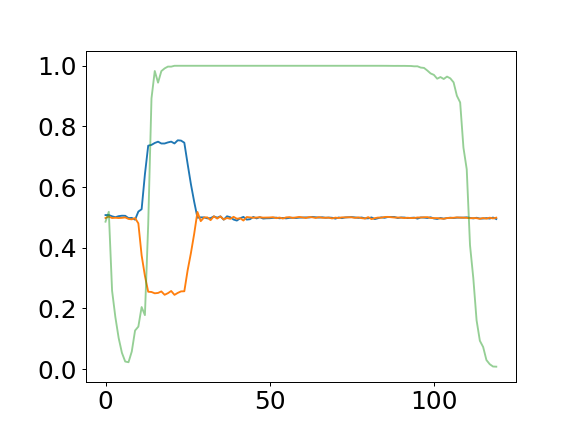

<IPython.core.display.Javascript object>


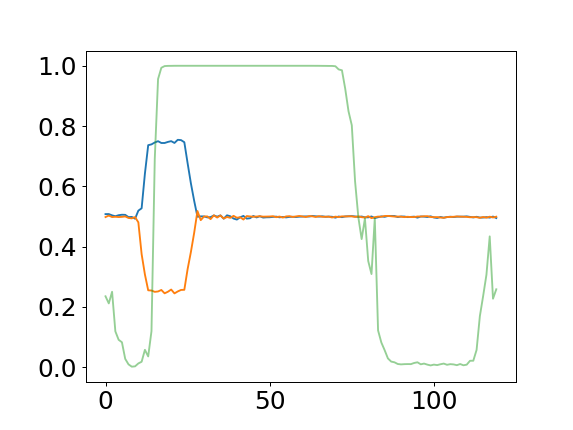

<IPython.core.display.Javascript object>


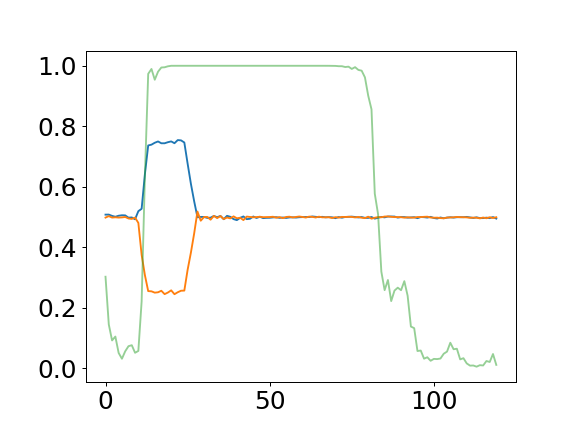

<IPython.core.display.Javascript object>


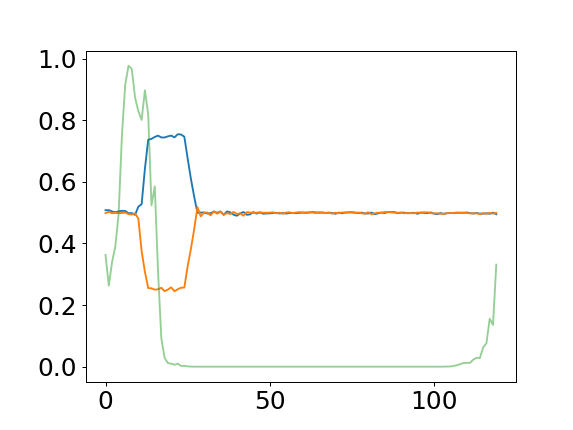

<IPython.core.display.Javascript object>


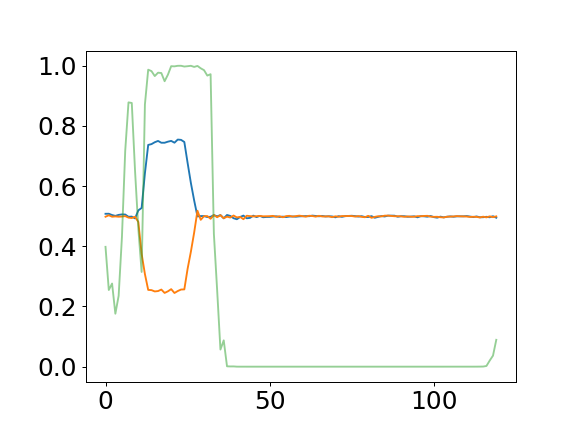

<IPython.core.display.Javascript object>


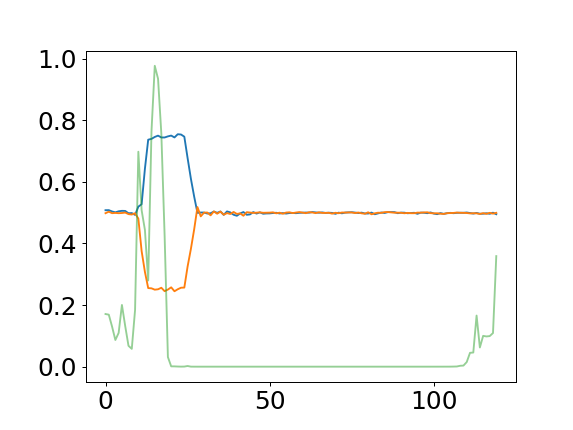

<IPython.core.display.Javascript object>


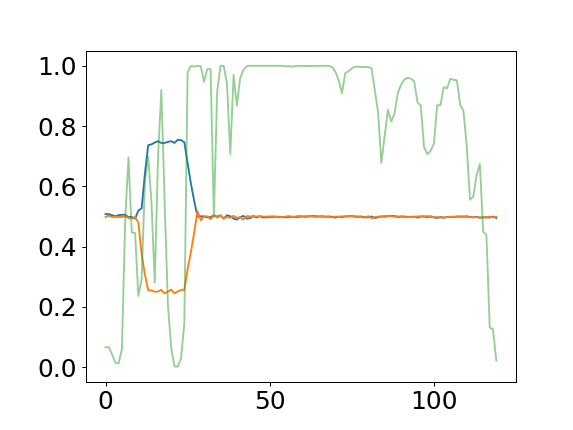

<IPython.core.display.Javascript object>


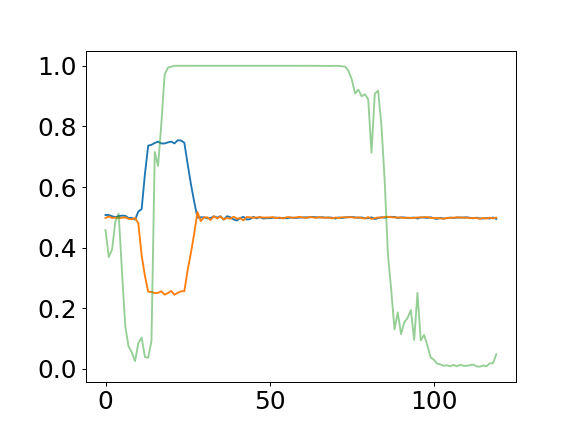

<IPython.core.display.Javascript object>


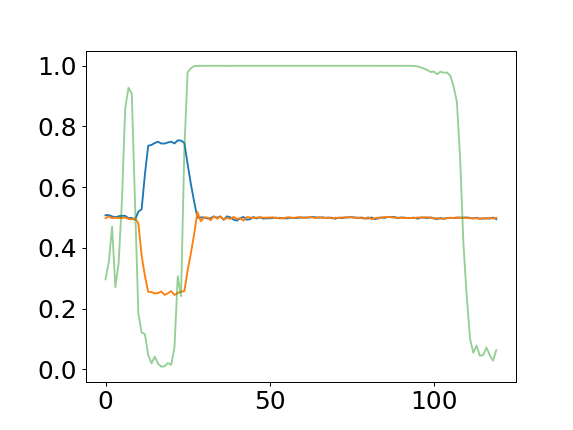

<IPython.core.display.Javascript object>


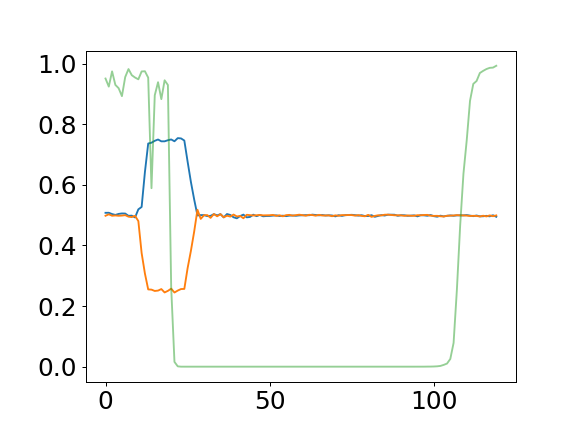

<IPython.core.display.Javascript object>


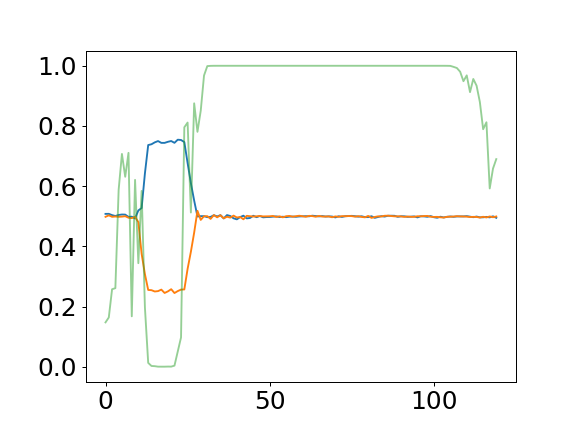

<IPython.core.display.Javascript object>


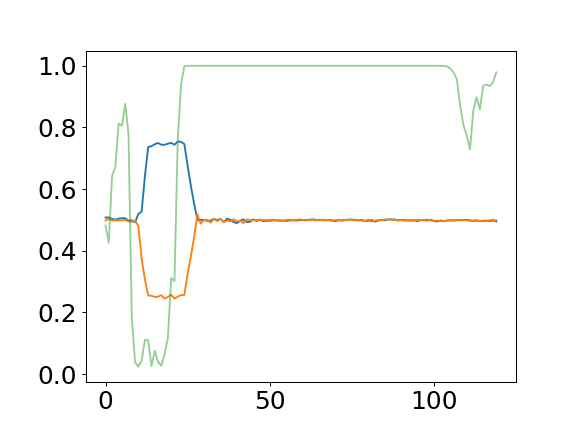

<IPython.core.display.Javascript object>


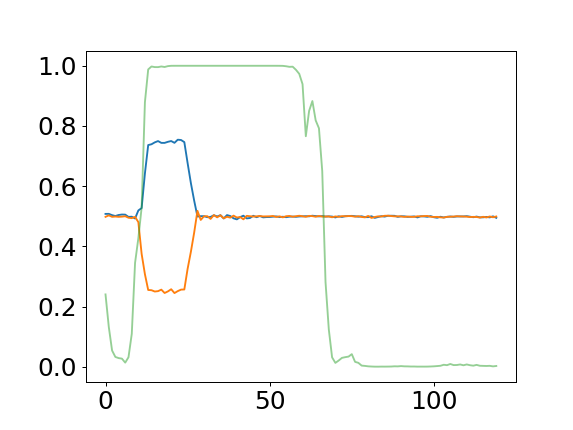

<IPython.core.display.Javascript object>


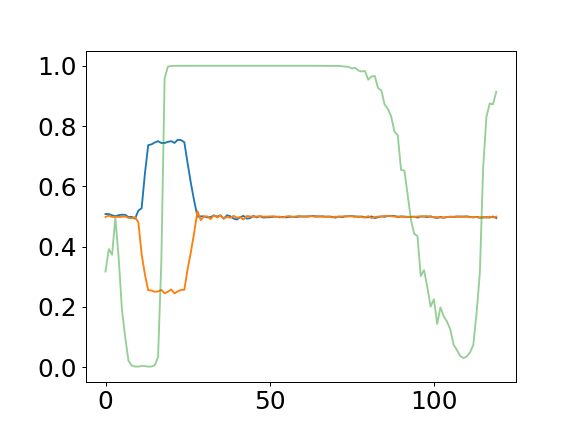

<IPython.core.display.Javascript object>


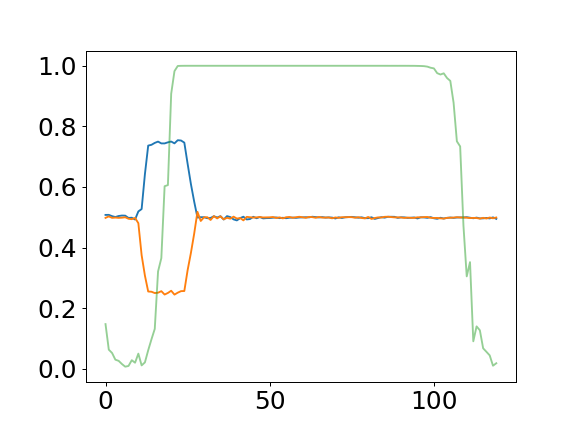

<IPython.core.display.Javascript object>


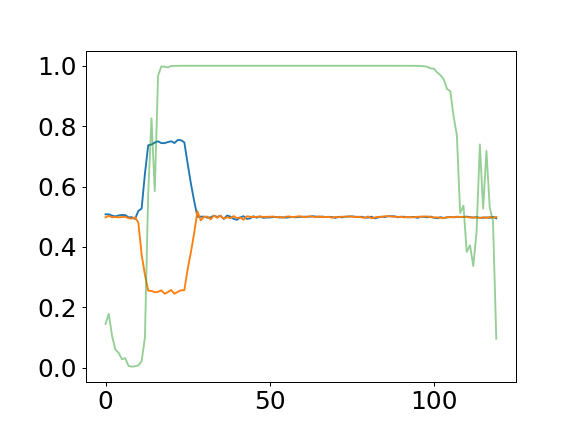

<IPython.core.display.Javascript object>


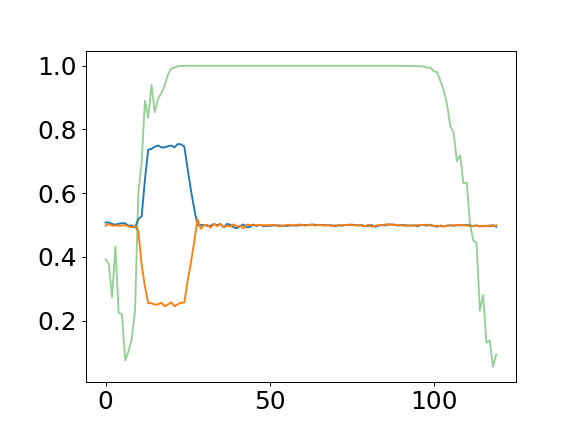

<IPython.core.display.Javascript object>


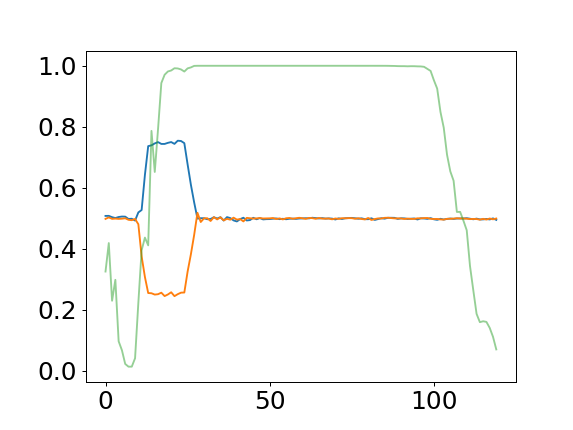

/tmp/ipykernel_2923202/1349809671.py:878: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


<IPython.core.display.Javascript object>


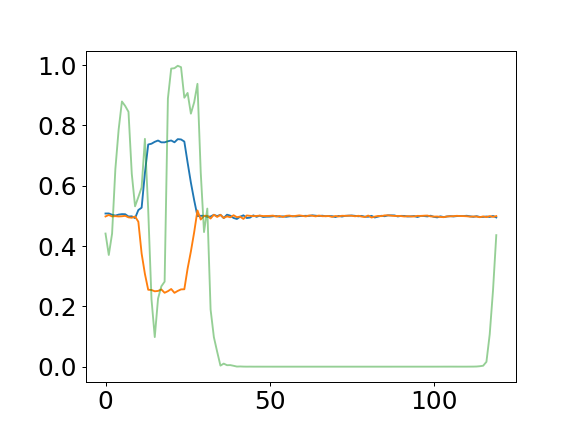

0.5864438283287892 0.48372221737687376 0.6764839019715039
2.439637380872442
(0.39369608019768065, 0.42005360900312105, 0, 1.0000000000000002)
0 0
dist:0.40687484460040085


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


In [473]:
##########    Test for mixture weight!!!!!!!!!!!!!   #########################
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import time
import math
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import sklearn 
import nolds
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D
from scipy.special import expit
import pandas as pd
import glob
import scipy

%matplotlib notebook

def Culc_gate(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = torch.cat([hiddens[1][0][0],hiddens[2][0]])
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]

def Culc_gate_uniPFC(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = hiddens[1][0][0]
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]

def Culc_gate_uniHPC(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = torch.cat([hiddens[1][0][0],hiddens[2][0]])
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]
    
    

def MakeAnimation(data_x,data_y,traj_x,traj_y, data_limit):
    fig, ax = plt.subplots()
    ims = []
    for t in range(traj_x.shape[0]):
        if t < data_limit:
            traj = ax.plot(data_x[:t], data_y[:t], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
#         else:
#             traj = ax.plot(data_x[:data_limit], data_y[:data_limit], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or", data_x[data_limit-1:t], data_y[data_limit-1:t], "--b")
        else:
            traj = ax.plot(traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
#             traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=30)    
    ani.save('anim_v4_2_1_r.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_data(data_x,data_y, data_limit):
    fig, ax = plt.subplots()
    ax.set_xlim(0.2,0.8)
    ax.set_ylim(-0.05,0.8)
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=30)    
    ani.save('anim_Re_0.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_attracter(data_x,data_y):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob",)
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=10)    
    ani.save('anim_attracter2.gif', writer='pillow')
    plt.show()
    
    return 0


    
def MakeAnimation_img(data,module):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data.shape[0]):
        img = ax.imshow(data[t].reshape(1,data.shape[1]))
        title = ax.text(0.5, 1.01, module+' time={}'.format(t),
             ha='center', va='bottom',
             transform=ax.transAxes, fontsize='large')
        ims.append([img,title])
    ani = animation.ArtistAnimation(fig, ims)    
    ani.save('anim_fire_'+module+'_.gif', writer='pillow')
    plt.show()
    
    return 0

def mkOwnDataSet(data_size, filename, data_length=100, freq=60., noise=0.005):
    
    x = np.loadtxt(str(filename+"_r.csv"),delimiter=',')
    y = np.loadtxt(str(filename+"_l.csv"),delimiter=',')
    train_x = []
    train_y = []
    
    for offset in range(data_size):
        train_x.append([[x[i][0] + np.random.normal(loc=0.0, scale=noise),x[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,x.shape[0],round(x.shape[0]/data_length))])
        train_y.append([[y[i][0] + np.random.normal(loc=0.0, scale=noise),y[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,y.shape[0],round(y.shape[0]/data_length))])
    return train_x, train_y


def mkOwnRandomBatch(train_x, train_t, batch_size=10):
    """
    train_x, train_tを受け取ってbatch_x, batch_tを返す
    """
    batch_x = []
    for _ in range(batch_size):
        idx = np.random.randint(0, len(train_x) - batch_size)
        batch_x.append(train_x[idx])
    return torch.tensor(batch_x).transpose(0,1)

def make_Ttraj(direction):
    traj_x = np.array([])
    traj_y = np.array([])
    straight_x = np.ones(5)*0.5
    if direction == 1:
        branch1_x = np.linspace(0.5, 0.75, 5)
        branch2_x = np.linspace(0.75, 0.5, 5)
    elif direction == 2:
        branch1_x = np.linspace(0.5, 0.25, 5)
        branch2_x = np.linspace(0.25, 0.5, 5)        
    backstraight_x = np.ones(5)*0.5

    straight_y = np.linspace(0, 0.5, 5)
    branch1_y = np.linspace(0.5, 0.5, 5)
    branch2_y = np.linspace(0.5, 0.5, 5)
    backstraight_y = np.linspace(0.5 , 0, 5)
    
    traj_x = np.append(traj_x, [straight_x,branch1_x,branch2_x,backstraight_x])
    traj_y = np.append(traj_y, [straight_y,branch1_y,branch2_y,backstraight_y])
    traj = np.concatenate([[traj_x],[traj_y]],axis=0).T
    return traj

def make_Htraj(direction1, direction2):
    traj_x = np.array([])
    traj_y = np.array([])
    straight_x = np.ones(10)*0.5
    if direction1 == 1:
        branch1_x = np.linspace(0.5, 0.75, 5)
        branch2_x = np.linspace(0.75, 0.75, 5)
        branch3_x = np.linspace(0.75, 0.75, 5)
        branch4_x = np.linspace(0.75, 0.5, 5)
    elif direction1 == 2:
        branch1_x = np.linspace(0.5, 0.25, 5)
        branch2_x = np.linspace(0.25, 0.25, 5)   
        branch3_x = np.linspace(0.25, 0.25, 5)  
        branch4_x = np.linspace(0.25, 0.5, 5)       
    backstraight_x = np.ones(10)*0.5

    straight_y = np.linspace(0, 0.5, 10)
    branch1_y = np.linspace(0.5, 0.5, 5)
    if direction2 == 1:
        branch2_y = np.linspace(0.5, 0.25, 5)
        branch3_y = np.linspace(0.25, 0.5, 5)
    elif direction2 == 2:
        branch2_y = np.linspace(0.5, 0.75, 5)
        branch3_y = np.linspace(0.75, 0.5, 5)
    branch4_y = np.linspace(0.5, 0.5, 5)
    backstraight_y = np.linspace(0.5 , 0, 10)
    
    traj_x = np.append(traj_x, straight_x)
    traj_x = np.append(traj_x, [branch1_x,branch2_x,branch3_x,branch4_x])
    traj_x = np.append(traj_x, backstraight_x)
    traj_y = np.append(traj_y, straight_y)
    traj_y = np.append(traj_y, [branch1_y,branch2_y,branch3_y,branch4_y])
    traj_y = np.append(traj_y, backstraight_y)
    traj = np.concatenate([[traj_x],[traj_y]],axis=0).T
    return traj


def make_traj(delay_length):
    freq=60
    noise=0.005
    data_length = 40
    
    # x = np.loadtxt("right1.csv",delimiter=',')
    x_1 = make_Htraj(1,1)
    x_2 = make_Htraj(1,2)
    # y = np.loadtxt("left1.csv",delimiter=',')
    y_1 = make_Htraj(2,1)
    y_2 = make_Htraj(2,2)
    z = np.loadtxt("stay1.csv",delimiter=',')
    data_list = []

    ###  ver1  ###
    orders = []
    order  = np.array([1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    orders.append(order) 
    order  = np.array([2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    orders.append(order) 
    order  = np.array([3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    orders.append(order) 
    order  = np.array([4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    orders.append(order) 
    
#     ###  ver2  ###
#     orders = []
#     order  = np.array([1])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [2])
#     orders.append(order) 
#     order  = np.array([2])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [3])
#     orders.append(order) 
#     order  = np.array([3])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [4])
#     orders.append(order) 
#     order  = np.array([4])
#     order  = np.append(order,np.zeros(delay_length))
#     order = np.append(order, [1])
#     orders.append(order) 

    ###  ver1's test  ###
    orders = []
    order  = np.array([1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    
    # order = [1,0,0,0,2]
    # order = [2,0,0,1,0,0,0,2,0,0,1]
    for order in orders:
        data = np.array([[0,0]])
        for idx in order:
            if idx == 1:
                target = x_1
            elif idx == 2:
                target = x_2
            elif idx == 3:
                target = y_1
            elif idx == 4:
                target = y_2
            elif idx == 0:
                target = np.array([[z[i][0],z[i][1]] for i in np.random.choice(z.shape[0], data_length)])
#                 target = np.array([[0.5,0] for i in np.random.choice(z.shape[0], data_length)])
            if idx != 0:
                target += np.random.normal(loc=0.0, scale=noise, size=target.shape)
    
            data = np.append(data,target,axis=0)
        data_list.append(data[1:])
    return data_list[0],data_list[1],data_list[2],data_list[3]

def mkOwnDataSet_auto(data_size, delay_length, freq=60., noise=0.01):
   
    x1,x2,y1,y2 = make_traj(delay_length)
    train_x1 = []
    train_x2 = []
    train_y1 = []
    train_y2 = []
    
    for offset in range(data_size):
        train_x1.append([[x1[i][0] + np.random.normal(loc=0.0, scale=noise),x1[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(x1.shape[0])])
        train_x2.append([[x2[i][0] + np.random.normal(loc=0.0, scale=noise),x2[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(x2.shape[0])])

        train_y1.append([[y1[i][0] + np.random.normal(loc=0.0, scale=noise),y1[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(y1.shape[0])])
        train_y2.append([[y2[i][0] + np.random.normal(loc=0.0, scale=noise),y2[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(y2.shape[0])])

    return train_x1, train_x2, train_y1, train_y2

def plot_distance_bet2traj(traj1,traj2,linelist):
    traj1 = np.array(traj1)
    traj2 = np.array(traj2)
    result = []
    for i in range(traj1.shape[0]):
        result.append(np.linalg.norm(traj1[i]-traj2[i]))
    plt.figure()
    plt.plot(result)
    
    plt.vlines(linelist,np.min(result),np.max(result))
    
    return result

def distance_bet2traj(traj1,traj2):
    traj1 = np.array(traj1)
    traj2 = np.array(traj2)
    result = []
    for i in range(traj1.shape[0]):
        result.append(np.linalg.norm(traj1[i]-traj2[i]))
    return result

def plot_activity_bet2traj(traj1,traj2,linelist):
    traj1 = np.array(traj1)
    traj2 = np.array(traj2)
    result = []
    threshold = 0.5
    for i in range(traj1.shape[0]):
        result.append(np.abs(traj1[i]-traj2[i]))
        
    plt.figure()
    for i,data in enumerate(np.array(result).T):
        if np.any(data[20:105]>threshold):
            print(i)
            plt.plot(data)
    
    return result

def search_delay(traj):
    linelist = np.array([])
    flag = False
    for i in range(traj.shape[0]):
        if traj[i,1] > 0.45 and flag == False:
            linelist = np.append(linelist,i)
            flag = True
        if traj[i,1] < 0.45 and flag == True:
            linelist = np.append(linelist,i)
            flag = False
    return linelist

def pick_delay(traj,states):
    pointlist = np.array([])
    flag = False
    threshold = 0.2
    for i in range(traj.shape[0]):
        if i < 5:
            continue
        if traj[i,1] < threshold and flag == False:
            pointlist = np.append(pointlist,i)
            flag = True
        if traj[i,1] > threshold and flag == True:
            pointlist = np.append(pointlist,i)
            flag = False
    states_list = []
    start = 0
    for i,k in enumerate(pointlist):
        end = int(k)
        if i % 2 != 0:
            states_list.append(states[start:end])
        start = int(k)
    states_list.append(traj[start:])
    return states_list

def pick_traj(traj,states):
    pointlist = np.array([])
    flag = False
    threshold = 0.2
    for i in range(traj.shape[0]):
        if i < 5:
            continue
        if traj[i,1] < threshold and flag == False:
            pointlist = np.append(pointlist,i)
            flag = True
        if traj[i,1] > threshold and flag == True:
            pointlist = np.append(pointlist,i)
            flag = False
    states_list = []
    start = 0
    for i,k in enumerate(pointlist):
        end = int(k)
        if i % 2 != 0:
            states_list.append(states[start:end])
            start = int(k)
    states_list.append(traj[start:])
    return states_list

def match_length(states_list):
    min_length = 1000
    result = []
    for state in states_list:
        min_length = np.min((min_length, len(state)))
    for state in states_list:
        result.append(state[-min_length:])
        
    return result

def vec_var(datas):
    datas = np.array(datas)
    average = np.average(datas,axis=0)
    result = 0
    for data in datas:
        result += np.linalg.norm(data-average)
    result /= datas.shape[0]
    return result
    
def lyapunov_exp(data):
    result = np.mean(np.log(np.abs(np.diff(data))))
    return result

class MyLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        nn.init.sparse_(self.PFC.weight_ih.data,1)
        nn.init.sparse_(self.HPC.weight_ih.data,1)
        nn.init.sparse_(self.PFC.weight_hh.data,1)
        nn.init.sparse_(self.HPC.weight_hh.data,1)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2][0]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    
    
class MyLSTM_feedforward(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse=5):
        super(MyLSTM_feedforward, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.Linear(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input)
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]
    

class MyLSTM_feedforward_Thalamus2(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse=5):
        super(MyLSTM_feedforward_Thalamus2, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.hidden_size_THinh = hidden_size
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.Linear(self.hidden_size_PFC+self.hidden_size_HPC+self.hidden_size_THinh, self.hidden_size_Re)
        self.THinh = nn.Linear(self.hidden_size_Re, self.hidden_size_THinh)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        self.ReLU = nn.ReLU()
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0],hiddens[3]],dim=1)
        Re_hidden = self.Re(Re_input)
        THinh_input = hiddens[2]
        THinh_hidden = self.ReLU(self.THinh(THinh_input))
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden,THinh_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        THinh_hidden = self.ReLU(torch.rand(self.batch_size, self.hidden_size_THinh))
        return [PFC_hidden,HPC_hidden,Re_hidden,THinh_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        THinh_hidden = self.ReLU(torch.rand(self.batch_size, self.hidden_size_THinh)*const)
        return [PFC_hidden,HPC_hidden,Re_hidden,THinh_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re,self.hidden_size_THinh]

    
    

class MyLSTM_RNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse=5):
        super(MyLSTM_RNN, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        input = input.float()
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.1
        var = 0.1
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_test(self):
        const = 0.2
        var = 0.2
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
#         HPC_hidden = [torch.ones(self.batch_size, self.hidden_size_HPC)*const, torch.ones(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
#         PFC_hidden = [torch.ones(self.batch_size, self.hidden_size_PFC)*const, torch.ones(self.batch_size, self.hidden_size_PFC)*const]
#         Re_hidden = torch.ones(self.batch_size, self.hidden_size_Re)*const
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*var
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0
        v = 0.1
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*v
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def noiseHidden_select(self, hiddens):
        c = 0
        v = 0.01
        index = np.array([1,2,8,9,17])
        HPC_hidden = torch.zeros(self.batch_size, self.hidden_size_HPC)
        HPC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.zeros(self.batch_size, self.hidden_size_PFC)
        PFC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size_Re)*c
        Re_hidden[:,index] += torch.randn(self.batch_size, index.size)*v
#         Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*v
#         Re_hidden[:,index] = torch.zeros(self.batch_size, index.size)*c
#         Re_hidden = torch.zeros(self.batch_size, self.hidden_size_Re)*c
#         Re_hidden[:,index] += hiddens[2][:,index]*v
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def noiseHidden_dis(self, hiddens, statr, statl):
        c = 0
        v =-0.1
        index = np.array([1,2,8,9,17])
        HPC_hidden = torch.zeros(self.batch_size, self.hidden_size_HPC)
        HPC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.zeros(self.batch_size, self.hidden_size_PFC)
        PFC_hidden[:,index] += torch.randn(self.batch_size, index.size)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*0.0
        Re_hidden += (-statr+statl)*v
#         Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*v
#         Re_hidden[:,index] = torch.zeros(self.batch_size, index.size)*c
#         Re_hidden = torch.zeros(self.batch_size, self.hidden_size_Re)*c
#         Re_hidden[:,index] += hiddens[2][:,index]*v
        hiddens[2].add_(Re_hidden)
        return hiddens


def moving_average(data):
    y = np.ones(5)/5
    mean_seq = np.convolve(data, y)
    return mean_seq    


def main(model):
    training_size = 100
    test_size = 1000
    epochs_num = 10
    hidden_size = 20
    batch_size = 10
    data_length = 100
    inputsize = 2
    outputsize = 2
    delay_length = 2
    
    model_path = model
    
    colors = ['C0','C1','C2','C3','C4','C5','C6','C7','C8','C9']
    
#     delay_length = np.random.randint(1, 3)
    delay_length = 2
    train_x1,train_x2,train_y1,train_y2 = mkOwnDataSet_auto(training_size,delay_length)

#     rnn = MyLSTM_comp(inputsize, hidden_size, outputsize, batch_size)
    rnn = MyLSTM_RNN(inputsize, hidden_size, outputsize, batch_size)
#     rnn = MyLSTM_RNN_uniHPC(inputsize, hidden_size, outputsize, batch_size)
#     rnn = MyMTRNN2(inputsize, hidden_size, outputsize, batch_size)
#     rnn = MyLSTM_feedforward(inputsize, hidden_size, outputsize, batch_size)
#     rnn = MyLSTM_feedforward_Thalamus2(inputsize, hidden_size, outputsize, batch_size)

    rnn.load_state_dict(torch.load(model_path))
    
    
    pattern = 1
    if  pattern == 1:
        data = mkOwnRandomBatch(train_x1, train_x1, batch_size).float()
    elif pattern == 2:
        data = mkOwnRandomBatch(train_x2, train_x2, batch_size).float()
    elif pattern == 3:
        data = mkOwnRandomBatch(train_y1, train_y1, batch_size).float()
    else:
        data = mkOwnRandomBatch(train_y2, train_y2, batch_size).float()
    
    params = []
    for p in rnn.parameters():
        params.append(p.data)
    
        
#     model_path = 'model/R20_131/ReModel_L2_interRNNrand_OUT1_131_s6_100_1_epoch125.pth'
    model_path = model
    rnn.load_state_dict(torch.load(model_path))
        
    for n, p in rnn.named_parameters():
            if n == "PFC.weight_ih":
                PFC_w_pre = torch.clone(p.data)
            if n == "HPC.weight_ih":
                HPC_w_pre = torch.clone(p.data)
            if n == "Re.weight_ih":
                Re_w_pre = torch.clone(p.data)
            if n == "Re.weight_hh":
                Re_inw = torch.clone(p.data)
            if n == "linear.weight":
                OUT_w_pre = torch.clone(p.data)
                   
    traj = []
    PFCstate = []
    HPCstate = []
    Restate = []
    Gate_states = []
    hidden = rnn.initHidden_rand()
    data_limit = 120
    est_length = 0
    init_point = torch.rand(10,2)*1
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
#             output,hidden = rnn(init_point,hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            Gate_states.append(Culc_gate(output,params,hidden))
#             Gate_states.append(Culc_gate_uniPFC(output,params,hidden))
#     for k in range(data.shape[0]*est_length):
#             output,hidden = rnn(output,hidden)
#             traj.append(output.tolist())
#             PFCstate.append(hidden[0][0].tolist())
#             HPCstate.append(hidden[1][0].tolist())
#             Restate.append(hidden[2][0].tolist())
#             Gate_states.append(Culc_gate(output,params,hidden))
    traj = torch.tensor(traj)
    traj = torch.squeeze(traj).numpy()
    
    pattern = 3
    if  pattern == 1:
        data = mkOwnRandomBatch(train_x1, train_x1, batch_size).float()
    elif pattern == 2:
        data = mkOwnRandomBatch(train_x2, train_x2, batch_size).float()
    elif pattern == 3:
        data = mkOwnRandomBatch(train_y1, train_y1, batch_size).float()
    else:
        data = mkOwnRandomBatch(train_y2, train_y2, batch_size).float()
    
    dividenum = int(np.array(PFCstate)[0:,0].shape[0]/2)
    traj_noise = []
    PFCstate_noise = []
    HPCstate_noise = []
    Restate_noise = []
    Gate_states_noise = []
    hidden = rnn.initHidden_rand()
#     data = mkOwnRandomBatch(train_y, batch_size)
#     init_point = torch.rand(10,2)*1
#     data_limit = 125
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
#             output,hidden = rnn(init_point,hidden)
            traj_noise.append(output.tolist())
            PFCstate_noise.append(hidden[0][0].tolist())
            HPCstate_noise.append(hidden[1][0].tolist())
            Restate_noise.append(hidden[2][0].tolist())
            Gate_states_noise.append(Culc_gate(output,params,hidden))
#     for k in range(data.shape[0]*est_length):
# #             hidden = rnn.noiseHidden_rand(hidden)
#             output,hidden = rnn(output,hidden) 
# #             hidden = rnn.noiseHidden_dis(hidden, np.array(Restate)[k+data_limit], np.array(Restate)[dividenum+k+data_limit])
# #             hidden = rnn.noiseHidden_rand(hidden)
#             traj_noise.append(output.tolist())
#             PFCstate_noise.append(hidden[0][0].tolist())
#             HPCstate_noise.append(hidden[1][0].tolist())
#             Restate_noise.append(hidden[2][0].tolist())
#             Gate_states_noise.append(Culc_gate(output,params,hidden))
    traj_noise = torch.tensor(traj_noise)
    traj_noise = torch.squeeze(traj_noise).numpy()

    
    print(np.array(PFCstate)[:,0].shape)
#     MakeAnimation(pltdata[:,0,0],pltdata[:,0,1], traj[:,0,0], traj[:,0,1], data_limit)
    #MakeAnimation_img(np.array(PFCstate)[:,0],"PFC")
    #MakeAnimation_img(np.array(HPCstate)[:,0],"HPC")


#     plt.figure()
#     plt.plot(traj[:,0,0],color=colors[-1])
#     plt.plot(traj_noise[:,0,0],color=colors[-2])


    PFC_corrlist = np.array([])
    HPC_corrlist = np.array([])
    cross_corrlist = np.array([])
    for i in range(20):
        plt.figure()
#         plt.ylim(-1,1)
        plt.plot(traj[:,0,0])
        plt.plot(traj_noise[:,0,0])
#         plt.plot(np.abs(traj[:,0,0]-traj_noise[:,0,0]))
    #         plt.plot(np.array(PFCstate_noise)[:400,0,17],alpha=0.5)
        for k in range(1):
#                 plt.plot(np.array(PFCstate)[:,k,i],alpha=0.5)
#                 plt.plot(np.array(PFCstate_noise)[:,k,i],alpha=0.5)
#                 plt.plot(np.abs(np.array(PFCstate)[:,k,i]-np.array(PFCstate_noise)[:,k,i]),alpha=0.5)
#                 plt.plot(np.array(HPCstate)[:,k,i],alpha=0.5)
#                 plt.plot(np.array(HPCstate_noise)[:,k,i],alpha=0.5)
#                 plt.plot(np.abs(np.array(HPCstate)[:,k,i]-np.array(HPCstate_noise)[:,k,i]),alpha=0.5)
    #             plt.plot(np.array(PFCstate)[:120,k,i],alpha=0.5)
    #             plt.plot(np.array(PFCstate)[120:240,k,i],alpha=0.5)
    #             plt.plot(np.array(PFCstate)[:120,k,i]-np.array(PFCstate)[120:240,k,i],alpha=0.5)
    #             plt.plot(np.array(PFCstate_noise)[:120,k,i],alpha=0.5)
    #             plt.plot(np.array(PFCstate_noise)[120:240,k,i],alpha=0.5)
    #             plt.plot(np.array(PFCstate_noise)[:120,k,i]-np.array(PFCstate_noise)[120:240,k,i],alpha=0.5)
#             plt.plot(np.array(Restate)[:,i],alpha=0.5)
#             plt.plot(np.array(Restate_noise)[:,i],alpha=0.5)
#             plt.plot(np.array(Restate)[:,i]-np.array(Restate_noise)[:,i],alpha=0.5)
#                 plt.plot(moving_average(np.array(Restate)[:,i]),alpha=0.5)
#                 plt.plot(moving_average(np.array(Restate_noise)[:,i]),alpha=0.5)
#                 plt.plot(moving_average(np.array(Restate)[:,i])-moving_average(np.array(Restate_noise)[:,i]),alpha=0.5)
#                 plt.plot(np.array(Gate_states)[:,0,20+i],alpha=0.5)
                plt.plot(np.array(Gate_states)[:,0,0+i],alpha=0.5)
#                 plt.plot(np.array(Gate_states)[:,1,20+i],alpha=0.5)
#                 plt.plot(np.array(Gate_states_noise)[:,0,20+i],alpha=0.5)
#                 plt.plot(np.array(Gate_states_noise)[:,1,20+i],alpha=0.5)
#                 plt.plot(np.array(np.array(Gate_states)[:,0,0+i]/np.array(Gate_states)[:,0,20+i]),alpha=0.5)
#                 plt.plot(np.log(np.array(Gate_states)[:,0,0+i]/np.array(Gate_states)[:,0,20+i]),alpha=0.5)
#                 plt.plot(np.log(np.array(Gate_states_noise)[:,0,0+i]/np.array(Gate_states_noise)[:,0,20+i]),alpha=0.5)
#                 print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(np.array(PFCstate)[:,k,i]-np.array(PFCstate_noise)[:,k,i]))[0,1])
#                 print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(np.array(HPCstate)[:,k,i]-np.array(HPCstate_noise)[:,k,i]))[0,1])
#                 print(np.corrcoef(np.abs(np.array(PFCstate)[:,k,i]-np.array(PFCstate_noise)[:,k,i]),np.abs(np.array(HPCstate)[:,k,i]-np.array(HPCstate_noise)[:,k,i])))
                cross_corrlist = np.append(cross_corrlist,np.corrcoef(np.abs(np.array(PFCstate)[:,k,i]-np.array(PFCstate_noise)[:,k,i]),np.abs(np.array(HPCstate)[:,k,i]-np.array(HPCstate_noise)[:,k,i])))
                PFC_corrlist = np.append(PFC_corrlist,np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(np.array(PFCstate)[:,k,i]-np.array(PFCstate_noise)[:,k,i]))[0,1])
                HPC_corrlist = np.append(HPC_corrlist,np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(np.array(HPCstate)[:,k,i]-np.array(HPCstate_noise)[:,k,i]))[0,1])
#         plt.title("neuron#"+str(i+1))
    print(np.mean(PFC_corrlist),np.mean(HPC_corrlist),np.mean(cross_corrlist))
    
#     pca = PCA()
# #     dfs = np.array(PFCstate)[:,0]
#     dfs = np.concatenate((np.array(PFCstate)[:,0],np.array(PFCstate_noise)[:,0]),axis=0)
# #     dfs = np.concatenate((np.array(HPCstate)[:,0],np.array(HPCstate_noise)[:,0]),axis=0)
#     print(dfs.shape)
#     pca.fit(dfs)
#     feature = pca.transform(dfs)
#     print("PFC correlation")
# #     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,0]-feature[100:,0])))
# #     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,1]-feature[100:,1])))
# #     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,2]-feature[100:,2])))
#     PFC_a = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:data_limit,0]-feature[data_limit:,0]))[0,1]
#     PFC_b = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:data_limit,1]-feature[data_limit:,1]))[0,1]
#     PFC_c = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:data_limit,2]-feature[data_limit:,2]))[0,1]
# #     PFC_a = np.corrcoef(np.abs(traj[:,0,1]-traj_noise[:,0,1]),np.abs(feature[:data_limit,0]-feature[data_limit:,0]))[0,1]
# #     PFC_b = np.corrcoef(np.abs(traj[:,0,1]-traj_noise[:,0,1]),np.abs(feature[:data_limit,1]-feature[data_limit:,1]))[0,1]
# #     PFC_c = np.corrcoef(np.abs(traj[:,0,1]-traj_noise[:,0,1]),np.abs(feature[:data_limit,2]-feature[data_limit:,2]))[0,1]
# #     PFC_a = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:data_limit,0]))[0,1]
# #     PFC_b = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:data_limit,1]))[0,1]
# #     PFC_c = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:data_limit,2]))[0,1]
#     PFC_diff = np.sqrt(np.power(feature[:data_limit,0]-feature[data_limit:,0],2) + np.power(feature[:data_limit,1]-feature[data_limit:,1],2) + np.power(feature[:data_limit,2]-feature[data_limit:,2],2))
#     PFC_d = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),PFC_diff)[0,1]
#     PFC_diff2 = np.sum(np.abs(np.array(PFCstate)[:,0]-np.array(PFCstate_noise)[:,0]),axis=1)
#     PFC_e = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),PFC_diff2)[0,1]
    
# #     plt.figure()
# #     plt.plot(np.abs(feature[:100,0]-feature[100:,0]))
# #     plt.plot(np.abs(feature[:100,1]-feature[100:,1]))
# #     plt.plot(np.abs(feature[:100,2]-feature[100:,2]))
# #     plt.show()

# #     plt.figure()
# #     plt.plot(np.abs(feature[:100,0]),color=colors[-3])
# #     plt.plot(np.abs(feature[100:,0]),color=colors[-4])
# #     plt.show()

# #     print(pd.DataFrame(feature, columns=["PC{}".format(x + 1) for x in range(dfs.shape[1])]).head())
#     print(pd.DataFrame(pca.explained_variance_ratio_, index=["PC{}".format(x + 1) for x in range(dfs.shape[1])]))

    
#     pca = PCA()
# #     dfs = np.array(PFCstate)[:,0]
# #     dfs = np.concatenate((np.array(PFCstate)[:,0],np.array(PFCstate_noise)[:,0]),axis=0)
#     dfs = np.concatenate((np.array(HPCstate)[:,0],np.array(HPCstate_noise)[:,0]),axis=0)
#     print(dfs.shape)
#     pca.fit(dfs)
#     feature = pca.transform(dfs)
#     print("HPC correlation")
# #     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,0]-feature[100:,0])))
# #     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,1]-feature[100:,1])))
# #     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,2]-feature[100:,2])))
#     HPC_a = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:data_limit,0]-feature[data_limit:,0]))[0,1]
#     HPC_b = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:data_limit,1]-feature[data_limit:,1]))[0,1]
#     HPC_c = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:data_limit,2]-feature[data_limit:,2]))[0,1]
# #     HPC_a = np.corrcoef(np.abs(traj[:,0,1]-traj_noise[:,0,1]),np.abs(feature[:data_limit,0]-feature[data_limit:,0]))[0,1]
# #     HPC_b = np.corrcoef(np.abs(traj[:,0,1]-traj_noise[:,0,1]),np.abs(feature[:data_limit,1]-feature[data_limit:,1]))[0,1]
# #     HPC_c = np.corrcoef(np.abs(traj[:,0,1]-traj_noise[:,0,1]),np.abs(feature[:data_limit,2]-feature[data_limit:,2]))[0,1]
#     HPC_diff = np.sqrt(np.power(feature[:data_limit,0]-feature[data_limit:,0],2) + np.power(feature[:data_limit,1]-feature[data_limit:,1],2) + np.power(feature[:data_limit,2]-feature[data_limit:,2],2))
#     HPC_d = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),HPC_diff)[0,1]
#     HPC_diff2 = np.sum(np.abs(np.array(HPCstate)[:,0]-np.array(HPCstate_noise)[:,0]),axis=1)
#     HPC_e = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),HPC_diff2)[0,1]
#     print(HPC_e)
    
# #     plt.figure()
# #     plt.plot(np.abs(feature[:100,3]-feature[100:,3]))
# #     plt.plot(np.abs(feature[:100,4]-feature[100:,4]))
# #     plt.plot(np.abs(feature[:100,5]-feature[100:,5]))
# #     plt.show()
    
# #     plt.figure()
# #     plt.plot(np.abs(feature[:100,0]),color=colors[-3])
# #     plt.plot(np.abs(feature[100:,0]),color=colors[-4])
# #     plt.show()

# #     print(pd.DataFrame(feature, columns=["PC{}".format(x + 1) for x in range(dfs.shape[1])]).head())
# #     print(pd.DataFrame(pca.explained_variance_ratio_, index=["PC{}".format(x + 1) for x in range(dfs.shape[1])]))


#     pca = PCA()
# #     dfs = np.array(PFCstate)[:,0]
# #     dfs = np.concatenate((np.array(PFCstate)[:,0],np.array(PFCstate_noise)[:,0]),axis=0)
#     dfs = np.concatenate((np.array(Restate)[:],np.array(Restate_noise)[:]),axis=0)
#     print(dfs.shape)
#     pca.fit(dfs)
#     feature = pca.transform(dfs)
#     print("Re correlation")
# #     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,0]-feature[100:,0])))
# #     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,1]-feature[100:,1])))
# #     print(np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,2]-feature[100:,2])))
# #     Re_a = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,0]-feature[100:,0]))[0,1]
# #     Re_b = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,1]-feature[100:,1]))[0,1]
# #     Re_c = np.corrcoef(np.abs(traj[:,0,0]-traj_noise[:,0,0]),np.abs(feature[:100,2]-feature[100:,2]))[0,1]
    
# #     plt.figure()
# # #     plt.plot(np.abs(feature[:100,0]-feature[100:,0]))
# # #     plt.plot(np.abs(feature[:100,1]-feature[100:,1]))
# # #     plt.plot(np.abs(feature[:100,2]-feature[100:,2]))
# # #     plt.plot(np.abs(moving_average(feature[:100,0])-moving_average(feature[100:,0])))
# # #     plt.plot(np.abs(moving_average(feature[:100,1])-moving_average(feature[100:,1])))
# # #     plt.plot(np.abs(moving_average(feature[:100,2])-moving_average(feature[100:,2])))
# #     plt.plot(np.abs(feature[:100,0]),color=colors[-3])
# #     plt.plot(np.abs(feature[100:,0]),color=colors[-4])
# #     plt.show()


####################### Fluc(frac) and coherence part #############################


    pca = PCA()
#     dfs = np.array(HPCstate)[40:,0]
    dfs = np.array(Restate)
    pca.fit(dfs)
    feature = pca.transform(dfs)
    
    delaysB = pick_delay(traj[:,0], feature[:])

    PCAnum = 0
    data = feature[:,PCAnum]
    movingA = moving_average(data)
    fracA = data - movingA[2:-2]
    print(math.dist(data,movingA[2:-2]))
    frac_amp = math.dist(data,movingA[2:-2])
    
#     frac_amp = 0
#     for i in range(20):
#         data = np.array(HPCstate)[:,0,i]
#         movingA = moving_average(data)
#         fracA = data - movingA[2:-2]
#         frac_amp += math.dist(data,movingA[2:-2])
#     frac_amp = frac_amp/20
    
#     fig = plt.figure()
#     fig1 = fig.add_subplot(111)
#     fig1.hist(np.array(Gate_states)[:,0,0:20].ravel(),bins=30,range=(-0.1,1.1),alpha=0.5,density=True)
# #     fig1.hist(np.array(Gate_states)[:,1,0:20].ravel(),bins=30,range=(-0.1,1.1),alpha=0.5,density=True)
#     fig1.hist(np.array(Gate_states)[:,0,20:40].ravel(),bins=30,range=(-0.1,1.1),alpha=0.5,density=True)
# #     fig1.hist(np.array(Gate_states)[:,1,20:40].ravel(),bins=30,range=(-0.1,1.1),alpha=0.5,density=True)
#     plt.show()

#     hist = np.histogram(np.array(Gate_states)[:,0,0:20].ravel(),bins=30,range=(-0.1,1.1),density=True)
#     data = np.array([np.clip(hist[1][3:-2],0,1),hist[0][2:-2]]).T
    data = np.array(Gate_states)[:,0,0:20].ravel()
    try:
        beta_PFC = scipy.stats.beta.fit(data, floc=0)
        print(beta_PFC)
        beta_param = np.min([np.average([beta_PFC[0],beta_PFC[1]]),10])
    except Exception:
        print("Error: maybe takes negative a or b")
        beta_param = 0.5
        
#     data = np.array(Gate_states)[:,1,0:20].ravel()
#     try:
#         beta_HPC = scipy.stats.beta.fit(data)
#         print(beta_HPC)
#     except Exception:
#         print("Error: maybe takes negative a or b")
        

#     pca = PCA()
# #     dfs = np.array(HPCstate)[:,0]
#     dfs = np.array(Restate)
#     pca.fit(dfs)
#     Refeature = pca.transform(dfs)

#     shift = 2
#     seglen = 60
        
#     coherence_diff_list = []
#     for i in range(20):
#         for k in range(1):
#             data = np.array(Refeature)[:,0]-moving_average(np.array(Refeature)[:,0])[2:-2]
#             freqs,times,sx1 = signal.stft(data,fs=1,window="boxcar",nperseg=seglen,noverlap=seglen-shift,detrend=False,boundary=None)
#             data = np.array(PFCstate)[:,k,i]-moving_average(np.array(PFCstate)[2:-2,k,i])[:]
#             freqs,times,sx2 = signal.stft(data*1,fs=1,window="boxcar",nperseg=seglen,noverlap=seglen-shift,detrend=False,boundary=None)
#             data = np.array(HPCstate)[:,k,i]-moving_average(np.array(HPCstate)[2:-2,k,i])[:]
#             freqs,times,sx3 = signal.stft(data,fs=1,window="boxcar",nperseg=seglen,noverlap=seglen-shift,detrend=False,boundary=None)
            
#             xsp = sx1*np.conjugate(sx2)
#             coherence = (np.abs(xsp)**2)/(np.abs(sx1)*np.abs(sx2))
# #             plt.figure()
# #             plt.pcolormesh(times,freqs,coherence)
# #             plt.title("Re-PFC neuron#"+str(i+1))
# #             print(np.max(coherence),np.min(coherence))
            
# #             plt.figure()
# #             plt.plot(times, np.sum(coherence.T,axis=1))
            
# #             xsp = sx1*np.conjugate(sx3)
# #             coherence = (np.abs(xsp)**2)/(np.abs(sx1)*np.abs(sx3))            
# #             plt.figure()
# #             plt.pcolormesh(times,freqs,coherence)
# #             plt.title("Re-HPC neuron#"+str(i+1))
# #             print(np.max(coherence),np.min(coherence))

            
# #             xsp = sx2*np.conjugate(sx3)
# #             coherence = (np.abs(xsp)**2)/(np.abs(sx2)*np.abs(sx3))
# #             plt.figure()
# #             plt.pcolormesh(times,freqs,coherence)
# #             plt.title("PFC-HPC neuron#"+str(i+1))
            
# #             degree = np.degrees(np.angle(xsp))
# #             print(degree.shape)
# #             plt.figure()
# #             plt.plot(degree)

# #             plt.figure()
# #             plt.plot(times, np.sum(coherence.T,axis=1))
#             coherence_diff_list.append(np.max(np.sum(coherence.T,axis=1))-np.min(np.sum(coherence.T,axis=1)))
    
    
#     return np.mean([PFC_a,PFC_b,PFC_c]),np.mean([HPC_a,HPC_b,HPC_c]),np.max([PFC_a,PFC_b,PFC_c]),np.max([HPC_a,HPC_b,HPC_c]),frac_amp
#     return np.mean([PFC_a,PFC_b,PFC_c]),np.mean([HPC_a,HPC_b,HPC_c]),np.max([PFC_d]),HPC_d
#     return np.mean([PFC_a,PFC_b,PFC_c]),np.mean([HPC_a,HPC_b,HPC_c]),np.max([PFC_d]), HPC_e, frac_amp
#     return np.mean([PFC_a,PFC_b,PFC_c]),np.mean([HPC_a,HPC_b,HPC_c]),np.max([PFC_d]), HPC_e, np.sum(coherence_diff_list)
#     return np.max([PFC_a,PFC_b,PFC_c]),np.max([HPC_a,HPC_b,HPC_c])
    return 0,0,0,0,beta_param


if __name__ == '__main__':
    fig = plt.figure()
    correlation_fig = fig.subplots()
#     correlation_fig.set_xlim(-1,1)
#     correlation_fig.set_ylim(0,1)

#     model_list = glob.glob('model/R20_131/*OUT1**s8_100_2_*epoch*.pth')
#     model_list = sorted(model_list)
#     model_list = sorted(model_list,key=len,reverse=False)
#     k=0
#     for model in model_list:
#         print(model,PFC,HPC)
#         PFC,HPC = main(model)
# #         correlation_fig.plot(PFC,HPC,"o")
# #         correlation_fig.text(PFC,HPC,model.split("epoch")[-1].split(".")[0])
#         correlation_fig.plot(k*5,PFC/HPC,"o")
# #         correlation_fig.text(k*5,PFC/HPC,model.split("epoch")[-1].split(".")[0])
#         k+=1

    allratio_list = []
    good_points = [[],[]]
    bad_points = [[],[]]
    for num in range(1):
        for i in range(1):
            path = 'model/R20_H_bigbatch/'
#             path = 'model/R20_H_uniHPC_bigbatch/'
#             path = 'model/R20_H_stopinit_bigbatch/'
#             path = 'model/R20FF_H_bigbatch/'
#             path = 'model/R20_feedReinhReLU_H_bigbatch/'
            model_list = glob.glob(path+'*s'+str(i+1)+'_100_'+str(num+1)+'_*epoch200.pth')
            model_list = sorted(model_list)
            model_list = sorted(model_list,key=len,reverse=False)
            ratio_list = []
            ratio_list_max = []
            with open(path+"good_list.txt", mode="r") as f:
                good_list = f.read().splitlines()
#             good_list = []
            if i+1 == 4 and num+1 == 3:
                continue
            if i+1 == 5 and num+1 == 2:
                continue
            
            first_goodmodel = [0,0]
            good_flag = False
            k=0
            for model in model_list:
                print(model)
#                 if int(model.split("epoch")[-1].split(".")[0])>194:
#                     continue
#                 if int(model.split("epoch")[-1].split(".")[0])<19:
#                     continue
    #             PFC,HPC = main(model)
#                 PFC,HPC,PFC_max,HPC_max = main(model)
                PFC,HPC,PFC_max,HPC_max,frac = main(model)
    #             ratio_list.append(PFC/HPC)
                ratio_list.append(np.abs(PFC-HPC))
    #             ratio_list_max.append(PFC_max/HPC_max)
#                 ratio_list_max.append(np.abs(PFC_max-HPC_max))
#                 ratio_list_max.append(HPC_max)
                ratio_list_max.append(frac)
#                 ratio_list_max.append(PFC_max)
#                 correlation_fig.plot(PFC_max,HPC_max,"o")
#                 if model in good_list:
#                     correlation_fig.plot(PFC_max,HPC_max,"o",color="b")
#                 else:
#                     correlation_fig.plot(PFC_max,HPC_max,"o",color="r")
    #             correlation_fig.text(PFC,HPC,model.split("epoch")[-1].split(".")[0])
    #             correlation_fig.plot(k*5,PFC/HPC,"o")
        #         correlation_fig.text(k*5,PFC/HPC,model.split("epoch")[-1].split(".")[0])
                print(PFC_max,HPC_max)
                print("dist:"+str(frac))
#                 if good_flag != True and model in good_list:
#                     good_flag = True
#                     first_goodmodel[0] = int(model.split("epoch")[-1].split(".")[0])
#     #                 first_goodmodel[1] = ratio_list[-1]
#                     first_goodmodel[1] = ratio_list_max[-1]
                if model in good_list:
                    good_points[0].append(ratio_list_max[-1]) 
                    good_points[1].append(int(model.split("epoch")[-1].split(".")[0]))
                else:
                    bad_points[0].append(ratio_list_max[-1]) 
                    bad_points[1].append(int(model.split("epoch")[-1].split(".")[0]))
                k+=1
    #         correlation_fig.plot(np.arange(0,200,5),np.array(ratio_list)-np.mean(ratio_list),"o")
    #         ratio_list = np.array(ratio_list).clip(-2,2)
    #         ratio_list = moving_average(ratio_list)[2:-2]
    #         correlation_fig.plot(np.arange(0,len(ratio_list)*5,5),np.array(ratio_list))

#             ratio_list_max = np.array(ratio_list_max).clip(-2,2)
#             ratio_list_max = moving_average(ratio_list_max)[4:-2]
#             correlation_fig.plot(np.arange(0,len(ratio_list_max)*5,5),np.array(ratio_list_max),color="C{}".format(i))
#             if good_flag == True:
#                 correlation_fig.plot(first_goodmodel[0],first_goodmodel[1],"o",color="C{}".format(i))
            allratio_list.append(np.array(ratio_list_max))
    correlation_fig.plot(np.arange(0,len(ratio_list_max)*5,5),np.average(np.array(allratio_list), axis=0),color="b")
    correlation_fig.fill_between(np.arange(0,len(ratio_list_max)*5,5),np.average(np.array(allratio_list), axis=0)-np.sqrt(np.var(np.array(allratio_list), axis=0)),np.average(np.array(allratio_list), axis=0)+np.sqrt(np.var(np.array(allratio_list), axis=0)), color="b",alpha=0.25)
#     correlation_fig.errorbar(np.arange(0,len(ratio_list_max)*5,5),np.average(np.array(allratio_list), axis=0),yerr=np.sqrt(np.var(np.array(allratio_list), axis=0)), color="b", alpha=0.3)
    correlation_fig.set_ylim(0,1)
#     np.save("ReFFInhReLU_HPCave.npy",np.mean(np.array(allratio_list),axis=0))
#     np.save("ReFFInhReLU_HPCvar.npy",np.var(np.array(allratio_list),axis=0))
#     np.save("uniHPC_PFCmax_good.npy",np.array(good_points))
#     np.save("uniHPC_PFCmax_bad.npy",np.array(bad_points))

        

<IPython.core.display.Javascript object>


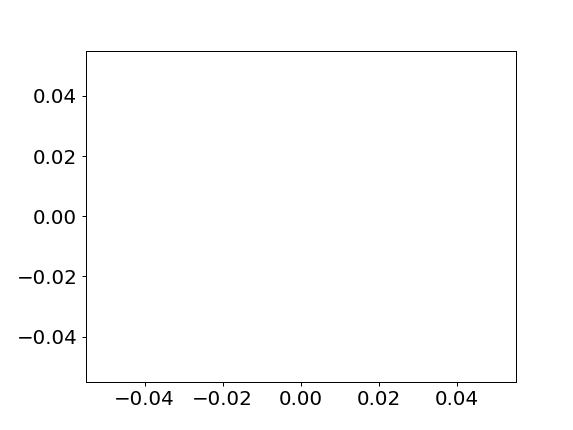

model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_5_epoch200.pth
            0
PC1  0.243707
PC2  0.182371
PC3  0.108682
PC4  0.098229
(560, 20)


<IPython.core.display.Javascript object>


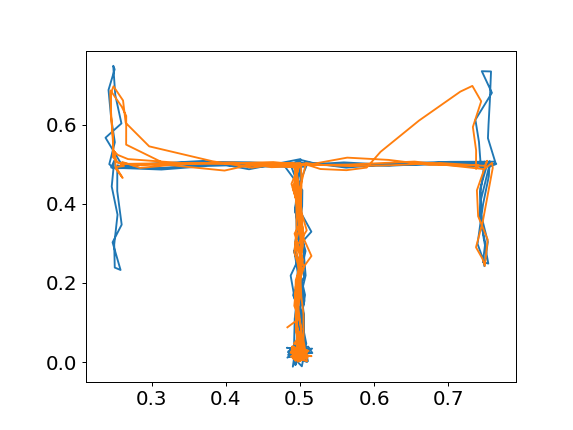

<IPython.core.display.Javascript object>


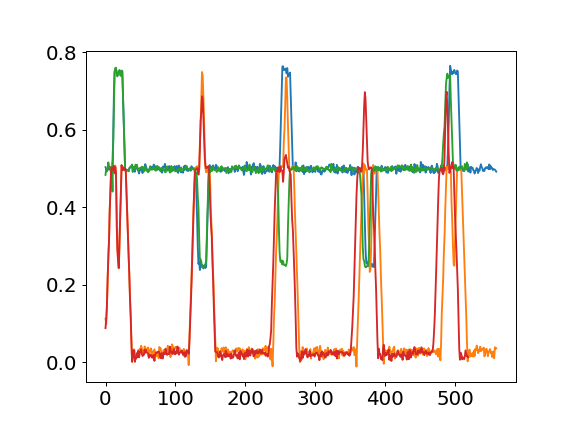

8.86339797989538


/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/munenori/anaconda3/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


(0.7917412208485339, 0.261259690014613, 0, 1.0000000000000002)
0 0
dist:0.5265004554315735


# どうするかわかんないからおまけ　3D plot 横並び

model_deigo/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch180.pth
             0
PC1   0.582212
PC2   0.124480
PC3   0.084589
PC4   0.063881
PC5   0.050533
PC6   0.024041
PC7   0.019888
PC8   0.015111
PC9   0.011846
PC10  0.007209
PC11  0.005229
PC12  0.002799
PC13  0.002098
PC14  0.001652
PC15  0.001469
PC16  0.001177
PC17  0.000758
PC18  0.000575
PC19  0.000339
PC20  0.000114
             0
PC1   0.348299
PC2   0.238257
PC3   0.110810
PC4   0.067534
PC5   0.048150
PC6   0.038156
PC7   0.030319
PC8   0.027785
PC9   0.021517
PC10  0.017683
PC11  0.013295
PC12  0.010688
PC13  0.005967
PC14  0.005256
PC15  0.004139
PC16  0.003557
PC17  0.002801
PC18  0.002639
PC19  0.002046
PC20  0.001103
             0
PC1   0.190333
PC2   0.157764
PC3   0.108675
PC4   0.081706
PC5   0.071272
PC6   0.062859
PC7   0.059732
PC8   0.046182
PC9   0.043176
PC10  0.034810
PC11  0.028768
PC12  0.023563
PC13  0.020976
PC14  0.015550
PC15  0.013983
PC16  0.011113
PC17  0.010307
PC18  0.008334
PC1

<IPython.core.display.Javascript object>


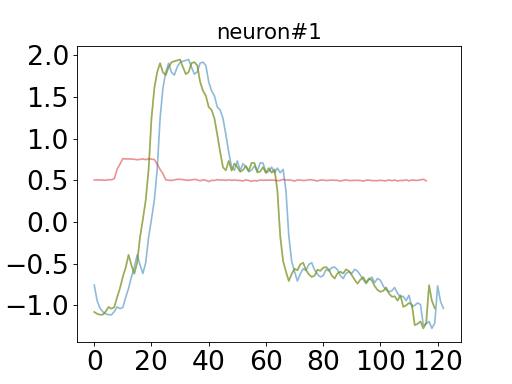

<IPython.core.display.Javascript object>


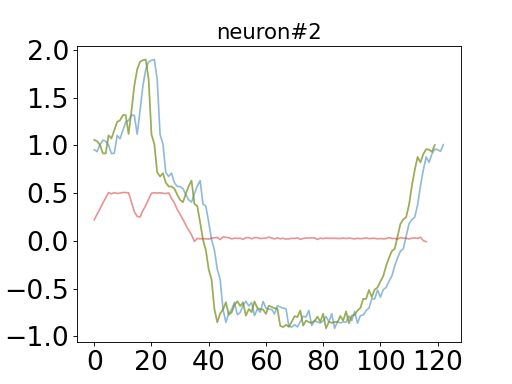

<IPython.core.display.Javascript object>


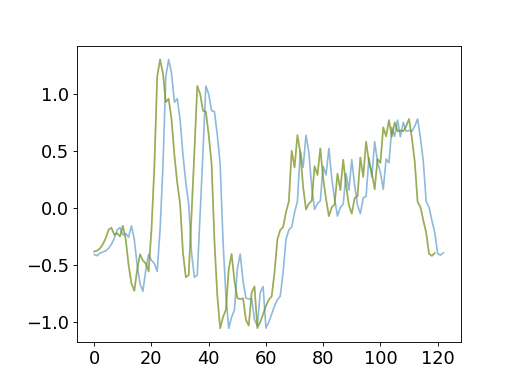

IndexError: index 2 is out of bounds for axis 1 with size 2

In [636]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Fri Feb 19 10:54:37 2021

@author: munenori
"""

import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import time
import math
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import sklearn 
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd
import scipy

%matplotlib notebook

plt.rcParams["font.size"] = 16
plt.rcParams["figure.subplot.left"] = 0.15

def Culc_gate(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = torch.cat([hiddens[1][0][0],hiddens[2][0]])
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]

def Culc_gate_uniPFC(input, params, hiddens):
    Re = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
    #Re = torch.zeros(10, 20)
    HPC_input = torch.cat([input,hiddens[2]],dim=1)
    PFC_input = hiddens[1][0][0]
    PFC_gates = params[0]@PFC_input+params[1]@hiddens[0][1][0]+params[2]+params[3]
    HPC_gates = params[4]@HPC_input[0]+params[5]@hiddens[1][1][0]+params[6]+params[7]
    PFC_gates = torch.sigmoid(PFC_gates)
    HPC_gates = torch.sigmoid(HPC_gates)
    
    return [PFC_gates.tolist(), HPC_gates.tolist()]
    

def MakeAnimation(data_x,data_y,traj_x,traj_y, data_limit):
    fig, ax = plt.subplots()
    ims = []
    for t in range(traj_x.shape[0]):
        if t < data_limit:
            traj = ax.plot(data_x[:t], data_y[:t], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
        else:
            traj = ax.plot(data_x[:data_limit], data_y[:data_limit], "b", traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or", data_x[data_limit-1:t], data_y[data_limit-1:t], "--b")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_Re_0.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation2(data_x,data_y,traj_x,traj_y, data_limit):
    fig, ax = plt.subplots()
    ims = []
    for t in range(traj_x.shape[0]):
        if t < data_limit:
            traj = ax.plot(traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
        else:
            traj = ax.plot(traj_x[:t], traj_y[:t], "r", traj_x[t-1], traj_y[t-1], "or")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_Re_0.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_data(data_x,data_y, data_limit):
    fig, ax = plt.subplots()
    ax.set_xlim(0.2,0.8)
    ax.set_ylim(-0.05,0.8)
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=30)    
    ani.save('anim_Re_0.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_testdata(data_x,data_y):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b")
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_test_1.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_attracter(data_x,data_y):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob",)
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_attracter_gate_PFC.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_3D(data_x,data_y):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data_x.shape[0]):
        traj = ax.plot(data_x[:t], data_y[:t], "b", data_x[t-1], data_y[t-1], "ob",)
        title = ax.text(0.5, 1.01, 'time={}'.format(t),
                     ha='center', va='bottom',
                     transform=ax.transAxes, fontsize='large')
        ims.append(traj+[title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_attracter2.gif', writer='pillow')
    plt.show()
    
    return 0

def MakeAnimation_img(data,module):
    fig, ax = plt.subplots()
    ims = []
    for t in range(data.shape[0]):
        img = ax.imshow(data[t].reshape(1,data.shape[1]))
        title = ax.text(0.5, 1.01, module+' time={}'.format(t),
             ha='center', va='bottom',
             transform=ax.transAxes, fontsize='large')
        ims.append([img,title])
    ani = animation.ArtistAnimation(fig, ims, interval=100)    
    ani.save('anim_fire_'+module+'_.gif', writer='pillow')
    plt.show()
    
    return 0


def mkOwnDataSet(data_size, data_length=100, freq=60., noise=0.01):
   
    x = np.loadtxt("primal_long131test_r.csv",delimiter=',')
    y = np.loadtxt("primal_long131test_l.csv",delimiter=',')
    train_x = []
    train_y = []
    
    for offset in range(data_size):
        train_x.append([[x[i][0] + np.random.normal(loc=0.0, scale=noise),x[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,x.shape[0],round(x.shape[0]/data_length))])
        train_y.append([[y[i][0] + np.random.normal(loc=0.0, scale=noise),y[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(0,y.shape[0],round(y.shape[0]/data_length))])
    return train_x, train_y

def make_Ttraj(direction):
    traj_x = np.array([])
    traj_y = np.array([])
    straight_x = np.ones(5)*0.5
    if direction == 1:
        branch1_x = np.linspace(0.5, 0.75, 5)
        branch2_x = np.linspace(0.75, 0.5, 5)
    elif direction == 2:
        branch1_x = np.linspace(0.5, 0.25, 5)
        branch2_x = np.linspace(0.25, 0.5, 5)        
    backstraight_x = np.ones(5)*0.5

    straight_y = np.linspace(0, 0.5, 5)
    branch1_y = np.linspace(0.5, 0.5, 5)
    branch2_y = np.linspace(0.5, 0.5, 5)
    backstraight_y = np.linspace(0.5 , 0, 5)
    
    traj_x = np.append(traj_x, [straight_x,branch1_x,branch2_x,backstraight_x])
    traj_y = np.append(traj_y, [straight_y,branch1_y,branch2_y,backstraight_y])
    traj = np.concatenate([[traj_x],[traj_y]],axis=0).T
    return traj

def make_Htraj(direction1, direction2):
    traj_x = np.array([])
    traj_y = np.array([])
    straight_x = np.ones(10)*0.5
    if direction1 == 1:
        branch1_x = np.linspace(0.5, 0.75, 5)
        branch2_x = np.linspace(0.75, 0.75, 5)
        branch3_x = np.linspace(0.75, 0.75, 5)
        branch4_x = np.linspace(0.75, 0.5, 5)
    elif direction1 == 2:
        branch1_x = np.linspace(0.5, 0.25, 5)
        branch2_x = np.linspace(0.25, 0.25, 5)   
        branch3_x = np.linspace(0.25, 0.25, 5)  
        branch4_x = np.linspace(0.25, 0.5, 5)       
    backstraight_x = np.ones(10)*0.5

    straight_y = np.linspace(0, 0.5, 10)
    branch1_y = np.linspace(0.5, 0.5, 5)
    if direction2 == 1:
        branch2_y = np.linspace(0.5, 0.25, 5)
        branch3_y = np.linspace(0.25, 0.5, 5)
    elif direction2 == 2:
        branch2_y = np.linspace(0.5, 0.75, 5)
        branch3_y = np.linspace(0.75, 0.5, 5)
    branch4_y = np.linspace(0.5, 0.5, 5)
    backstraight_y = np.linspace(0.5 , 0, 10)
    
    traj_x = np.append(traj_x, straight_x)
    traj_x = np.append(traj_x, [branch1_x,branch2_x,branch3_x,branch4_x])
    traj_x = np.append(traj_x, backstraight_x)
    traj_y = np.append(traj_y, straight_y)
    traj_y = np.append(traj_y, [branch1_y,branch2_y,branch3_y,branch4_y])
    traj_y = np.append(traj_y, backstraight_y)
    traj = np.concatenate([[traj_x],[traj_y]],axis=0).T
    return traj


def make_traj(delay_length):
    freq=60
    noise=0.005
    data_length = 40
    
    # x = np.loadtxt("right1.csv",delimiter=',')
    x_1 = make_Htraj(1,1)
    x_2 = make_Htraj(1,2)
    # y = np.loadtxt("left1.csv",delimiter=',')
    y_1 = make_Htraj(2,1)
    y_2 = make_Htraj(2,2)
    z = np.loadtxt("stay1.csv",delimiter=',')
    data_list = []
    ###  ver1  ###
    orders = []
    order  = np.array([1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    orders.append(order) 
    order  = np.array([2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    orders.append(order) 
    order  = np.array([3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    orders.append(order) 
    order  = np.array([4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    orders.append(order) 
    
    # ###  ver2  ###
    # orders = []
    # order  = np.array([1])
    # order  = np.append(order,np.zeros(delay_length))
    # order = np.append(order, [2])
    # orders.append(order) 
    # order  = np.array([2])
    # order  = np.append(order,np.zeros(delay_length))
    # order = np.append(order, [3])
    # orders.append(order) 
    # order  = np.array([3])
    # order  = np.append(order,np.zeros(delay_length))
    # order = np.append(order, [4])
    # orders.append(order) 
    # order  = np.array([4])
    # order  = np.append(order,np.zeros(delay_length))
    # order = np.append(order, [1])
    # orders.append(order) 
    # order = [1,0,0,0,2]
    # order = [2,0,0,1,0,0,0,2,0,0,1]
    
    ###  ver1's test  ###
    orders = []
    order  = np.array([1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    order  = np.array([4])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [2])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [3])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [1])
    order  = np.append(order,np.zeros(delay_length))
    order = np.append(order, [4])
    order  = np.append(order,np.zeros(delay_length))
    orders.append(order) 
    
    
    for order in orders:
        data = np.array([[0,0]])
        for idx in order:
            if idx == 1:
                target = x_1
            elif idx == 2:
                target = x_2
            elif idx == 3:
                target = y_1
            elif idx == 4:
                target = y_2
            elif idx == 0:
#                 target = np.array([[z[i][0],z[i][1]] for i in np.random.choice(z.shape[0], data_length)])
                target = np.array([[0.5,0] for i in np.random.choice(z.shape[0], data_length)])
            if idx != 0:
                target += np.random.normal(loc=0.0, scale=noise, size=target.shape)
    
            data = np.append(data,target,axis=0)
        data_list.append(data[1:])
    return data_list[0],data_list[1],data_list[2],data_list[3]

def mkOwnDataSet_auto(data_size, delay_length, freq=60., noise=0.0001):
   
    x1,x2,y1,y2 = make_traj(delay_length)
    train_x1 = []
    train_x2 = []
    train_y1 = []
    train_y2 = []
    
    for offset in range(data_size):
        train_x1.append([[x1[i][0] + np.random.normal(loc=0.0, scale=noise),x1[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(x1.shape[0])])
        train_x2.append([[x2[i][0] + np.random.normal(loc=0.0, scale=noise),x2[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(x2.shape[0])])

        train_y1.append([[y1[i][0] + np.random.normal(loc=0.0, scale=noise),y1[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(y1.shape[0])])
        train_y2.append([[y2[i][0] + np.random.normal(loc=0.0, scale=noise),y2[i][1]+ np.random.normal(loc=0.0, scale=noise)] for i in np.arange(y2.shape[0])])

    return train_x1, train_x2, train_y1, train_y2

def mkOwnRandomBatch(train_x, train_t, batch_size=10):
    """
    train_x, train_tを受け取ってbatch_x, batch_tを返す
    """
    batch_x = []
    for _ in range(batch_size):
        idx = np.random.randint(0, len(train_x) - batch_size)
        batch_x.append(train_x[idx])
    return torch.tensor(batch_x).transpose(0,1)

class MyLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        nn.init.sparse_(self.PFC.weight_ih.data,1)
        nn.init.sparse_(self.HPC.weight_ih.data,1)
        nn.init.sparse_(self.PFC.weight_hh.data,1)
        nn.init.sparse_(self.HPC.weight_hh.data,1)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2][0]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,Re_hidden]

class MyLSTM_RNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse):
        super(MyLSTM_RNN, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.0
        v = 0.01
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]



class MyLSTM_RNN_noise(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse):
        super(MyLSTM_RNN_noise, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+10
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        c = 0.02
        v = 0.02
        HPC_noised = hiddens[1][0] + torch.randn(self.batch_size, self.hidden_size_HPC)*c
        PFC_noised = hiddens[0][0] + torch.randn(self.batch_size, self.hidden_size_PFC)*v
        Re_noised = hiddens[2] + torch.randn(self.batch_size, self.hidden_size_Re)*c
        Re_input = torch.cat([PFC_noised,HPC_noised],dim=1)
        Re_hidden = self.Re(Re_input, Re_noised)
        HPC_input = torch.cat([input,Re_noised],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([HPC_noised,Re_noised],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]


class MyLSTM_vHPC(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM_vHPC, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.vHPC = nn.LSTMCell(hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        sparse = 0.1
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.vHPC.weight_ih.data,sparse)
        nn.init.sparse_(self.Re.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)
        nn.init.sparse_(self.vHPC.weight_hh.data,sparse)
        nn.init.sparse_(self.Re.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[3][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        vHPC_input = hiddens[1][0]
        vHPC_hidden = self.vHPC(vHPC_input,hiddens[2])
        PFC_input = torch.cat([hiddens[2][0],hiddens[3][0]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, vHPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        vHPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,vHPC_hidden,Re_hidden]

class MyLSTM_3lay(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size):
        super(MyLSTM_3lay, self).__init__()

        self.hidden_size = hidden_size
        self.PFC = nn.LSTMCell(hidden_size, hidden_size)
        self.HPC = nn.LSTMCell(input_size+hidden_size, hidden_size)
        self.Re = nn.LSTMCell(hidden_size*2, hidden_size)
        self.linear = nn.Linear(hidden_size, output_size)
        self.batch_size = batch_size
        sparse = 0.1
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.Re.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)
        nn.init.sparse_(self.Re.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        HPC_input = torch.cat([input,hiddens[2][0]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input,hiddens[2])
        PFC_input = hiddens[2][0]
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        vHPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
class MyLSTM_feedforward(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse):
        super(MyLSTM_feedforward, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.Linear(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input)
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]
    

class MyLSTM_feedforward_Thalamus2(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse):
        super(MyLSTM_feedforward_Thalamus2, self).__init__()

        self.hidden_size_PFC = hidden_size
        self.hidden_size_HPC = hidden_size
        self.hidden_size_Re = hidden_size+0
        self.hidden_size_THinh = hidden_size
        self.PFC = nn.LSTMCell(self.hidden_size_HPC+self.hidden_size_Re, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.Linear(self.hidden_size_PFC+self.hidden_size_HPC+self.hidden_size_THinh, self.hidden_size_Re)
        self.THinh = nn.Linear(self.hidden_size_Re, self.hidden_size_THinh)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        self.ReLU = nn.ReLU()
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0],hiddens[3]],dim=1)
        Re_hidden = self.Re(Re_input)
        THinh_input = hiddens[2]
        THinh_hidden = self.ReLU(self.THinh(THinh_input))
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = torch.cat([hiddens[1][0],hiddens[2]],dim=1)
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden,THinh_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        THinh_hidden = self.ReLU(torch.rand(self.batch_size, self.hidden_size_THinh))
        return [PFC_hidden,HPC_hidden,Re_hidden,THinh_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        THinh_hidden = self.ReLU(torch.rand(self.batch_size, self.hidden_size_THinh)*const)
        return [PFC_hidden,HPC_hidden,Re_hidden,THinh_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.02
        v = 0.02
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*c
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*v
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re,self.hidden_size_THinh]



    
    
class MyLSTM_RNN_uniPFC(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, batch_size, sparse=1):
        super(MyLSTM_RNN_uniPFC, self).__init__()

        self.hidden_size_PFC = hidden_size+0
        self.hidden_size_HPC = hidden_size+0
        self.hidden_size_Re = hidden_size+0
        self.PFC = nn.LSTMCell(self.hidden_size_HPC, self.hidden_size_PFC)
        # self.PFC = nn.LSTMCell(hidden_size*2, hidden_size)
        self.HPC = nn.LSTMCell(input_size+self.hidden_size_Re, self.hidden_size_HPC)
        self.Re = nn.RNNCell(self.hidden_size_HPC+self.hidden_size_PFC, self.hidden_size_Re)
        self.linear = nn.Linear(self.hidden_size_HPC, output_size)
        self.batch_size = batch_size
        sparse = 0.1*int(sparse)
        nn.init.sparse_(self.PFC.weight_ih.data,sparse)
        nn.init.sparse_(self.HPC.weight_ih.data,sparse)
        nn.init.sparse_(self.Re.weight_ih.data,sparse)
        nn.init.sparse_(self.PFC.weight_hh.data,sparse)
        nn.init.sparse_(self.HPC.weight_hh.data,sparse)
        nn.init.sparse_(self.Re.weight_hh.data,sparse)
        # nn.init.normal_(self.PFC.weight_ih.data,0,1/10)
        # nn.init.normal_(self.HPC.weight_ih.data,0,1/10)
        # nn.init.normal_(self.Re.weight_ih.data,0,0.1/10)
        # nn.init.normal_(self.PFC.weight_hh.data,0,1/10)
        # nn.init.normal_(self.HPC.weight_hh.data,0,1/10)
        # nn.init.normal_(self.Re.weight_hh.data,0,1/10)

    def forward(self, input, hiddens):
        Re_input = torch.cat([hiddens[0][0],hiddens[1][0]],dim=1)
        Re_hidden = self.Re(Re_input, hiddens[2])
        HPC_input = torch.cat([input,hiddens[2]],dim=1)
        HPC_hidden = self.HPC(HPC_input, hiddens[1])
        PFC_input = hiddens[1][0]
        PFC_hidden = self.PFC(PFC_input, hiddens[0])
        output = self.linear(HPC_hidden[0])
        return output, [PFC_hidden, HPC_hidden, Re_hidden]

    def initHidden(self):
        HPC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        PFC_hidden = [torch.zeros(self.batch_size, self.hidden_size), torch.zeros(self.batch_size, self.hidden_size)]
        Re_hidden = torch.zeros(self.batch_size, self.hidden_size)
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def initHidden_rand(self):
        const = 0.01
        var = 0.01
        HPC_hidden = [torch.rand(self.batch_size, self.hidden_size_HPC)*const, torch.rand(self.batch_size, self.hidden_size_HPC)*const]
        PFC_hidden = [torch.rand(self.batch_size, self.hidden_size_PFC)*var, torch.rand(self.batch_size, self.hidden_size_PFC)*var]
        Re_hidden = torch.rand(self.batch_size, self.hidden_size_Re)*const
        return [PFC_hidden,HPC_hidden,Re_hidden]
    
    def noiseHidden_rand(self, hiddens):
        c = 0.0
        v = 0.01
        HPC_hidden = torch.randn(self.batch_size, self.hidden_size_HPC)*v
        hiddens[1][0].add_(HPC_hidden)
        PFC_hidden = torch.randn(self.batch_size, self.hidden_size_PFC)*c
        hiddens[0][0].add_(PFC_hidden)
        Re_hidden = torch.randn(self.batch_size, self.hidden_size_Re)*c
        hiddens[2].add_(Re_hidden)
        return hiddens
    
    def hidden_size_list(self):
        return [self.hidden_size_PFC,self.hidden_size_HPC,self.hidden_size_Re]

    

def moving_average(data):
    y = np.ones(5)/5
    mean_seq = np.convolve(data, y)
    return mean_seq

def main(num):
    training_size = 100
    test_size = 1000
    epochs_num = 10
    hidden_size = 20
    batch_size = 10
    data_length = 100
    inputsize = 2
    outputsize = 2
    # model_path = 'model/ReModel_L2_interRNNrand_Reinh_AddRe_OUT5_H121_s'+str(num)+'_100_2_2.pth'
    # model_path = 'model/ReModel_L2_interRNNrand_Reinh_AddRe_OUT5_H121_s2_100_1_2.pth'
    model_path = 'model/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch180.pth'
#     model_path = 'model/R20_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_1_epoch180.pth'
#     model_path = 'model/R20_H_stopinit_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s2_100_3_epoch10.pth'
#     model_path = 'model/R20_H_uniPFC_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s3_100_1_epoch145.pth'
#     model_path = 'model/R20_H_uniHPC_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s1_100_3_epoch190.pth'
#     model_path = 'model/R20_uniPFC_H/ReModel_L2_interRNNrand_OUT1_uniPFC_121H_s5_100_2_epoch85.pth'
#     model_path = 'model/R20_uniHPC_H/ReModel_L2_interRNNrand_OUT1_121H_s2_100_1_epoch100.pth'
#     model_path = 'model/R20_H_transfer2B/ReModel_L2_interRNNrand_OUT1_transfers14_121_s2_100_2_epoch60.pth'
#     model_path = 'model/R20FF_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_3_epoch190.pth'
#     model_path = 'model/R20FF_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s4_100_1_epoch100.pth'
#     model_path = 'model_test/R20_H_retrainv2_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s9_100_2_epoch215.pth'
#     model_path = 'model/R20_feedReinhReLU_H_bigbatch/ReModel_L2_interRNNrand_OUT1_121_s8_100_1_epoch150.pth'


    sparse = 1
    delay_length = 2
    
    if os.path.exists(model_path):
        print(model_path)
    else:
        print("Not exist")
        return
    
    
    colors = ['C0','C1','C2','C3','C4','C9']

    # train_x,train_y = mkOwnDataSet(training_size,data_length)
    train_x1,train_x2,train_y1,train_y2 = mkOwnDataSet_auto(training_size,delay_length)
#     test_x = mkOwnDataSet(test_size,data_length)

    rnn = MyLSTM_RNN(inputsize, hidden_size, outputsize, batch_size, sparse)
#     rnn = MyLSTM_RNN_uniPFC(inputsize, hidden_size, outputsize, batch_size, sparse)
#     rnn = MyLSTM_feedforward(inputsize, hidden_size, outputsize, batch_size, sparse)
#     rnn = MyLSTM_feedforward_Thalamus2(inputsize, hidden_size, outputsize, batch_size, sparse)
    
    rnn.load_state_dict(torch.load(model_path))
    
    pattern = 1
    if  pattern == 1:
        data = mkOwnRandomBatch(train_x1, train_x1, batch_size).float()
    elif pattern == 2:
        data = mkOwnRandomBatch(train_x2, train_x2, batch_size).float()
    elif pattern == 3:
        data = mkOwnRandomBatch(train_y1, train_y1, batch_size).float()                
    else:
        data = mkOwnRandomBatch(train_y2, train_y2, batch_size).float()
    
    params = []
    for p in rnn.parameters():
        params.append(p.data)
    
    traj = []
    PFCstate = []
    HPCstate = []
    Restate = []
    Gate_states = []
    hidden = rnn.initHidden_rand()
    data_limit = 120
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            Gate_states.append(Culc_gate(output,params,hidden))
#             Gate_states.append(Culc_gate_uniPFC(output,params,hidden))
    for k in range(data.shape[0]*0+0):
#             if output.tolist()[0][1]<0.05:
#                 hidden = rnn.noiseHidden_rand(hidden)
            output,hidden = rnn(output,hidden) 
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
#             print(output)
            Gate_states.append(Culc_gate(output,params,hidden))

    

    hidden = rnn.initHidden_rand()
    data_limit = 120
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            Gate_states.append(Culc_gate(output,params,hidden))
#             Gate_states.append(Culc_gate_uniPFC(output,params,hidden))
    for k in range(data.shape[0]*0+0):
#             if output.tolist()[0][1]<0.05:
#                 hidden = rnn.noiseHidden_rand(hidden)
            output,hidden = rnn(output,hidden) 
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
#             print(output)
            Gate_states.append(Culc_gate(output,params,hidden))
#             Gate_states.append(Culc_gate_uniPFC(output,params,hidden))


    hidden = rnn.initHidden_rand()
    data_limit = 120
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            Gate_states.append(Culc_gate(output,params,hidden))
#             Gate_states.append(Culc_gate_uniPFC(output,params,hidden))
    for k in range(data.shape[0]*0+0):
#             if output.tolist()[0][1]<0.05:
#                 hidden = rnn.noiseHidden_rand(hidden)
            output,hidden = rnn(output,hidden) 
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
#             print(output)
            Gate_states.append(Culc_gate(output,params,hidden))
#             Gate_states.append(Culc_gate_uniPFC(output,params,hidden))
    

    hidden = rnn.initHidden_rand()
    data_limit = 120
    for k in range(data_limit):
            #print(data[k].shape)
            output,hidden = rnn(data[k],hidden)
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
            Gate_states.append(Culc_gate(output,params,hidden))
#             Gate_states.append(Culc_gate_uniPFC(output,params,hidden))
    for k in range(data.shape[0]*0+0):
#             if output.tolist()[0][1]<0.05:
#                 hidden = rnn.noiseHidden_rand(hidden)
            output,hidden = rnn(output,hidden) 
            traj.append(output.tolist())
            PFCstate.append(hidden[0][0].tolist())
            HPCstate.append(hidden[1][0].tolist())
            Restate.append(hidden[2][0].tolist())
#             print(output)
            Gate_states.append(Culc_gate(output,params,hidden))
#             Gate_states.append(Culc_gate_uniPFC(output,params,hidden))
    traj = torch.tensor(traj)
    pltdata = torch.squeeze(data).numpy()
    traj = torch.squeeze(traj).numpy()
    
    
    pca = PCA()
    # dfs = np.concatenate((np.array(PFCstate)[:,0],np.array(HPCstate)[:,0],np.array(Restate)),axis=1)
    # dfs = np.concatenate((np.array(PFCstate)[:,0],np.array(HPCstate)[:,0]),axis=1)
    dfs = np.array(HPCstate)[:,0]
#     dfs = np.array(Restate)
    pca.fit(dfs)
    feature = pca.transform(dfs)
    print(pd.DataFrame(pca.explained_variance_ratio_, index=["PC{}".format(x + 1) for x in range(dfs.shape[1])]))
    
    pca = PCA()
    dfs = np.array(PFCstate)[0:,0]
#     dfs = np.array(Restate)[0:]
    pca.fit(dfs)
    PFCfeature = pca.transform(dfs)
    print(pd.DataFrame(pca.explained_variance_ratio_, index=["PC{}".format(x + 1) for x in range(dfs.shape[1])]))

    pca = PCA()
#     dfs = np.array(PFCstate)[0:,0]
    dfs = np.array(Restate)[0:]
    pca.fit(dfs)
    Refeature = pca.transform(dfs)
    print(pd.DataFrame(pca.explained_variance_ratio_, index=["PC{}".format(x + 1) for x in range(dfs.shape[1])]))
    
    datalen = 120
    
#     delays = pick_traj(traj_noise[:,0], np.array(PFCstate_noise)[:,0])
#     delays = pick_traj(traj[:,0], np.array(PFCstate)[:,0])
#     delays = pick_traj(traj_noise[:,0], np.array(HPCstate_noise)[:,0])
#     delays = pick_traj(traj[:,0], np.array(HPCstate)[:,0])
#     delays = pick_traj(traj_noise[:,0], np.array(Restate_noise)[:])
#     delays = pick_traj(traj[:,0], np.array(Restate)[:])
#     delays = pick_delay(traj[:,0], np.array(Restate)[:])
#     delays = pick_traj(traj_noise[:,0], np.array(traj_noise)[:])[3:-1]
#     delays = pick_traj(traj[:,0], np.array(Gate_states)[:,0,0:20]-np.array(Gate_states)[:,0,20:40])
#     delays = pick_traj(traj[:,0], np.array(Gate_states)[:,0,0:20])
#     delays = pick_delay(traj[:,0], np.array(Gate_states)[:,1])
#     delays = pick_traj(traj_noise[:,0], np.array(Gate_states_noise)[:,1])
#     delays = pick_delay(traj_noise[:,0], np.array(Gate_states_noise)[:,0])
#     delays = pick_traj(traj[:,0], feature[:])
#     delays = pick_traj(traj[:,0], PFCfeature[:])
#     delays = pick_delay(traj[:,0], feature[:])

    delays = []
    for i in range(4):
        delays.append(PFCfeature[:])

    bifur = np.array([])
    for i in range(4):
        plt.figure()
        for data in delays[0:4]:
#             avedata = moving_average(data[:,0+i])
#             plt.plot(avedata[2:-2],alpha=0.5)
#             plt.plot(data[:,0+i]-avedata[2:-2],alpha=0.5)
            plt.plot(np.array(data)[:,0+i],alpha=0.5)
#             plt.plot(np.array(data)[:,0+i]-np.array(delays[1:-1][0])[:,0+i],alpha=0.5)
#             plt.plot(np.log(data)[:,0+i],alpha=0.5)
#             print(len(data),len(avedata))
        plt.title("neuron#"+str(i+1))
        plt.yticks(fontsize=24)
        plt.xticks(fontsize=24)
#     print(np.var(bifur),np.median(bifur)-np.mean(bifur))

#     for i in range(20):
#         plt.figure()
#         delays = delays[1:-1]
#         plt.plot(np.array(delays)[,:,0+i],alpha=0.5)
#         plt.title("neuron#"+str(i+1))
# #     print(np.var(bifur),np.median(bifur)-np.mean(bifur))

    for i in range(3):
        data_len = 1000
        delays_samelen = []
        result = 0
        for data in delays[1:-1]:
            data_len = np.min([data_len,len(data)])
        for data in delays[1:-1]:
            delays_samelen.append(data[:data_len])
        delays_samelen = np.array(delays_samelen)
        for k in range(data_len):
            result += np.var(delays_samelen[:,k,i])
        result /= data_len
        print(result)
#     print(np.var(bifur),np.median(bifur)-np.mean(bifur))

    
    pca = PCA()
    dfs = np.array(PFCstate)[0:,0]
#     dfs = np.array(Restate)[0:]
    pca.fit(dfs)
    feature = pca.transform(dfs)
    
#     pred = KMeans(n_clusters=2).fit_predict(feature)

    fig3d = plt.figure()
    ax3d = Axes3D(fig3d)
    ax3d.plot(feature[:, 0], feature[:, 1], feature[:, 2], color=colors[4], alpha=0.5)
#     ax3d.plot(feature[40:, 0], feature[100:, 1], feature[100:, 2], alpha=0.7)
    ax3d.plot(feature[0:1, 0], feature[0:1, 1], feature[0:1, 2], "o", color=colors[0], alpha=1)
    ax3d.plot(feature[:120, 0], feature[:120, 1], feature[:120, 2], color=colors[0], alpha=1)
#     ax3d.plot(feature[19:20, 0], feature[19:20, 1], feature[19:20, 2], "o", color=colors[1], alpha=1)
#     ax3d.plot(feature[19:40, 0], feature[19:40, 1], feature[19:40, 2], color=colors[1], alpha=1)
#     ax3d.plot(feature[39:40, 0], feature[39:40, 1], feature[39:40, 2], "o", color=colors[2], alpha=1)
#     ax3d.plot(feature[39:120, 0], feature[39:120, 1], feature[39:120, 2], color=colors[2], alpha=1)
#     ax3d.plot(feature[119:120, 0], feature[119:120, 1], feature[119:120, 2], "o", color=colors[3], alpha=1)
#     ax3d.plot(feature[240:241, 0], feature[240:241, 1], feature[240:241, 2],"o", alpha=1)
    plt.show()
    
    plt.figure()
    plt.plot(feature[:240, 0], feature[:240, 1], alpha=0.8)
    plt.show()
    
    print(pd.DataFrame(pca.explained_variance_ratio_, index=["PC{}".format(x + 1) for x in range(dfs.shape[1])]))

    
    
if __name__ == '__main__':
    features = []
    for i in range(1):
        features.append(main(i+1))